<a href="https://colab.research.google.com/github/gapatronh/thesis/blob/main/experiments_gan.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import tensorflow as tf
import tensorflow_datasets as tfds
import numpy as np
np.set_printoptions(precision = 3)
import matplotlib.pyplot as plt
import sklearn.datasets
import time
import itertools

In [ ]:
#self-defined data

def quad_data(n=10000, scale=10):
    x = scale*(np.random.random_sample((n,))-0.5)
    y = x**2
    return np.array([x,y]).T

def circle_data(n=10000, radius = 1):
    data = []
    x = (np.random.random_sample((n,)))
    return radius*np.array([np.cos(2*np.pi*x),np.sin(2*np.pi*x)]).T

np.random.seed(0)
def mixture_gaussians(n=10000):
  gauss_1 = np.random.multivariate_normal((5,5),cov =[[1,0],[0,1]], size = n//4)
  gauss_2 = np.random.multivariate_normal((5,-5),cov =[[1,0],[0,1]], size = n//4)
  gauss_3 = np.random.multivariate_normal((-5,-5),cov =[[1,0],[0,1]], size = n//4)
  gauss_4 = np.random.multivariate_normal((-5,5),cov =[[1,0],[0,1]], size = n//4)
  mix = np.vstack((gauss_1, gauss_2, gauss_3, gauss_4))
  np.random.shuffle(mix)
  return (mix)

In [ ]:
#Parabola
quadratic = quad_data().astype("float32")

#Circle
circle = circle_data().astype("float32")

#Gaussian mixture
mixture = mixture_gaussians().astype("float32")

#Random Blobs

blobs = sklearn.datasets.make_blobs(n_samples=10000, centers=5, center_box=(-20,20))
X_blobs, Y_blobs = blobs
blobs = X_blobs.astype("float32")

#Circles
circles = sklearn.datasets.make_circles(n_samples=10000, factor=0.4)
X_circles, Y_circles = circles
circles = X_circles.astype("float32")


#Moons
moons = sklearn.datasets.make_moons(n_samples=10000)
X_moons, Y_moons = moons
moons = X_moons.astype("float32")


#Swiss Roll
swiss_roll = sklearn.datasets.make_swiss_roll(n_samples=10000)
X_swiss_roll, t = swiss_roll
swiss_roll = np.vstack([X_swiss_roll[:,0], X_swiss_roll[:,2]]).T.astype("float32")

#S Curve
s_curve = sklearn.datasets.make_s_curve(n_samples=10000)
X_s_curve, t = s_curve
s_curve = np.vstack([X_s_curve[:,0], X_s_curve[:,2]]).T.astype("float32")

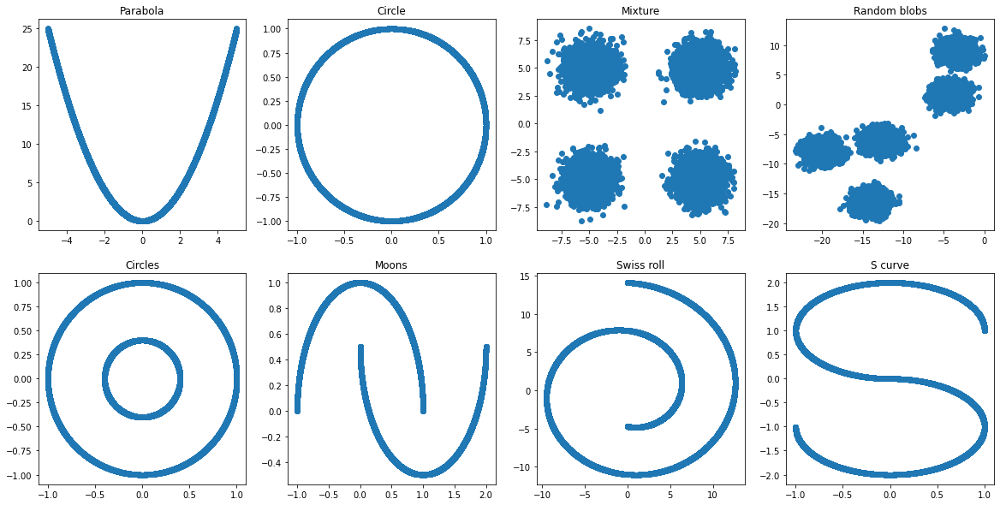

In [ ]:
fig, axs = plt.subplots(2,4, figsize=(20,10))
axs[0, 0].scatter(quadratic[:,0], quadratic[:,1])
axs[0, 0].set_title('Parabola')
axs[0, 1].scatter(circle[:,0], circle[:,1])
axs[0, 1].set_title('Circle')
axs[0,2].scatter(mixture[:,0], mixture[:,1])
axs[0,2].set_title("Mixture")
axs[0,3].scatter(blobs[:,0], blobs[:,1])
axs[0,3].set_title("Random blobs")

axs[1, 0].scatter(circles[:,0], circles[:,1])
axs[1, 0].set_title('Circles')
axs[1, 1].scatter(moons[:,0], moons[:,1])
axs[1, 1].set_title('Moons')
axs[1, 2].scatter(swiss_roll[:,0], swiss_roll[:,1])
axs[1, 2].set_title("Swiss roll")
axs[1, 3].scatter(s_curve[:,0], s_curve[:,1])
axs[1, 3].set_title("S curve")
plt.show()

In [ ]:
def make_generator_network(hsize=[64,64]):
  model = tf.keras.Sequential()
  model.add(tf.keras.layers.Dense(hsize[0],activation=tf.nn.leaky_relu))
  model.add(tf.keras.layers.Dense(hsize[1],activation=tf.nn.leaky_relu))
  model.add(tf.keras.layers.Dense(2, activation=None))
  return model

def make_discriminator_network(hsize=[64,64]):
  model = tf.keras.Sequential()
  model.add(tf.keras.layers.Dense(hsize[0],activation=tf.nn.leaky_relu))
  model.add(tf.keras.layers.Dense(hsize[1],activation=tf.nn.leaky_relu))
  model.add(tf.keras.layers.Dense(1, activation=None))
  return model

In [ ]:
z_size = 2
num_epochs = 200
batch_size = 200
device_name = tf.test.gpu_device_name()

In [ ]:
gen_model = make_generator_network()
gen_model.build(input_shape=(None,z_size))
gen_model.summary()

disc_model = make_discriminator_network()
disc_model.build(input_shape=(None, 2))
disc_model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                multiple                  192       
_________________________________________________________________
dense_1 (Dense)              multiple                  4160      
_________________________________________________________________
dense_2 (Dense)              multiple                  130       
Total params: 4,482
Trainable params: 4,482
Non-trainable params: 0
_________________________________________________________________
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3 (Dense)              multiple                  192       
_________________________________________________________________
dense_4 (Dense)              multiple                  4160      
________________________________

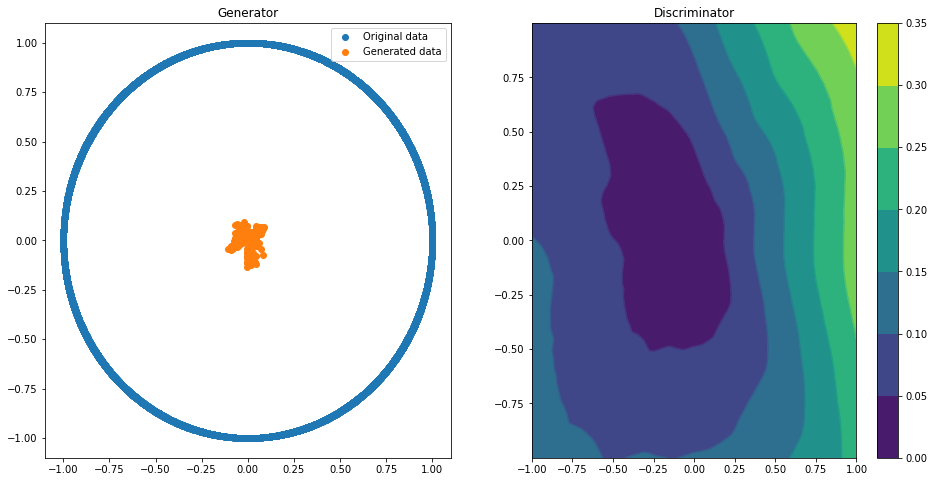

Epoch 000 | ET 0.57 min | Avg Losses >> G/D 0.6331/1.3866 [D-Real: 0.5791 D-Fake: 0.8075]


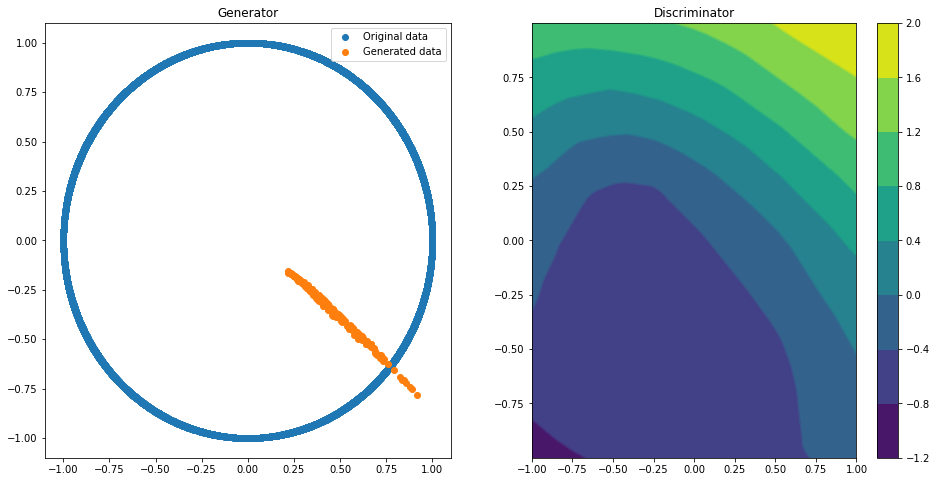

Epoch 050 | ET 1.82 min | Avg Losses >> G/D 0.9323/1.2608 [D-Real: 0.7065 D-Fake: 0.5543]


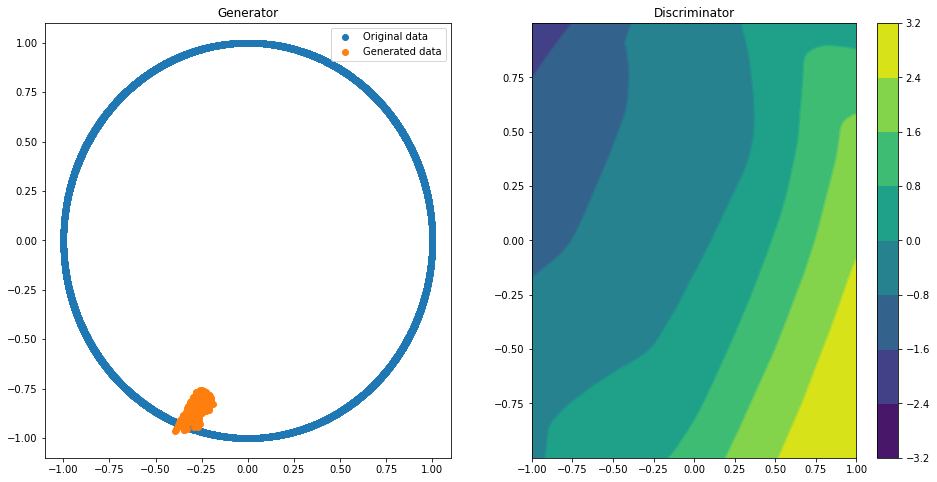

Epoch 100 | ET 3.07 min | Avg Losses >> G/D 0.9961/1.0412 [D-Real: 0.5796 D-Fake: 0.4616]


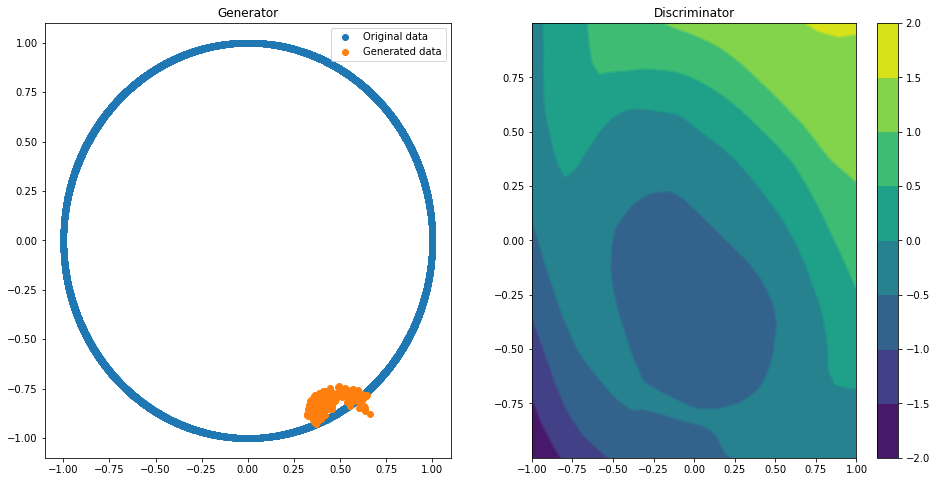

Epoch 150 | ET 4.31 min | Avg Losses >> G/D 0.7272/1.2968 [D-Real: 0.6315 D-Fake: 0.6653]


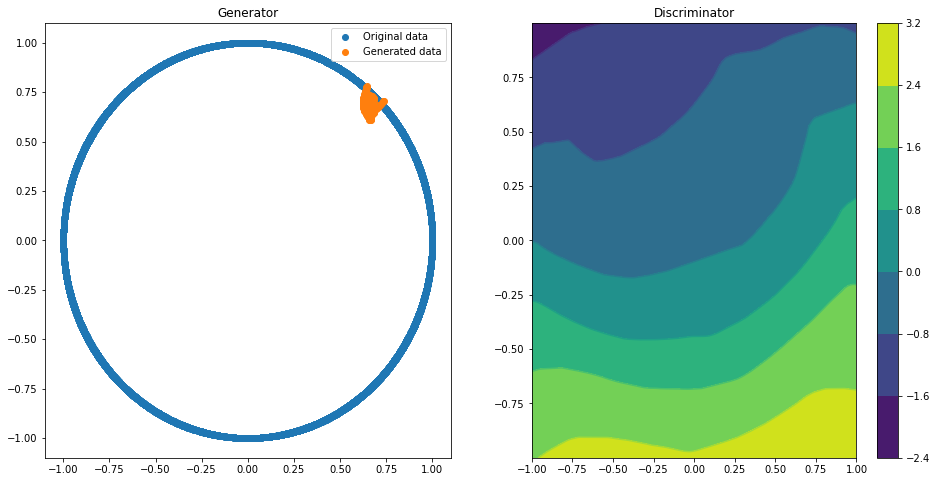

Epoch 200 | ET 5.58 min | Avg Losses >> G/D 0.7766/1.2082 [D-Real: 0.5859 D-Fake: 0.6223]


In [ ]:
numpy_data = circle
data = tf.data.Dataset.from_tensor_slices(numpy_data).batch(batch_size)

with tf.device(device_name):
  gen_model = make_generator_network()
  gen_model.build(input_shape=(None,z_size))
  disc_model = make_discriminator_network()
  disc_model.build(input_shape=(None,2))


loss_fn = tf.keras.losses.BinaryCrossentropy(from_logits=True)
g_optimizer = tf.keras.optimizers.Adam()
d_optimizer = tf.keras.optimizers.Adam()
all_losses = []
all_d_vals = []
d_gradients = []
g_gradients = []
epoch_samples = []
start_time = time.time()
for epoch in range(0, num_epochs+1):
  epoch_losses, epoch_d_vals = [], []
  #Plotting every 50
  if epoch%50 == 0:
      input_z = tf.random.uniform(shape = (200,z_size), minval=-1,maxval=1)
      epoch_samples.append(gen_model(input_z, training=False).numpy())
      X_data, Y_data = numpy_data[:,0], numpy_data[:,1]
      x = np.linspace(np.min(X_data), np.max(X_data), 200)
      y = np.linspace(np.min(Y_data), np.max(Y_data), 200)
      X, Y = np.meshgrid(x, y)
      Z = np.zeros((len(x), len(y)))
      for i in range(len(x)):
        for j in range(len(y)):
          q = tf.convert_to_tensor(np.array([[x[i],y[j]]]).astype("float32"))
          Z[i][j] = disc_model(q).numpy()[0][0]
      f, (ax1, ax2) = plt.subplots(1, 2, figsize = (16,8))
      ax1.scatter(X_data,Y_data, label = "Original data")
      ax1.scatter(epoch_samples[-1][:,0],epoch_samples[-1][:,1], label="Generated data")
      ax1.set_title("Generator")
      ax1.legend()
      ax2.contour(X,Y,Z)
      ax2.set_title("Discriminator")
      cp = ax2.contourf(X , Y , Z)
      plt.colorbar(cp, ax=ax2)
      plt.show()
  for batch in data:
    input_z = tf.random.uniform(shape = (batch_size,z_size), minval=-1,maxval=1)
      #Compute generator's loss
    with tf.GradientTape() as g_tape:
      g_output = gen_model(input_z)
      d_logits_fake = disc_model(g_output,
                                  training=True)
      labels_real = tf.ones_like(d_logits_fake)
      g_loss = loss_fn(y_true=labels_real,
                        y_pred=d_logits_fake)
      #Compute the gradients of g_loss
    g_grads = g_tape.gradient(g_loss,
                                gen_model.trainable_variables)
    g_gradients.append(tf.linalg.global_norm(g_grads).numpy())
      #Apply the gradients
    g_optimizer.apply_gradients(
          grads_and_vars=zip(g_grads,
                            gen_model.trainable_variables)
      )

      #Compute the discriminator's loss
    with tf.GradientTape() as d_tape:
      d_logits_real = disc_model(batch,
                                  training=True)
      d_labels_real = tf.ones_like(d_logits_real)
      d_loss_real = loss_fn(y_true=d_labels_real,
                              y_pred=d_logits_real)
      d_logits_fake = disc_model(g_output,
                                  training=True)
      d_labels_fake = tf.zeros_like(d_logits_fake)
      d_loss_fake = loss_fn(y_true=d_labels_fake,
                              y_pred=d_logits_fake)
      d_loss = d_loss_real + d_loss_fake

      #Compute the gradients of d_loss
    d_grads = d_tape.gradient(d_loss,
                                disc_model.trainable_variables)
    d_gradients.append(tf.linalg.global_norm(d_grads).numpy())
    d_optimizer.apply_gradients(grads_and_vars=zip(d_grads,
                                                    disc_model.trainable_variables))
      
    epoch_losses.append(
                          (g_loss.numpy(), d_loss.numpy(),
                          d_loss_real.numpy(), d_loss_fake.numpy()))
    d_probs_real = tf.reduce_mean(
                          tf.sigmoid(d_logits_real))
    d_probs_fake = tf.reduce_mean(
                          tf.sigmoid(d_logits_fake))
  epoch_d_vals.append((d_probs_real.numpy(),
                          d_probs_fake.numpy()))
  all_losses.append(epoch_losses)
  all_d_vals.append(epoch_d_vals)
  if epoch%50 == 0:
      print(
            'Epoch {:03d} | ET {:.2f} min | Avg Losses >>'
            ' G/D {:.4f}/{:.4f} [D-Real: {:.4f} D-Fake: {:.4f}]'
            .format(
            epoch, (time.time() - start_time)/60,
            *list(np.mean(all_losses[-1], axis=0))))

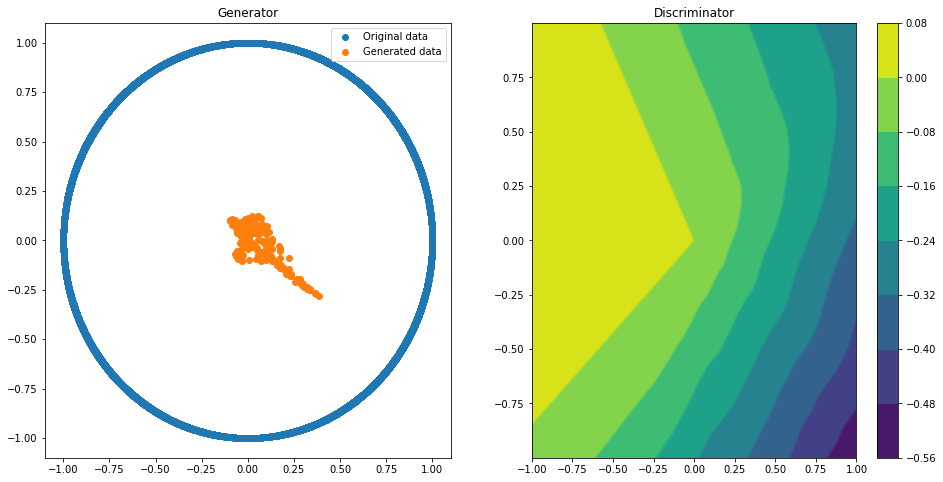

Epoch 000 | ET 0.55 min | Avg Losses >> G/D 0.7800/1.2386 [D-Real: 0.6101 D-Fake: 0.6285]


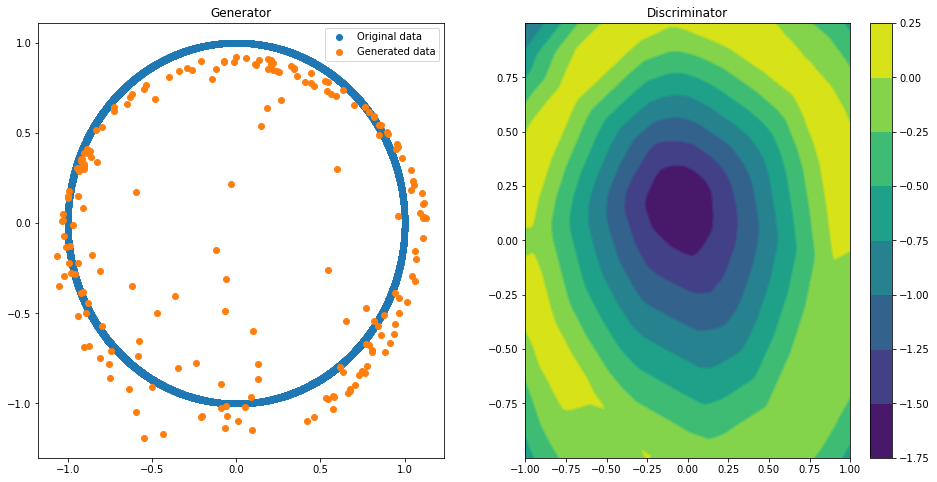

Epoch 050 | ET 1.77 min | Avg Losses >> G/D 0.7312/1.3491 [D-Real: 0.6763 D-Fake: 0.6727]


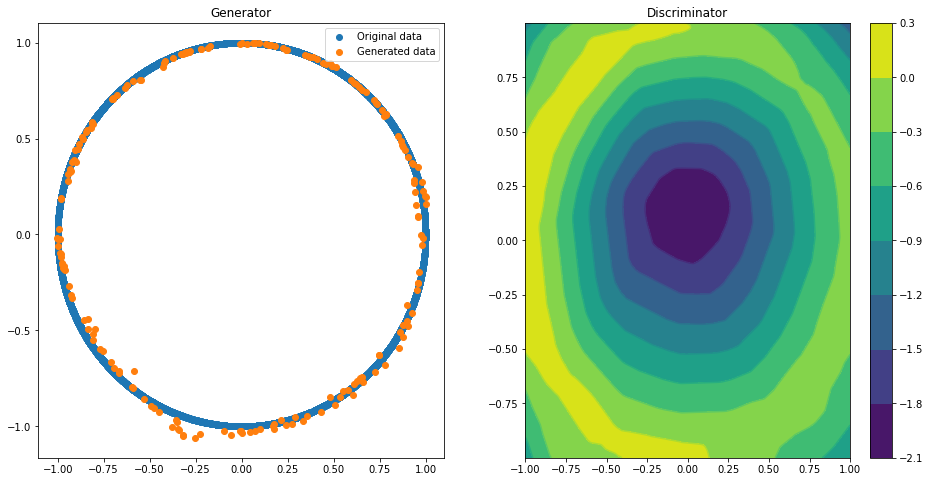

Epoch 100 | ET 2.98 min | Avg Losses >> G/D 0.6992/1.3840 [D-Real: 0.6923 D-Fake: 0.6917]


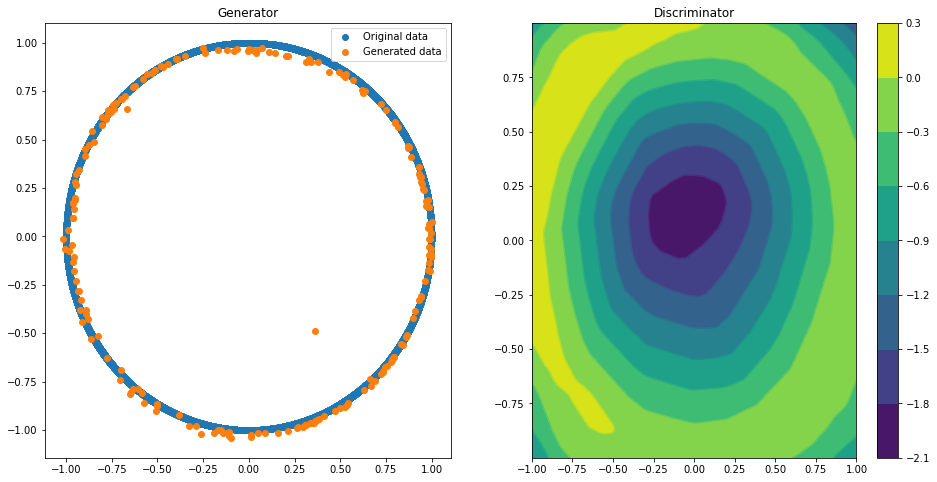

Epoch 150 | ET 4.22 min | Avg Losses >> G/D 0.6994/1.3855 [D-Real: 0.6944 D-Fake: 0.6912]


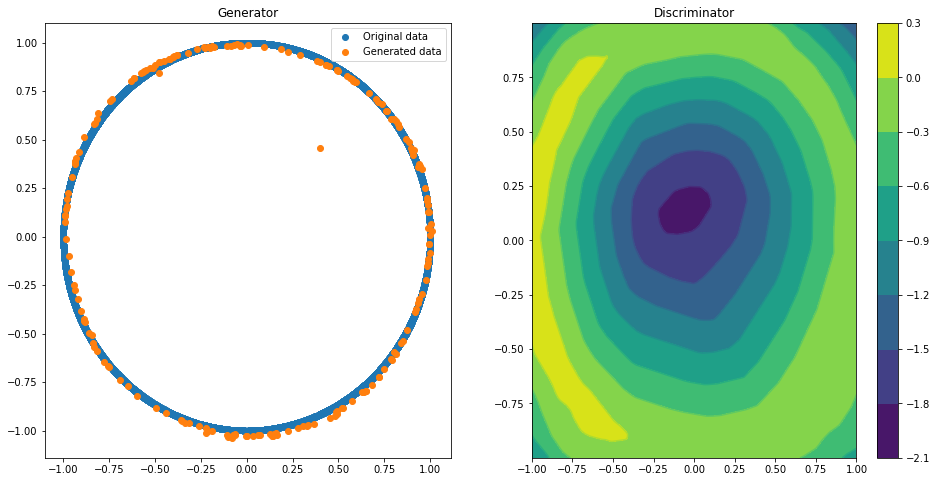

Epoch 200 | ET 5.50 min | Avg Losses >> G/D 0.6957/1.3858 [D-Real: 0.6926 D-Fake: 0.6931]


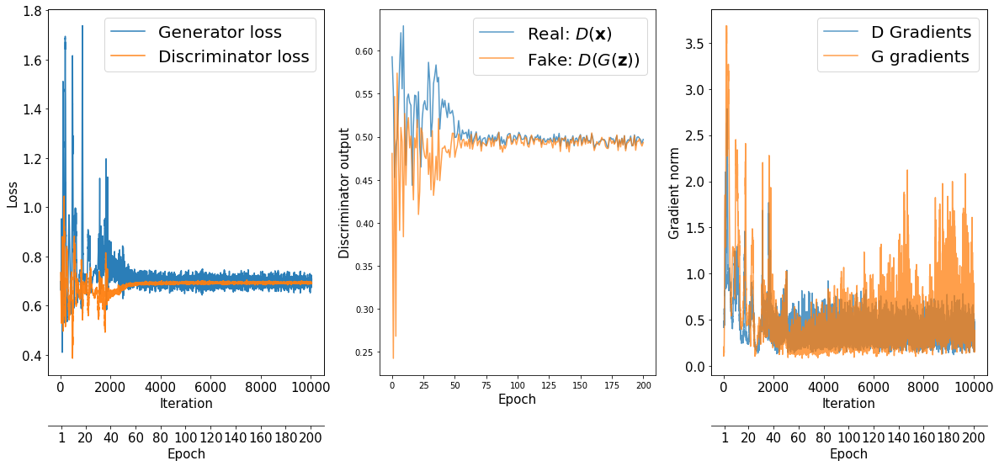

In [ ]:
numpy_data = circle
data = tf.data.Dataset.from_tensor_slices(numpy_data).batch(batch_size)

with tf.device(device_name):
  gen_model = make_generator_network()
  gen_model.build(input_shape=(None,z_size))
  disc_model = make_discriminator_network()
  disc_model.build(input_shape=(None,2))


loss_fn = tf.keras.losses.BinaryCrossentropy(from_logits=True)
g_optimizer = tf.keras.optimizers.Adam()
d_optimizer = tf.keras.optimizers.Adam()
all_losses = []
all_d_vals = []
d_gradients = []
g_gradients = []
epoch_samples = []
start_time = time.time()
for epoch in range(0, num_epochs+1):
  epoch_losses, epoch_d_vals = [], []
  #Plotting every 50
  if epoch%50 == 0:
      input_z = tf.random.uniform(shape = (200,z_size), minval=-1,maxval=1)
      epoch_samples.append(gen_model(input_z, training=False).numpy())
      X_data, Y_data = numpy_data[:,0], numpy_data[:,1]
      x = np.linspace(np.min(X_data), np.max(X_data), 200)
      y = np.linspace(np.min(Y_data), np.max(Y_data), 200)
      X, Y = np.meshgrid(x, y)
      Z = np.zeros((len(x), len(y)))
      for i in range(len(x)):
        for j in range(len(y)):
          q = tf.convert_to_tensor(np.array([[x[i],y[j]]]).astype("float32"))
          Z[i][j] = disc_model(q).numpy()[0][0]
      f, (ax1, ax2) = plt.subplots(1, 2, figsize = (16,8))
      ax1.scatter(X_data,Y_data, label = "Original data")
      ax1.scatter(epoch_samples[-1][:,0],epoch_samples[-1][:,1], label="Generated data")
      ax1.set_title("Generator")
      ax1.legend()
      ax2.contour(X,Y,Z)
      ax2.set_title("Discriminator")
      cp = ax2.contourf(X , Y , Z)
      plt.colorbar(cp, ax=ax2)
      plt.show()
  for batch in data:
    input_z = tf.random.uniform(shape = (batch_size,z_size), minval=-1,maxval=1)
      #Compute generator's loss
    with tf.GradientTape() as g_tape:
      g_output = gen_model(input_z)
      d_logits_fake = disc_model(g_output,
                                  training=True)
      labels_real = tf.ones_like(d_logits_fake)
      g_loss = loss_fn(y_true=labels_real,
                        y_pred=d_logits_fake)
      #Compute the gradients of g_loss
    g_grads = g_tape.gradient(g_loss,
                                gen_model.trainable_variables)
    g_gradients.append(tf.linalg.global_norm(g_grads).numpy())
      #Apply the gradients
    g_optimizer.apply_gradients(
          grads_and_vars=zip(g_grads,
                            gen_model.trainable_variables)
      )

      #Compute the discriminator's loss
    with tf.GradientTape() as d_tape:
      d_logits_real = disc_model(batch,
                                  training=True)
      d_labels_real = tf.ones_like(d_logits_real)
      d_loss_real = loss_fn(y_true=d_labels_real,
                              y_pred=d_logits_real)
      d_logits_fake = disc_model(g_output,
                                  training=True)
      d_labels_fake = tf.zeros_like(d_logits_fake)
      d_loss_fake = loss_fn(y_true=d_labels_fake,
                              y_pred=d_logits_fake)
      d_loss = d_loss_real + d_loss_fake

      #Compute the gradients of d_loss
    d_grads = d_tape.gradient(d_loss,
                                disc_model.trainable_variables)
    d_gradients.append(tf.linalg.global_norm(d_grads).numpy())
    d_optimizer.apply_gradients(grads_and_vars=zip(d_grads,
                                                    disc_model.trainable_variables))
      
    epoch_losses.append(
                          (g_loss.numpy(), d_loss.numpy(),
                          d_loss_real.numpy(), d_loss_fake.numpy()))
    d_probs_real = tf.reduce_mean(
                          tf.sigmoid(d_logits_real))
    d_probs_fake = tf.reduce_mean(
                          tf.sigmoid(d_logits_fake))
  epoch_d_vals.append((d_probs_real.numpy(),
                          d_probs_fake.numpy()))
  all_losses.append(epoch_losses)
  all_d_vals.append(epoch_d_vals)
  if epoch%50 == 0:
      print(
            'Epoch {:03d} | ET {:.2f} min | Avg Losses >>'
            ' G/D {:.4f}/{:.4f} [D-Real: {:.4f} D-Fake: {:.4f}]'
            .format(
            epoch, (time.time() - start_time)/60,
            *list(np.mean(all_losses[-1], axis=0))))
fig = plt.figure(figsize=(20, 8))

## Plotting the losses
ax = fig.add_subplot(1, 3, 1)
g_losses = [item[0] for item in itertools.chain(*all_losses)]
d_losses = [item[1]/2.0 for item in itertools.chain(*all_losses)]
plt.plot(g_losses, label='Generator loss', alpha=0.95)
plt.plot(d_losses, label='Discriminator loss', alpha=0.95)
plt.legend(fontsize=20)
ax.set_xlabel('Iteration', size=15)
ax.set_ylabel('Loss', size=15)

epochs = np.arange(1, 101)
epoch2iter = lambda e: e*len(all_losses[-1])
epoch_ticks = [1, 20, 40, 60, 80, 100, 120, 140, 160, 180, 200]
newpos = [epoch2iter(e) for e in epoch_ticks]
ax2 = ax.twiny()
ax2.set_xticks(newpos)
ax2.set_xticklabels(epoch_ticks)
ax2.xaxis.set_ticks_position('bottom')
ax2.xaxis.set_label_position('bottom')
ax2.spines['bottom'].set_position(('outward', 60))
ax2.set_xlabel('Epoch', size=15)
ax2.set_xlim(ax.get_xlim())
ax.tick_params(axis='both', which='major', labelsize=15)
ax2.tick_params(axis='both', which='major', labelsize=15)

## Plotting the outputs of the discriminator
ax = fig.add_subplot(1, 3, 2)
d_vals_real = [item[0] for item in itertools.chain(*all_d_vals)]
d_vals_fake = [item[1] for item in itertools.chain(*all_d_vals)]
plt.plot(d_vals_real, alpha=0.75, label=r'Real: $D(\mathbf{x})$')
plt.plot(d_vals_fake, alpha=0.75, label=r'Fake: $D(G(\mathbf{z}))$')
plt.legend(fontsize=20)
ax.set_xlabel('Epoch', size=15)
ax.set_ylabel('Discriminator output', size=15)


ax = fig.add_subplot(1, 3, 3)
plt.plot(d_gradients, label = "D Gradients", alpha=.75)
plt.plot(g_gradients, label = "G gradients", alpha = .75)
plt.legend(fontsize=20)
ax.set_xlabel('Iteration', size=15)
ax.set_ylabel('Gradient norm', size=15)
ax2 = ax.twiny()
ax2.set_xticks(newpos)
ax2.set_xticklabels(epoch_ticks)
ax2.xaxis.set_ticks_position('bottom')
ax2.xaxis.set_label_position('bottom')
ax2.spines['bottom'].set_position(('outward', 60))
ax2.set_xlabel('Epoch', size=15)
ax2.set_xlim(ax.get_xlim())
ax.tick_params(axis='both', which='major', labelsize=15)
ax2.tick_params(axis='both', which='major', labelsize=15)

#plt.savefig('images/ch17-gan-learning-curve.pdf')
plt.show()

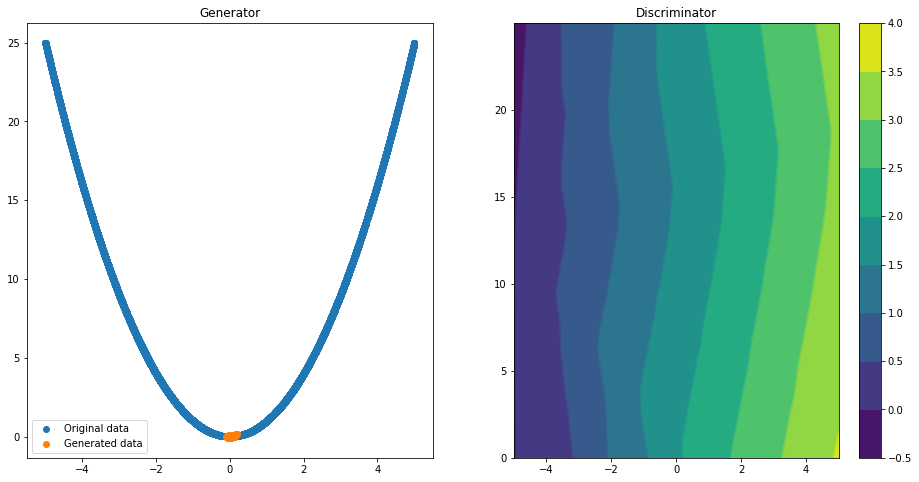

Epoch 000 | ET 0.55 min | Avg Losses >> G/D 0.6732/0.9770 [D-Real: 0.2566 D-Fake: 0.7203]


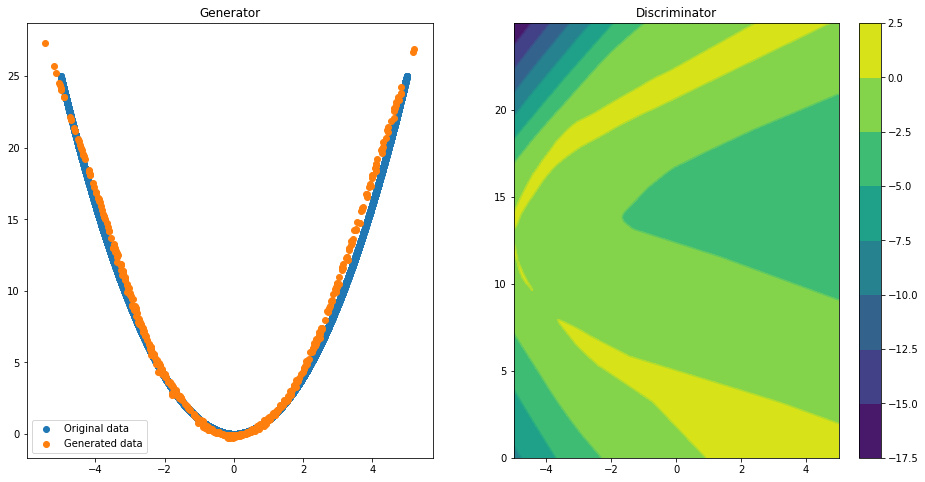

Epoch 050 | ET 1.78 min | Avg Losses >> G/D 0.7049/1.4081 [D-Real: 0.7078 D-Fake: 0.7003]


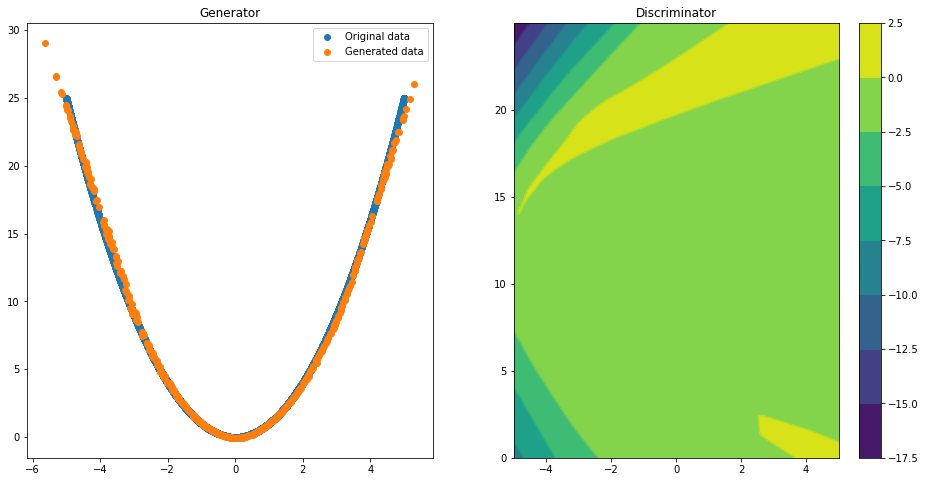

Epoch 100 | ET 3.01 min | Avg Losses >> G/D 0.6969/1.3892 [D-Real: 0.6946 D-Fake: 0.6946]


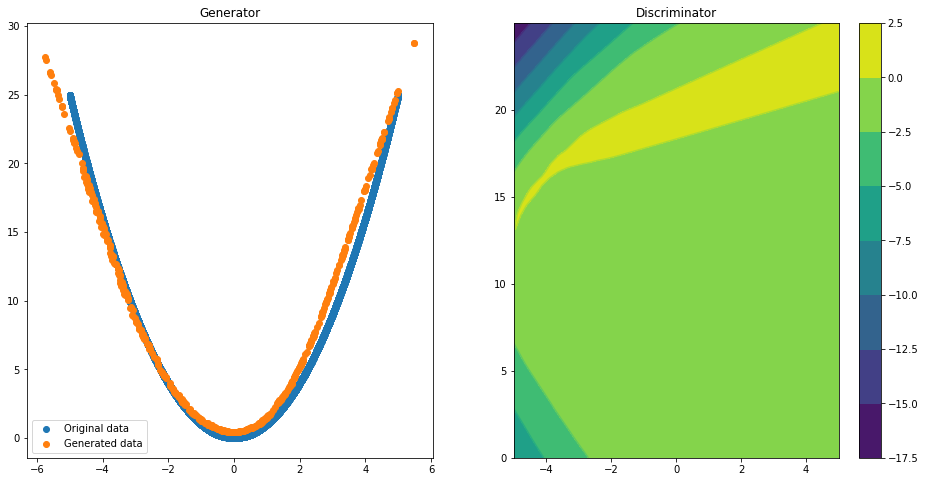

Epoch 150 | ET 4.23 min | Avg Losses >> G/D 0.6993/1.3900 [D-Real: 0.6886 D-Fake: 0.7015]


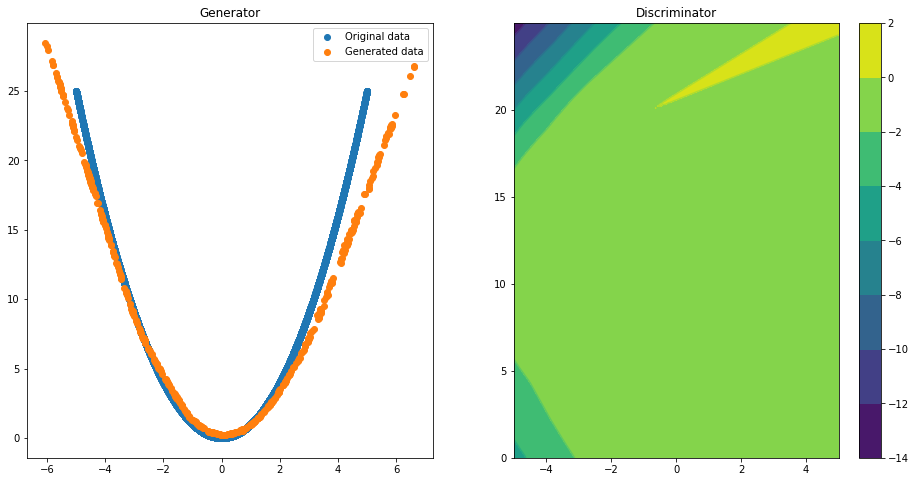

Epoch 200 | ET 5.46 min | Avg Losses >> G/D 0.7065/1.3847 [D-Real: 0.6988 D-Fake: 0.6859]


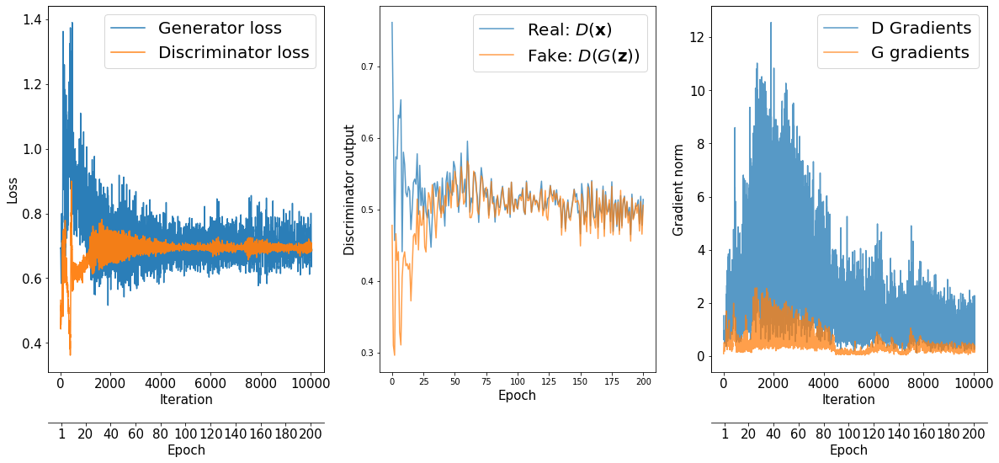

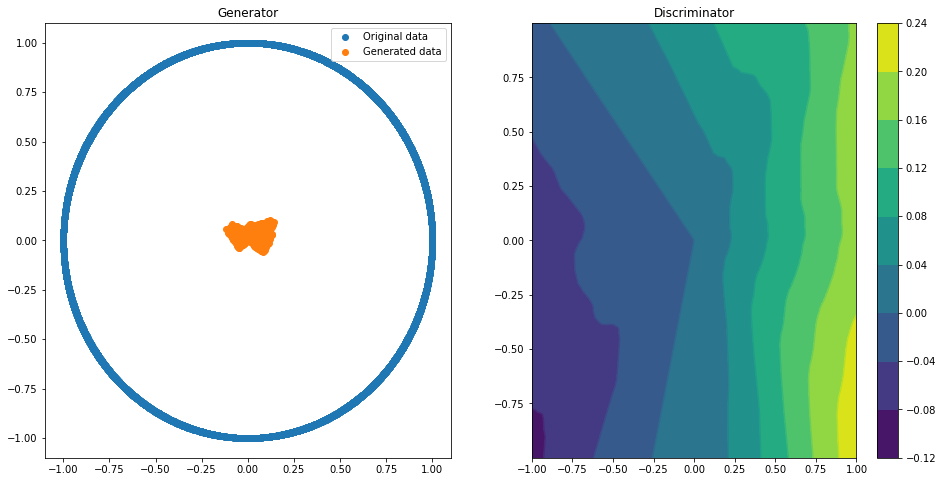

Epoch 000 | ET 0.56 min | Avg Losses >> G/D 0.7805/1.2200 [D-Real: 0.5870 D-Fake: 0.6330]


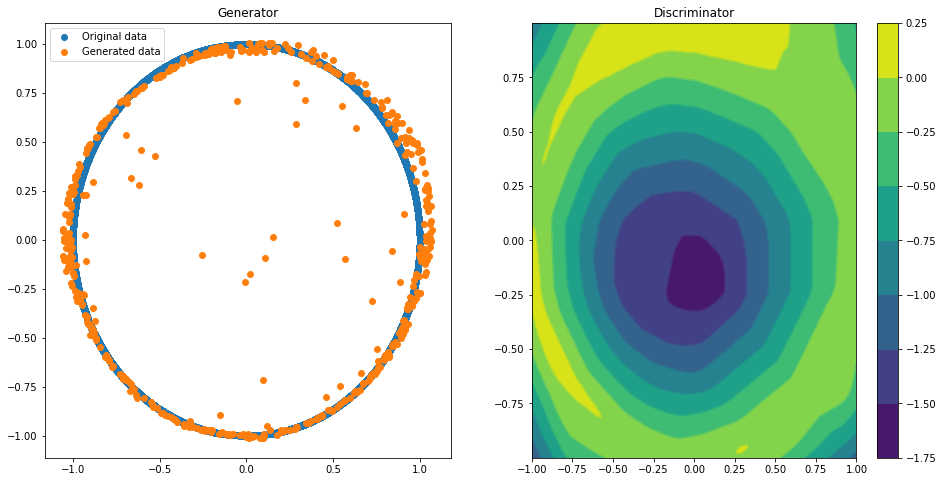

Epoch 050 | ET 1.80 min | Avg Losses >> G/D 0.7016/1.3762 [D-Real: 0.6844 D-Fake: 0.6917]


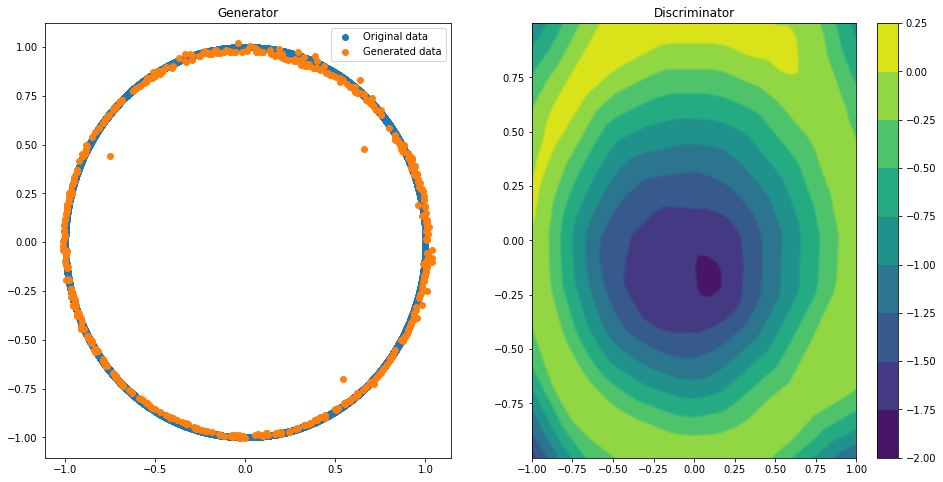

Epoch 100 | ET 3.03 min | Avg Losses >> G/D 0.6963/1.3844 [D-Real: 0.6920 D-Fake: 0.6925]


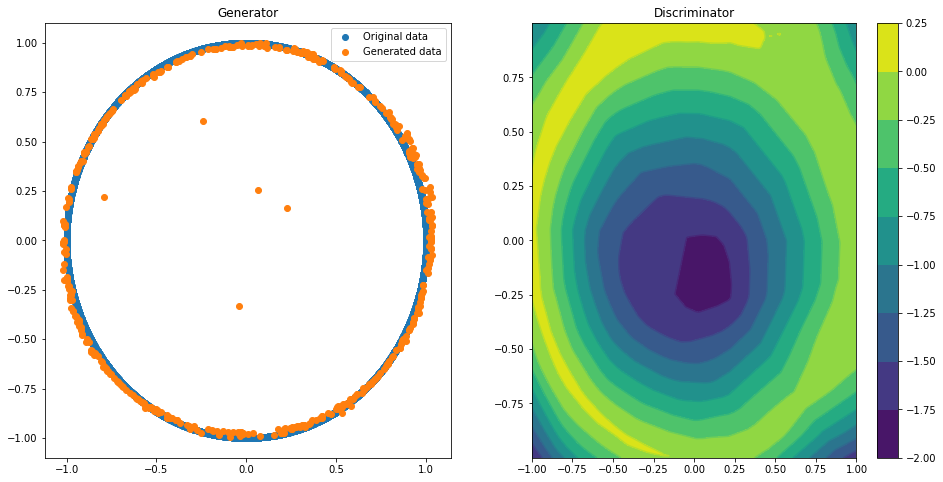

Epoch 150 | ET 4.26 min | Avg Losses >> G/D 0.6949/1.3844 [D-Real: 0.6910 D-Fake: 0.6934]


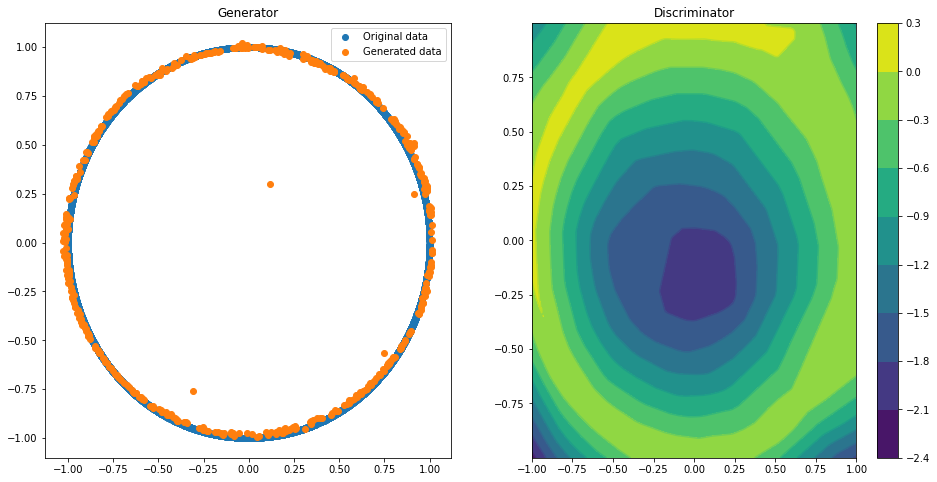

Epoch 200 | ET 5.49 min | Avg Losses >> G/D 0.6970/1.3846 [D-Real: 0.6932 D-Fake: 0.6915]


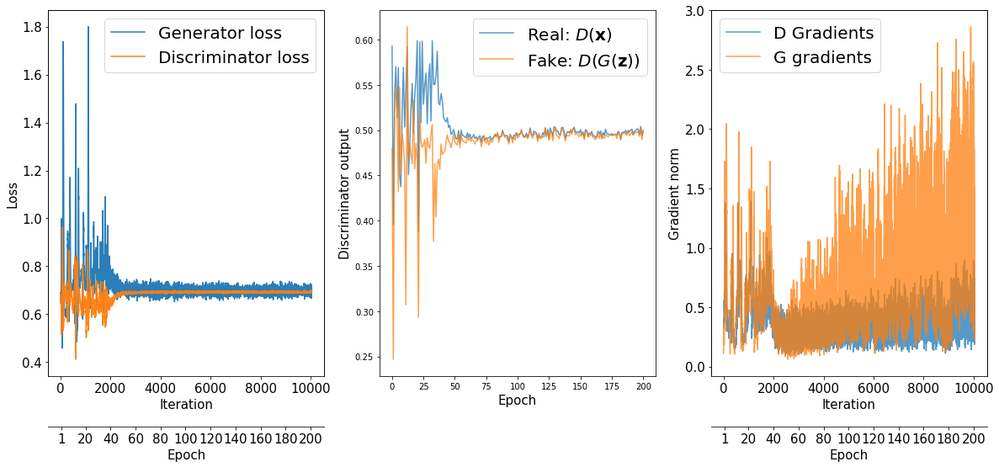

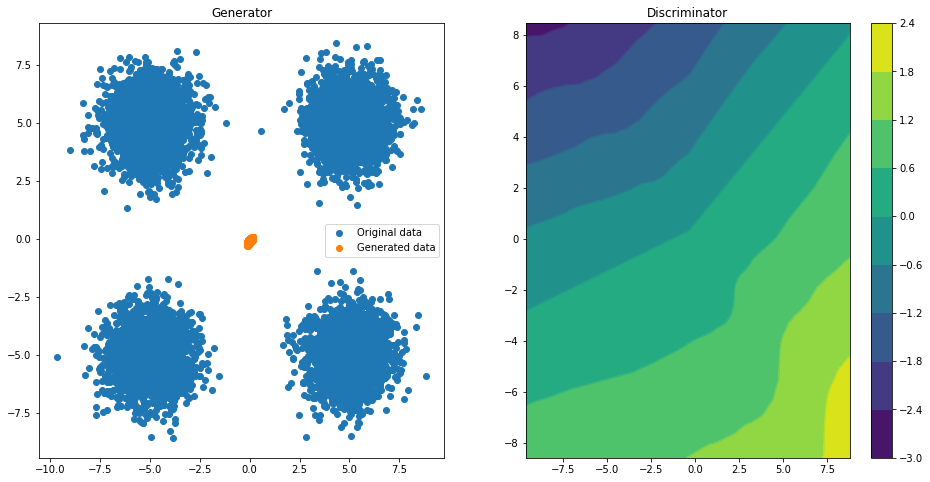

Epoch 000 | ET 0.56 min | Avg Losses >> G/D 0.6726/0.9005 [D-Real: 0.1800 D-Fake: 0.7205]


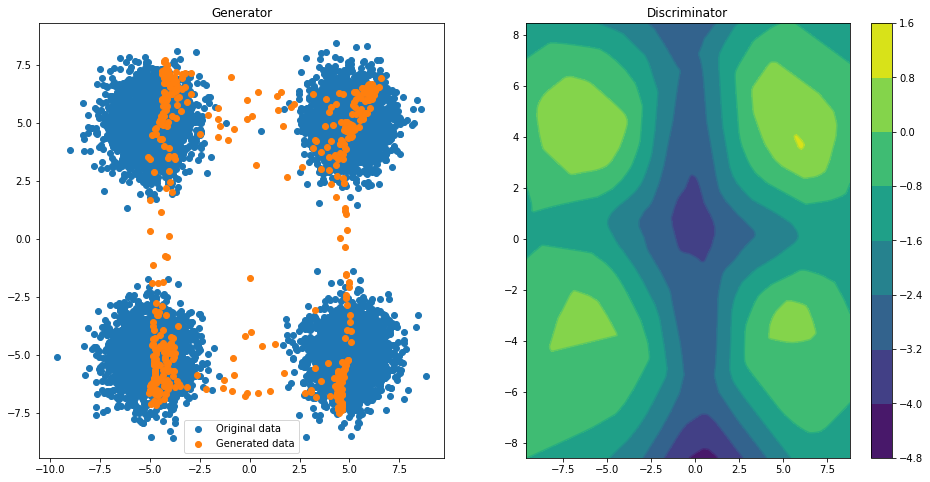

Epoch 050 | ET 1.79 min | Avg Losses >> G/D 0.8168/1.3480 [D-Real: 0.6650 D-Fake: 0.6830]


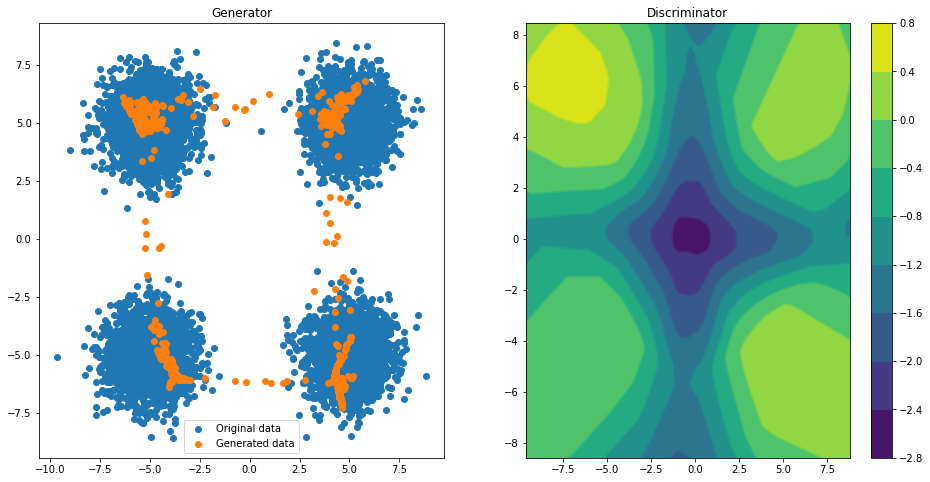

Epoch 100 | ET 3.01 min | Avg Losses >> G/D 0.7453/1.3896 [D-Real: 0.7180 D-Fake: 0.6716]


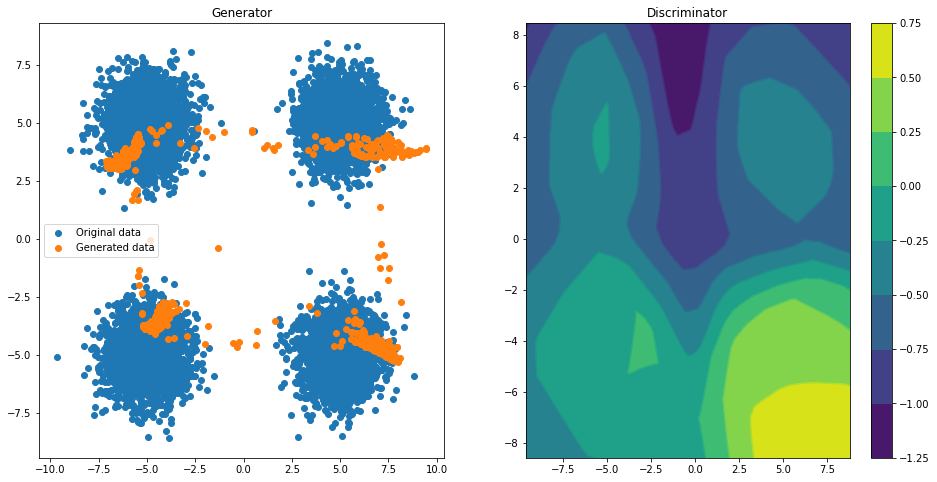

Epoch 150 | ET 4.23 min | Avg Losses >> G/D 0.7010/1.3922 [D-Real: 0.6808 D-Fake: 0.7113]


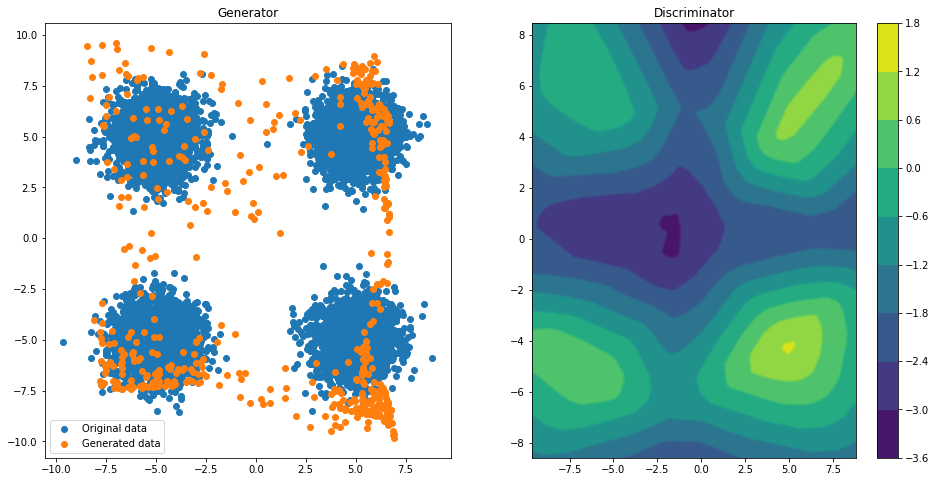

Epoch 200 | ET 5.42 min | Avg Losses >> G/D 0.9005/1.2589 [D-Real: 0.6155 D-Fake: 0.6434]


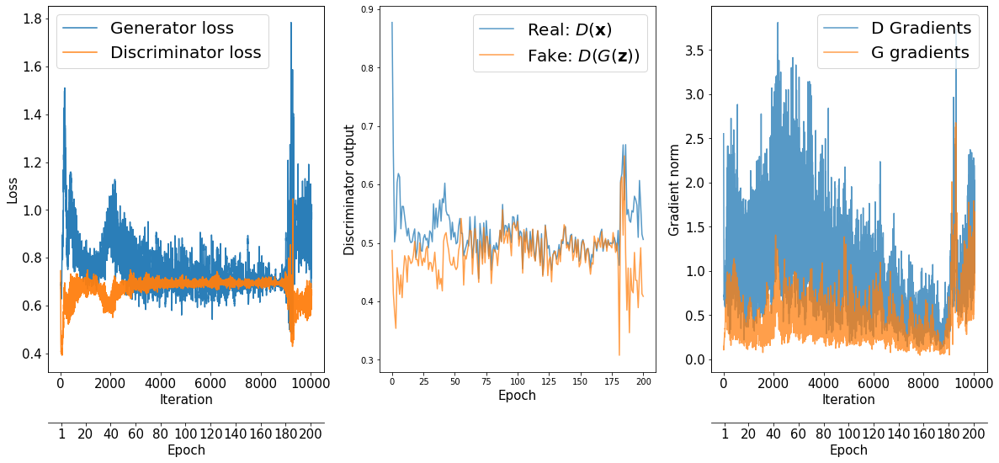

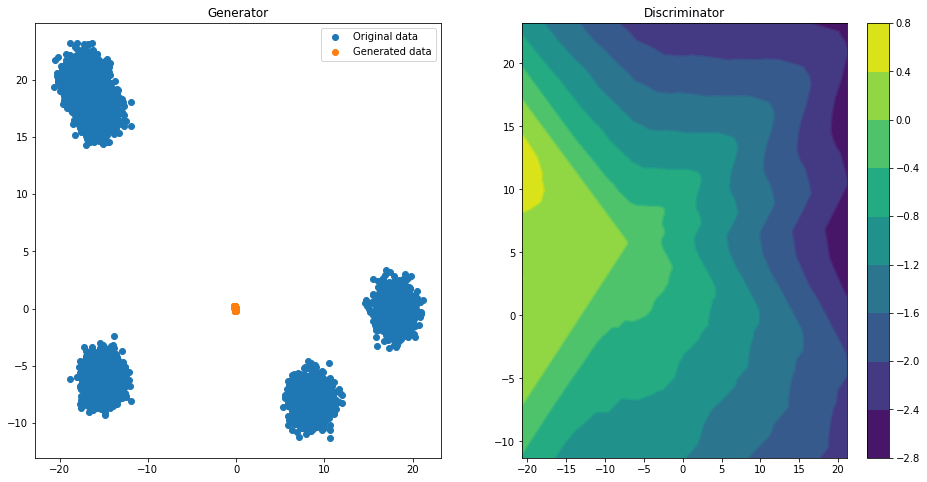

Epoch 000 | ET 0.55 min | Avg Losses >> G/D 0.6751/0.8573 [D-Real: 0.1432 D-Fake: 0.7141]


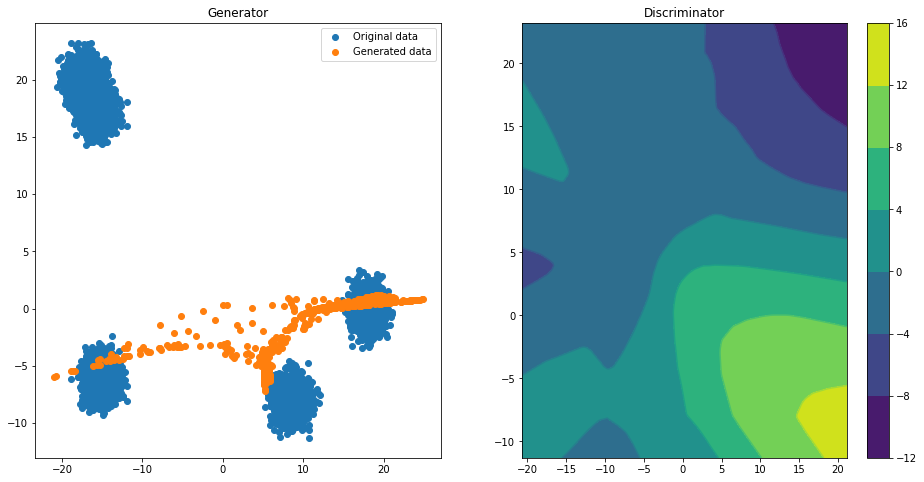

Epoch 050 | ET 1.74 min | Avg Losses >> G/D 1.4452/0.8729 [D-Real: 0.5086 D-Fake: 0.3644]


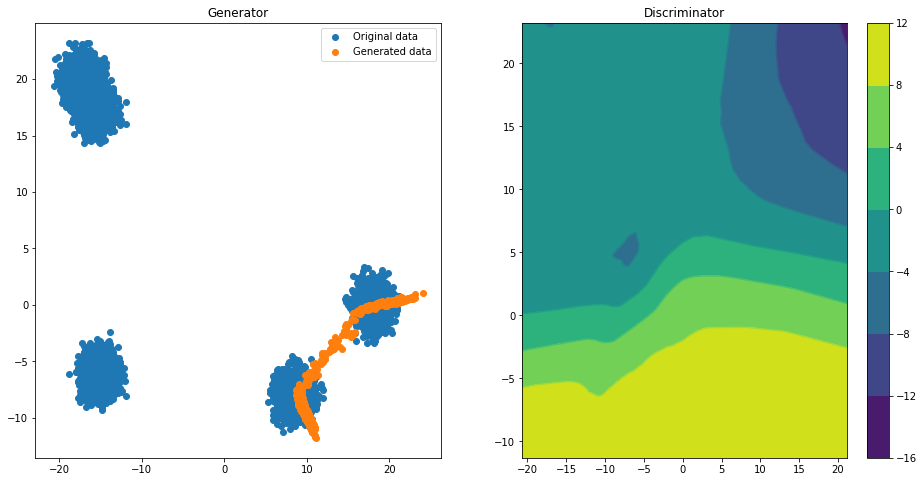

Epoch 100 | ET 2.95 min | Avg Losses >> G/D 1.4051/0.8402 [D-Real: 0.5311 D-Fake: 0.3091]


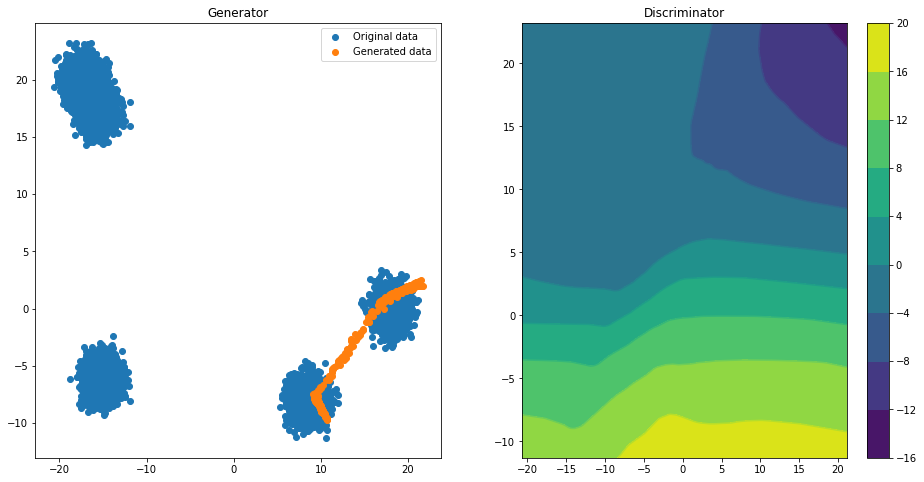

Epoch 150 | ET 4.15 min | Avg Losses >> G/D 1.2388/0.8437 [D-Real: 0.4958 D-Fake: 0.3478]


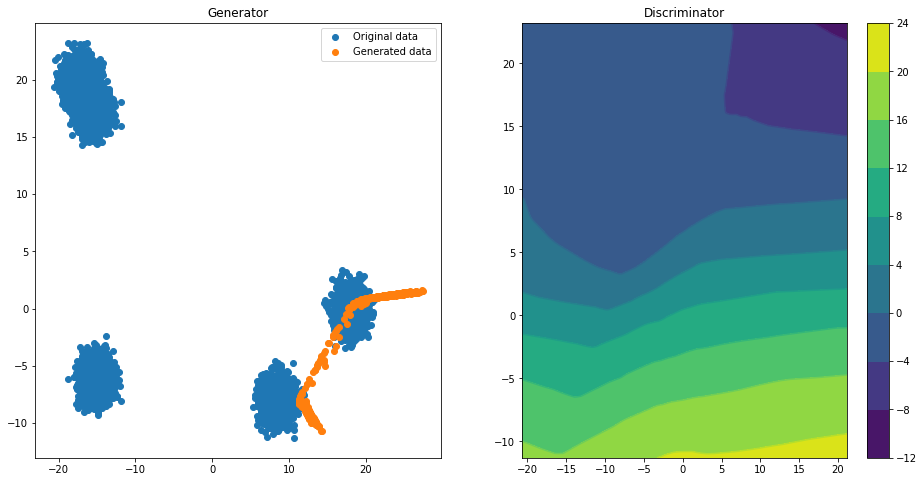

Epoch 200 | ET 5.33 min | Avg Losses >> G/D 1.2263/0.8442 [D-Real: 0.4866 D-Fake: 0.3576]


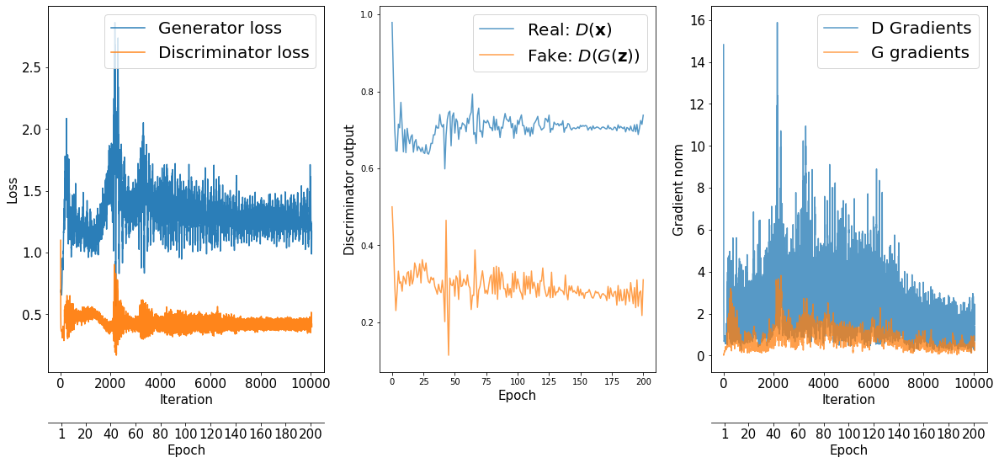

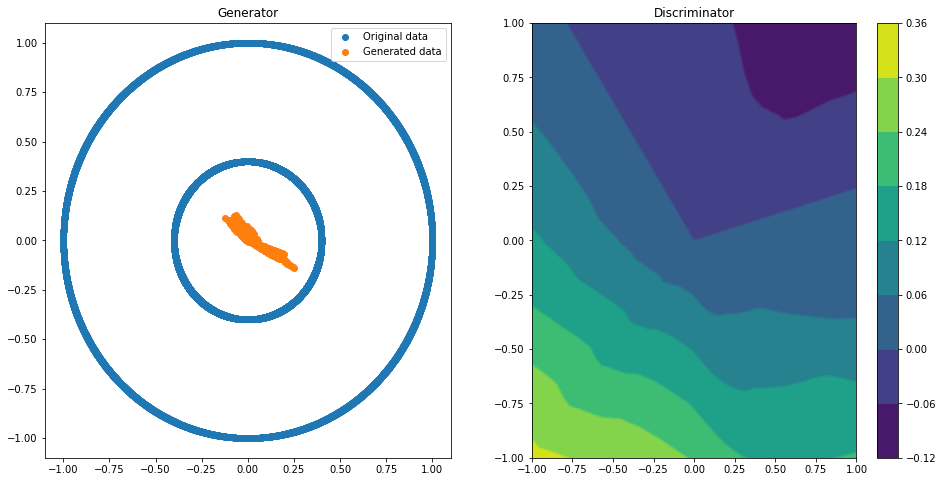

Epoch 000 | ET 0.55 min | Avg Losses >> G/D 0.7308/1.2797 [D-Real: 0.6112 D-Fake: 0.6685]


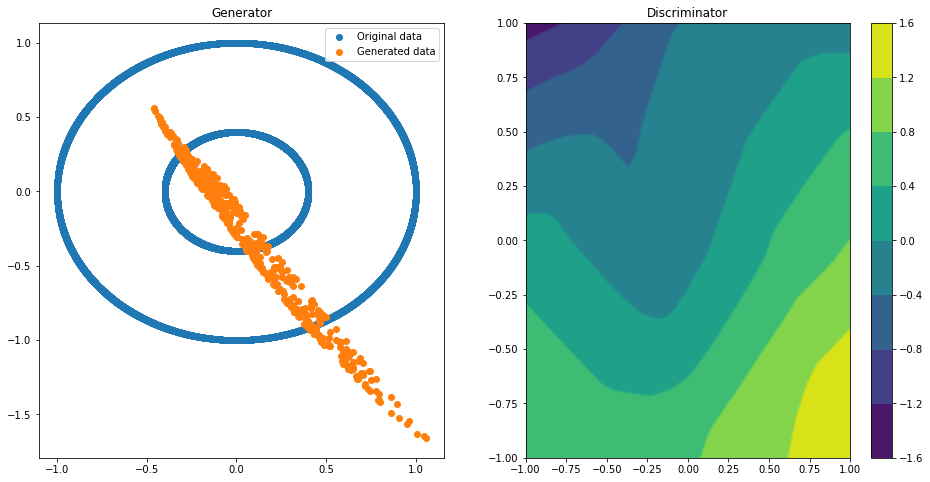

Epoch 050 | ET 1.75 min | Avg Losses >> G/D 0.7363/1.3086 [D-Real: 0.6136 D-Fake: 0.6950]


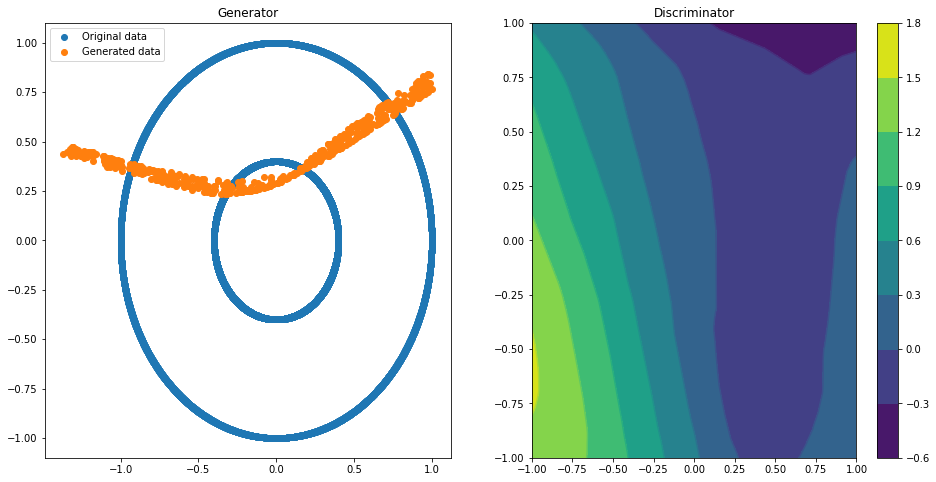

Epoch 100 | ET 2.99 min | Avg Losses >> G/D 0.7852/1.1896 [D-Real: 0.5785 D-Fake: 0.6111]


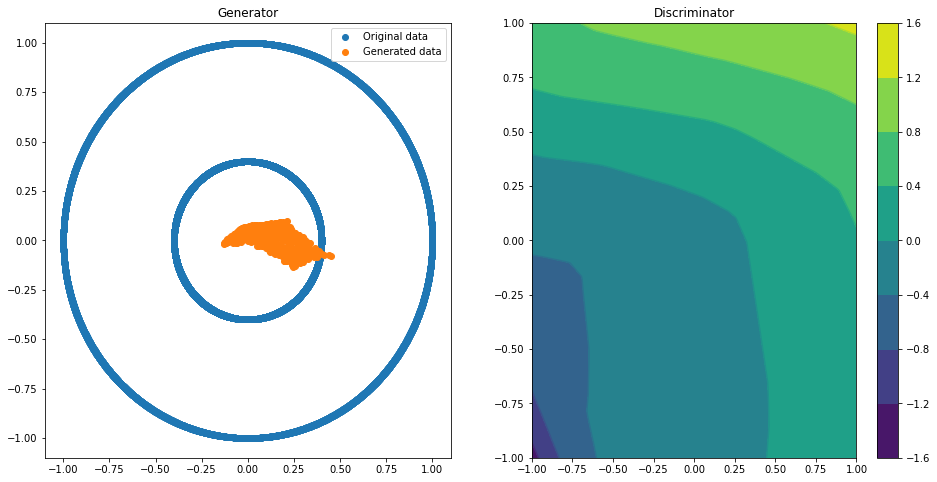

Epoch 150 | ET 4.22 min | Avg Losses >> G/D 0.6918/1.3800 [D-Real: 0.6751 D-Fake: 0.7049]


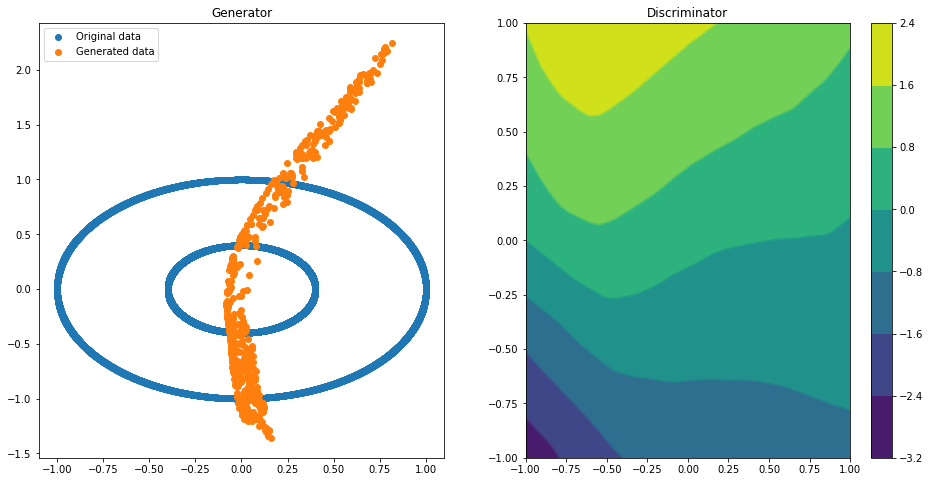

Epoch 200 | ET 5.42 min | Avg Losses >> G/D 0.6210/1.5556 [D-Real: 0.7627 D-Fake: 0.7929]


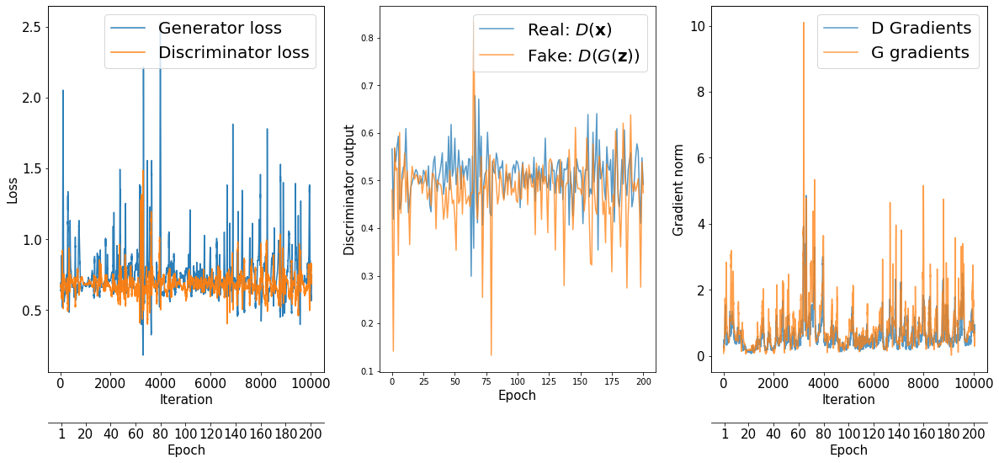

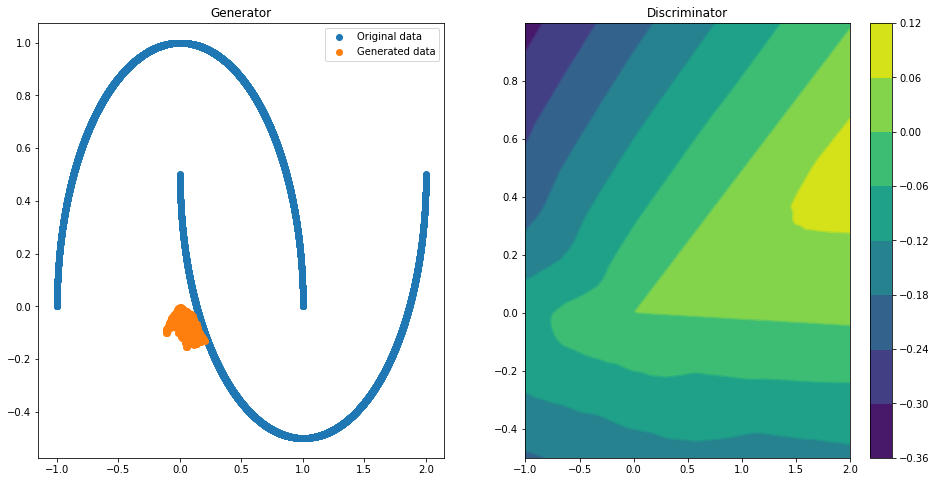

Epoch 000 | ET 0.55 min | Avg Losses >> G/D 0.6427/1.2816 [D-Real: 0.5288 D-Fake: 0.7528]


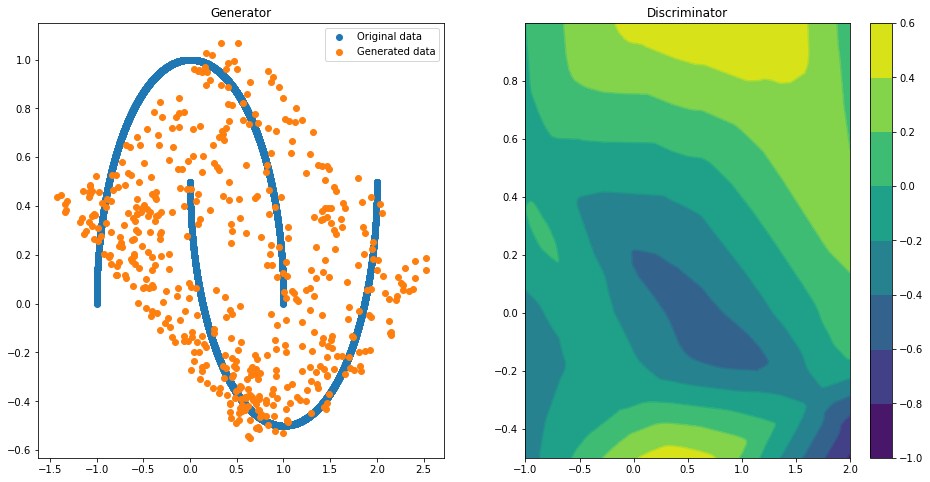

Epoch 050 | ET 1.76 min | Avg Losses >> G/D 0.7372/1.3597 [D-Real: 0.6967 D-Fake: 0.6630]


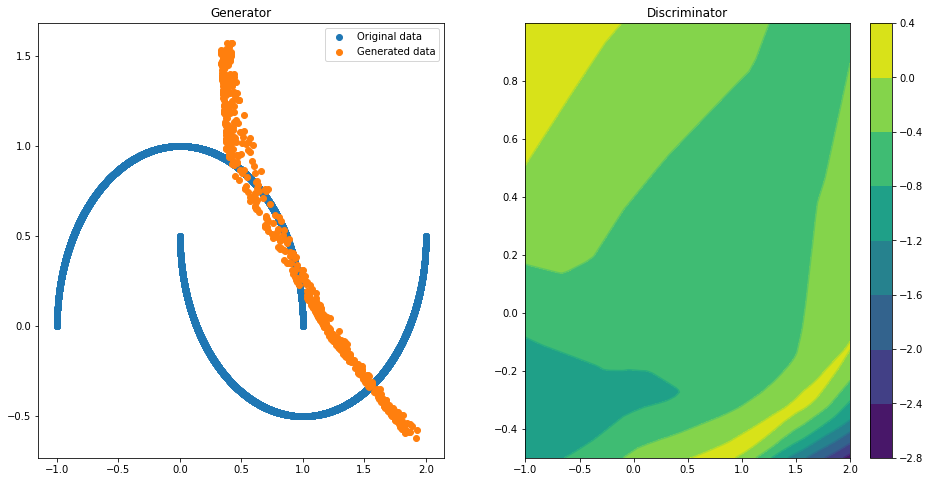

Epoch 100 | ET 2.98 min | Avg Losses >> G/D 0.8559/1.3012 [D-Real: 0.7372 D-Fake: 0.5640]


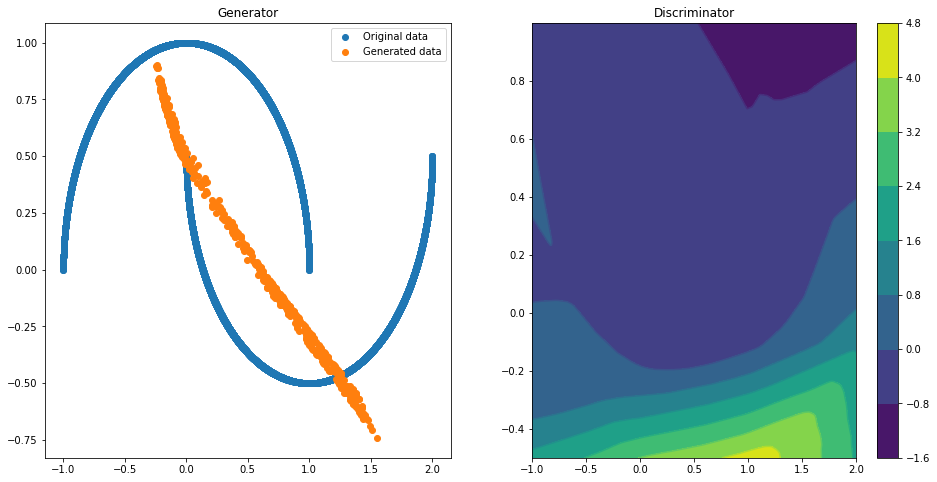

Epoch 150 | ET 4.19 min | Avg Losses >> G/D 0.7573/1.3534 [D-Real: 0.6773 D-Fake: 0.6760]


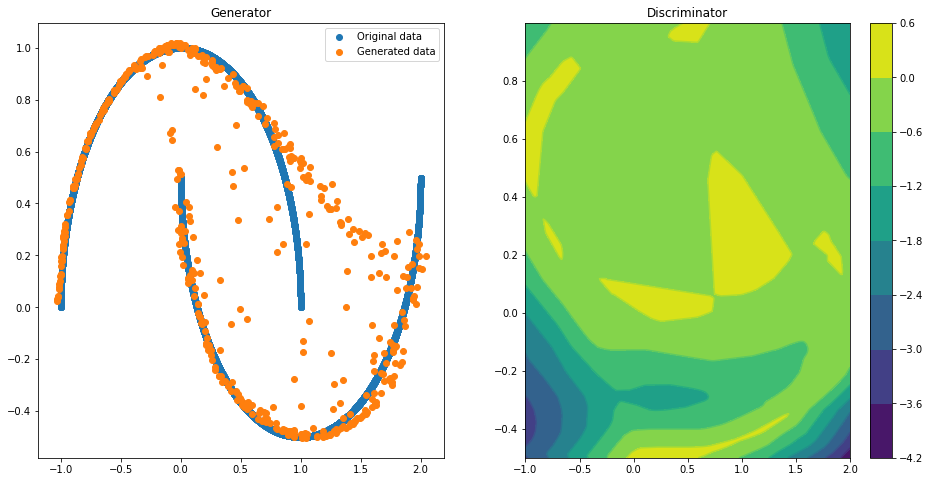

Epoch 200 | ET 5.42 min | Avg Losses >> G/D 0.6990/1.3783 [D-Real: 0.6873 D-Fake: 0.6910]


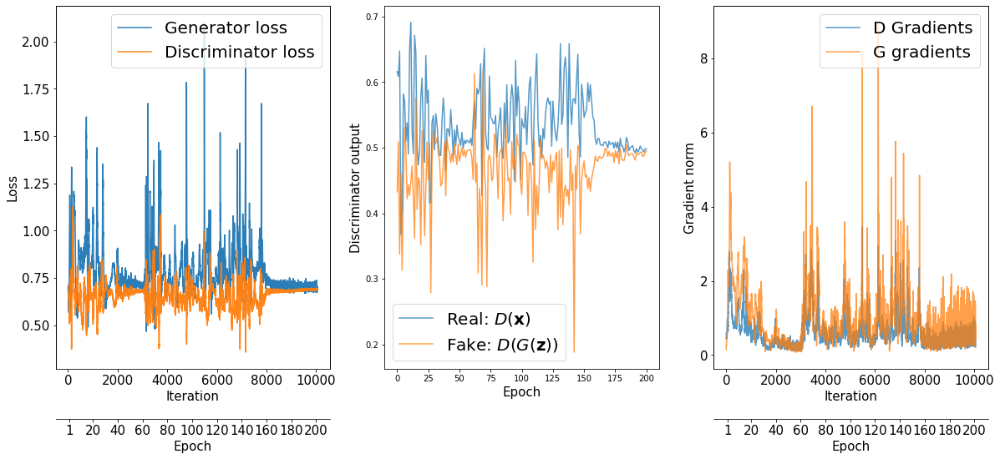

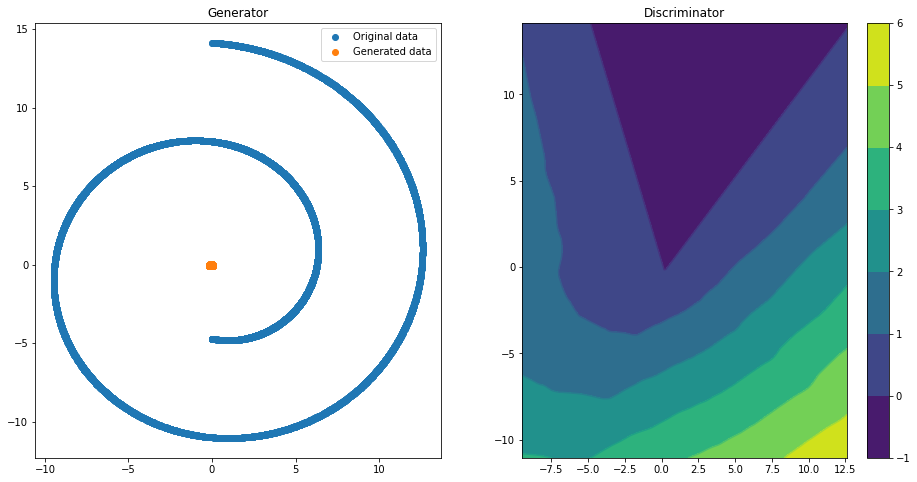

Epoch 000 | ET 0.56 min | Avg Losses >> G/D 0.8333/0.6669 [D-Real: 0.0863 D-Fake: 0.5806]


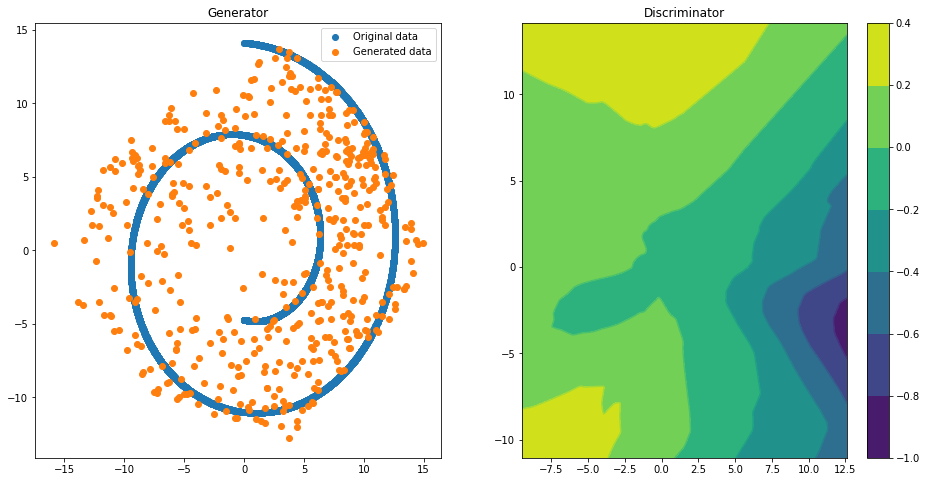

Epoch 050 | ET 1.79 min | Avg Losses >> G/D 0.6975/1.3801 [D-Real: 0.6763 D-Fake: 0.7038]


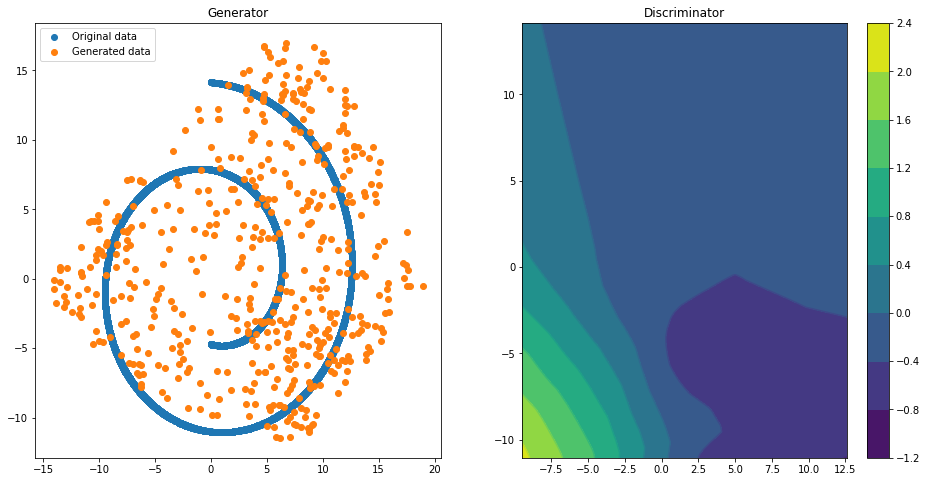

Epoch 100 | ET 3.01 min | Avg Losses >> G/D 0.7491/1.3844 [D-Real: 0.7238 D-Fake: 0.6606]


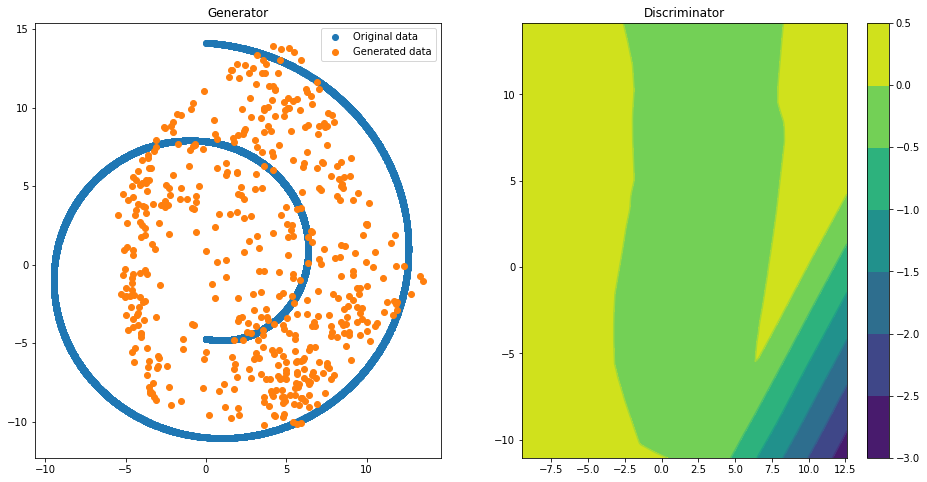

Epoch 150 | ET 4.27 min | Avg Losses >> G/D 0.7420/1.3493 [D-Real: 0.6892 D-Fake: 0.6600]


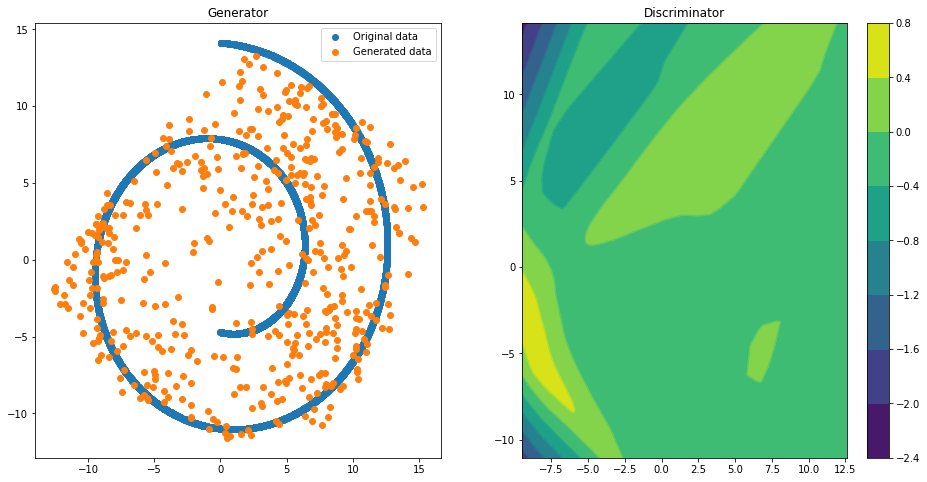

Epoch 200 | ET 5.52 min | Avg Losses >> G/D 0.7252/1.3378 [D-Real: 0.6639 D-Fake: 0.6740]


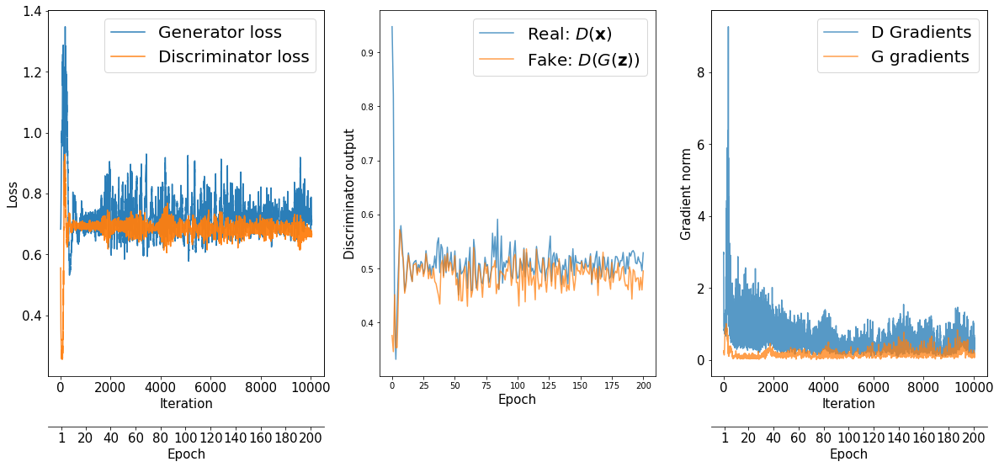

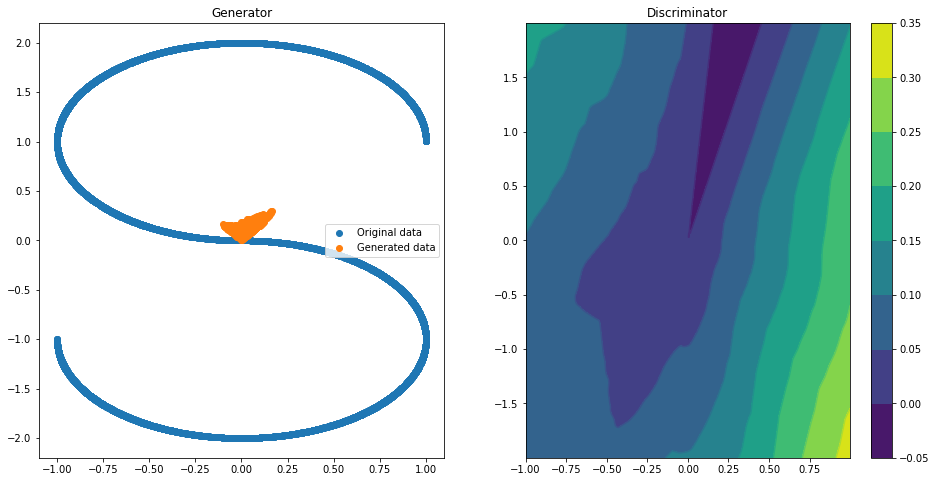

Epoch 000 | ET 0.56 min | Avg Losses >> G/D 0.8134/1.1324 [D-Real: 0.5275 D-Fake: 0.6049]


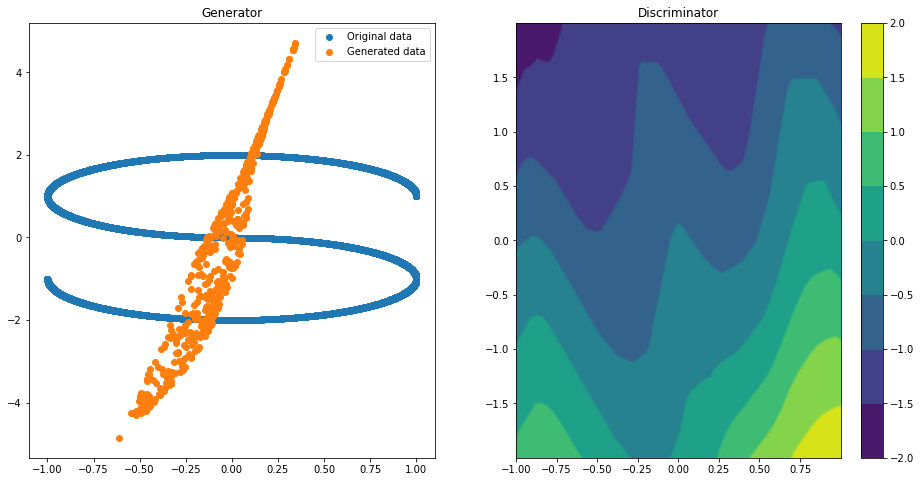

Epoch 050 | ET 1.84 min | Avg Losses >> G/D 0.7010/1.3502 [D-Real: 0.6063 D-Fake: 0.7439]


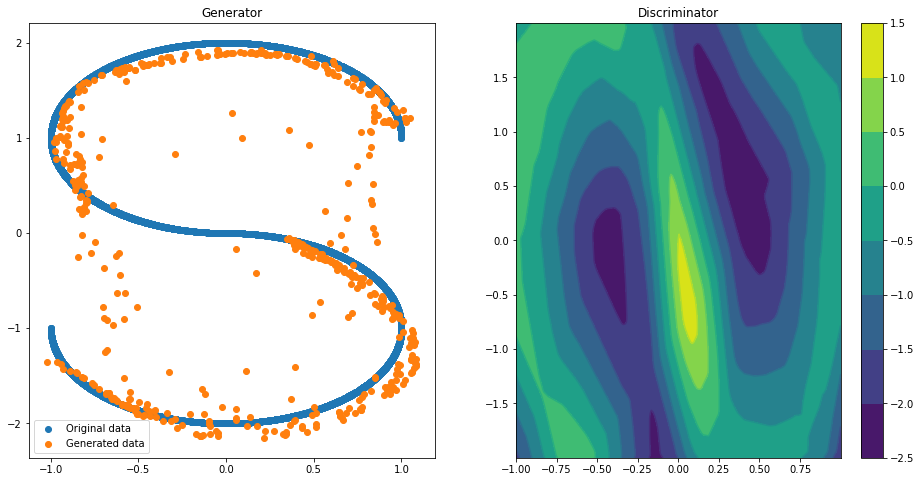

Epoch 100 | ET 3.10 min | Avg Losses >> G/D 0.7861/1.3018 [D-Real: 0.6472 D-Fake: 0.6546]


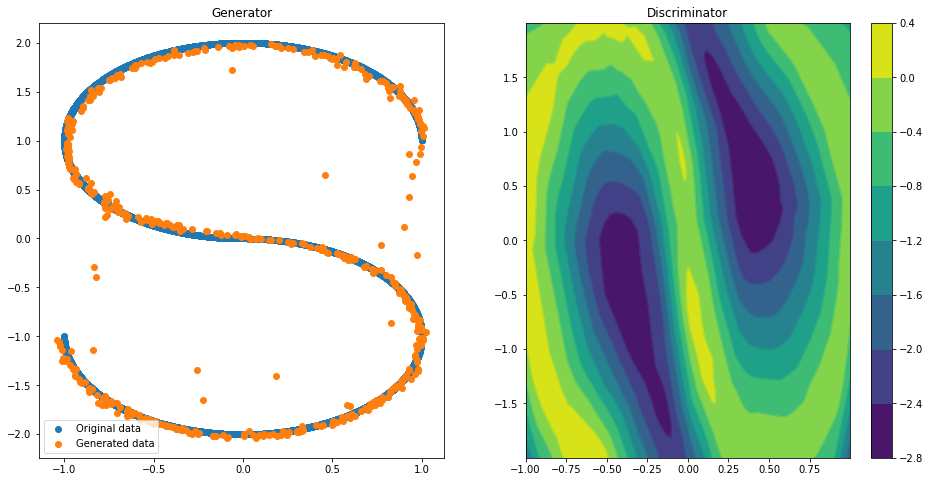

Epoch 150 | ET 4.38 min | Avg Losses >> G/D 0.7194/1.3702 [D-Real: 0.6841 D-Fake: 0.6861]


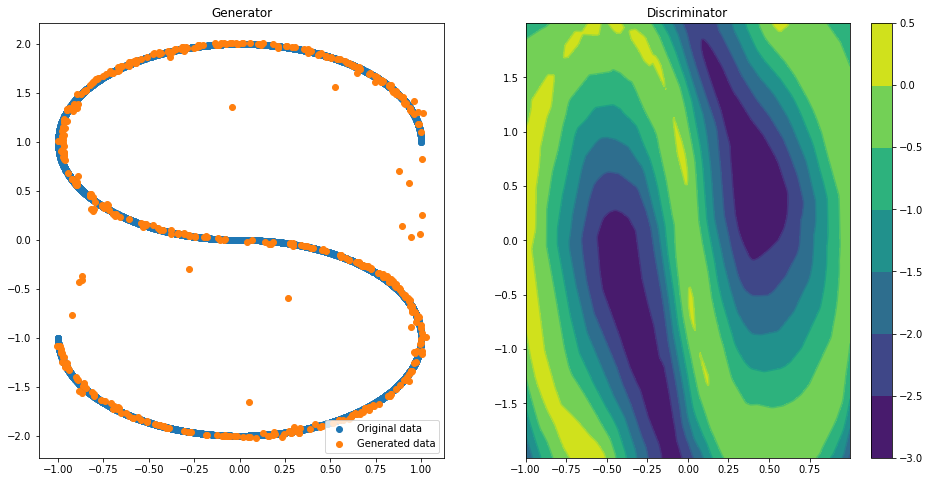

Epoch 200 | ET 5.63 min | Avg Losses >> G/D 0.7166/1.3734 [D-Real: 0.6853 D-Fake: 0.6881]


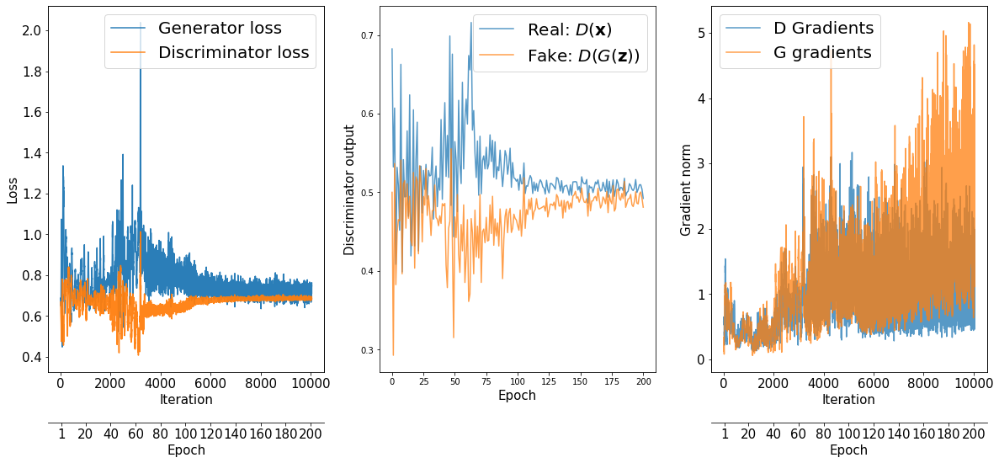

In [ ]:
for datos in [quadratic, circle, mixture, blobs, circles, moons, swiss_roll, s_curve]:
  numpy_data = datos
  data = tf.data.Dataset.from_tensor_slices(numpy_data).batch(batch_size)

  with tf.device(device_name):
    gen_model = make_generator_network()
    gen_model.build(input_shape=(None,z_size))
    disc_model = make_discriminator_network()
    disc_model.build(input_shape=(None,2))


  loss_fn = tf.keras.losses.BinaryCrossentropy(from_logits=True)
  g_optimizer = tf.keras.optimizers.Adam()
  d_optimizer = tf.keras.optimizers.Adam()
  all_losses = []
  all_d_vals = []
  d_gradients = []
  g_gradients = []
  epoch_samples = []
  start_time = time.time()
  for epoch in range(0, num_epochs+1):
    epoch_losses, epoch_d_vals = [], []
    #Plotting every 50
    if epoch%50 == 0:
        input_z = tf.random.uniform(shape = (500,z_size), minval=-1,maxval=1)
        epoch_samples.append(gen_model(input_z, training=False).numpy())
        X_data, Y_data = numpy_data[:,0], numpy_data[:,1]
        x = np.linspace(np.min(X_data), np.max(X_data), 200)
        y = np.linspace(np.min(Y_data), np.max(Y_data), 200)
        X, Y = np.meshgrid(x, y)
        Z = np.zeros((len(x), len(y)))
        for i in range(len(x)):
          for j in range(len(y)):
            q = tf.convert_to_tensor(np.array([[x[i],y[j]]]).astype("float32"))
            Z[i][j] = disc_model(q).numpy()[0][0]
        f, (ax1, ax2) = plt.subplots(1, 2, figsize = (16,8))
        ax1.scatter(X_data,Y_data, label = "Original data")
        ax1.scatter(epoch_samples[-1][:,0],epoch_samples[-1][:,1], label="Generated data")
        ax1.set_title("Generator")
        ax1.legend()
        ax2.contour(X,Y,Z)
        ax2.set_title("Discriminator")
        cp = ax2.contourf(X , Y , Z)
        plt.colorbar(cp, ax=ax2)
        plt.show()
    for batch in data:
      input_z = tf.random.uniform(shape = (batch_size,z_size), minval=-1,maxval=1)
        #Compute generator's loss
      with tf.GradientTape() as g_tape:
        g_output = gen_model(input_z)
        d_logits_fake = disc_model(g_output,
                                    training=True)
        labels_real = tf.ones_like(d_logits_fake)
        g_loss = loss_fn(y_true=labels_real,
                          y_pred=d_logits_fake)
        #Compute the gradients of g_loss
      g_grads = g_tape.gradient(g_loss,
                                  gen_model.trainable_variables)
      g_gradients.append(tf.linalg.global_norm(g_grads).numpy())
        #Apply the gradients
      g_optimizer.apply_gradients(
            grads_and_vars=zip(g_grads,
                              gen_model.trainable_variables)
        )

        #Compute the discriminator's loss
      with tf.GradientTape() as d_tape:
        d_logits_real = disc_model(batch,
                                    training=True)
        d_labels_real = tf.ones_like(d_logits_real)
        d_loss_real = loss_fn(y_true=d_labels_real,
                                y_pred=d_logits_real)
        d_logits_fake = disc_model(g_output,
                                    training=True)
        d_labels_fake = tf.zeros_like(d_logits_fake)
        d_loss_fake = loss_fn(y_true=d_labels_fake,
                                y_pred=d_logits_fake)
        d_loss = d_loss_real + d_loss_fake

        #Compute the gradients of d_loss
      d_grads = d_tape.gradient(d_loss,
                                  disc_model.trainable_variables)
      d_gradients.append(tf.linalg.global_norm(d_grads).numpy())
      d_optimizer.apply_gradients(grads_and_vars=zip(d_grads,
                                                      disc_model.trainable_variables))
        
      epoch_losses.append(
                            (g_loss.numpy(), d_loss.numpy(),
                            d_loss_real.numpy(), d_loss_fake.numpy()))
      d_probs_real = tf.reduce_mean(
                            tf.sigmoid(d_logits_real))
      d_probs_fake = tf.reduce_mean(
                            tf.sigmoid(d_logits_fake))
    epoch_d_vals.append((d_probs_real.numpy(),
                            d_probs_fake.numpy()))
    all_losses.append(epoch_losses)
    all_d_vals.append(epoch_d_vals)
    if epoch%50 == 0:
        print(
              'Epoch {:03d} | ET {:.2f} min | Avg Losses >>'
              ' G/D {:.4f}/{:.4f} [D-Real: {:.4f} D-Fake: {:.4f}]'
              .format(
              epoch, (time.time() - start_time)/60,
              *list(np.mean(all_losses[-1], axis=0))))
  fig = plt.figure(figsize=(20, 8))

  ## Plotting the losses
  ax = fig.add_subplot(1, 3, 1)
  g_losses = [item[0] for item in itertools.chain(*all_losses)]
  d_losses = [item[1]/2.0 for item in itertools.chain(*all_losses)]
  plt.plot(g_losses, label='Generator loss', alpha=0.95)
  plt.plot(d_losses, label='Discriminator loss', alpha=0.95)
  plt.legend(fontsize=20)
  ax.set_xlabel('Iteration', size=15)
  ax.set_ylabel('Loss', size=15)

  epochs = np.arange(1, 101)
  epoch2iter = lambda e: e*len(all_losses[-1])
  epoch_ticks = [1, 20, 40, 60, 80, 100, 120, 140, 160, 180, 200]
  newpos = [epoch2iter(e) for e in epoch_ticks]
  ax2 = ax.twiny()
  ax2.set_xticks(newpos)
  ax2.set_xticklabels(epoch_ticks)
  ax2.xaxis.set_ticks_position('bottom')
  ax2.xaxis.set_label_position('bottom')
  ax2.spines['bottom'].set_position(('outward', 60))
  ax2.set_xlabel('Epoch', size=15)
  ax2.set_xlim(ax.get_xlim())
  ax.tick_params(axis='both', which='major', labelsize=15)
  ax2.tick_params(axis='both', which='major', labelsize=15)

  ## Plotting the outputs of the discriminator
  ax = fig.add_subplot(1, 3, 2)
  d_vals_real = [item[0] for item in itertools.chain(*all_d_vals)]
  d_vals_fake = [item[1] for item in itertools.chain(*all_d_vals)]
  plt.plot(d_vals_real, alpha=0.75, label=r'Real: $D(\mathbf{x})$')
  plt.plot(d_vals_fake, alpha=0.75, label=r'Fake: $D(G(\mathbf{z}))$')
  plt.legend(fontsize=20)
  ax.set_xlabel('Epoch', size=15)
  ax.set_ylabel('Discriminator output', size=15)


  ax = fig.add_subplot(1, 3, 3)
  plt.plot(d_gradients, label = "D Gradients", alpha=.75)
  plt.plot(g_gradients, label = "G gradients", alpha = .75)
  plt.legend(fontsize=20)
  ax.set_xlabel('Iteration', size=15)
  ax.set_ylabel('Gradient norm', size=15)
  ax2 = ax.twiny()
  ax2.set_xticks(newpos)
  ax2.set_xticklabels(epoch_ticks)
  ax2.xaxis.set_ticks_position('bottom')
  ax2.xaxis.set_label_position('bottom')
  ax2.spines['bottom'].set_position(('outward', 60))
  ax2.set_xlabel('Epoch', size=15)
  ax2.set_xlim(ax.get_xlim())
  ax.tick_params(axis='both', which='major', labelsize=15)
  ax2.tick_params(axis='both', which='major', labelsize=15)

  #plt.savefig('images/ch17-gan-learning-curve.pdf')
  plt.show()

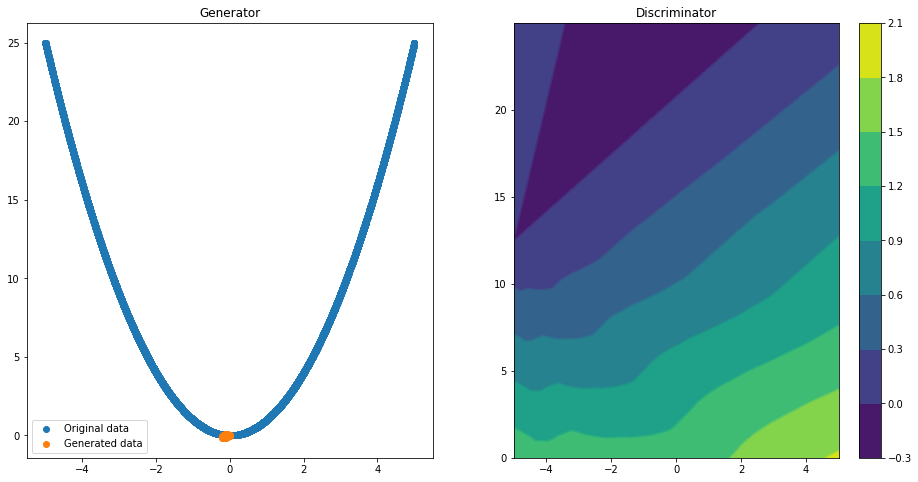

Epoch 000 | ET 0.57 min | Avg Losses >> G/D 0.7049/0.9557 [D-Real: 0.2699 D-Fake: 0.6858]


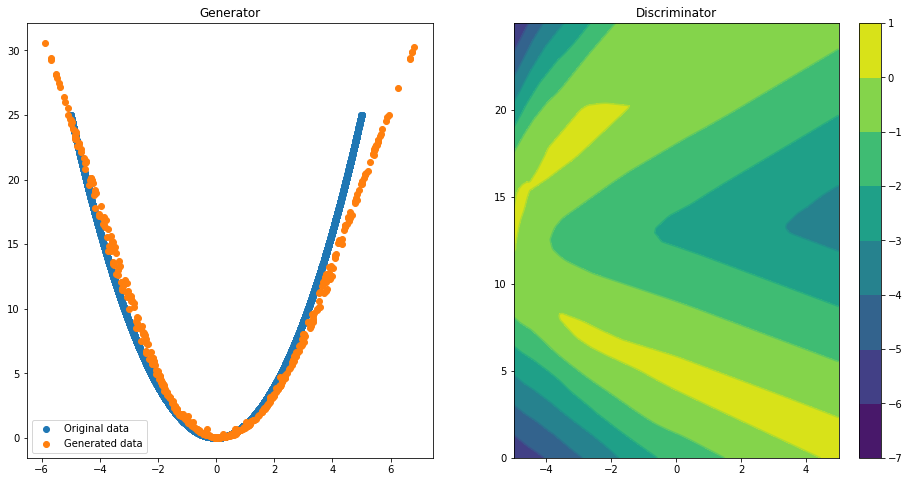

Epoch 050 | ET 1.80 min | Avg Losses >> G/D 0.6947/1.4008 [D-Real: 0.6962 D-Fake: 0.7046]


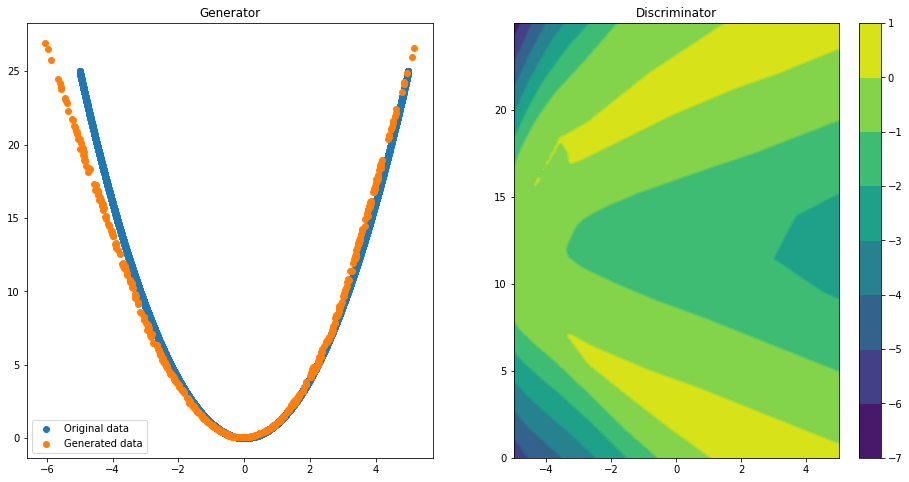

Epoch 100 | ET 3.02 min | Avg Losses >> G/D 0.7013/1.3917 [D-Real: 0.7007 D-Fake: 0.6909]


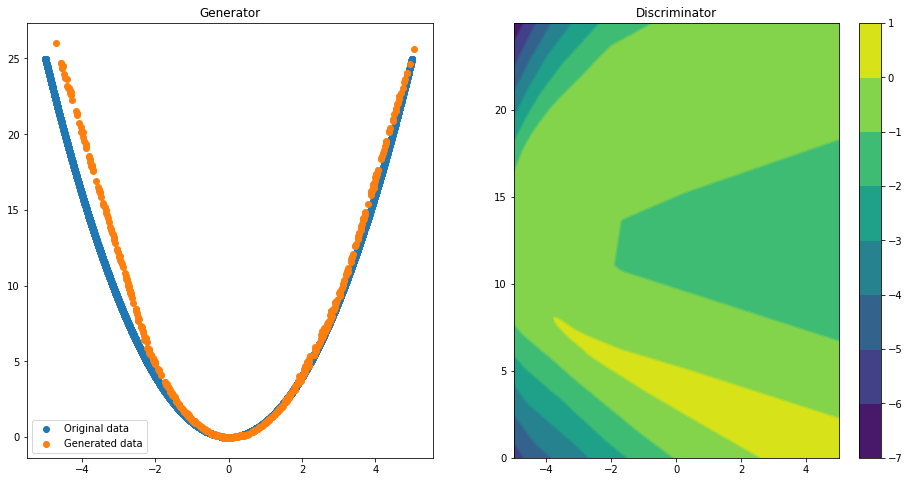

Epoch 150 | ET 4.25 min | Avg Losses >> G/D 0.7006/1.3849 [D-Real: 0.6953 D-Fake: 0.6895]


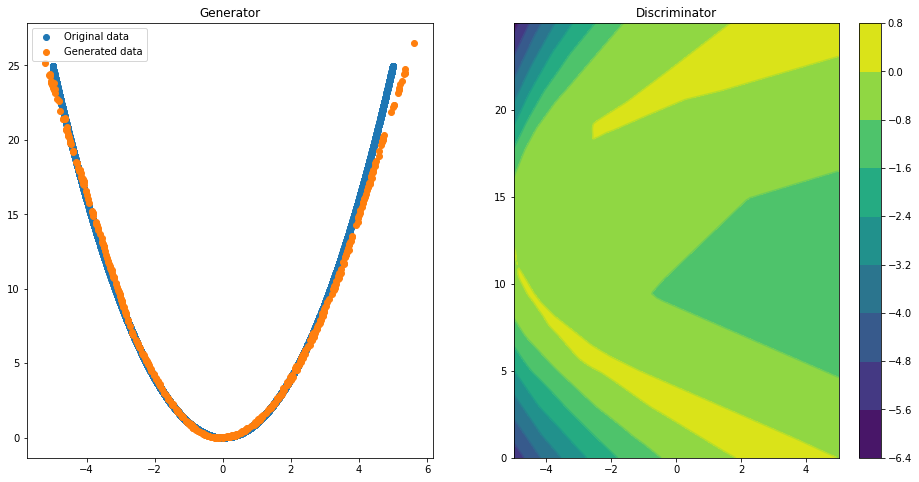

Epoch 200 | ET 5.51 min | Avg Losses >> G/D 0.6914/1.3918 [D-Real: 0.6933 D-Fake: 0.6985]


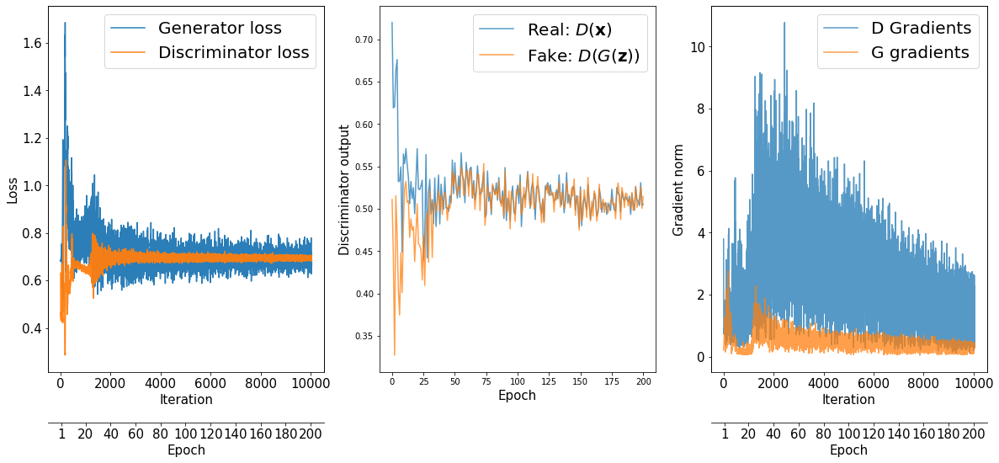

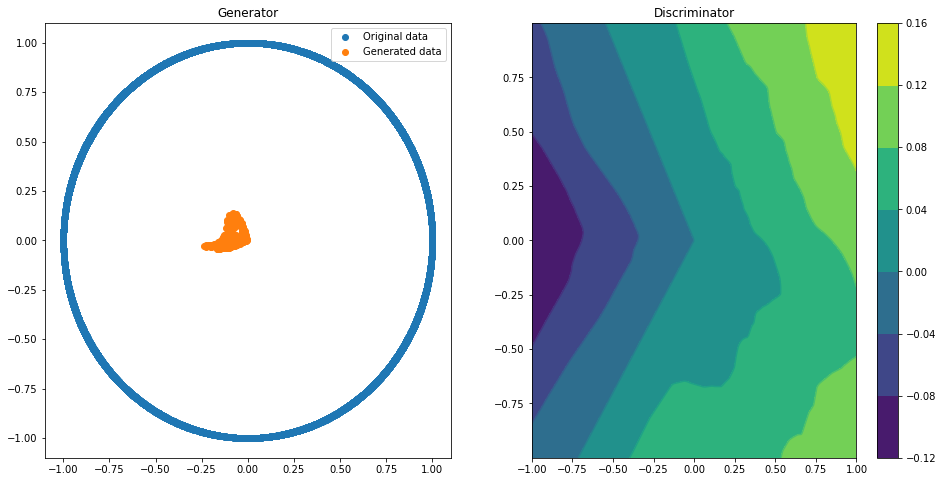

Epoch 000 | ET 0.57 min | Avg Losses >> G/D 0.6917/1.2981 [D-Real: 0.5849 D-Fake: 0.7132]


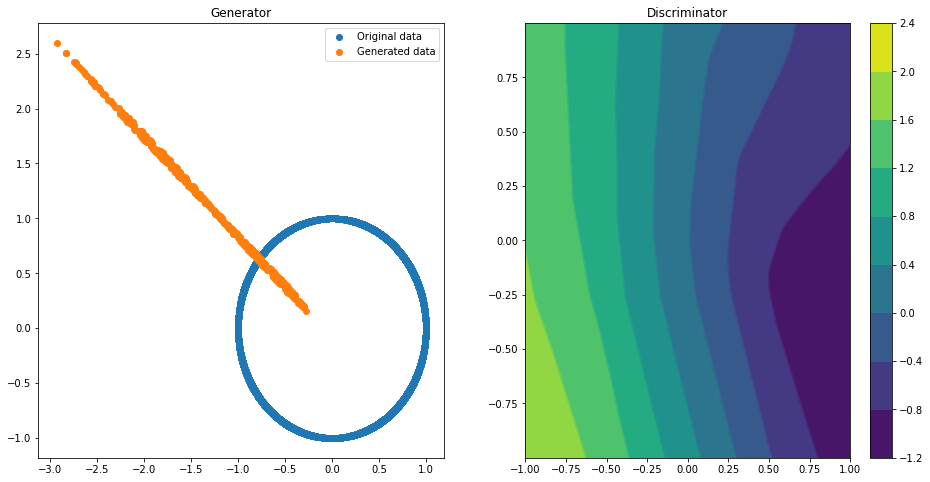

Epoch 050 | ET 1.81 min | Avg Losses >> G/D 0.9833/1.2387 [D-Real: 0.7111 D-Fake: 0.5276]


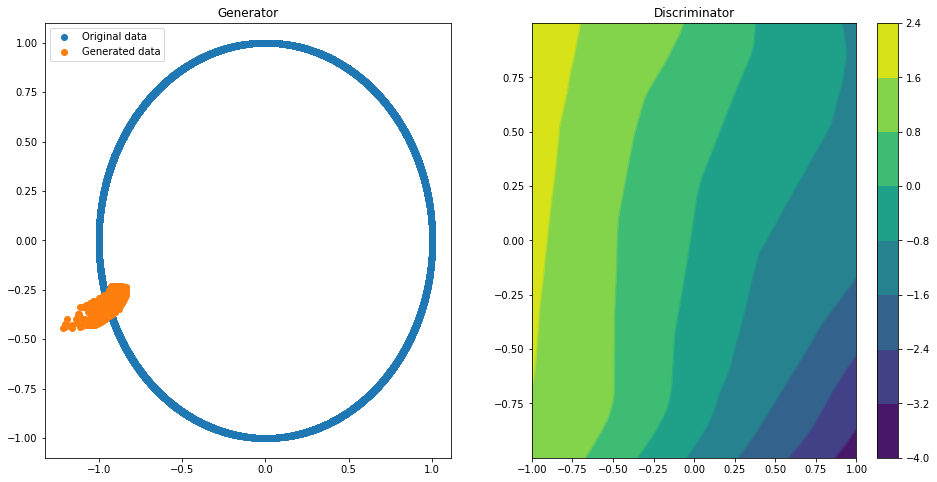

Epoch 100 | ET 3.04 min | Avg Losses >> G/D 0.7642/1.4197 [D-Real: 0.7878 D-Fake: 0.6319]


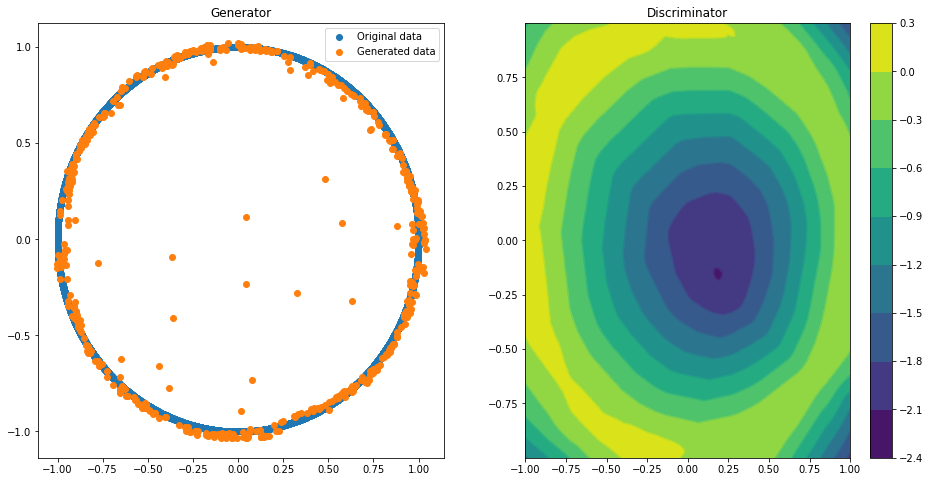

Epoch 150 | ET 4.28 min | Avg Losses >> G/D 0.7056/1.3754 [D-Real: 0.6866 D-Fake: 0.6888]


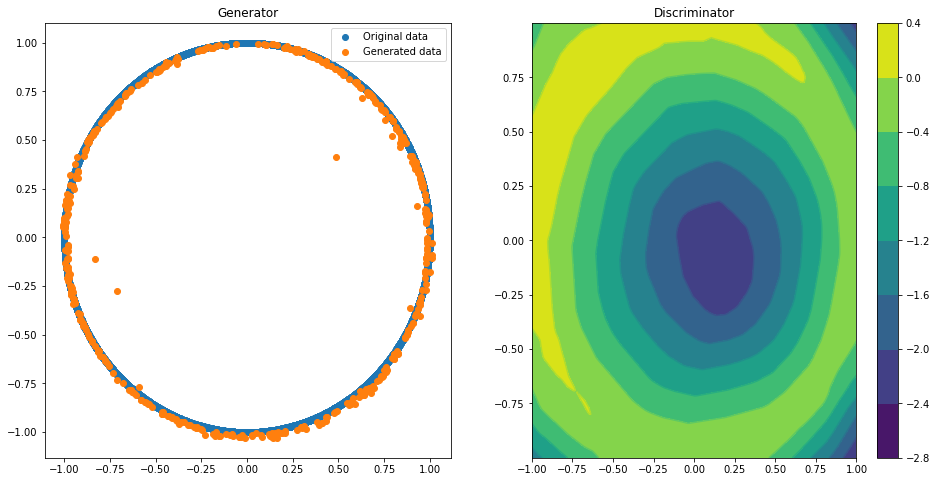

Epoch 200 | ET 5.50 min | Avg Losses >> G/D 0.6977/1.3830 [D-Real: 0.6907 D-Fake: 0.6922]


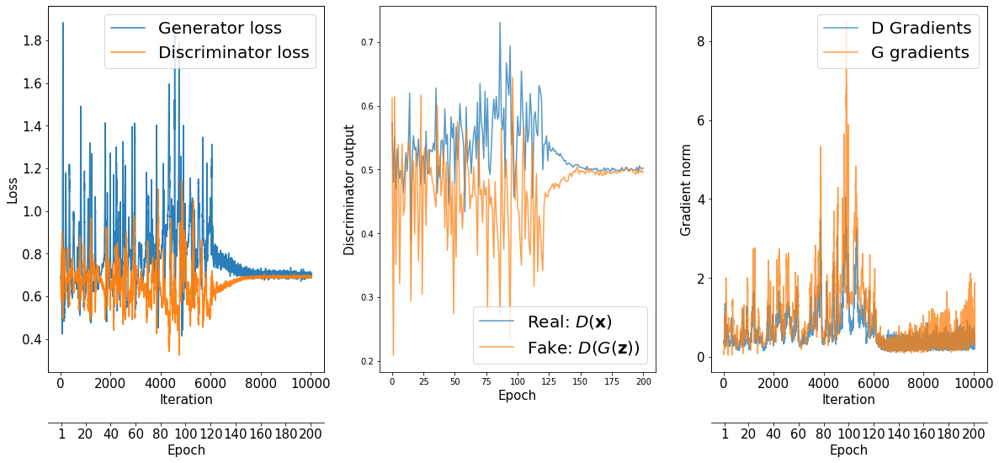

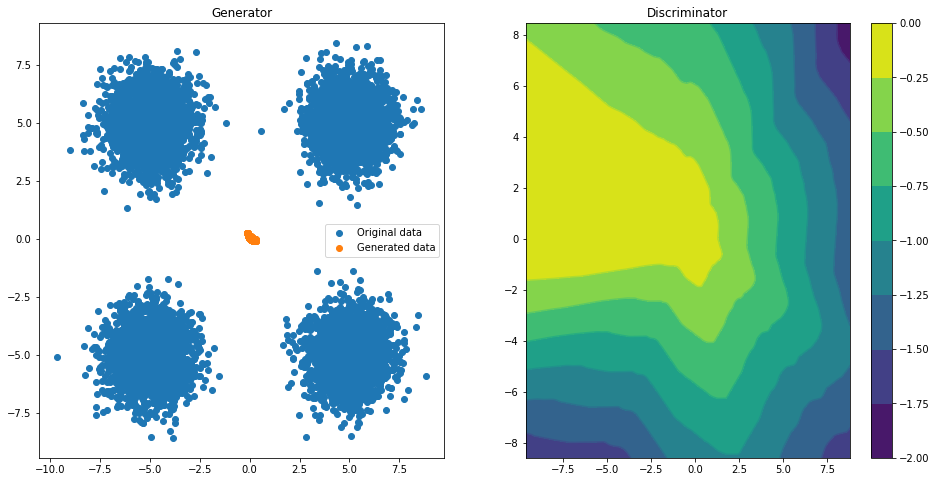

Epoch 000 | ET 0.57 min | Avg Losses >> G/D 0.6776/0.9561 [D-Real: 0.2415 D-Fake: 0.7146]


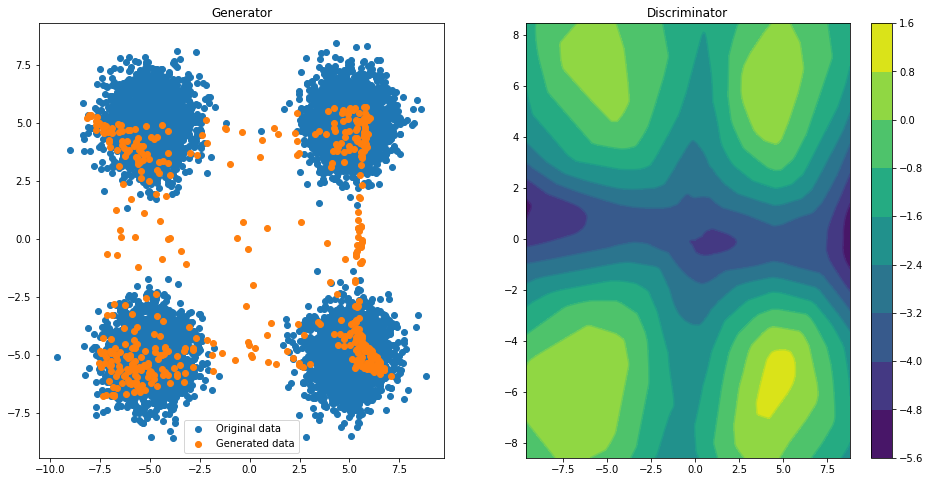

Epoch 050 | ET 1.79 min | Avg Losses >> G/D 0.9238/1.3396 [D-Real: 0.6707 D-Fake: 0.6688]


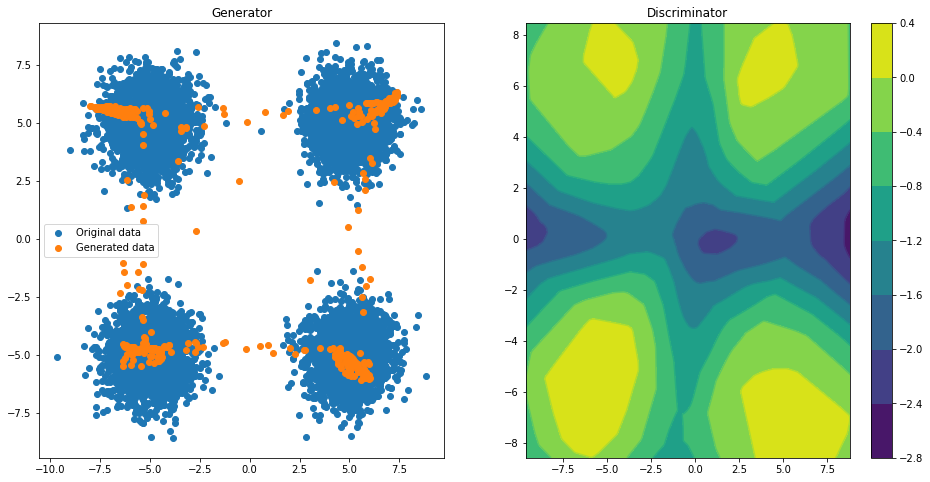

Epoch 100 | ET 3.00 min | Avg Losses >> G/D 0.7259/1.3930 [D-Real: 0.7078 D-Fake: 0.6852]


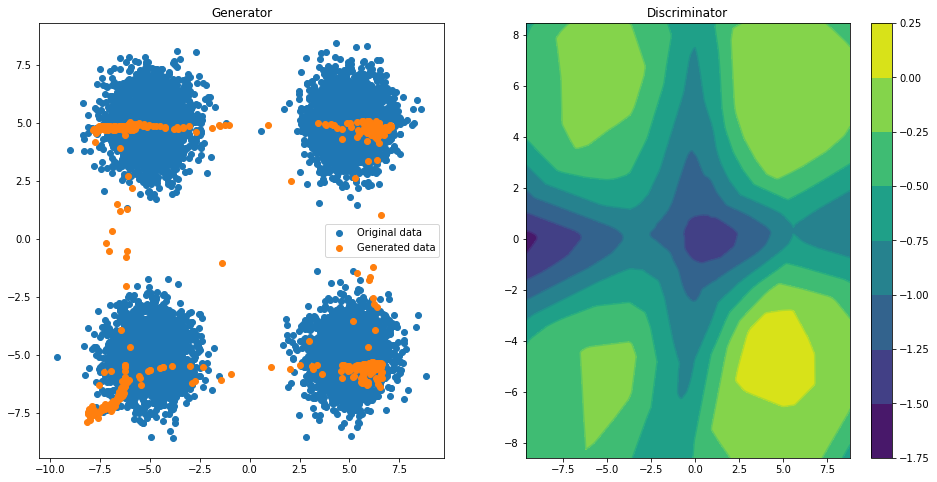

Epoch 150 | ET 4.21 min | Avg Losses >> G/D 0.7031/1.3803 [D-Real: 0.6860 D-Fake: 0.6943]


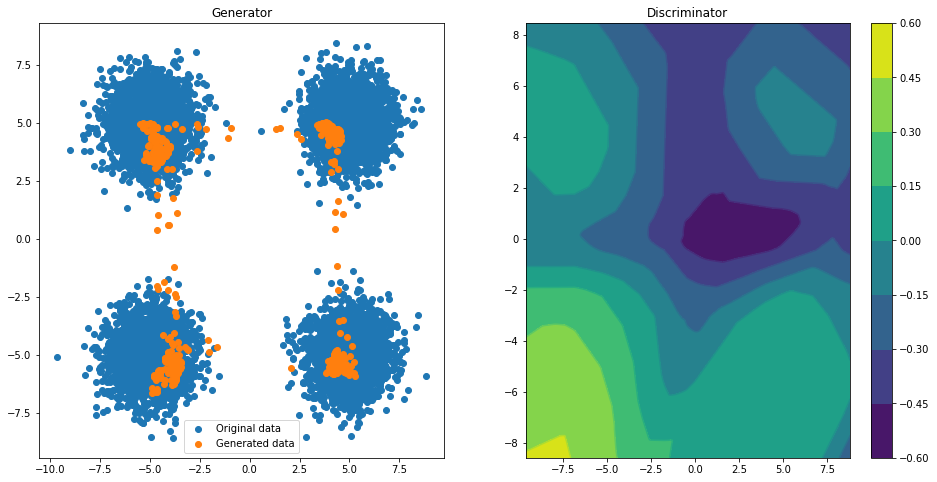

Epoch 200 | ET 5.44 min | Avg Losses >> G/D 0.6956/1.3862 [D-Real: 0.6900 D-Fake: 0.6962]


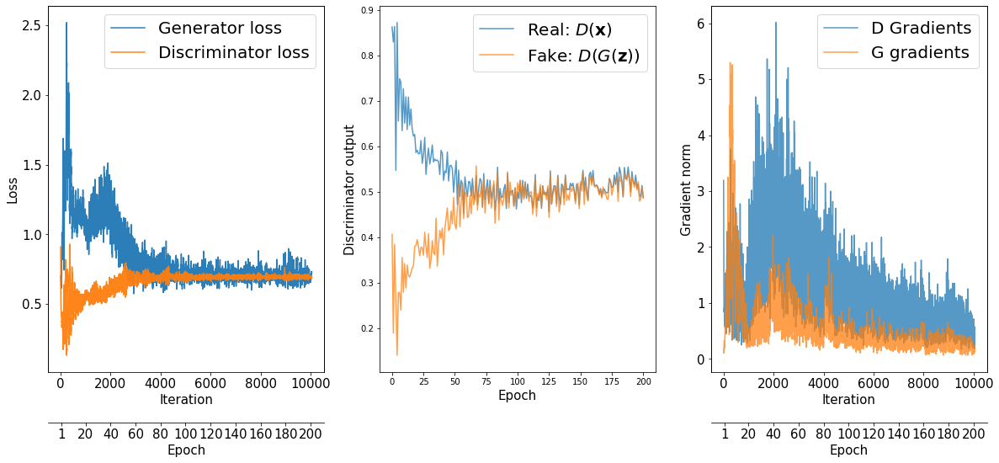

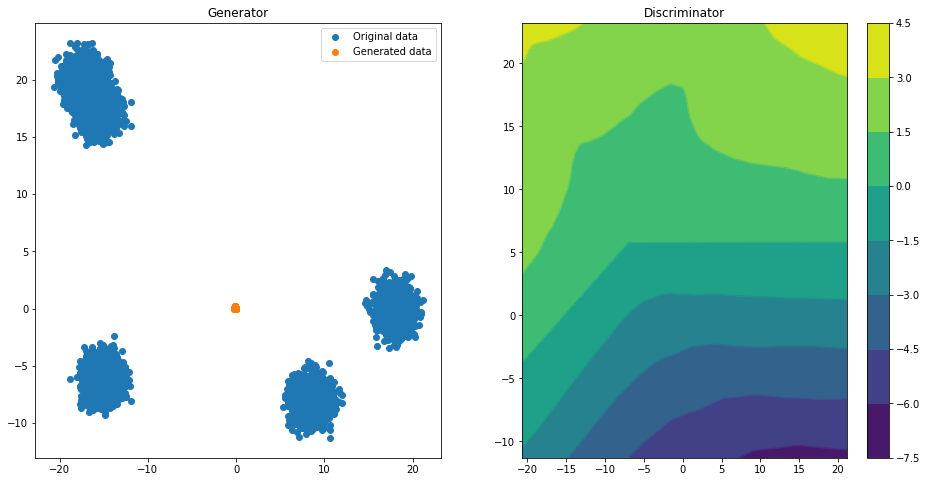

Epoch 000 | ET 0.56 min | Avg Losses >> G/D 0.6777/0.9118 [D-Real: 0.1976 D-Fake: 0.7142]


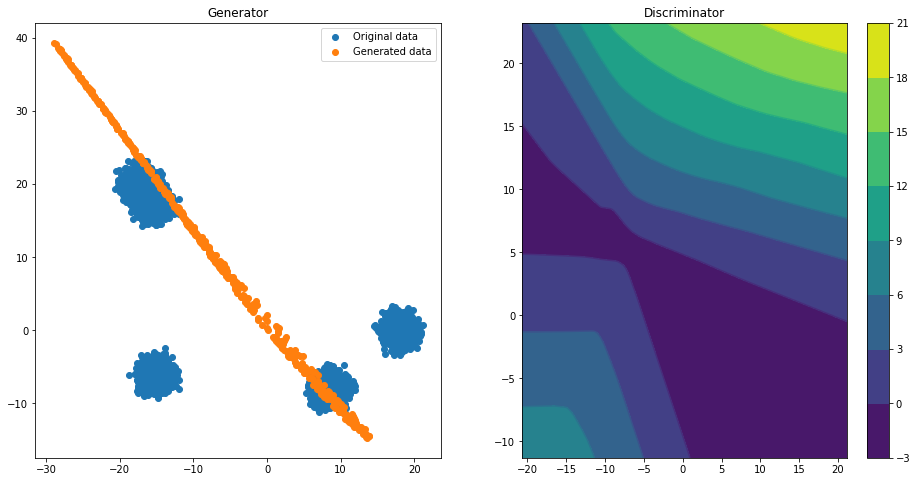

Epoch 050 | ET 1.76 min | Avg Losses >> G/D 1.0638/0.9342 [D-Real: 0.4935 D-Fake: 0.4407]


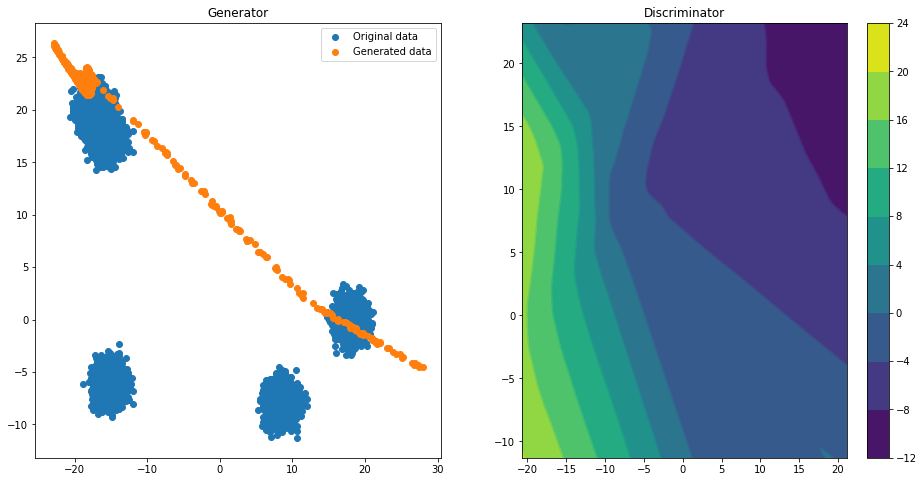

Epoch 100 | ET 2.96 min | Avg Losses >> G/D 1.3048/1.0353 [D-Real: 0.6173 D-Fake: 0.4180]


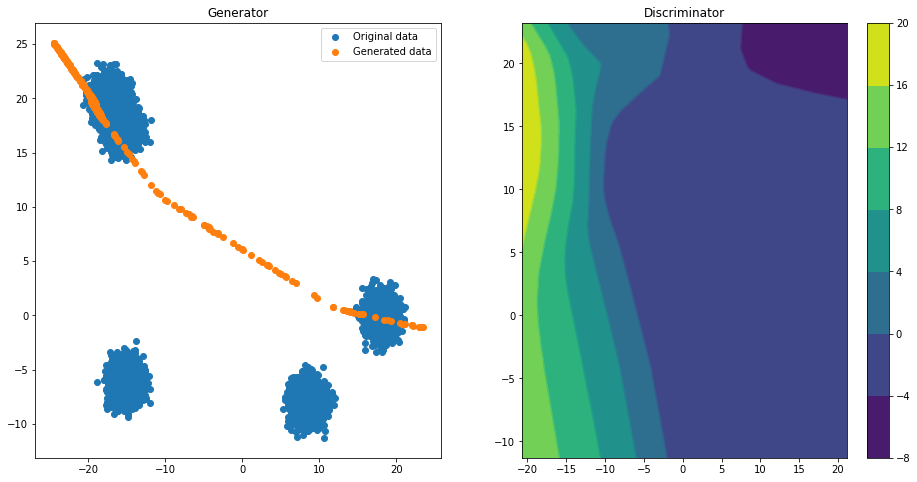

Epoch 150 | ET 4.14 min | Avg Losses >> G/D 1.2315/0.9230 [D-Real: 0.5015 D-Fake: 0.4215]


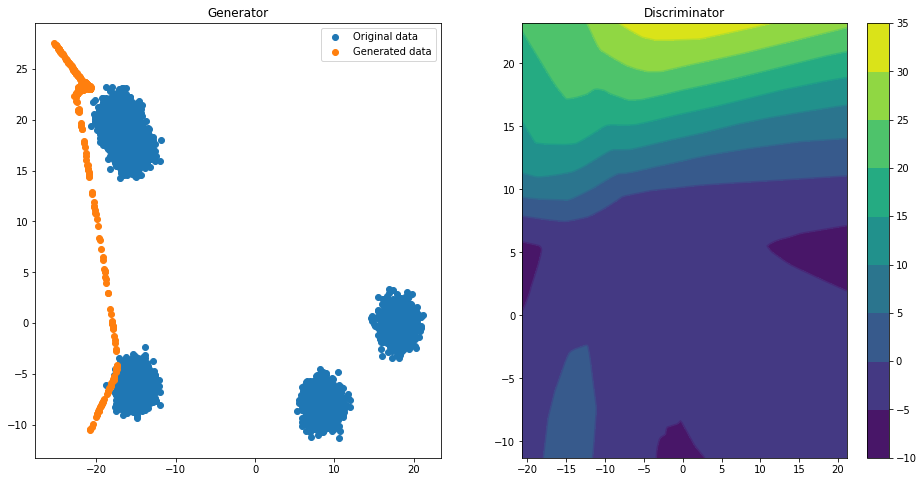

Epoch 200 | ET 5.32 min | Avg Losses >> G/D 1.3779/0.9170 [D-Real: 0.5407 D-Fake: 0.3763]


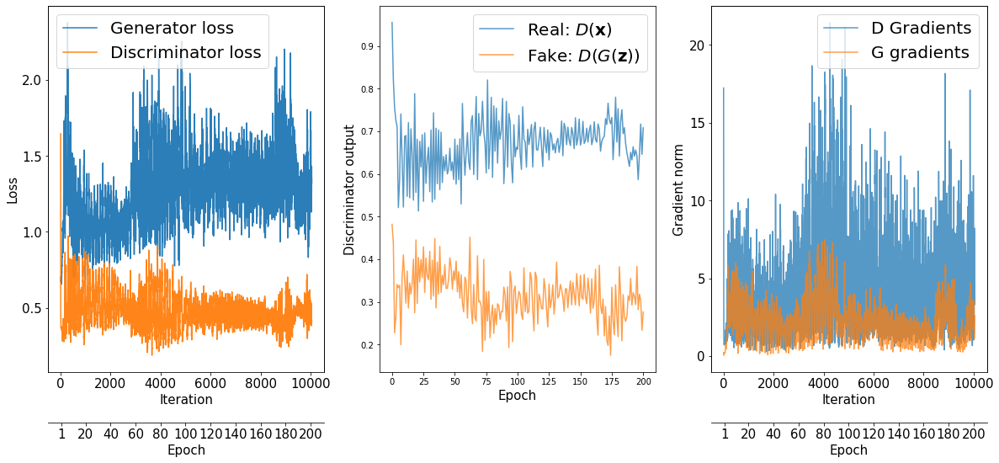

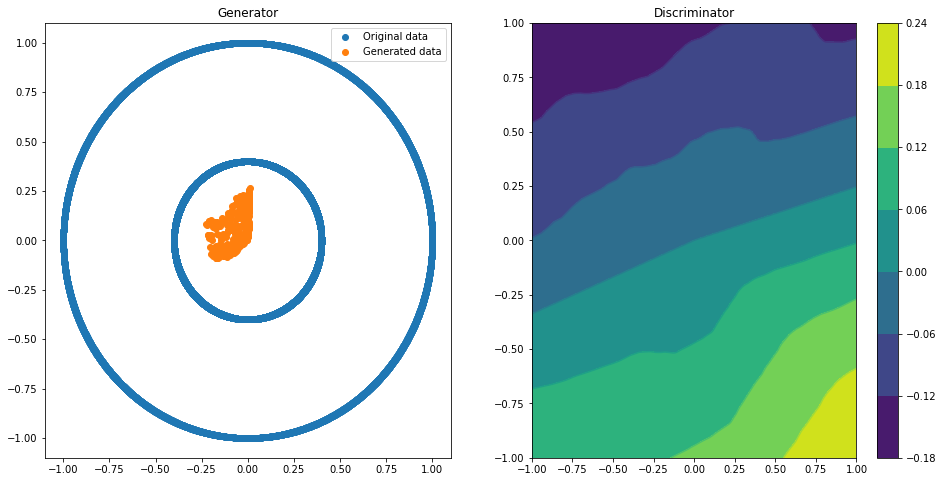

Epoch 000 | ET 0.53 min | Avg Losses >> G/D 0.7010/1.3207 [D-Real: 0.6198 D-Fake: 0.7009]


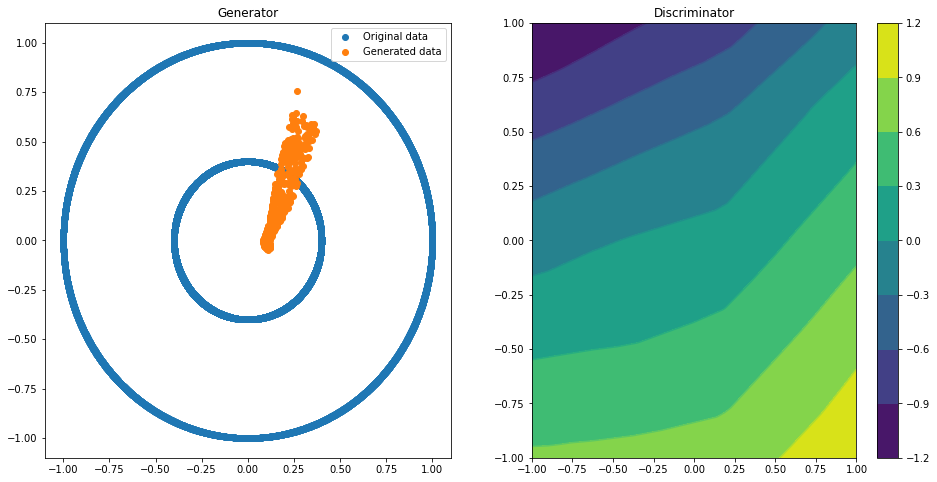

Epoch 050 | ET 1.70 min | Avg Losses >> G/D 0.6990/1.3726 [D-Real: 0.6845 D-Fake: 0.6882]


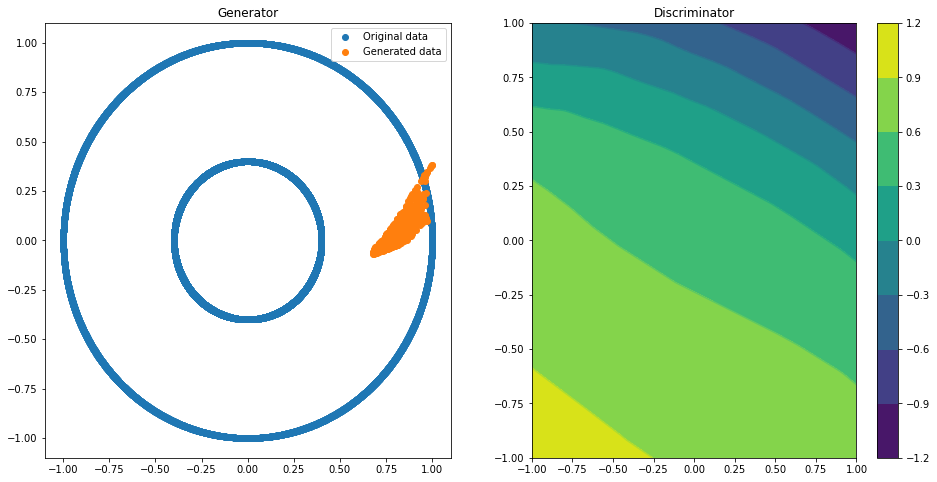

Epoch 100 | ET 2.87 min | Avg Losses >> G/D 0.7708/1.3480 [D-Real: 0.7249 D-Fake: 0.6231]


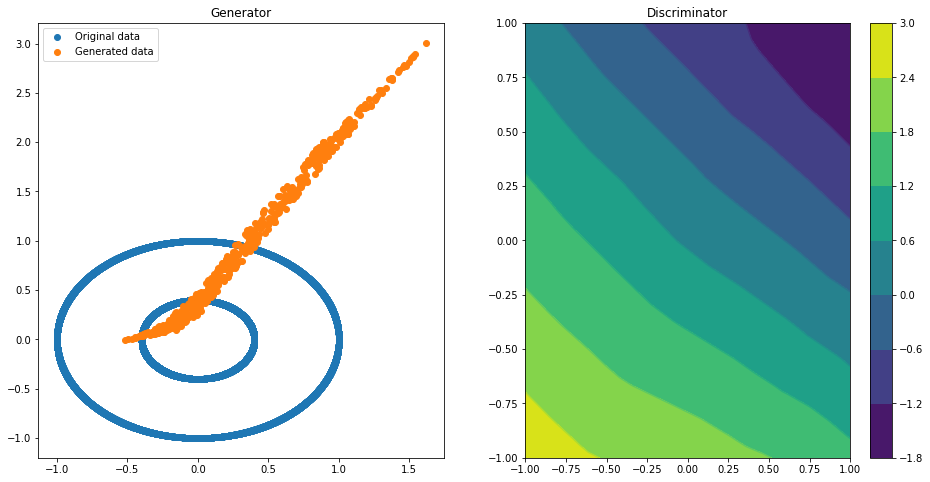

Epoch 150 | ET 4.04 min | Avg Losses >> G/D 0.8672/1.4150 [D-Real: 0.7543 D-Fake: 0.6606]


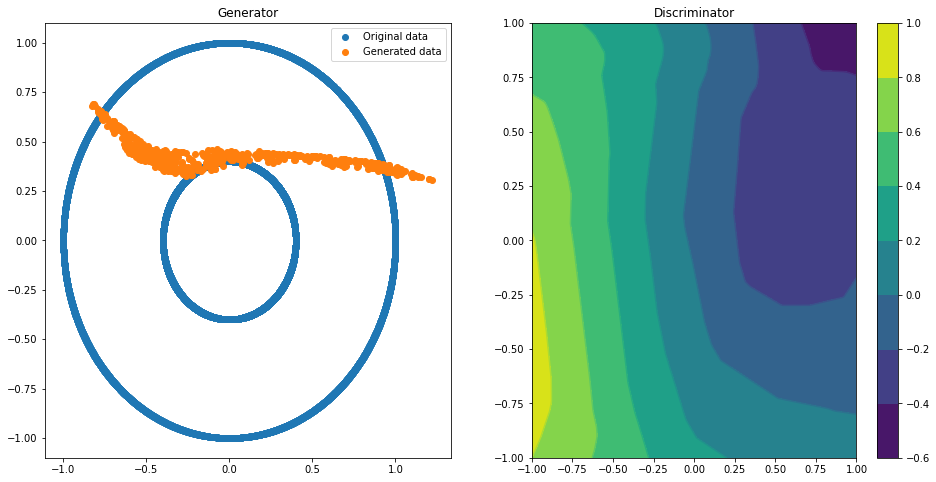

Epoch 200 | ET 5.24 min | Avg Losses >> G/D 0.7839/1.2696 [D-Real: 0.6470 D-Fake: 0.6225]


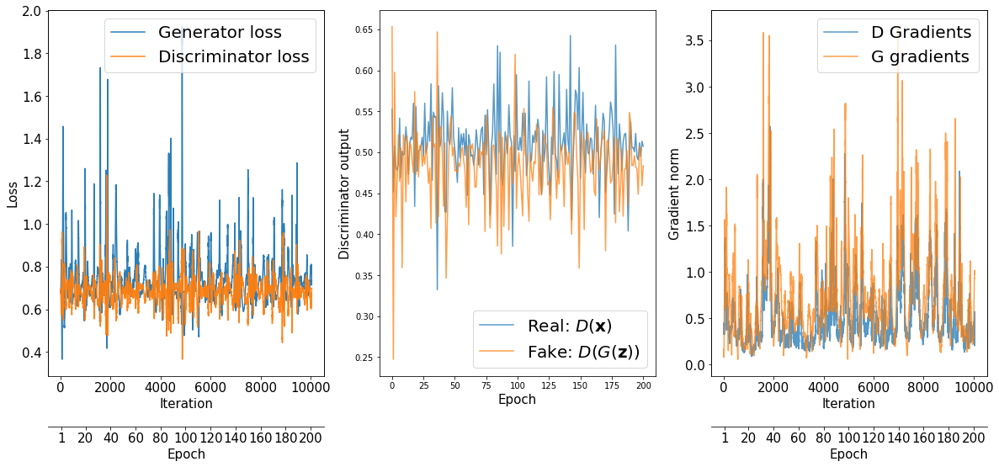

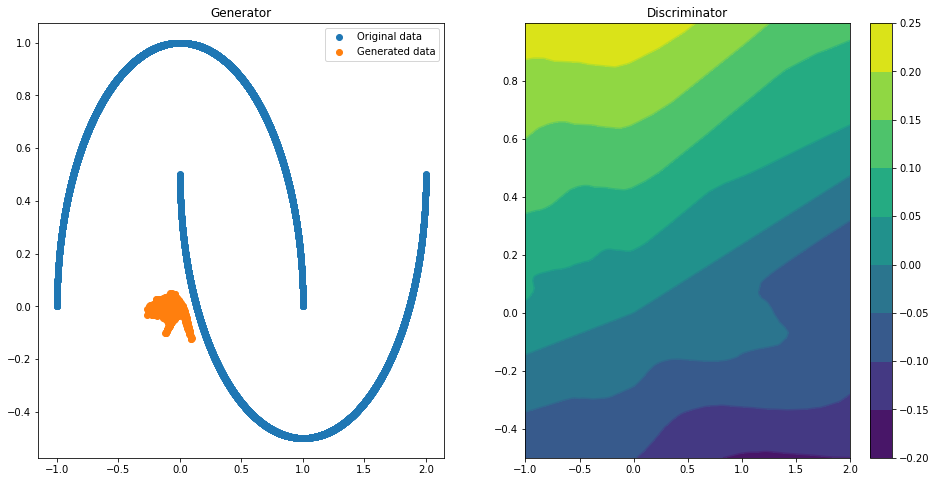

Epoch 000 | ET 0.53 min | Avg Losses >> G/D 0.6779/1.2972 [D-Real: 0.5609 D-Fake: 0.7363]


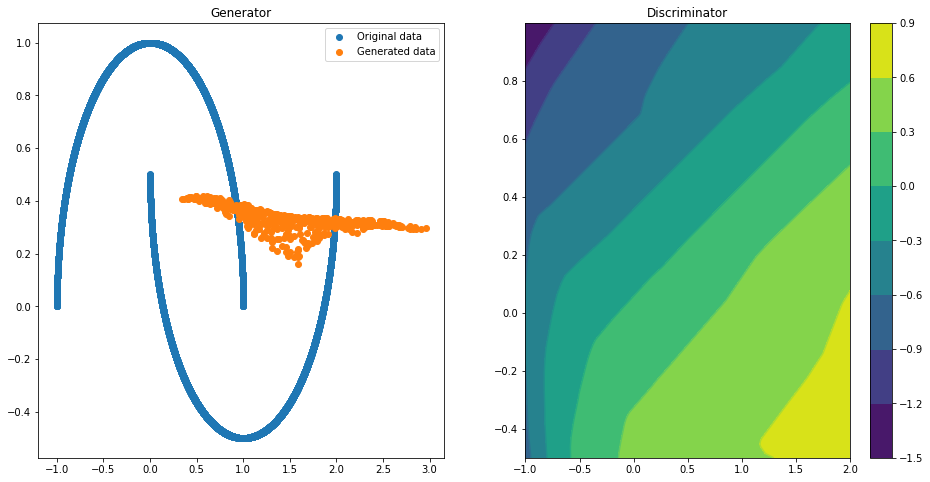

Epoch 050 | ET 1.69 min | Avg Losses >> G/D 0.7361/1.3415 [D-Real: 0.6785 D-Fake: 0.6630]


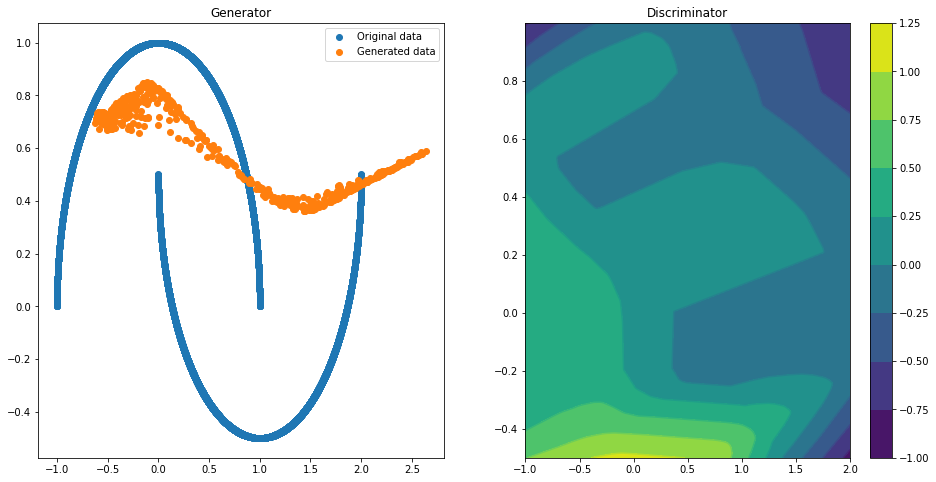

Epoch 100 | ET 2.86 min | Avg Losses >> G/D 0.7357/1.3188 [D-Real: 0.6590 D-Fake: 0.6598]


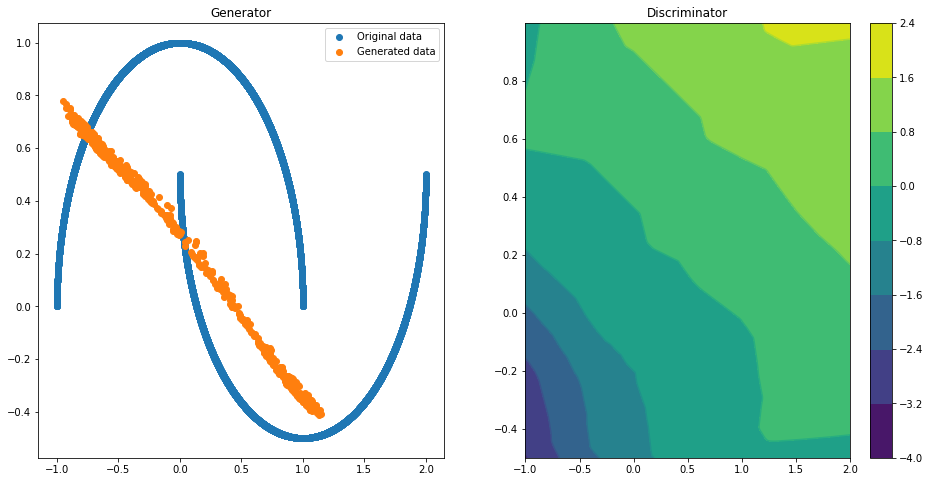

Epoch 150 | ET 4.03 min | Avg Losses >> G/D 0.6990/1.3762 [D-Real: 0.6854 D-Fake: 0.6908]


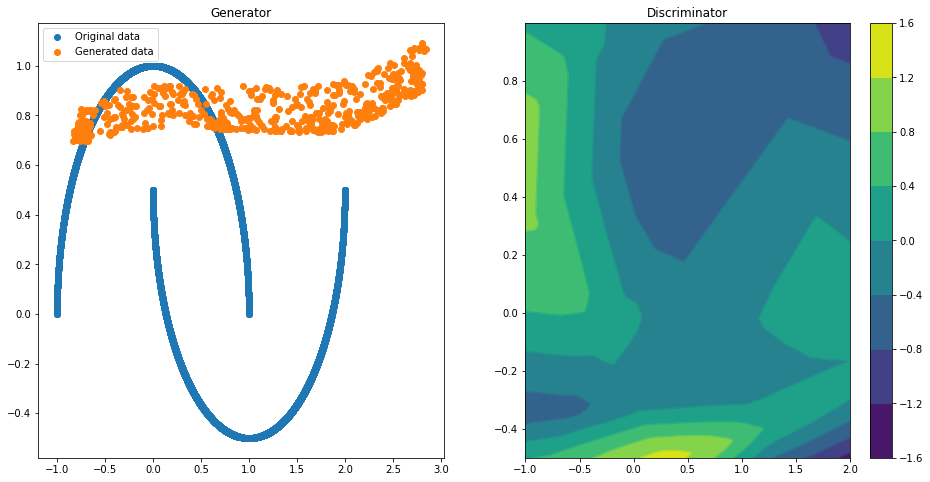

Epoch 200 | ET 5.18 min | Avg Losses >> G/D 0.9178/1.1928 [D-Real: 0.6604 D-Fake: 0.5324]


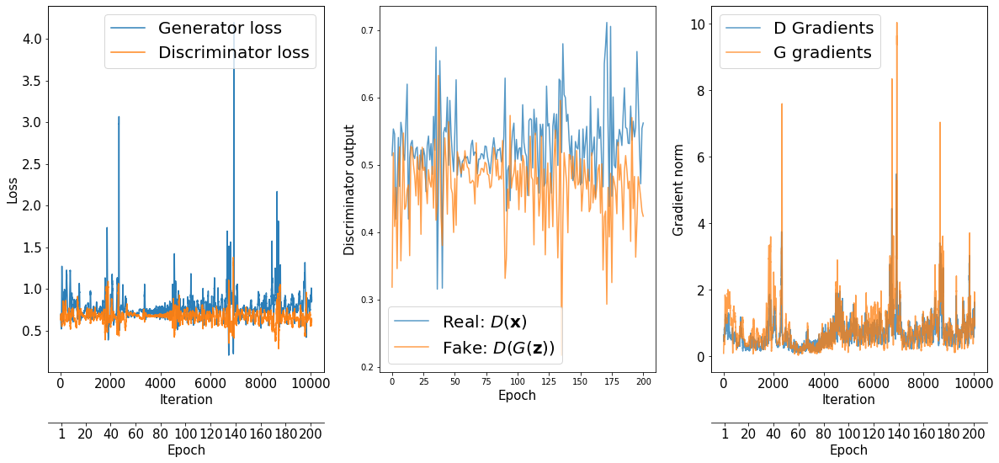

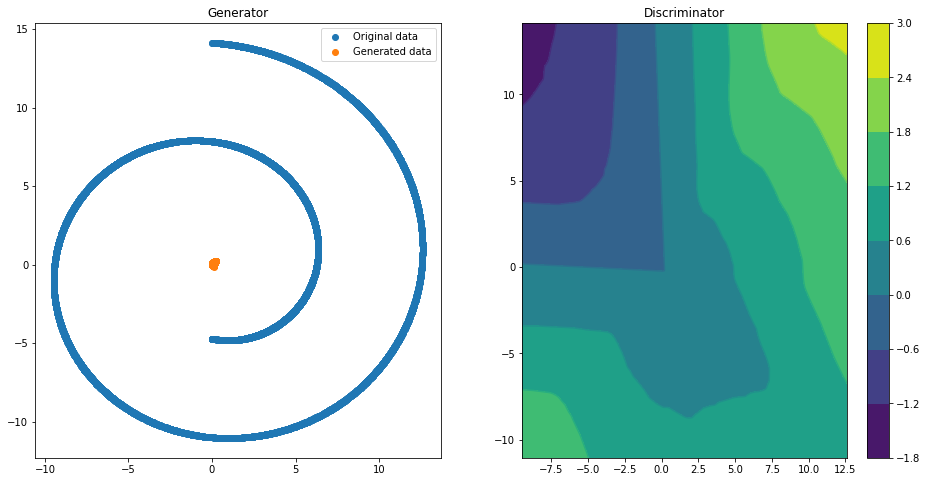

Epoch 000 | ET 0.53 min | Avg Losses >> G/D 0.7207/0.7968 [D-Real: 0.1231 D-Fake: 0.6737]


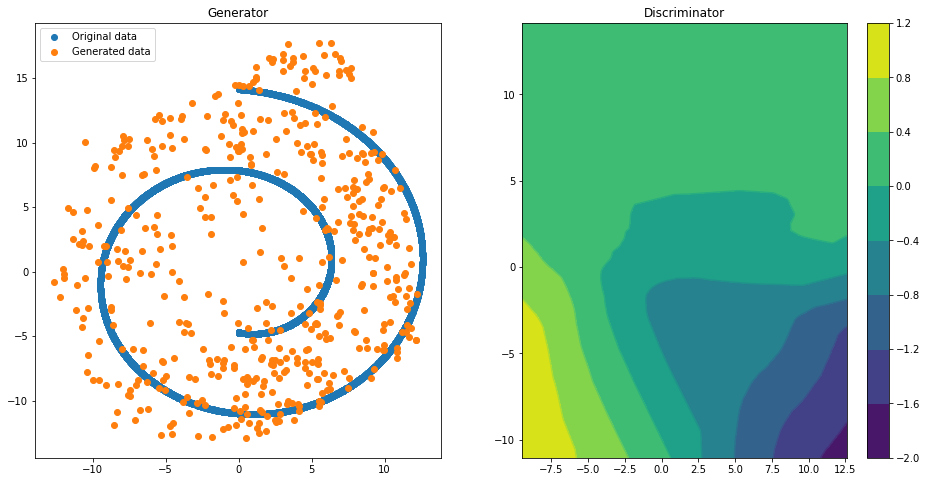

Epoch 050 | ET 1.68 min | Avg Losses >> G/D 0.7344/1.3846 [D-Real: 0.7064 D-Fake: 0.6782]


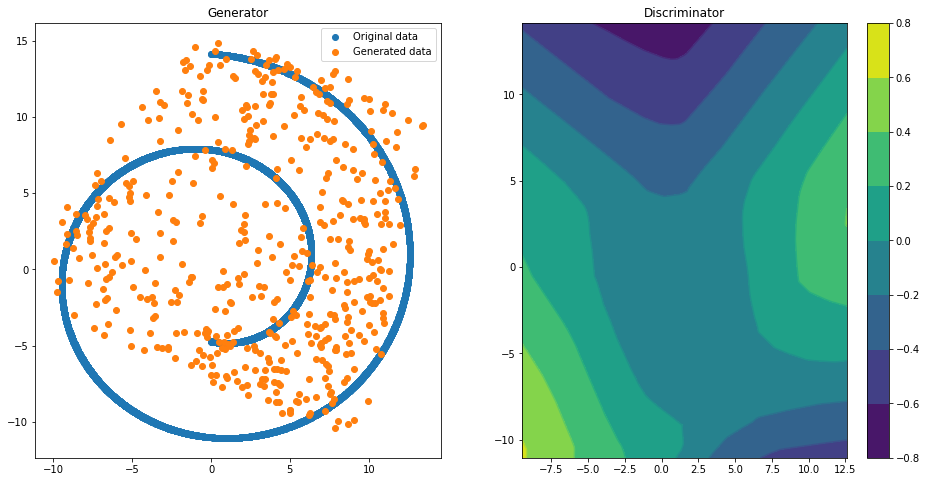

Epoch 100 | ET 2.83 min | Avg Losses >> G/D 0.6901/1.3808 [D-Real: 0.6709 D-Fake: 0.7099]


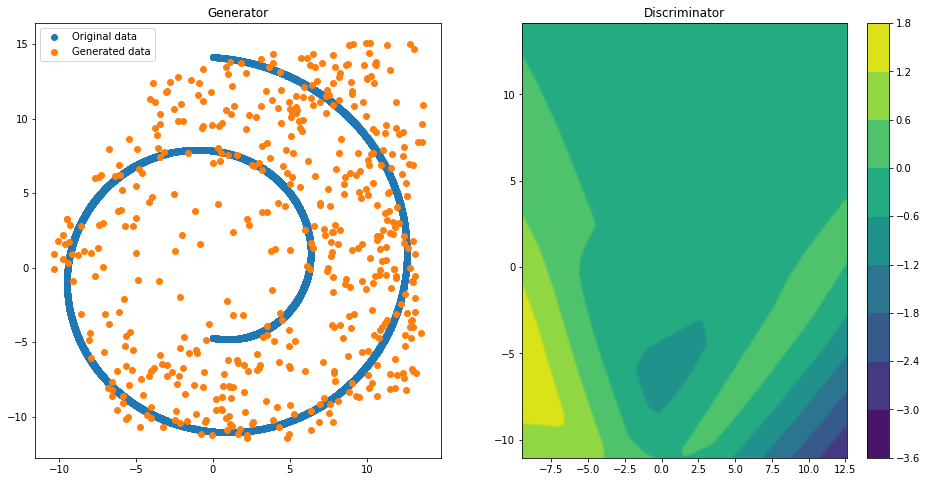

Epoch 150 | ET 4.01 min | Avg Losses >> G/D 0.7371/1.3585 [D-Real: 0.6861 D-Fake: 0.6723]


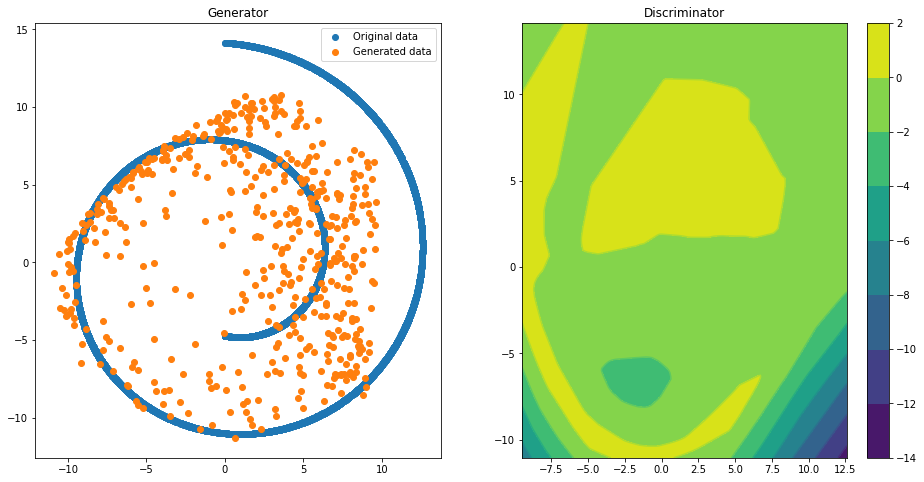

Epoch 200 | ET 5.16 min | Avg Losses >> G/D 0.7783/1.2953 [D-Real: 0.6386 D-Fake: 0.6567]


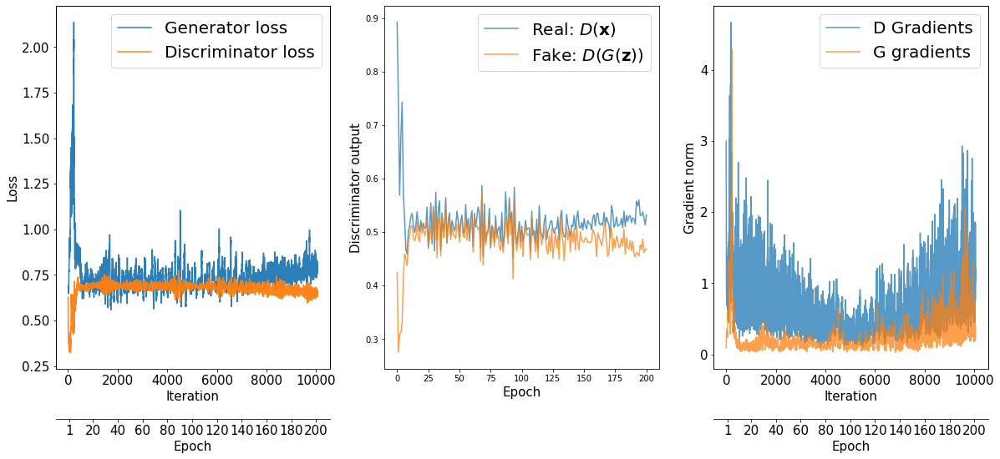

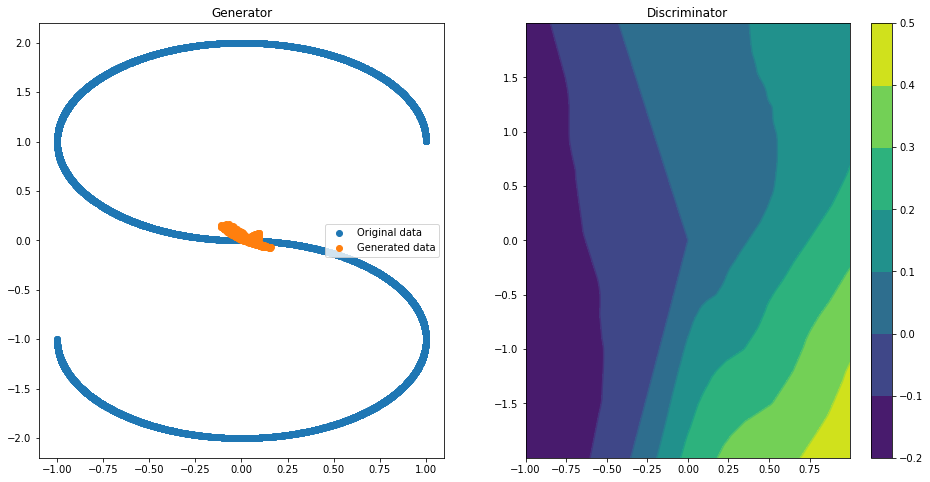

Epoch 000 | ET 0.52 min | Avg Losses >> G/D 0.7199/1.2042 [D-Real: 0.5058 D-Fake: 0.6984]


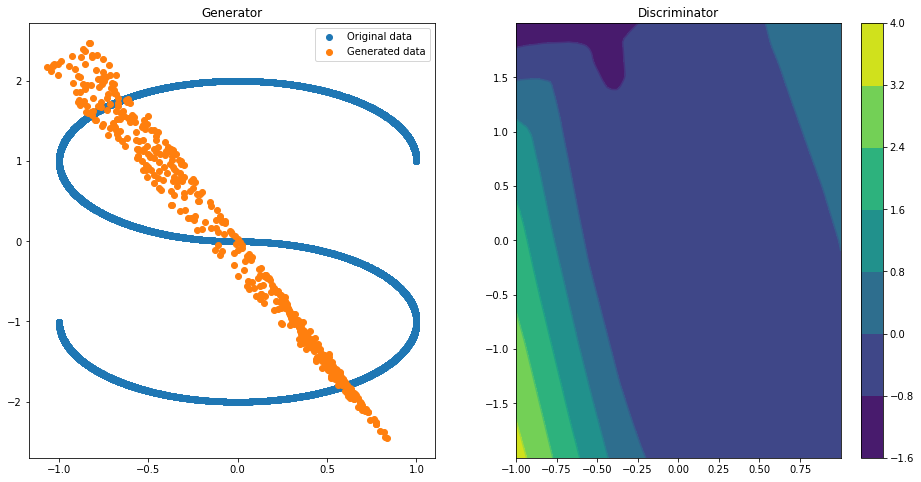

Epoch 050 | ET 1.67 min | Avg Losses >> G/D 0.7989/1.3099 [D-Real: 0.6819 D-Fake: 0.6280]


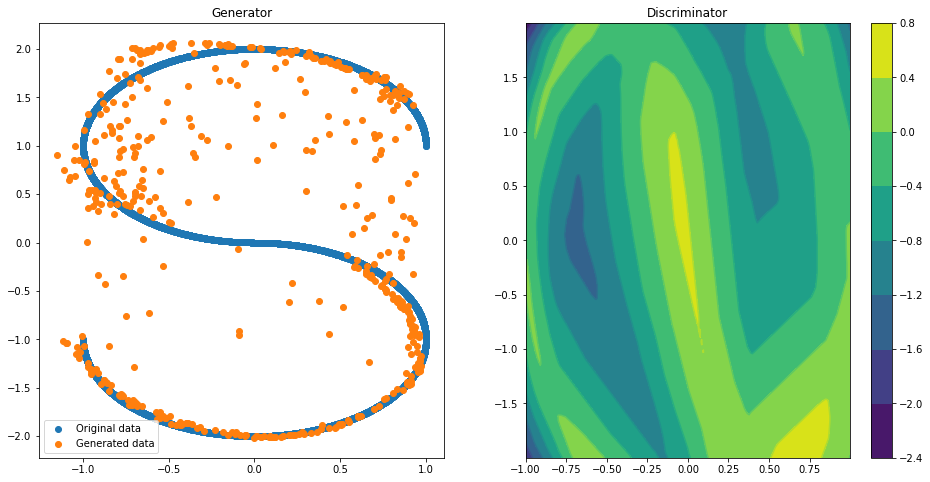

Epoch 100 | ET 2.83 min | Avg Losses >> G/D 0.7468/1.3214 [D-Real: 0.6574 D-Fake: 0.6640]


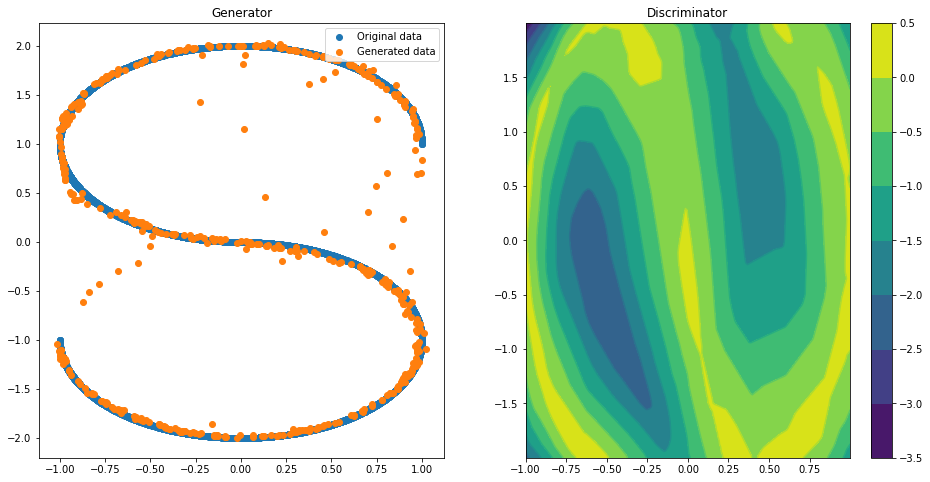

Epoch 150 | ET 3.99 min | Avg Losses >> G/D 0.7175/1.3662 [D-Real: 0.6811 D-Fake: 0.6851]


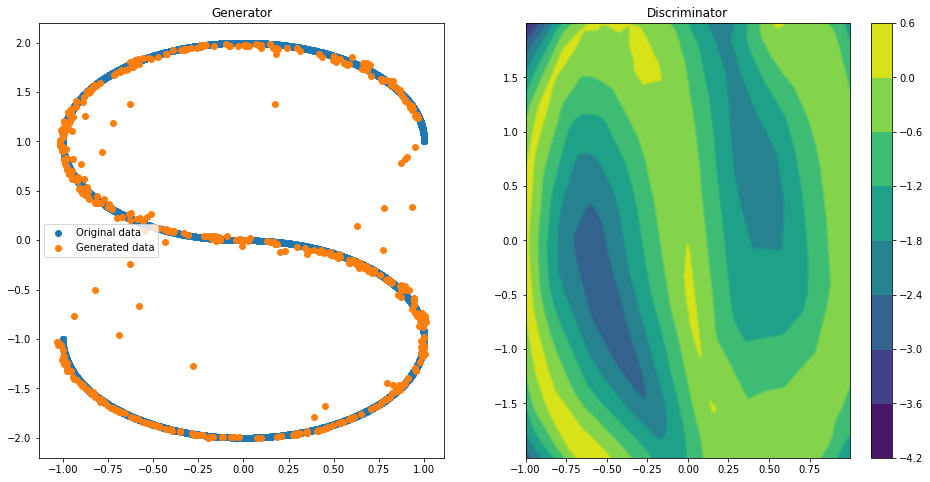

Epoch 200 | ET 5.13 min | Avg Losses >> G/D 0.7149/1.3694 [D-Real: 0.6836 D-Fake: 0.6858]


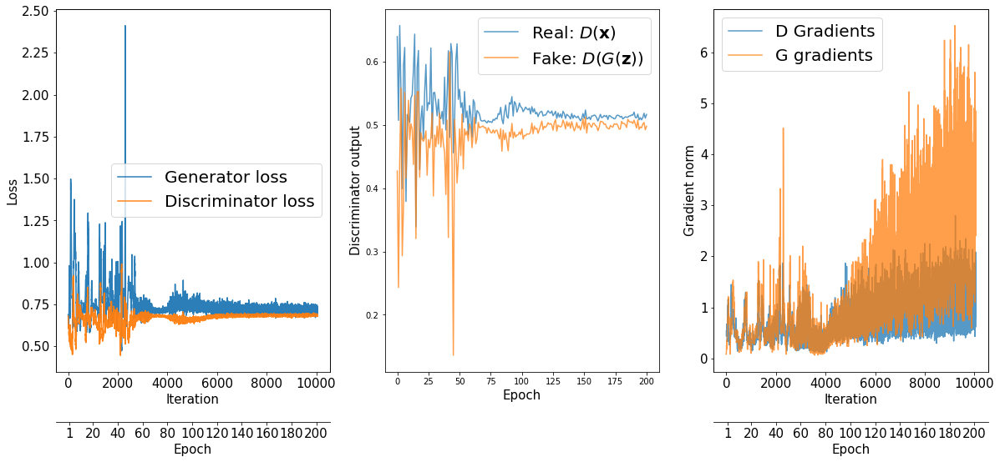

In [ ]:
for datos in [quadratic, circle, mixture, blobs, circles, moons, swiss_roll, s_curve]:
  numpy_data = datos
  data = tf.data.Dataset.from_tensor_slices(numpy_data).batch(batch_size)

  with tf.device(device_name):
    gen_model = make_generator_network()
    gen_model.build(input_shape=(None,z_size))
    disc_model = make_discriminator_network()
    disc_model.build(input_shape=(None,2))


  loss_fn = tf.keras.losses.BinaryCrossentropy(from_logits=True)
  g_optimizer = tf.keras.optimizers.Adam()
  d_optimizer = tf.keras.optimizers.Adam()
  all_losses = []
  all_d_vals = []
  d_gradients = []
  g_gradients = []
  epoch_samples = []
  start_time = time.time()
  for epoch in range(0, num_epochs+1):
    epoch_losses, epoch_d_vals = [], []
    #Plotting every 50
    if epoch%50 == 0:
        input_z = tf.random.uniform(shape = (500,z_size), minval=-1,maxval=1)
        epoch_samples.append(gen_model(input_z, training=False).numpy())
        X_data, Y_data = numpy_data[:,0], numpy_data[:,1]
        x = np.linspace(np.min(X_data), np.max(X_data), 200)
        y = np.linspace(np.min(Y_data), np.max(Y_data), 200)
        X, Y = np.meshgrid(x, y)
        Z = np.zeros((len(x), len(y)))
        for i in range(len(x)):
          for j in range(len(y)):
            q = tf.convert_to_tensor(np.array([[x[i],y[j]]]).astype("float32"))
            Z[i][j] = disc_model(q).numpy()[0][0]
        f, (ax1, ax2) = plt.subplots(1, 2, figsize = (16,8))
        ax1.scatter(X_data,Y_data, label = "Original data")
        ax1.scatter(epoch_samples[-1][:,0],epoch_samples[-1][:,1], label="Generated data")
        ax1.set_title("Generator")
        ax1.legend()
        ax2.contour(X,Y,Z)
        ax2.set_title("Discriminator")
        cp = ax2.contourf(X , Y , Z)
        plt.colorbar(cp, ax=ax2)
        #plt.title("Epoch "+ str(epoch))
        plt.show()
    for batch in data:
      input_z = tf.random.uniform(shape = (batch_size,z_size), minval=-1,maxval=1)
        #Compute generator's loss
      with tf.GradientTape() as g_tape:
        g_output = gen_model(input_z)
        d_logits_fake = disc_model(g_output,
                                    training=True)
        labels_real = tf.ones_like(d_logits_fake)
        g_loss = loss_fn(y_true=labels_real,
                          y_pred=d_logits_fake)
        #Compute the gradients of g_loss
      g_grads = g_tape.gradient(g_loss,
                                  gen_model.trainable_variables)
      g_gradients.append(tf.linalg.global_norm(g_grads).numpy())
        #Apply the gradients
      g_optimizer.apply_gradients(
            grads_and_vars=zip(g_grads,
                              gen_model.trainable_variables)
        )

        #Compute the discriminator's loss
      with tf.GradientTape() as d_tape:
        d_logits_real = disc_model(batch,
                                    training=True)
        d_labels_real = tf.ones_like(d_logits_real)
        d_loss_real = loss_fn(y_true=d_labels_real,
                                y_pred=d_logits_real)
        d_logits_fake = disc_model(g_output,
                                    training=True)
        d_labels_fake = tf.zeros_like(d_logits_fake)
        d_loss_fake = loss_fn(y_true=d_labels_fake,
                                y_pred=d_logits_fake)
        d_loss = d_loss_real + d_loss_fake

        #Compute the gradients of d_loss
      d_grads = d_tape.gradient(d_loss,
                                  disc_model.trainable_variables)
      d_gradients.append(tf.linalg.global_norm(d_grads).numpy())
      d_optimizer.apply_gradients(grads_and_vars=zip(d_grads,
                                                      disc_model.trainable_variables))
        
      epoch_losses.append(
                            (g_loss.numpy(), d_loss.numpy(),
                            d_loss_real.numpy(), d_loss_fake.numpy()))
      d_probs_real = tf.reduce_mean(
                            tf.sigmoid(d_logits_real))
      d_probs_fake = tf.reduce_mean(
                            tf.sigmoid(d_logits_fake))
    epoch_d_vals.append((d_probs_real.numpy(),
                            d_probs_fake.numpy()))
    all_losses.append(epoch_losses)
    all_d_vals.append(epoch_d_vals)
    if epoch%50 == 0:
        print(
              'Epoch {:03d} | ET {:.2f} min | Avg Losses >>'
              ' G/D {:.4f}/{:.4f} [D-Real: {:.4f} D-Fake: {:.4f}]'
              .format(
              epoch, (time.time() - start_time)/60,
              *list(np.mean(all_losses[-1], axis=0))))
  fig = plt.figure(figsize=(20, 8))

  ## Plotting the losses
  ax = fig.add_subplot(1, 3, 1)
  g_losses = [item[0] for item in itertools.chain(*all_losses)]
  d_losses = [item[1]/2.0 for item in itertools.chain(*all_losses)]
  plt.plot(g_losses, label='Generator loss', alpha=0.95)
  plt.plot(d_losses, label='Discriminator loss', alpha=0.95)
  plt.legend(fontsize=20)
  ax.set_xlabel('Iteration', size=15)
  ax.set_ylabel('Loss', size=15)

  epochs = np.arange(1, 101)
  epoch2iter = lambda e: e*len(all_losses[-1])
  epoch_ticks = [1, 20, 40, 60, 80, 100, 120, 140, 160, 180, 200]
  newpos = [epoch2iter(e) for e in epoch_ticks]
  ax2 = ax.twiny()
  ax2.set_xticks(newpos)
  ax2.set_xticklabels(epoch_ticks)
  ax2.xaxis.set_ticks_position('bottom')
  ax2.xaxis.set_label_position('bottom')
  ax2.spines['bottom'].set_position(('outward', 60))
  ax2.set_xlabel('Epoch', size=15)
  ax2.set_xlim(ax.get_xlim())
  ax.tick_params(axis='both', which='major', labelsize=15)
  ax2.tick_params(axis='both', which='major', labelsize=15)

  ## Plotting the outputs of the discriminator
  ax = fig.add_subplot(1, 3, 2)
  d_vals_real = [item[0] for item in itertools.chain(*all_d_vals)]
  d_vals_fake = [item[1] for item in itertools.chain(*all_d_vals)]
  plt.plot(d_vals_real, alpha=0.75, label=r'Real: $D(\mathbf{x})$')
  plt.plot(d_vals_fake, alpha=0.75, label=r'Fake: $D(G(\mathbf{z}))$')
  plt.legend(fontsize=20)
  ax.set_xlabel('Epoch', size=15)
  ax.set_ylabel('Discriminator output', size=15)


  ax = fig.add_subplot(1, 3, 3)
  plt.plot(d_gradients, label = "D Gradients", alpha=.75)
  plt.plot(g_gradients, label = "G gradients", alpha = .75)
  plt.legend(fontsize=20)
  ax.set_xlabel('Iteration', size=15)
  ax.set_ylabel('Gradient norm', size=15)
  ax2 = ax.twiny()
  ax2.set_xticks(newpos)
  ax2.set_xticklabels(epoch_ticks)
  ax2.xaxis.set_ticks_position('bottom')
  ax2.xaxis.set_label_position('bottom')
  ax2.spines['bottom'].set_position(('outward', 60))
  ax2.set_xlabel('Epoch', size=15)
  ax2.set_xlim(ax.get_xlim())
  ax.tick_params(axis='both', which='major', labelsize=15)
  ax2.tick_params(axis='both', which='major', labelsize=15)

  #plt.savefig('images/ch17-gan-learning-curve.pdf')
  plt.show()

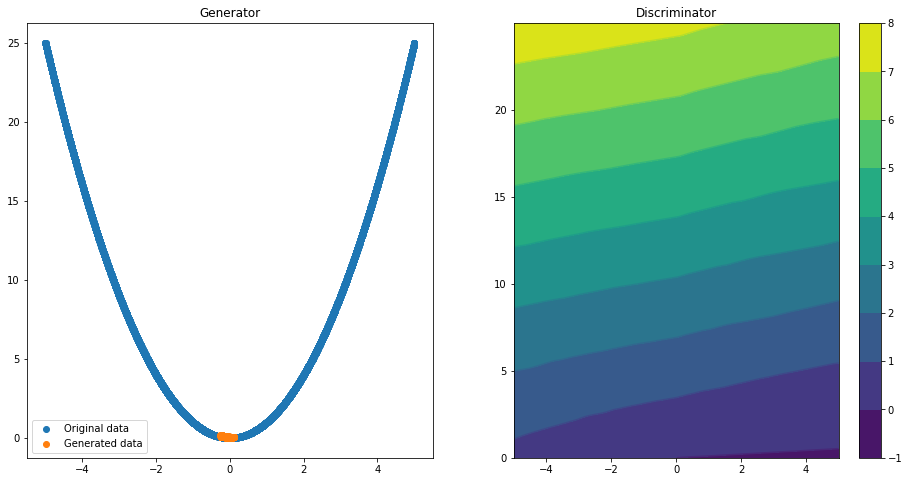

Epoch 000 | ET 0.57 min | Avg Losses >> G/D 0.6937/0.9730 [D-Real: 0.2732 D-Fake: 0.6999]


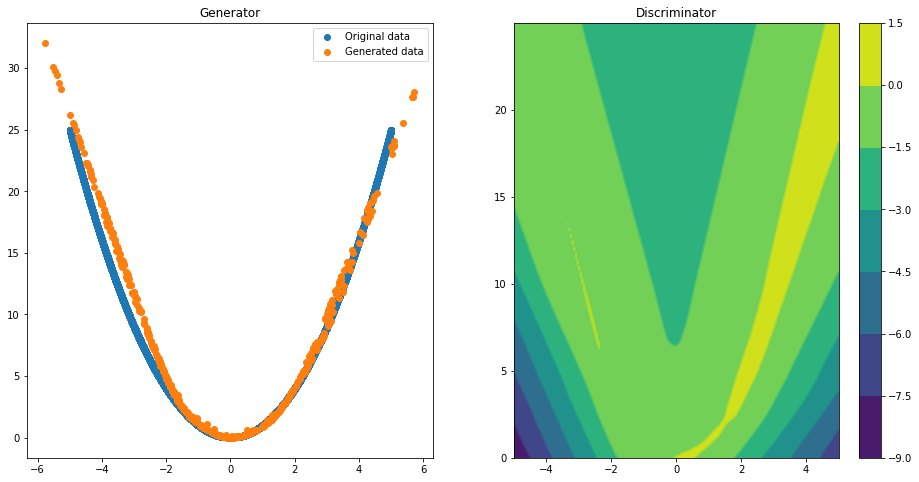

Epoch 050 | ET 1.84 min | Avg Losses >> G/D 0.6957/1.3935 [D-Real: 0.6966 D-Fake: 0.6969]


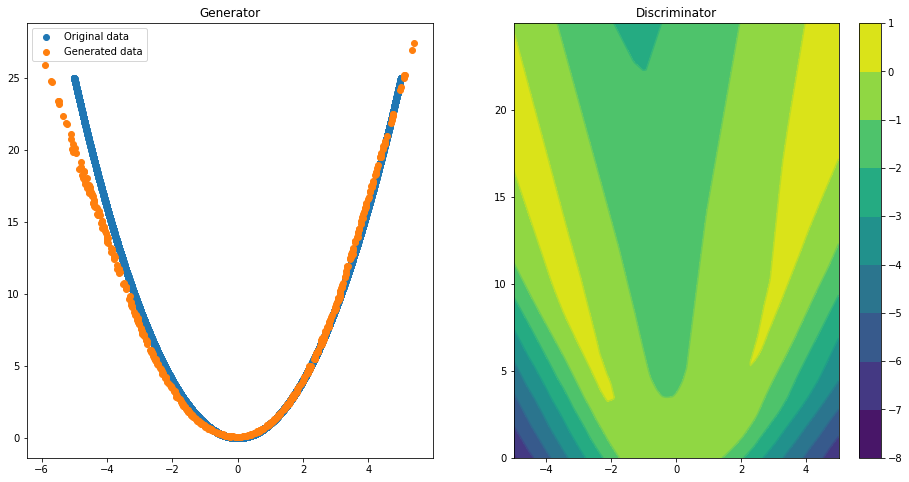

Epoch 100 | ET 3.11 min | Avg Losses >> G/D 0.7032/1.3884 [D-Real: 0.6983 D-Fake: 0.6901]


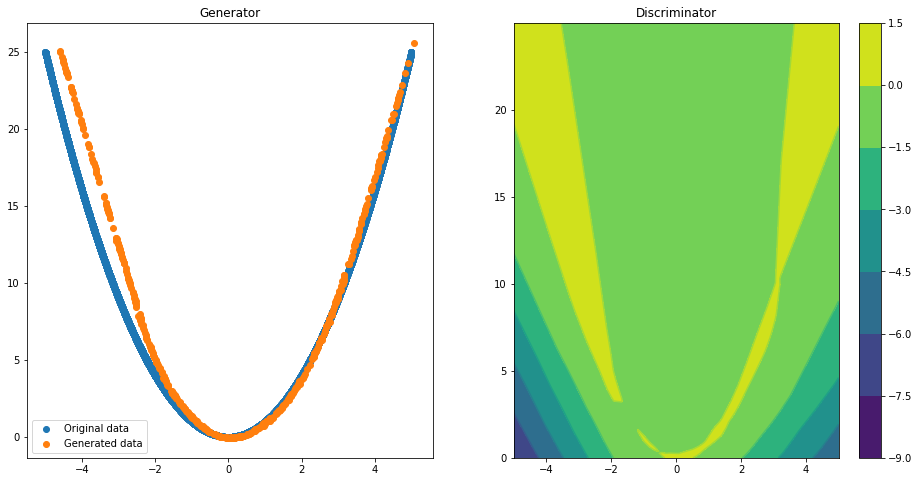

Epoch 150 | ET 4.39 min | Avg Losses >> G/D 0.7075/1.3820 [D-Real: 0.6972 D-Fake: 0.6848]


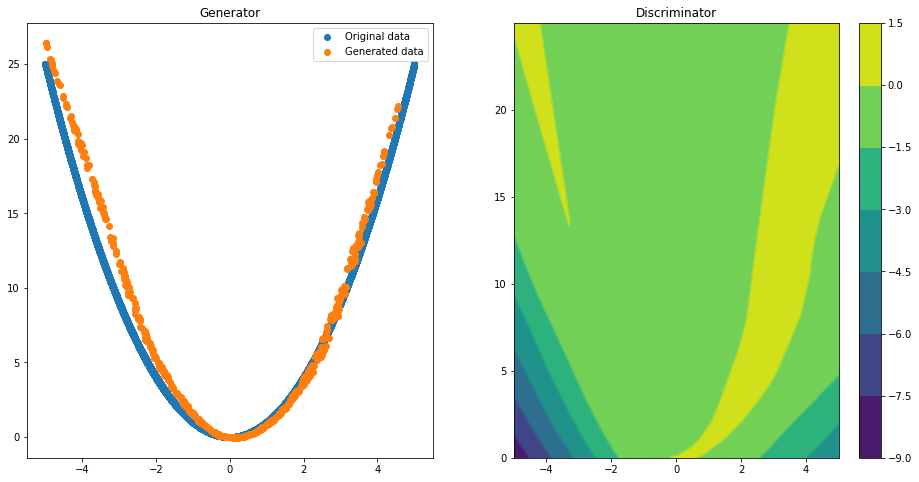

Epoch 200 | ET 5.65 min | Avg Losses >> G/D 0.7069/1.3882 [D-Real: 0.7035 D-Fake: 0.6847]


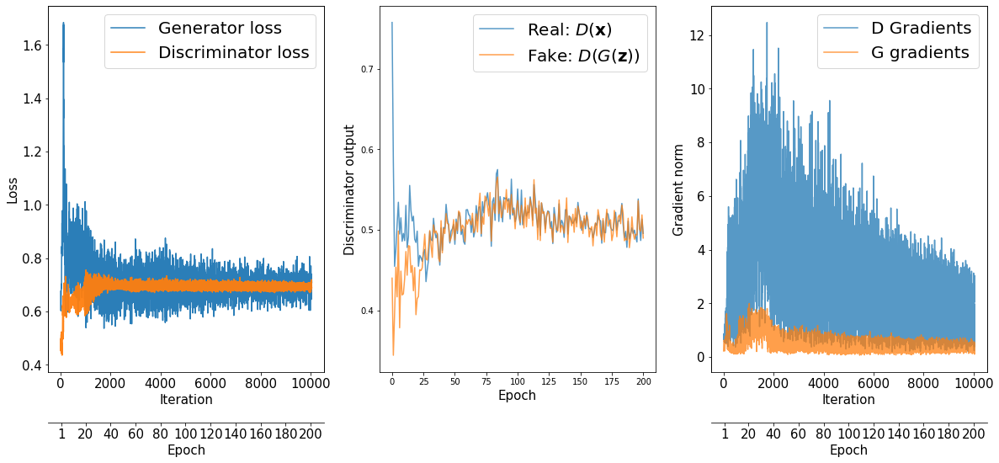

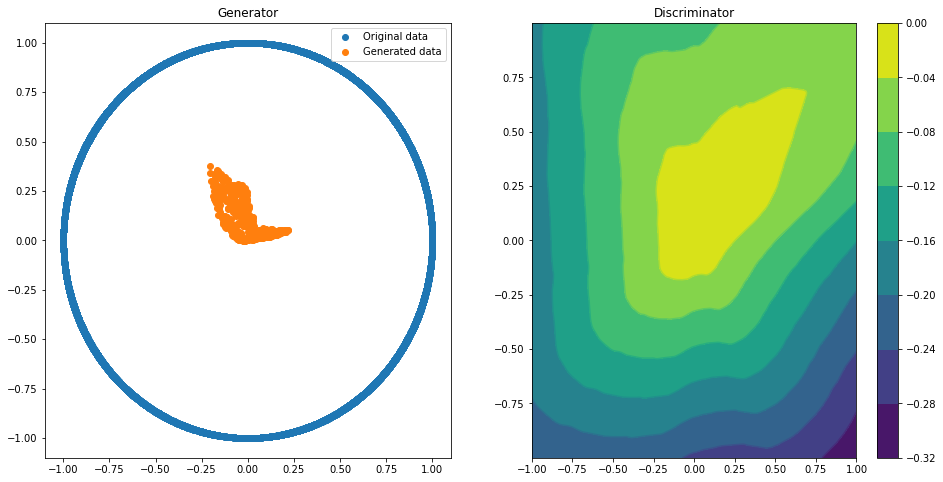

Epoch 000 | ET 0.57 min | Avg Losses >> G/D 0.7156/1.2606 [D-Real: 0.5771 D-Fake: 0.6836]


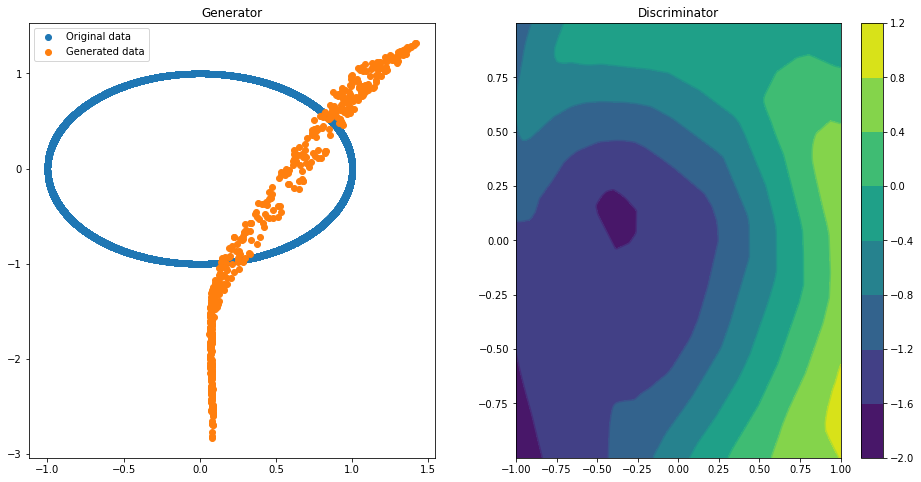

Epoch 050 | ET 1.84 min | Avg Losses >> G/D 1.0176/1.1331 [D-Real: 0.6472 D-Fake: 0.4859]


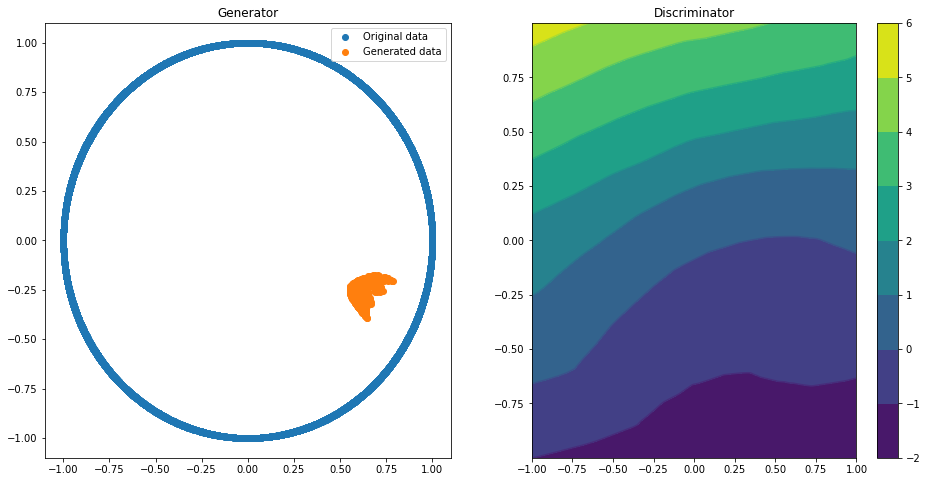

Epoch 100 | ET 3.10 min | Avg Losses >> G/D 0.7526/1.3608 [D-Real: 0.6173 D-Fake: 0.7435]


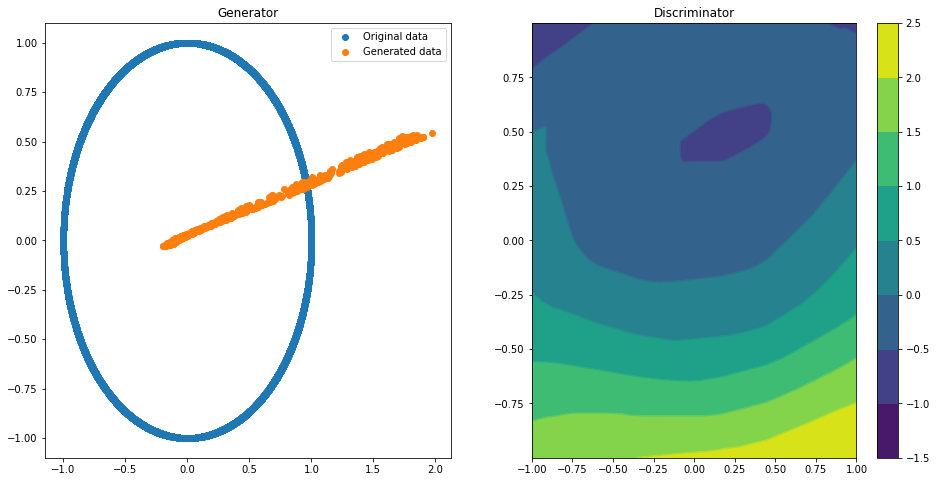

Epoch 150 | ET 4.37 min | Avg Losses >> G/D 0.7556/1.1815 [D-Real: 0.5298 D-Fake: 0.6517]


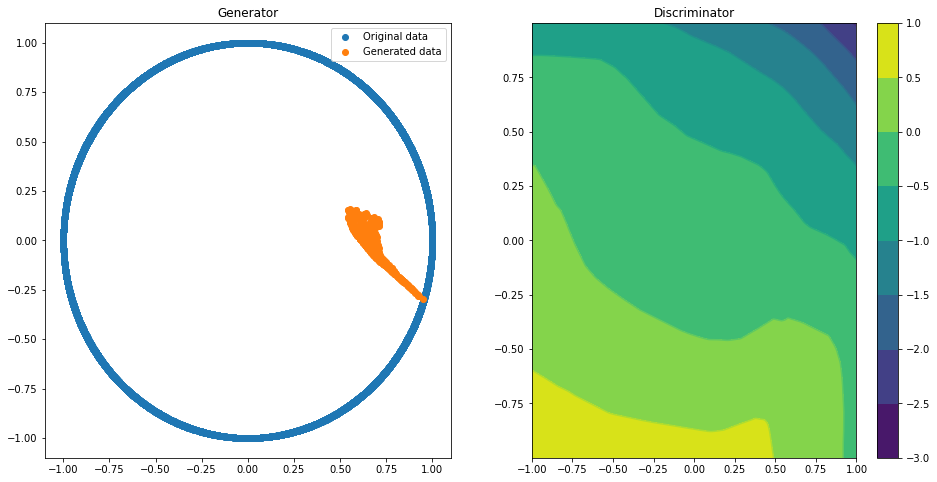

Epoch 200 | ET 5.64 min | Avg Losses >> G/D 0.7869/1.3419 [D-Real: 0.7277 D-Fake: 0.6141]


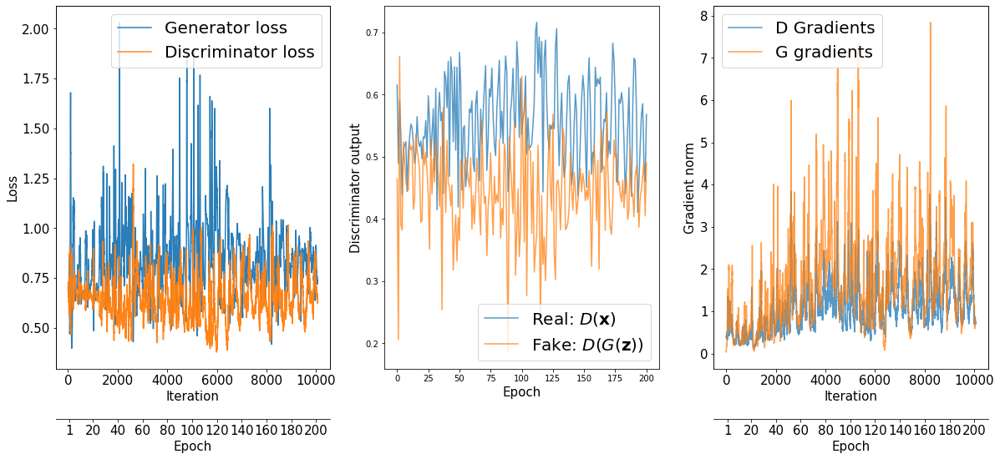

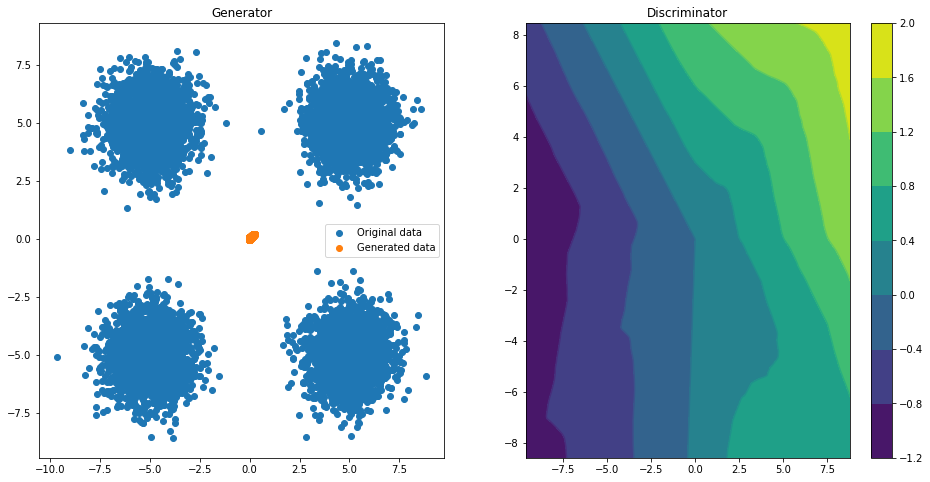

Epoch 000 | ET 0.63 min | Avg Losses >> G/D 0.6814/0.8747 [D-Real: 0.1651 D-Fake: 0.7096]


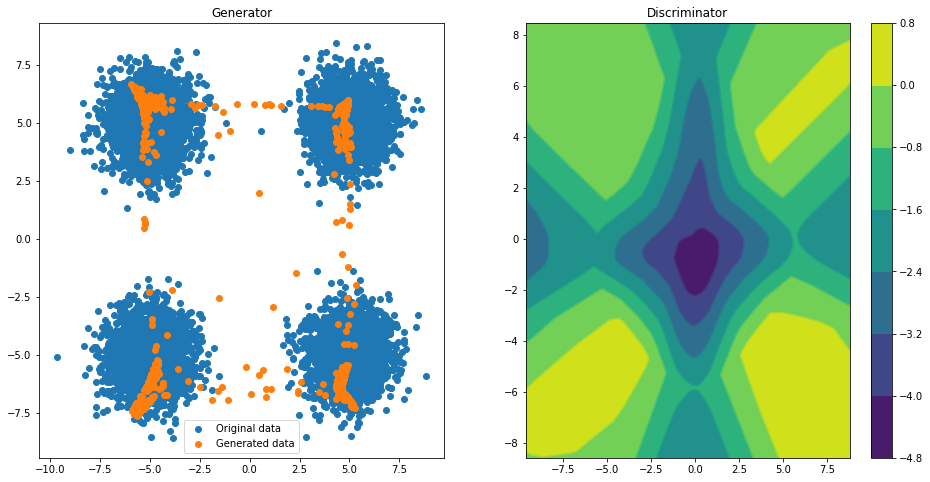

Epoch 050 | ET 1.91 min | Avg Losses >> G/D 0.7579/1.3805 [D-Real: 0.6923 D-Fake: 0.6881]


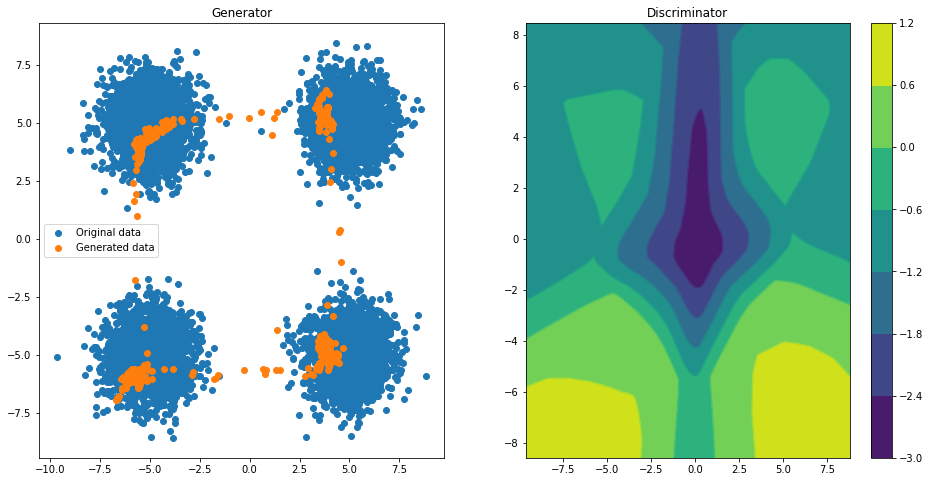

Epoch 100 | ET 3.18 min | Avg Losses >> G/D 0.7657/1.3962 [D-Real: 0.7043 D-Fake: 0.6918]


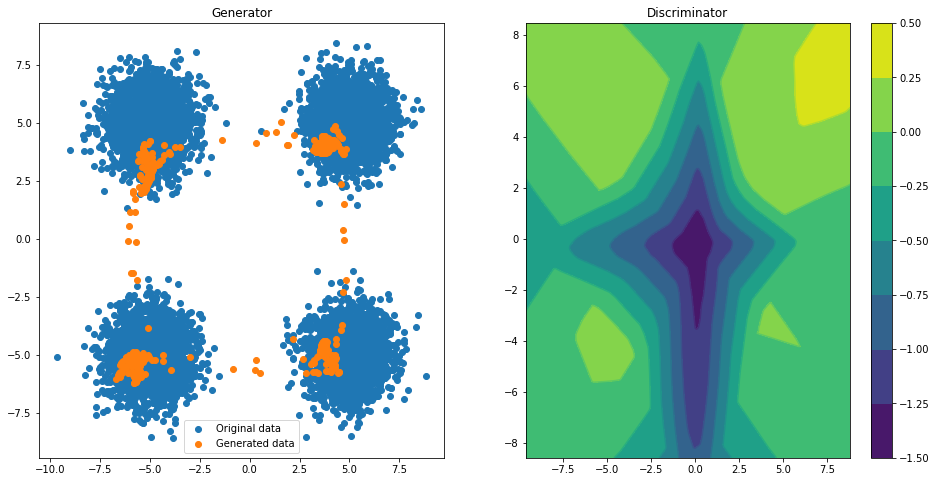

Epoch 150 | ET 4.44 min | Avg Losses >> G/D 0.6839/1.3844 [D-Real: 0.6723 D-Fake: 0.7121]


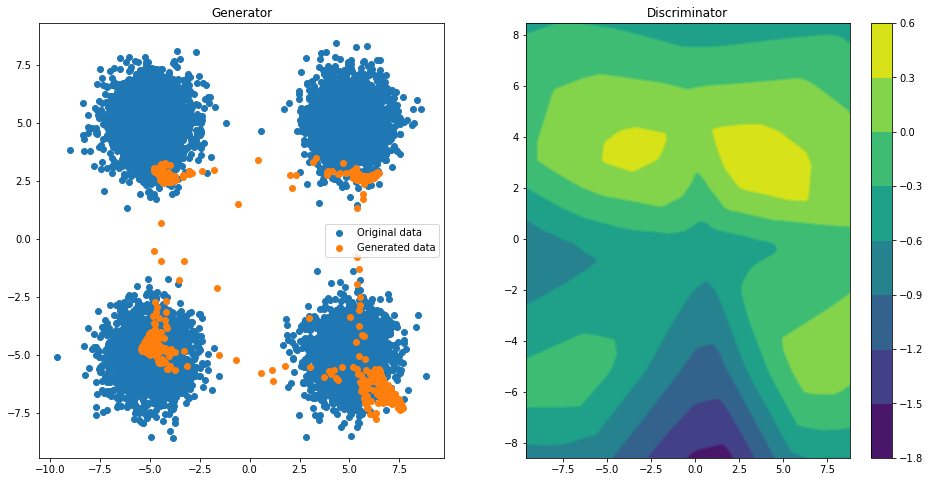

Epoch 200 | ET 5.71 min | Avg Losses >> G/D 0.6614/1.4011 [D-Real: 0.6618 D-Fake: 0.7393]


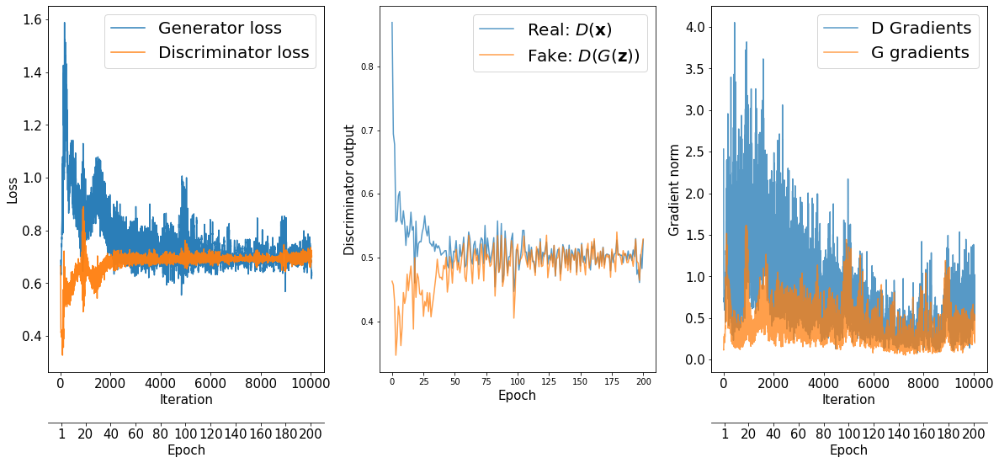

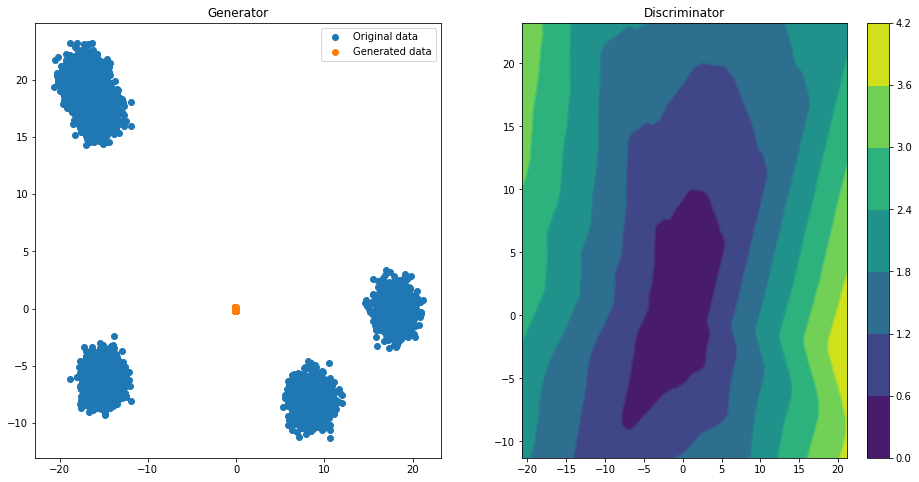

Epoch 000 | ET 0.58 min | Avg Losses >> G/D 0.7715/0.6518 [D-Real: 0.0238 D-Fake: 0.6280]


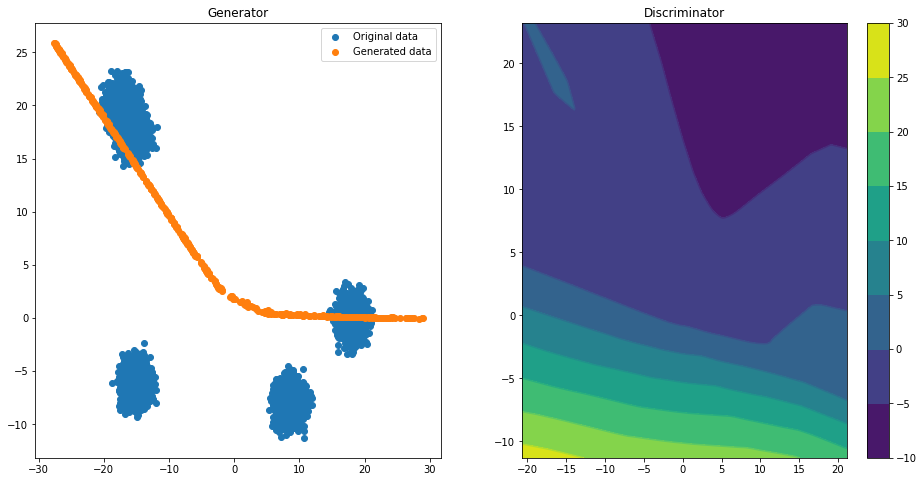

Epoch 050 | ET 1.86 min | Avg Losses >> G/D 1.2878/0.8465 [D-Real: 0.4616 D-Fake: 0.3849]


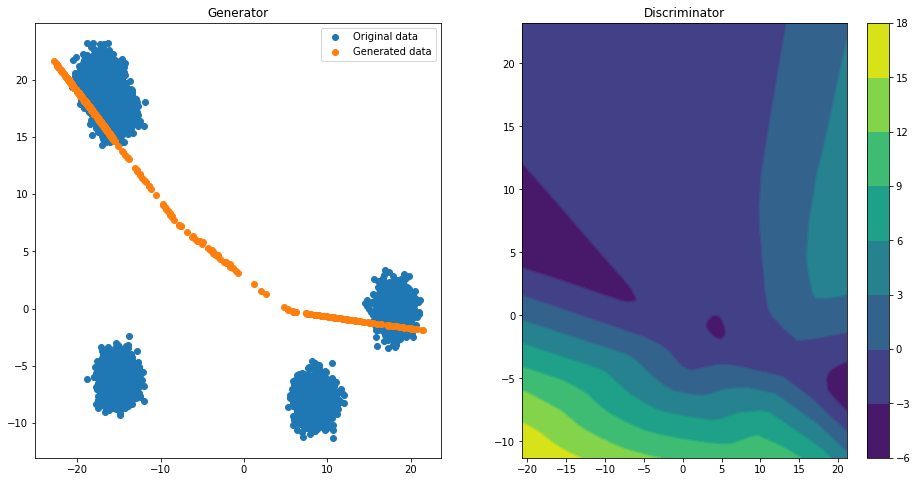

Epoch 100 | ET 3.14 min | Avg Losses >> G/D 1.1904/0.9556 [D-Real: 0.5347 D-Fake: 0.4209]


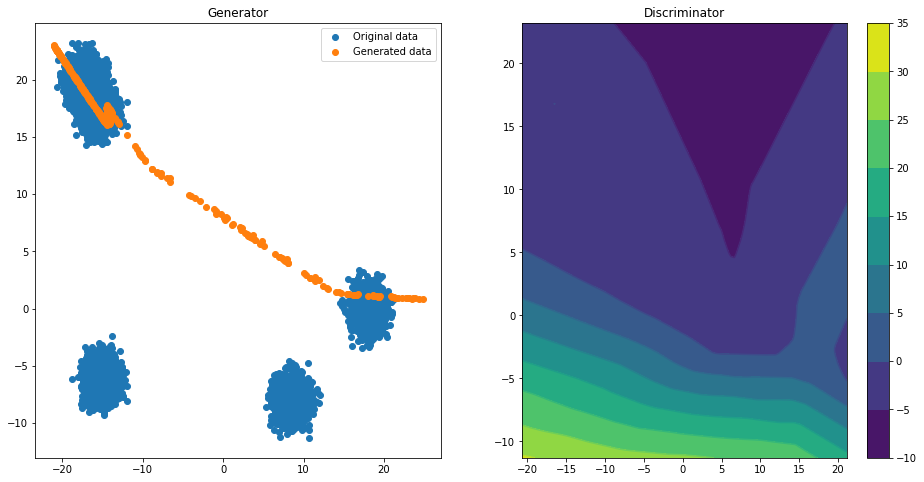

Epoch 150 | ET 4.41 min | Avg Losses >> G/D 1.2148/0.9299 [D-Real: 0.4823 D-Fake: 0.4475]


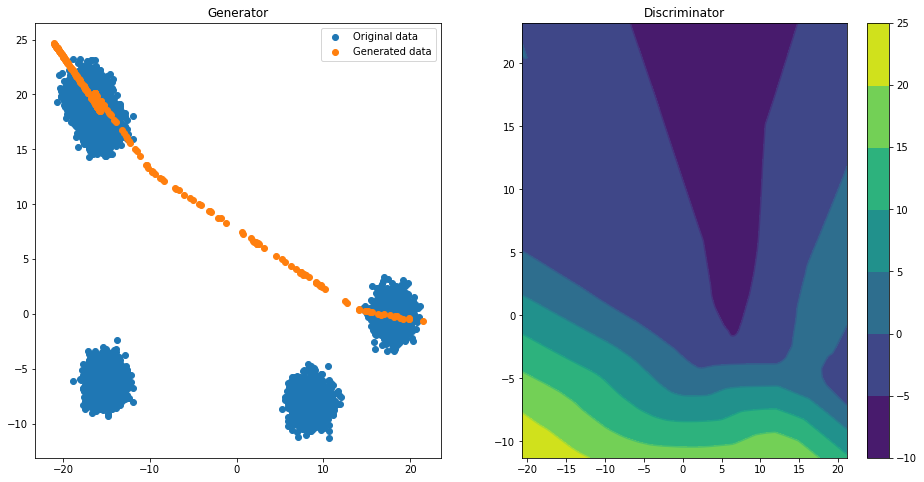

Epoch 200 | ET 5.73 min | Avg Losses >> G/D 1.3513/0.9499 [D-Real: 0.5489 D-Fake: 0.4010]


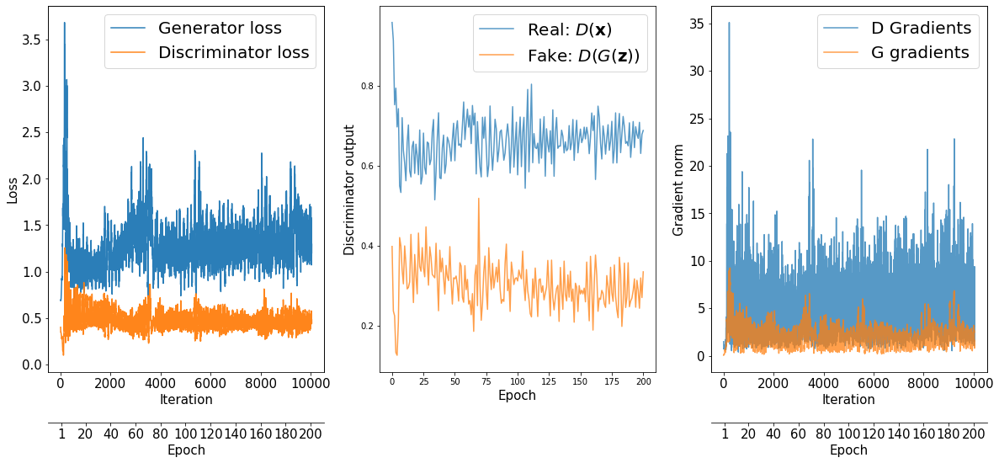

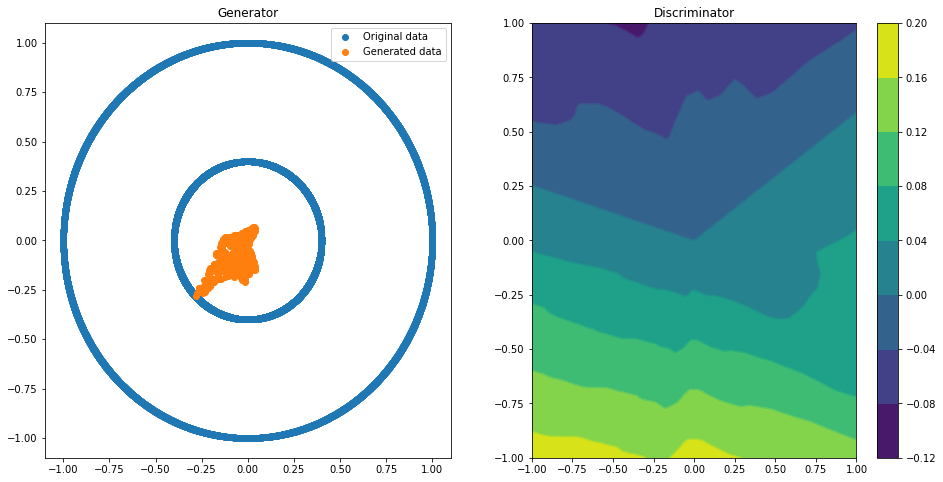

Epoch 000 | ET 0.57 min | Avg Losses >> G/D 0.7336/1.3057 [D-Real: 0.6355 D-Fake: 0.6702]


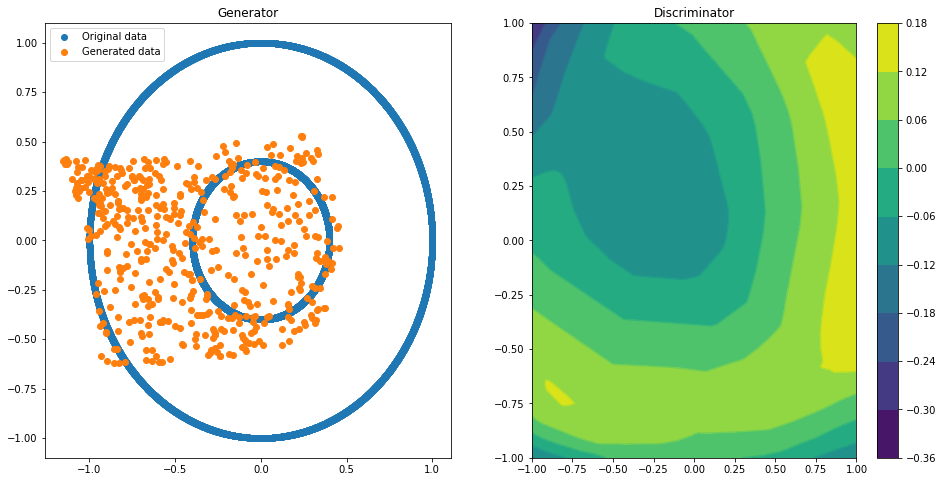

Epoch 050 | ET 1.83 min | Avg Losses >> G/D 0.7280/1.3484 [D-Real: 0.6855 D-Fake: 0.6629]


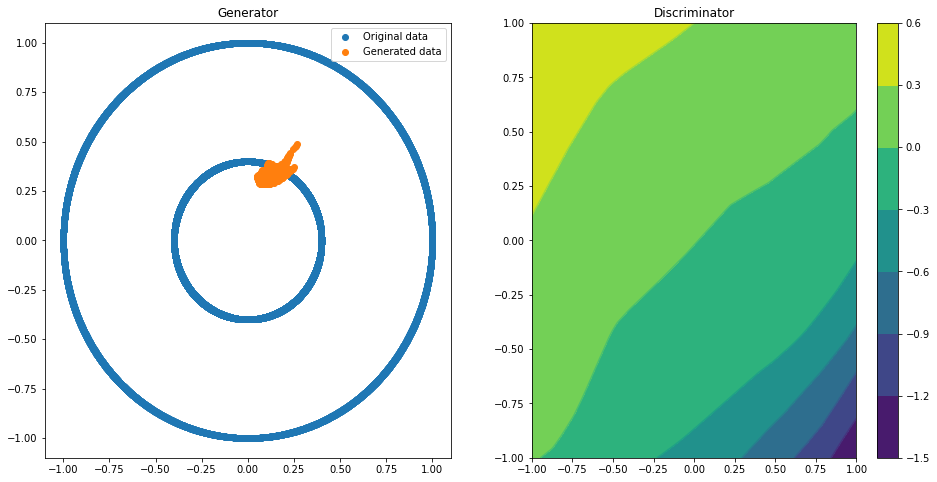

Epoch 100 | ET 3.10 min | Avg Losses >> G/D 0.6896/1.4189 [D-Real: 0.7219 D-Fake: 0.6970]


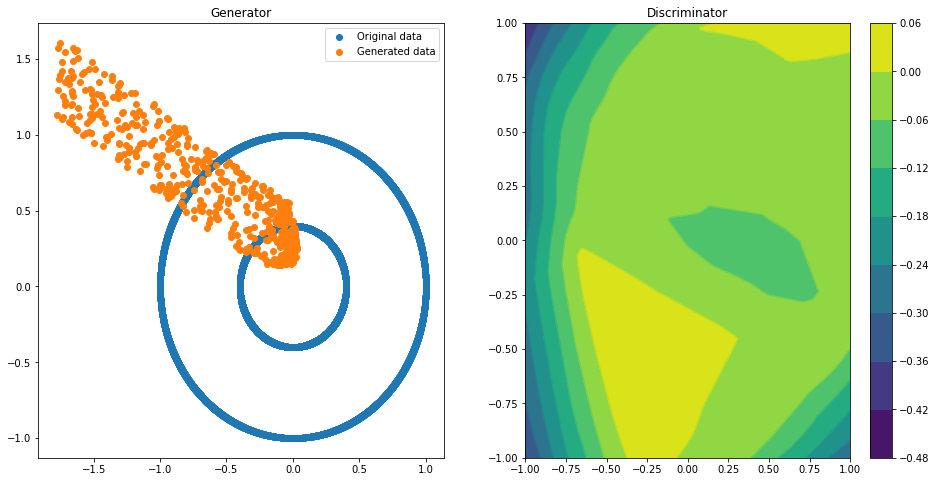

Epoch 150 | ET 4.35 min | Avg Losses >> G/D 0.7178/1.3425 [D-Real: 0.6651 D-Fake: 0.6774]


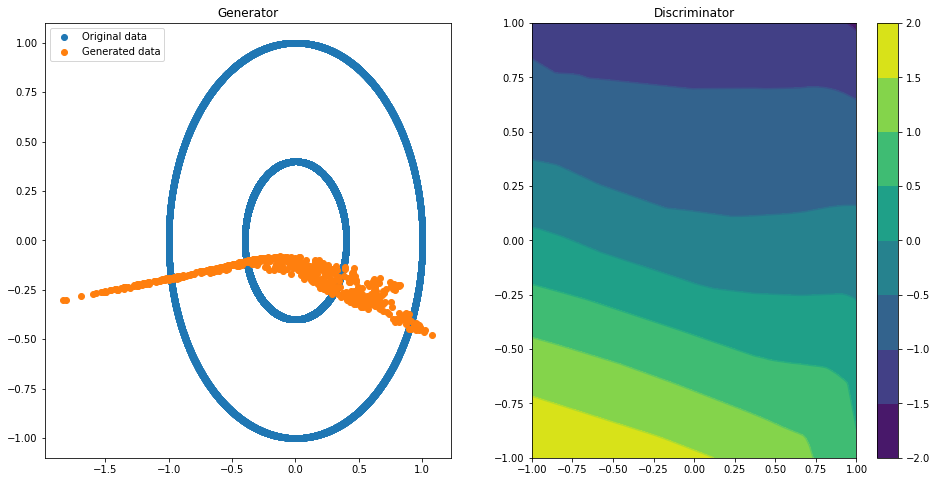

Epoch 200 | ET 5.62 min | Avg Losses >> G/D 0.6927/1.5344 [D-Real: 0.8216 D-Fake: 0.7128]


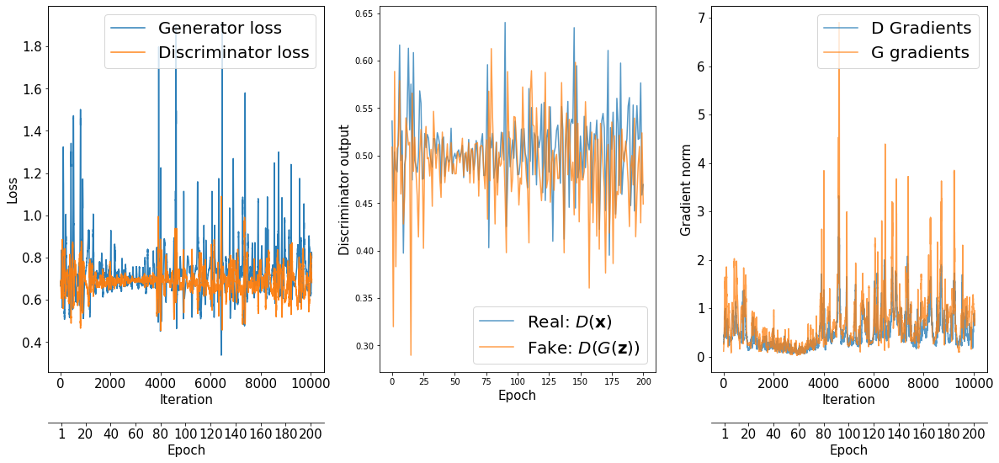

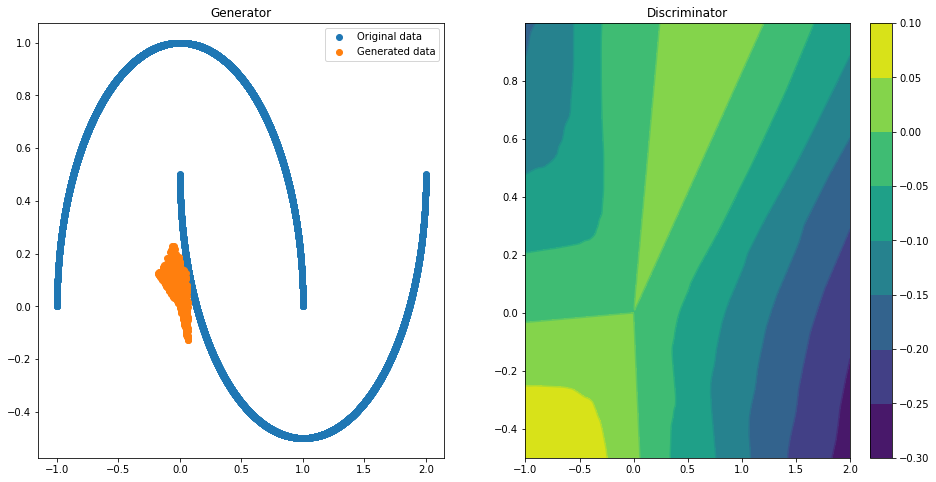

Epoch 000 | ET 0.58 min | Avg Losses >> G/D 0.7042/1.2954 [D-Real: 0.5951 D-Fake: 0.7003]


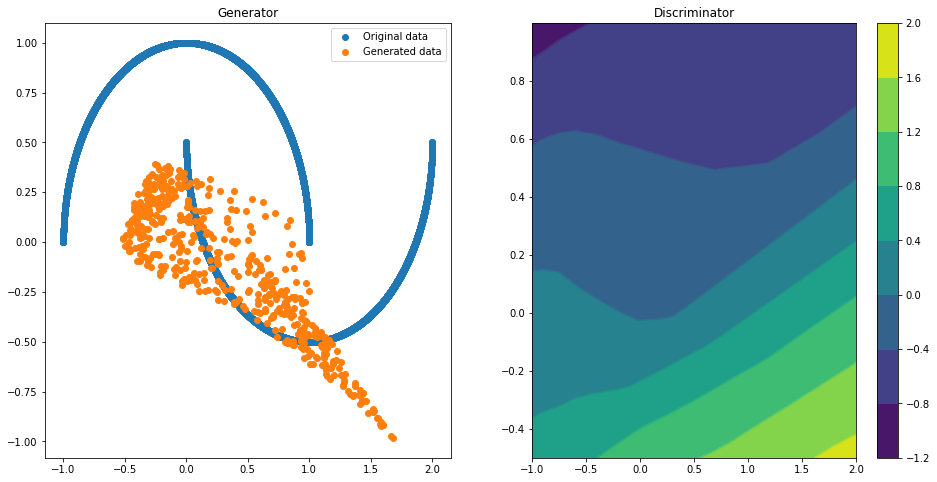

Epoch 050 | ET 1.85 min | Avg Losses >> G/D 0.6176/1.4010 [D-Real: 0.5973 D-Fake: 0.8037]


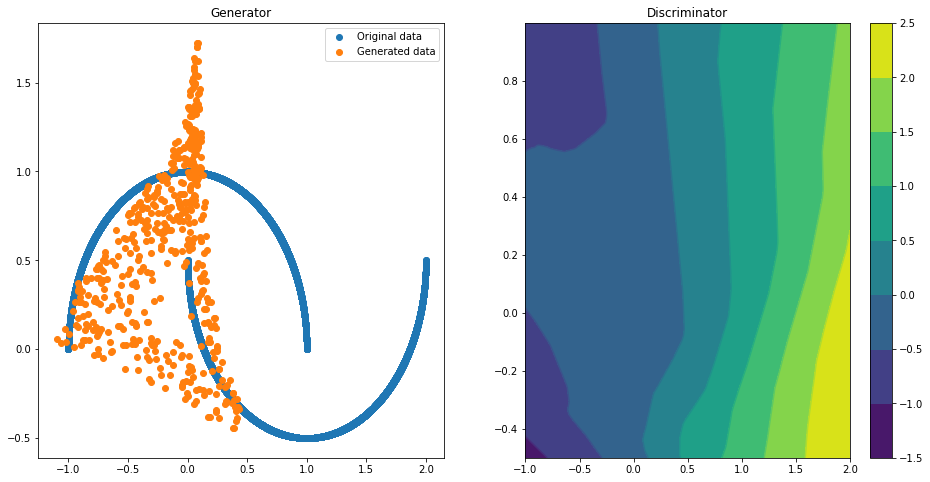

Epoch 100 | ET 3.11 min | Avg Losses >> G/D 0.7915/1.3669 [D-Real: 0.7190 D-Fake: 0.6479]


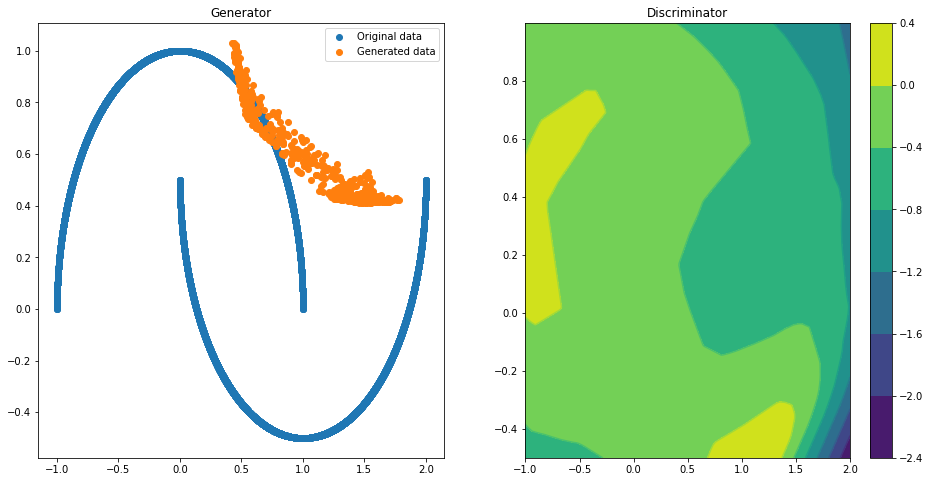

Epoch 150 | ET 4.43 min | Avg Losses >> G/D 0.8839/1.2270 [D-Real: 0.6867 D-Fake: 0.5402]


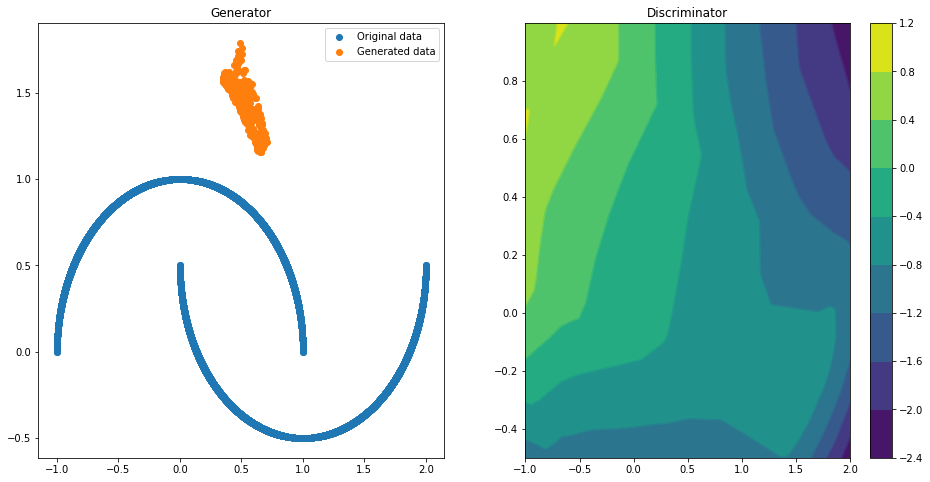

Epoch 200 | ET 5.71 min | Avg Losses >> G/D 0.8015/1.3912 [D-Real: 0.7908 D-Fake: 0.6004]


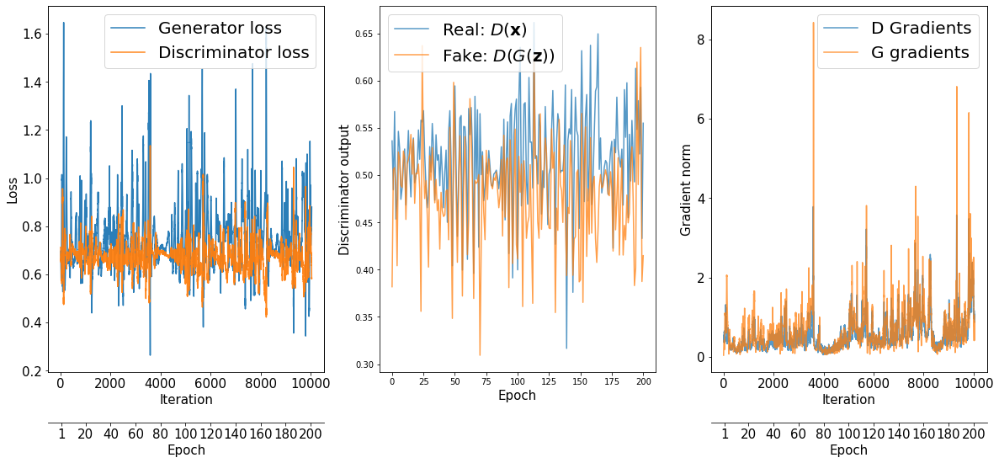

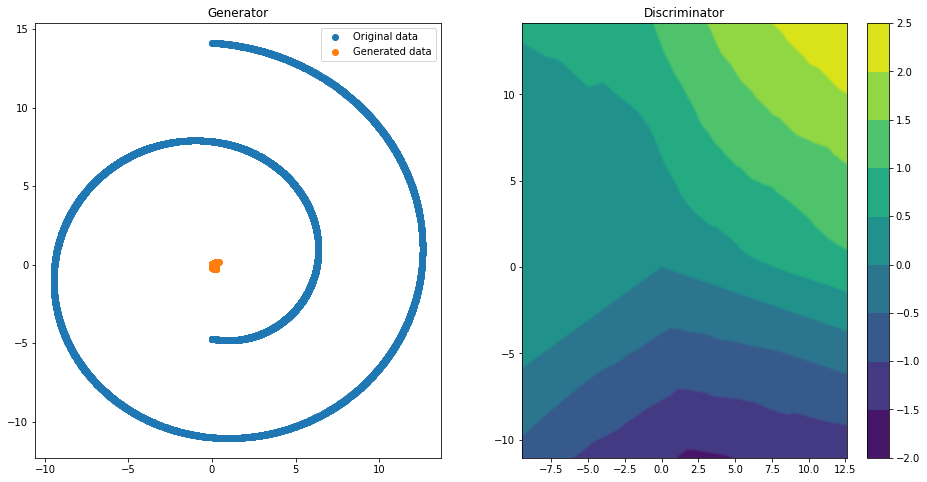

Epoch 000 | ET 0.57 min | Avg Losses >> G/D 0.6820/0.8388 [D-Real: 0.1276 D-Fake: 0.7112]


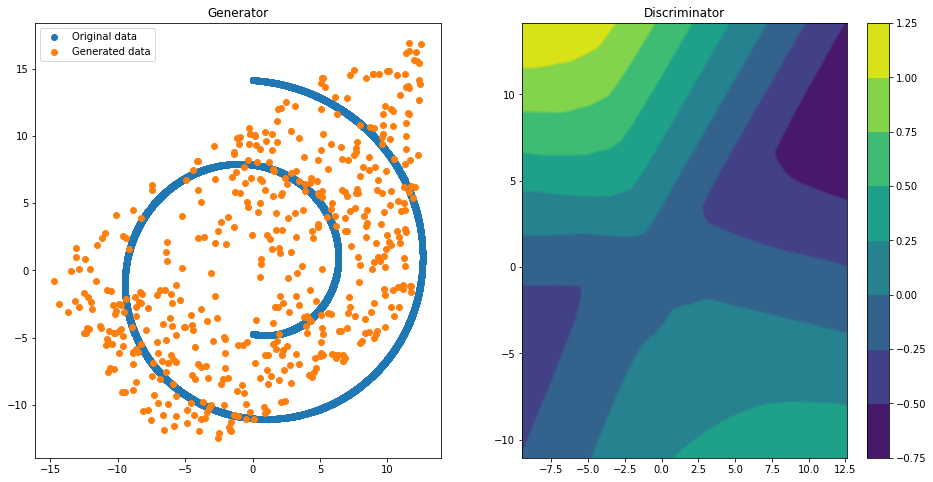

Epoch 050 | ET 1.83 min | Avg Losses >> G/D 0.7121/1.3877 [D-Real: 0.6906 D-Fake: 0.6970]


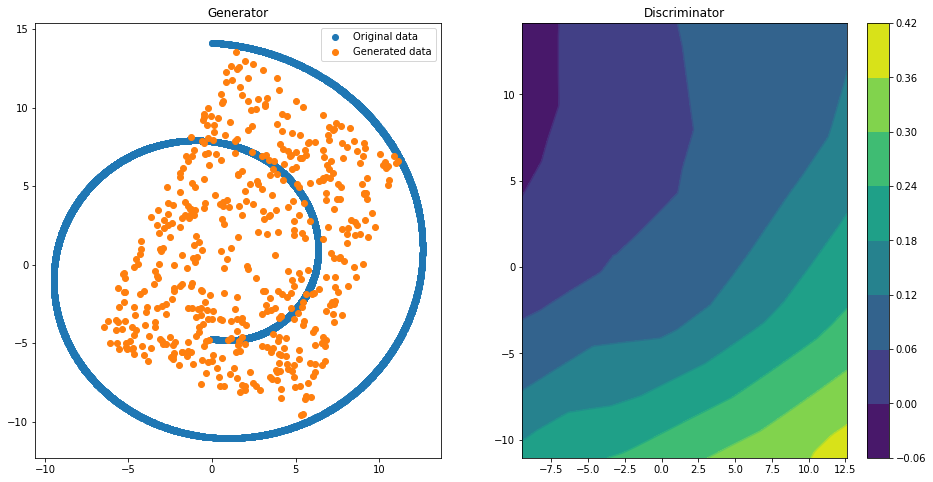

Epoch 100 | ET 3.09 min | Avg Losses >> G/D 0.6554/1.3743 [D-Real: 0.6393 D-Fake: 0.7350]


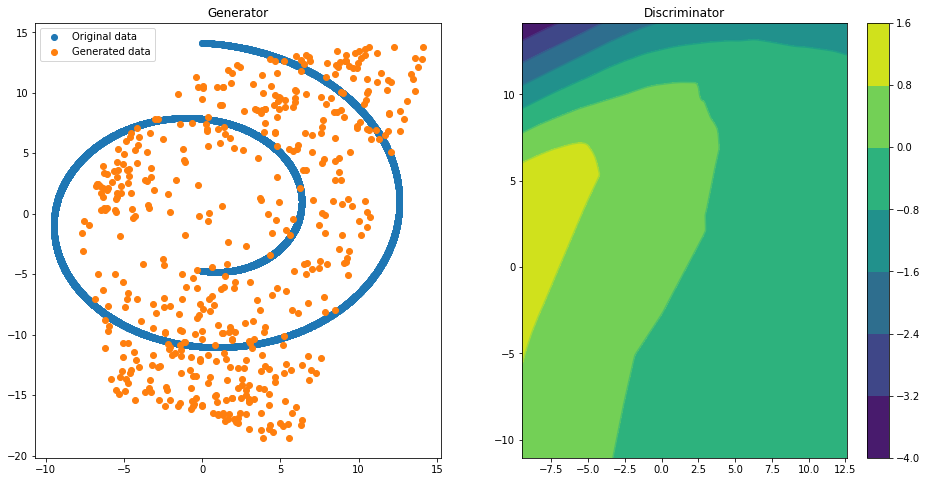

Epoch 150 | ET 4.35 min | Avg Losses >> G/D 0.7006/1.3709 [D-Real: 0.6582 D-Fake: 0.7127]


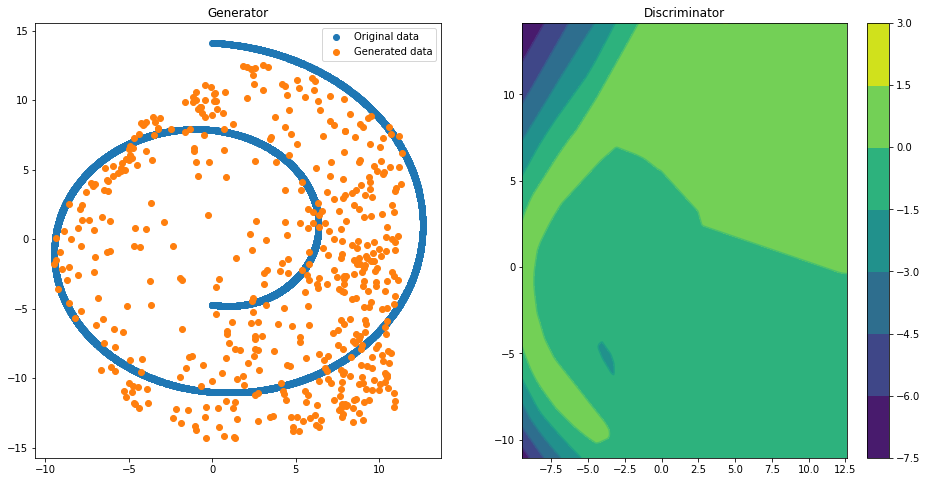

Epoch 200 | ET 5.60 min | Avg Losses >> G/D 0.7606/1.3424 [D-Real: 0.6723 D-Fake: 0.6702]


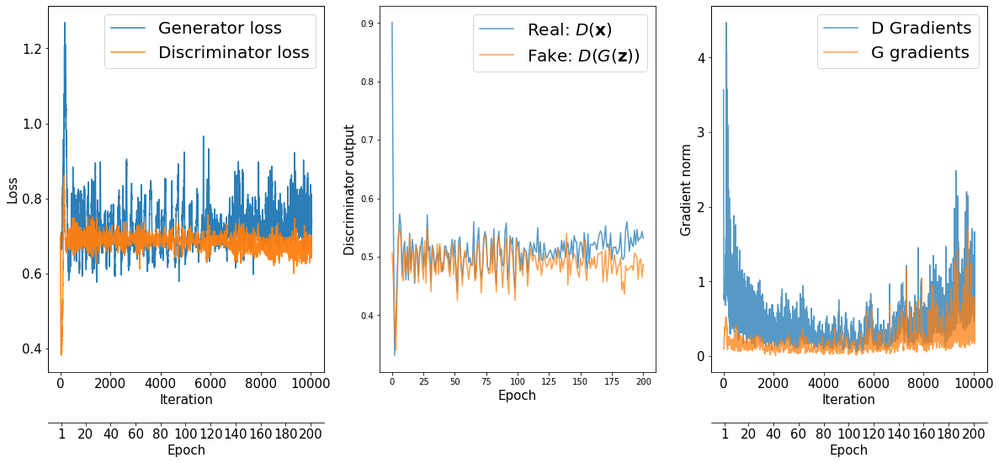

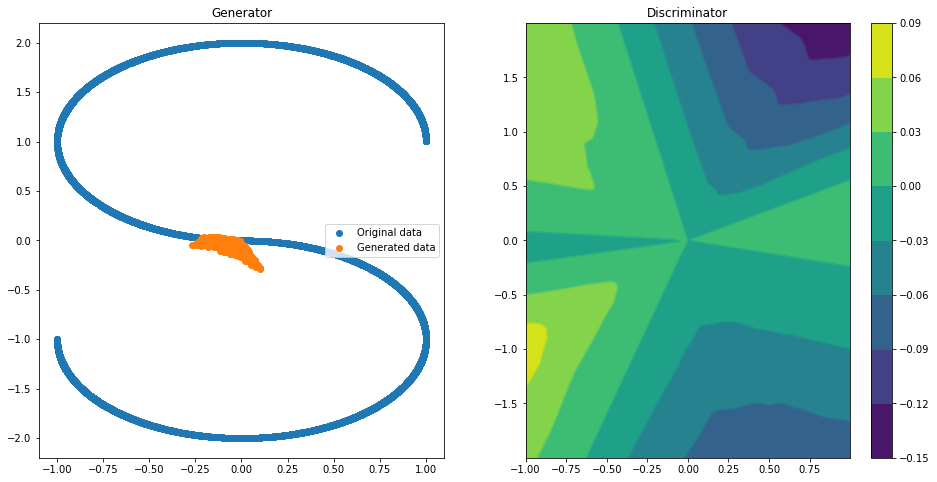

Epoch 000 | ET 0.58 min | Avg Losses >> G/D 0.6534/1.2603 [D-Real: 0.5103 D-Fake: 0.7500]


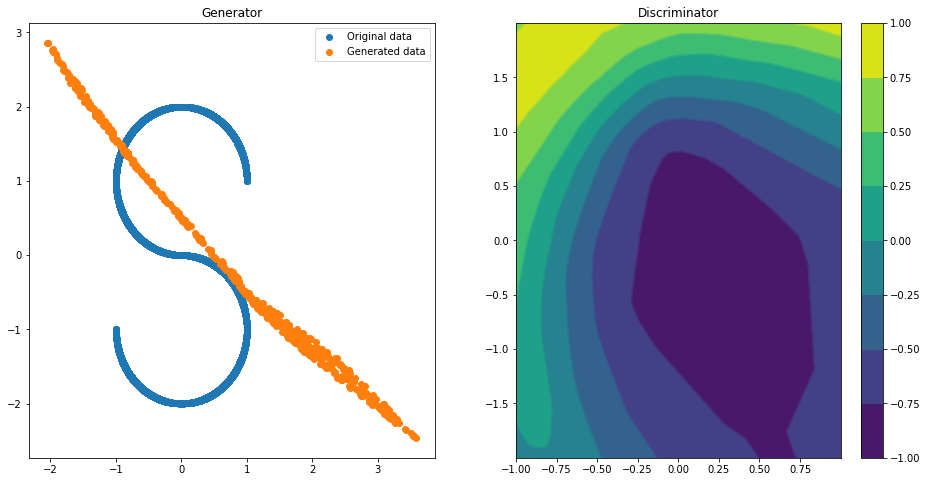

Epoch 050 | ET 1.84 min | Avg Losses >> G/D 1.0592/1.1341 [D-Real: 0.6437 D-Fake: 0.4904]


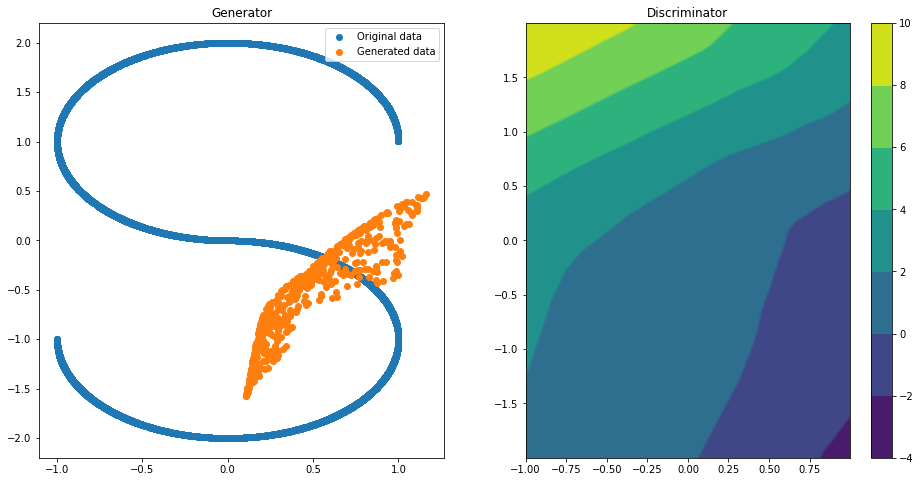

Epoch 100 | ET 3.11 min | Avg Losses >> G/D 0.7690/1.3493 [D-Real: 0.6770 D-Fake: 0.6722]


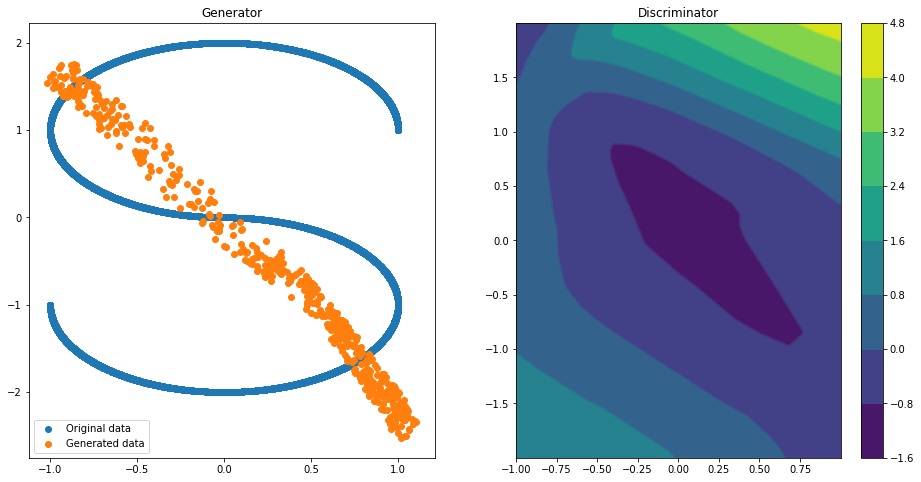

Epoch 150 | ET 4.37 min | Avg Losses >> G/D 0.9132/1.1928 [D-Real: 0.6552 D-Fake: 0.5376]


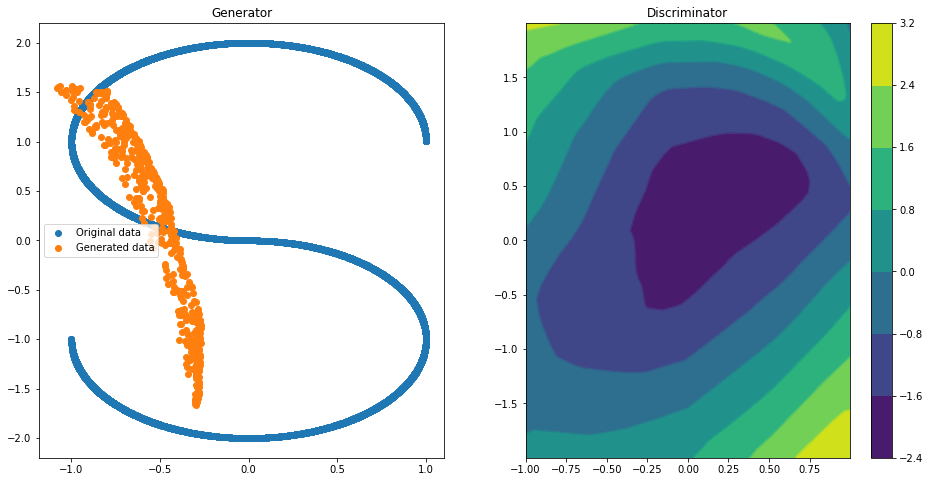

Epoch 200 | ET 5.63 min | Avg Losses >> G/D 1.1816/1.2383 [D-Real: 0.7599 D-Fake: 0.4784]


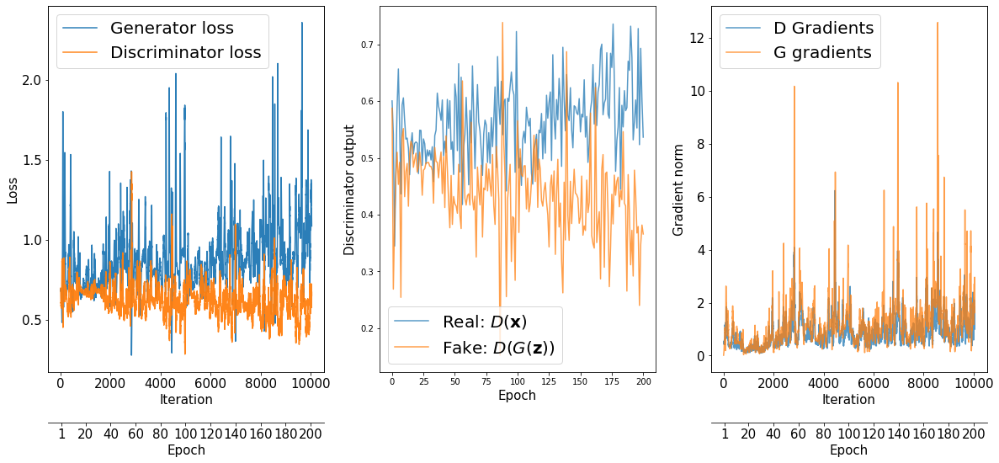

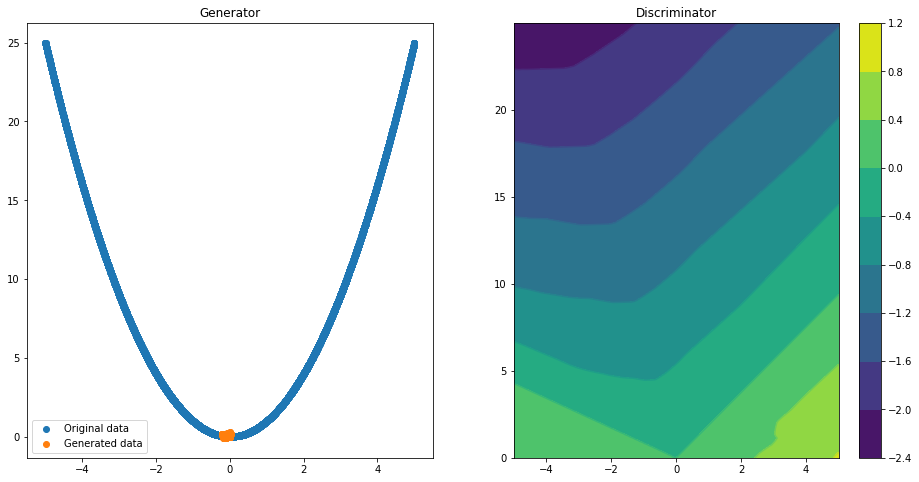

Epoch 000 | ET 0.57 min | Avg Losses >> G/D 0.6128/1.0721 [D-Real: 0.2837 D-Fake: 0.7885]


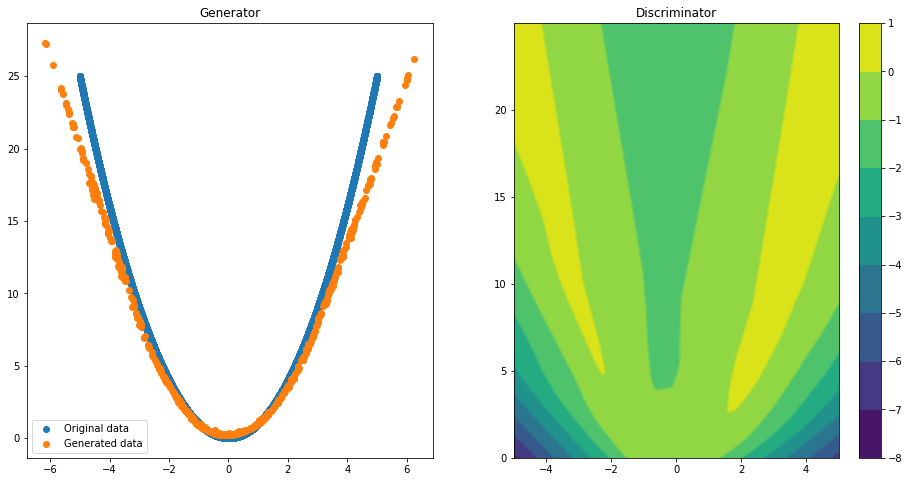

Epoch 050 | ET 1.83 min | Avg Losses >> G/D 0.6982/1.3889 [D-Real: 0.6927 D-Fake: 0.6962]


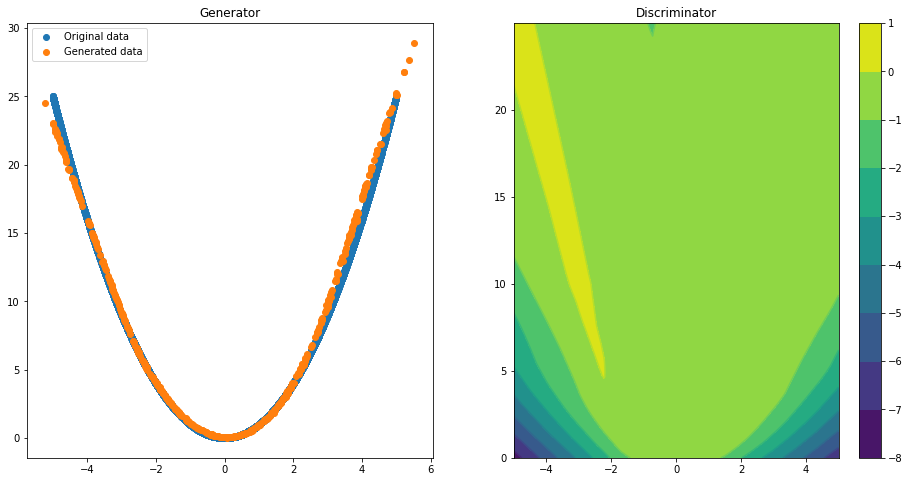

Epoch 100 | ET 3.09 min | Avg Losses >> G/D 0.6944/1.3929 [D-Real: 0.6965 D-Fake: 0.6964]


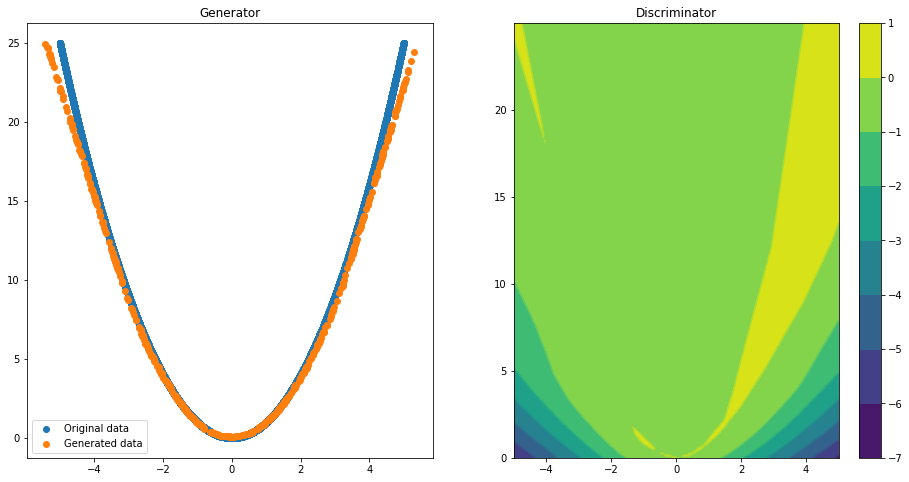

Epoch 150 | ET 4.36 min | Avg Losses >> G/D 0.6952/1.3885 [D-Real: 0.6927 D-Fake: 0.6958]


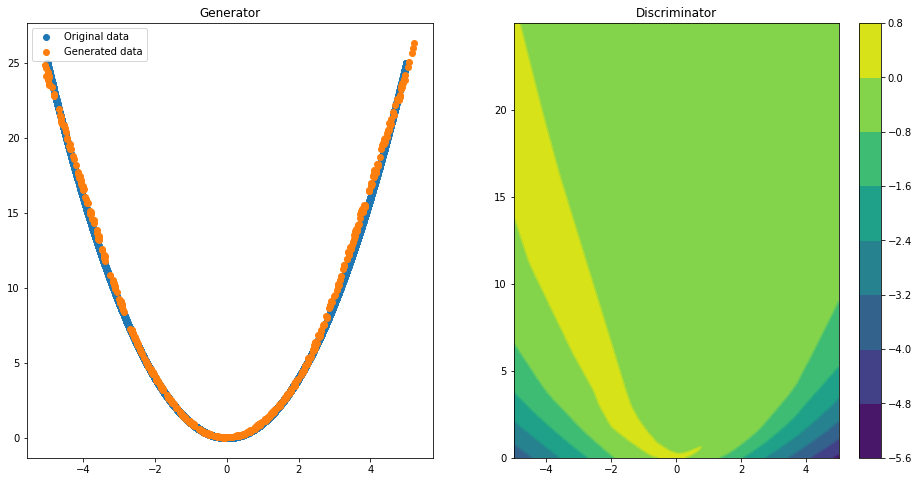

Epoch 200 | ET 5.63 min | Avg Losses >> G/D 0.6882/1.3866 [D-Real: 0.6861 D-Fake: 0.7005]


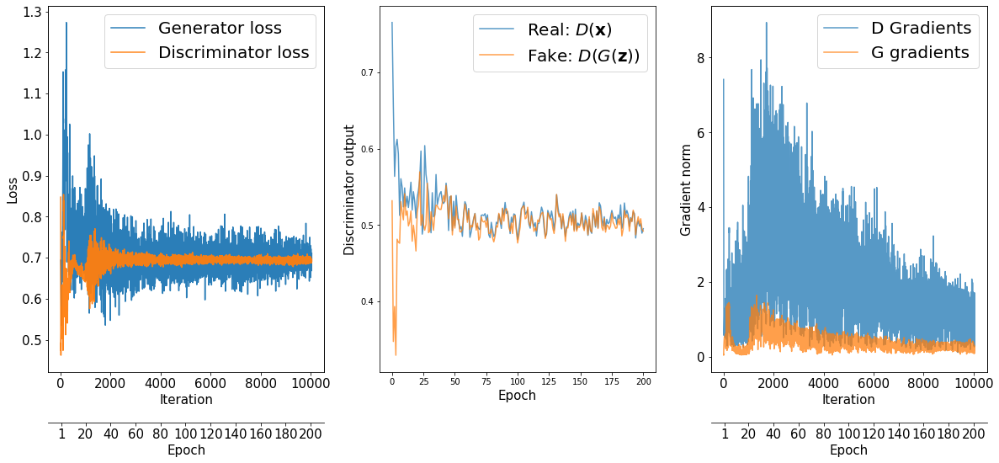

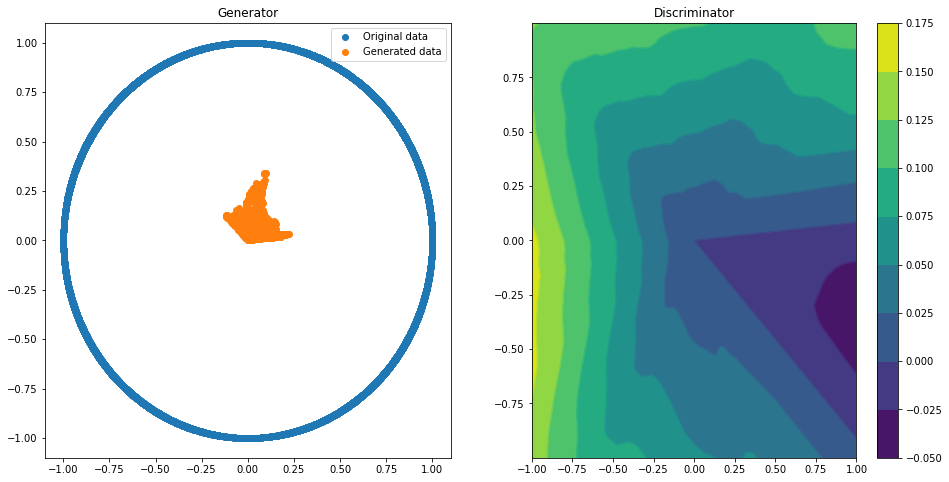

Epoch 000 | ET 0.57 min | Avg Losses >> G/D 0.6702/1.2776 [D-Real: 0.5453 D-Fake: 0.7323]


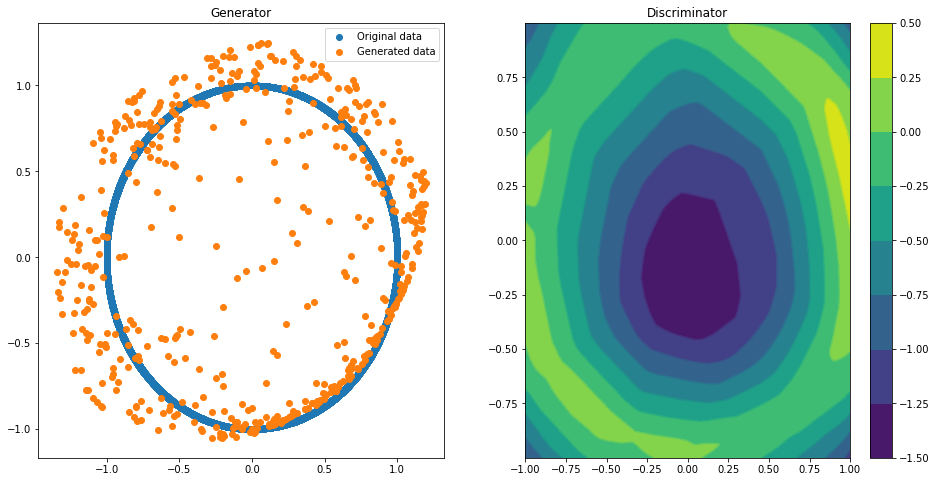

Epoch 050 | ET 1.83 min | Avg Losses >> G/D 0.7373/1.3213 [D-Real: 0.6526 D-Fake: 0.6687]


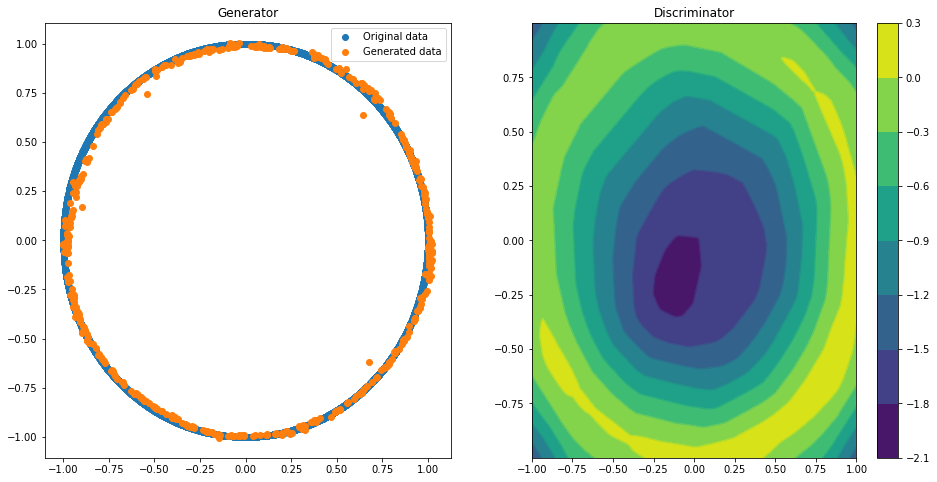

Epoch 100 | ET 3.10 min | Avg Losses >> G/D 0.6986/1.3839 [D-Real: 0.6929 D-Fake: 0.6910]


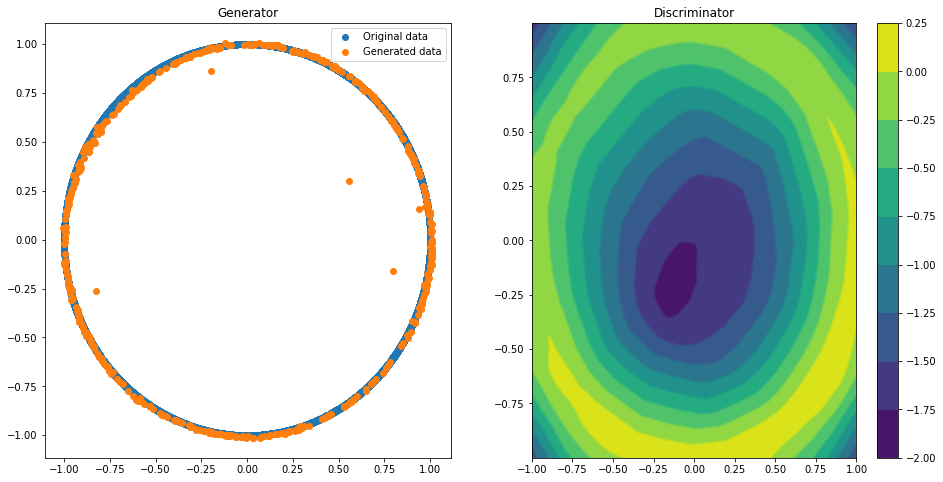

Epoch 150 | ET 4.35 min | Avg Losses >> G/D 0.6953/1.3865 [D-Real: 0.6935 D-Fake: 0.6930]


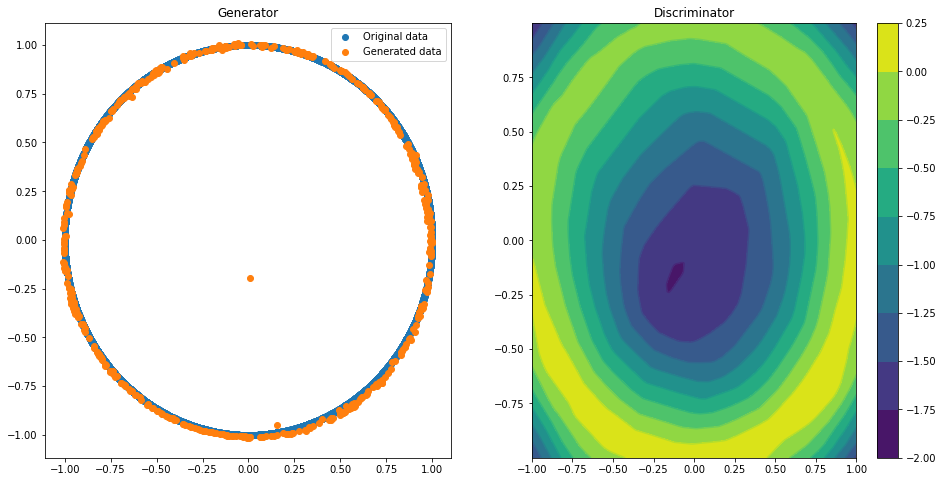

Epoch 200 | ET 5.67 min | Avg Losses >> G/D 0.6959/1.3854 [D-Real: 0.6929 D-Fake: 0.6925]


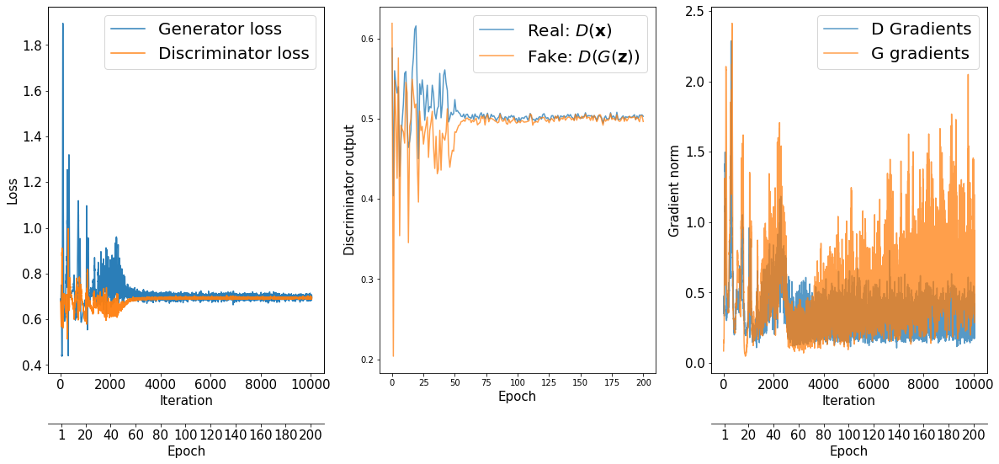

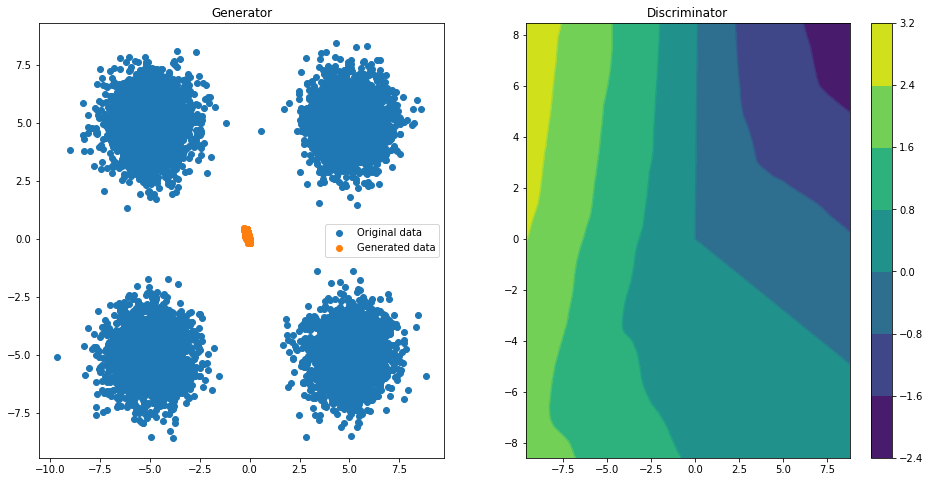

Epoch 000 | ET 0.58 min | Avg Losses >> G/D 0.7063/0.8604 [D-Real: 0.1649 D-Fake: 0.6955]


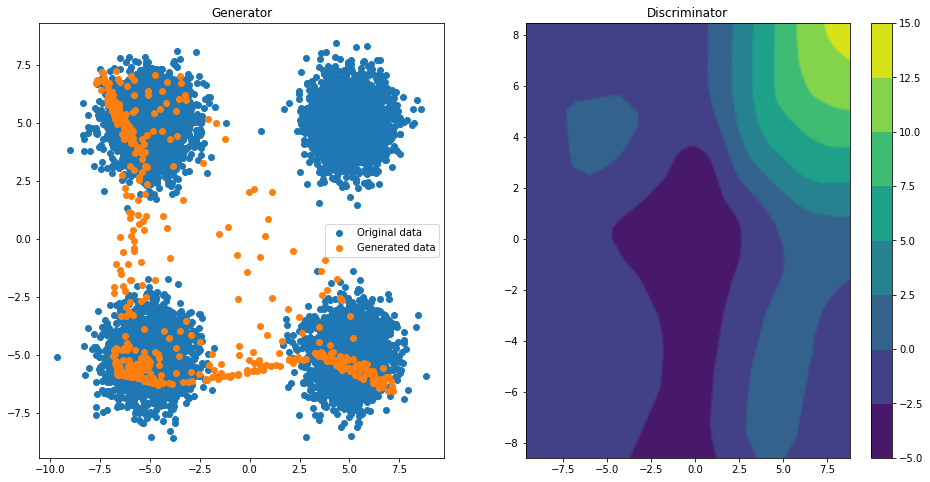

Epoch 050 | ET 1.86 min | Avg Losses >> G/D 1.1787/1.0664 [D-Real: 0.5600 D-Fake: 0.5064]


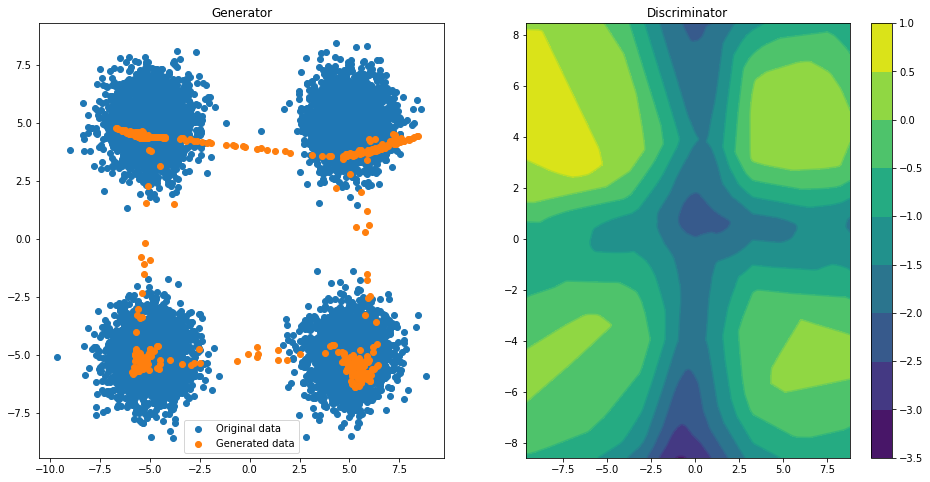

Epoch 100 | ET 3.14 min | Avg Losses >> G/D 0.7251/1.3858 [D-Real: 0.6837 D-Fake: 0.7021]


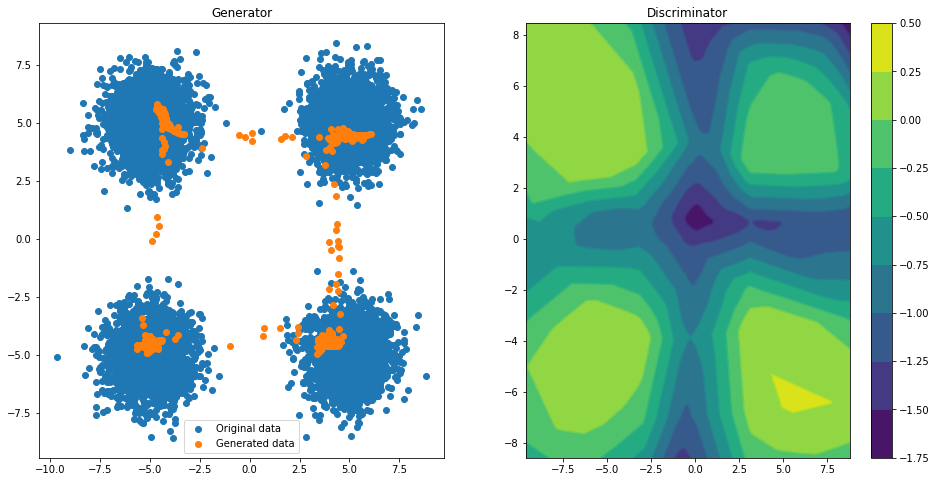

Epoch 150 | ET 4.41 min | Avg Losses >> G/D 0.7024/1.3906 [D-Real: 0.6848 D-Fake: 0.7058]


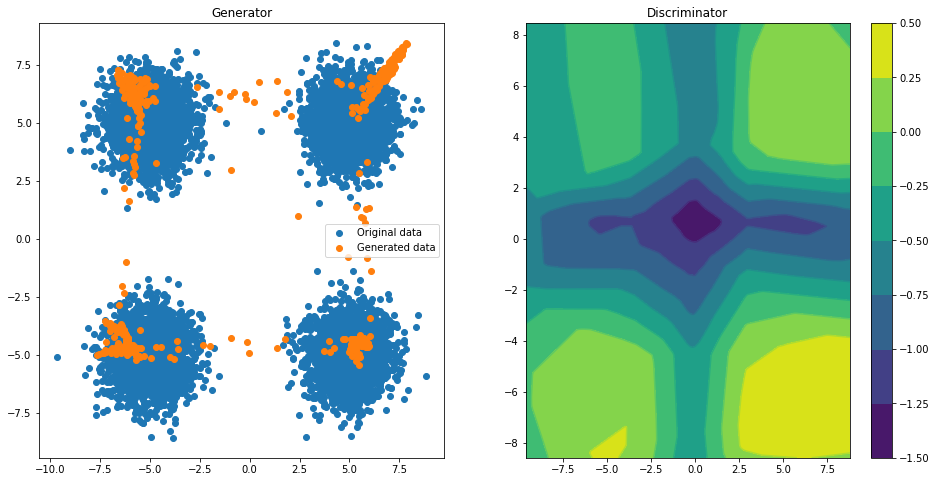

Epoch 200 | ET 5.68 min | Avg Losses >> G/D 0.7073/1.3861 [D-Real: 0.6903 D-Fake: 0.6958]


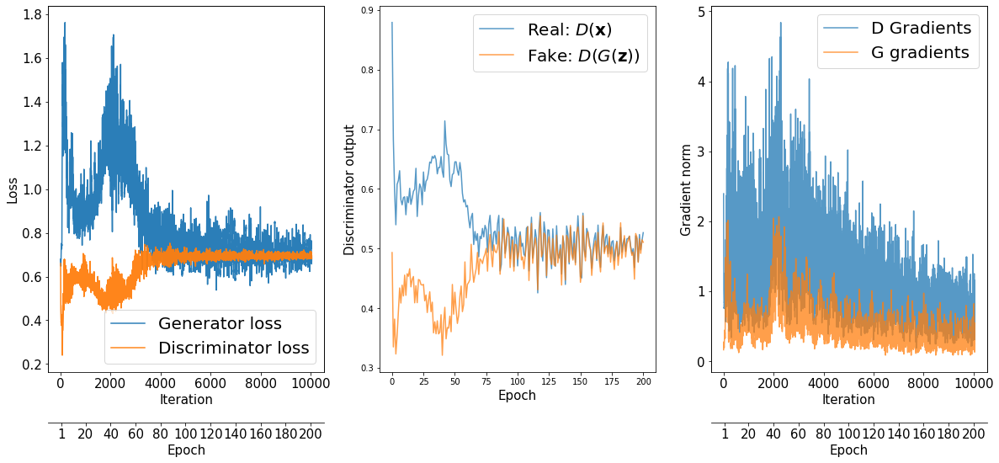

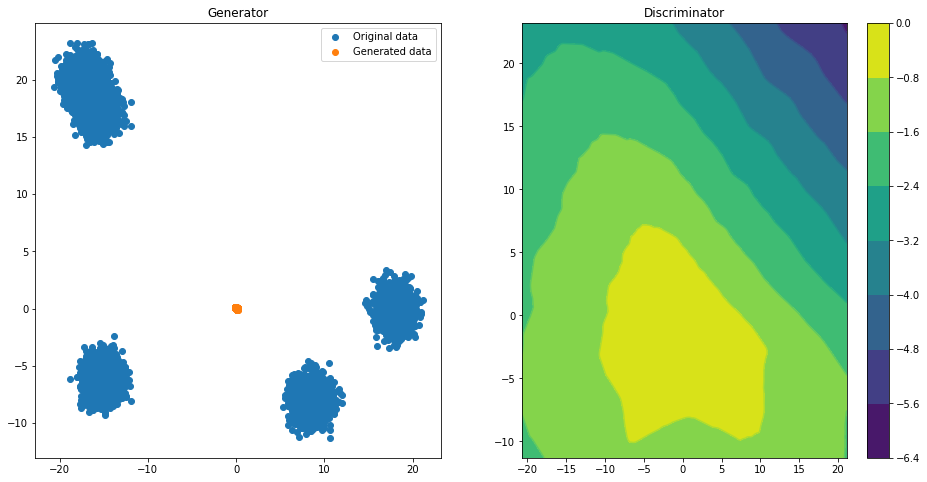

Epoch 000 | ET 0.57 min | Avg Losses >> G/D 0.6853/0.8784 [D-Real: 0.1753 D-Fake: 0.7031]


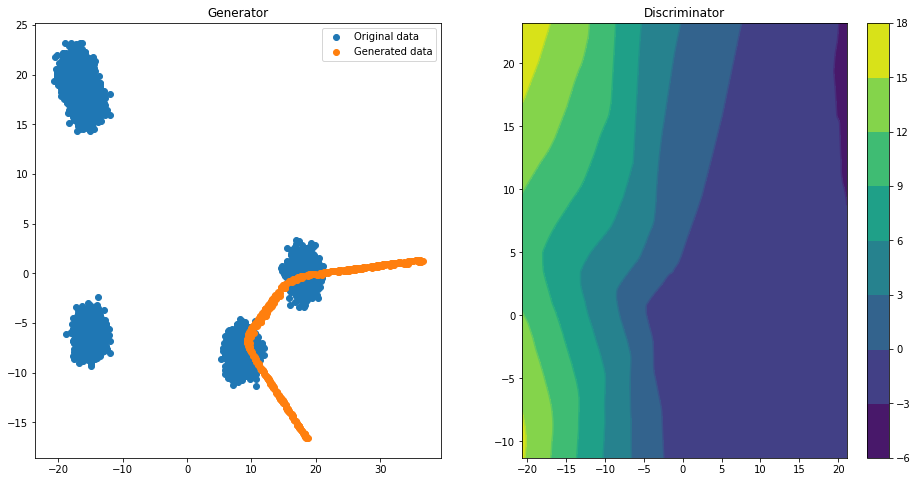

Epoch 050 | ET 1.85 min | Avg Losses >> G/D 1.4066/0.7963 [D-Real: 0.4982 D-Fake: 0.2982]


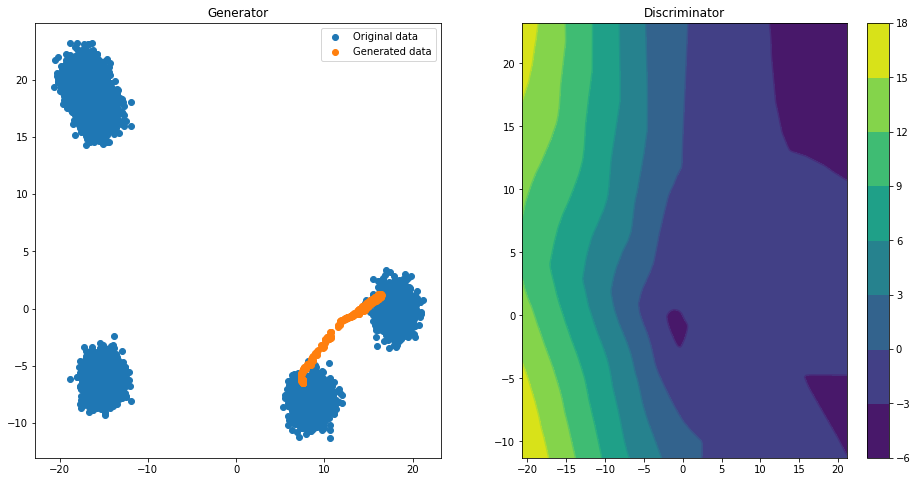

Epoch 100 | ET 3.12 min | Avg Losses >> G/D 1.3524/0.8310 [D-Real: 0.5016 D-Fake: 0.3294]


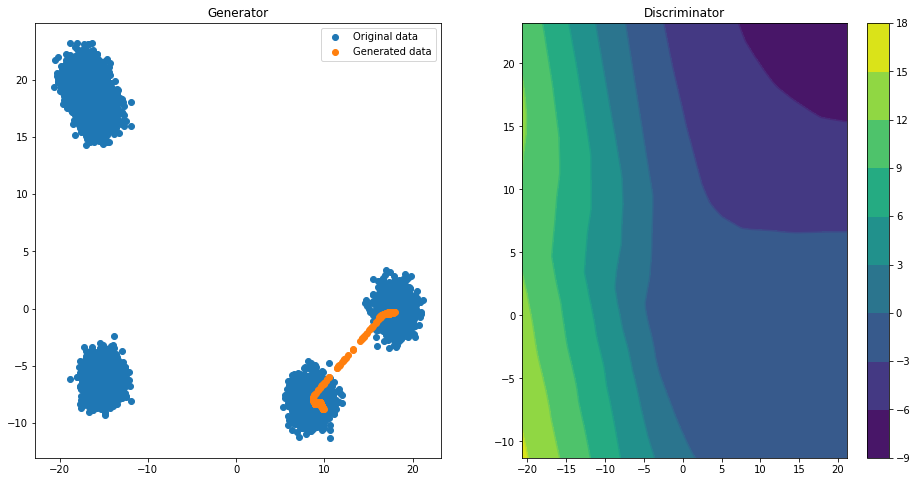

Epoch 150 | ET 4.44 min | Avg Losses >> G/D 1.3914/0.8449 [D-Real: 0.5494 D-Fake: 0.2955]


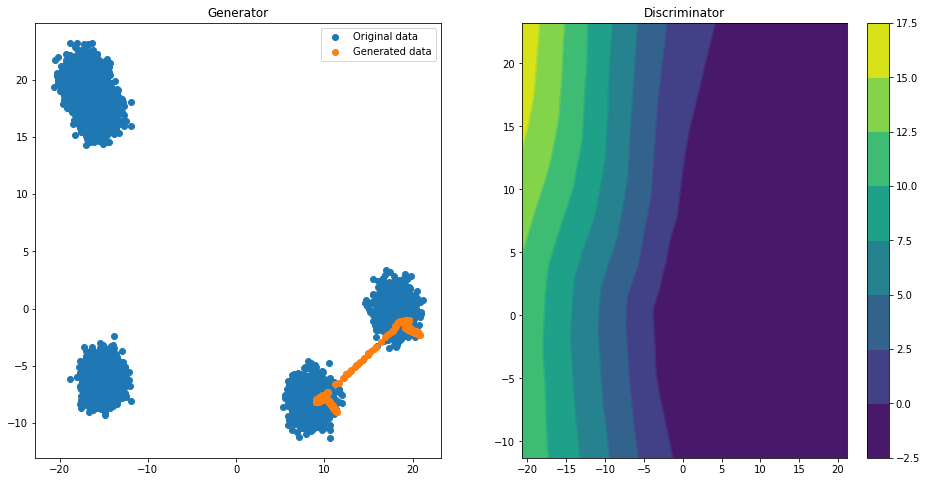

Epoch 200 | ET 5.72 min | Avg Losses >> G/D 1.3374/0.8369 [D-Real: 0.5279 D-Fake: 0.3090]


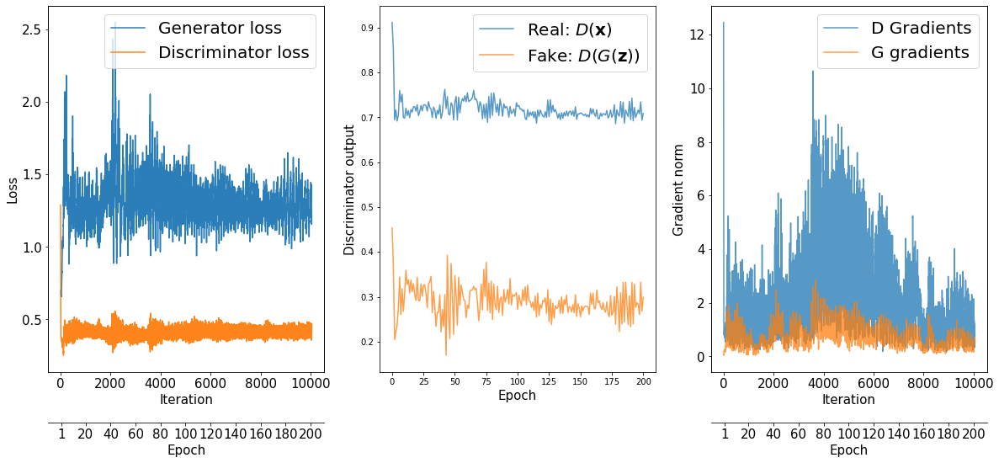

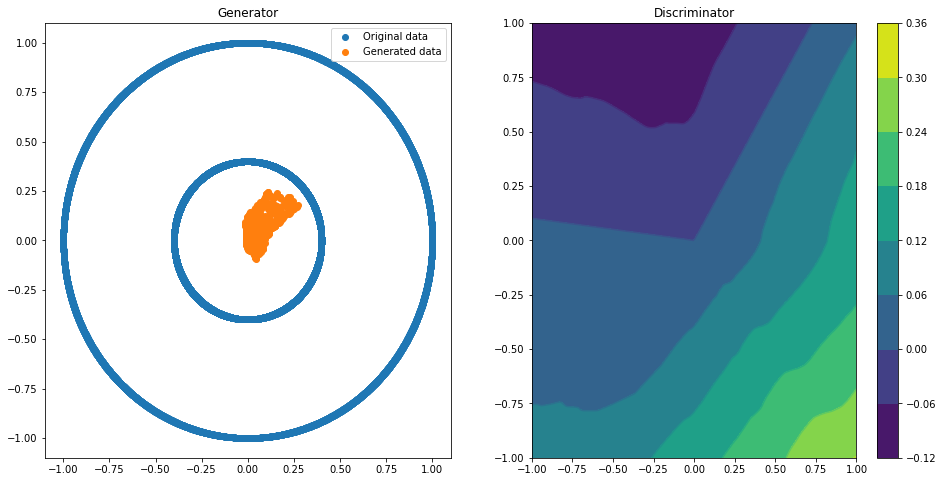

Epoch 000 | ET 0.57 min | Avg Losses >> G/D 0.6791/1.3191 [D-Real: 0.6000 D-Fake: 0.7192]


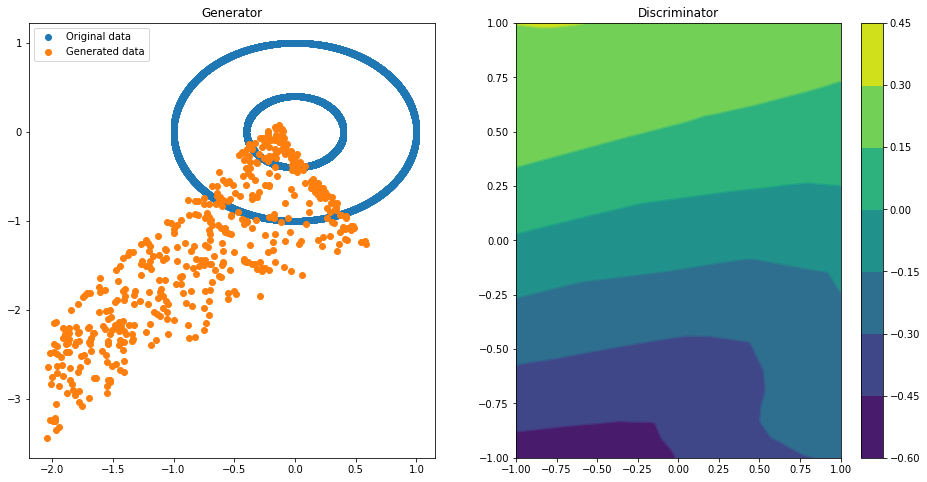

Epoch 050 | ET 1.83 min | Avg Losses >> G/D 0.8659/1.2878 [D-Real: 0.6843 D-Fake: 0.6035]


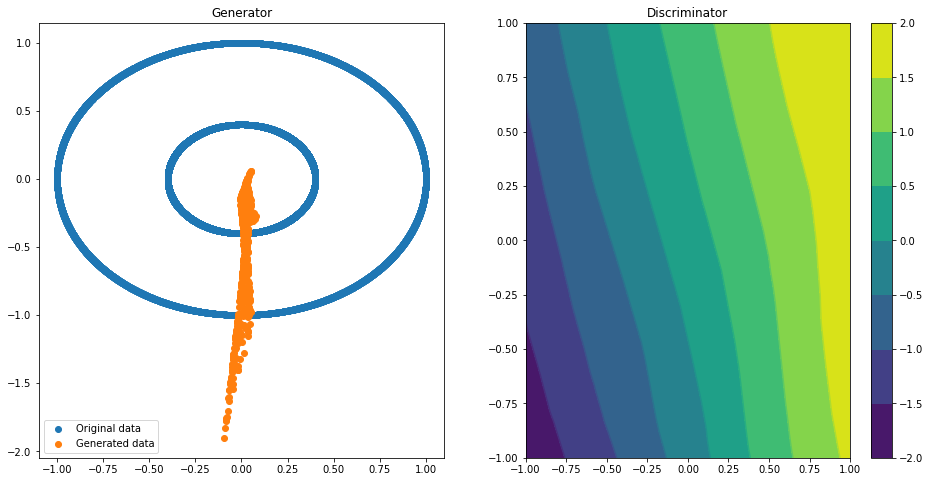

Epoch 100 | ET 3.09 min | Avg Losses >> G/D 0.6796/1.4410 [D-Real: 0.7242 D-Fake: 0.7168]


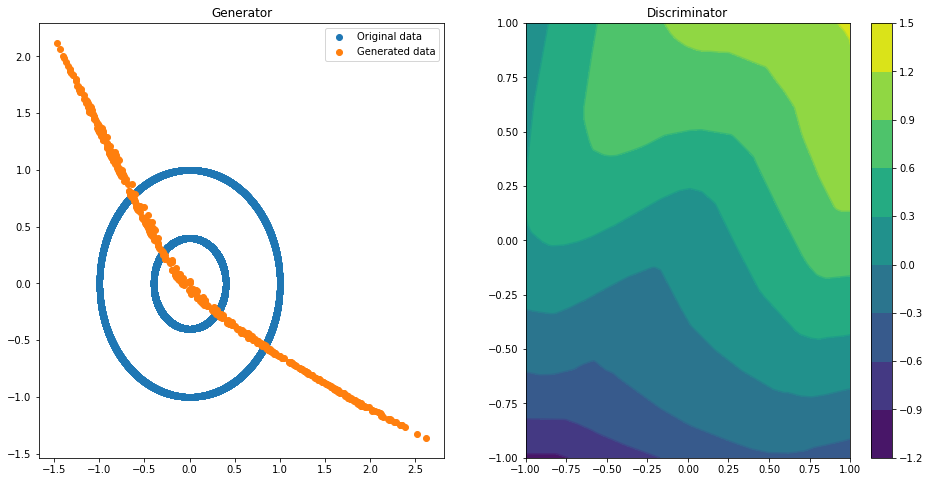

Epoch 150 | ET 4.37 min | Avg Losses >> G/D 0.6533/1.4486 [D-Real: 0.6992 D-Fake: 0.7495]


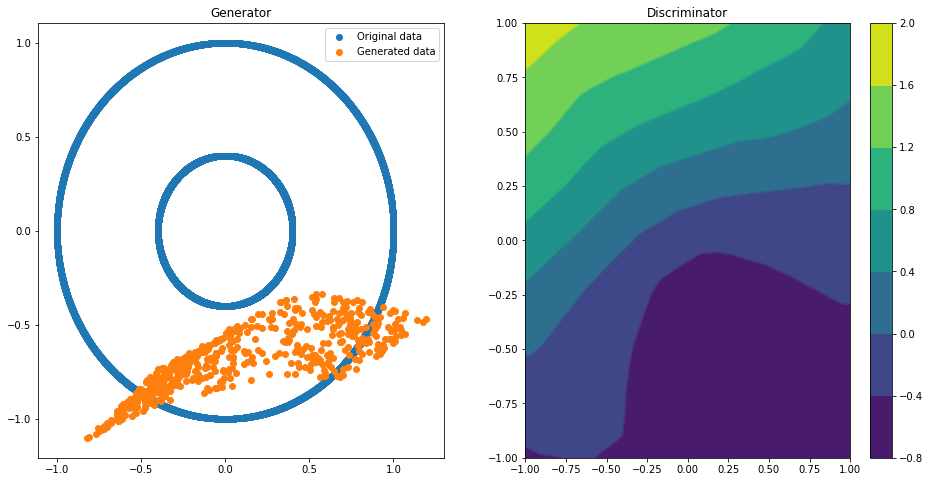

Epoch 200 | ET 5.64 min | Avg Losses >> G/D 0.9063/1.1790 [D-Real: 0.6302 D-Fake: 0.5488]


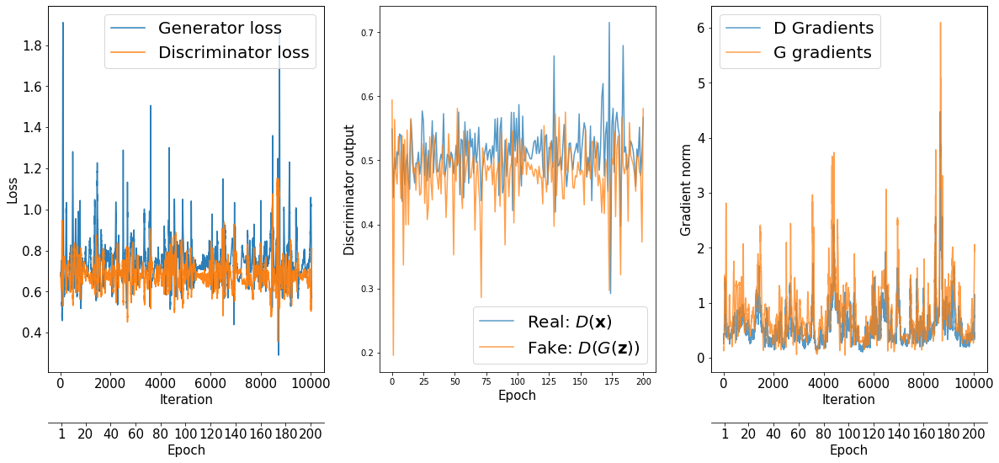

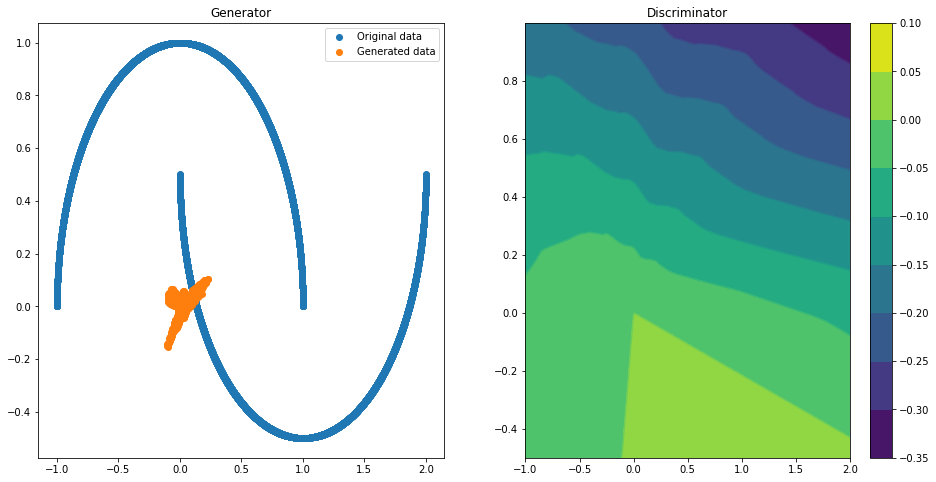

Epoch 000 | ET 0.58 min | Avg Losses >> G/D 0.6520/1.3049 [D-Real: 0.5623 D-Fake: 0.7426]


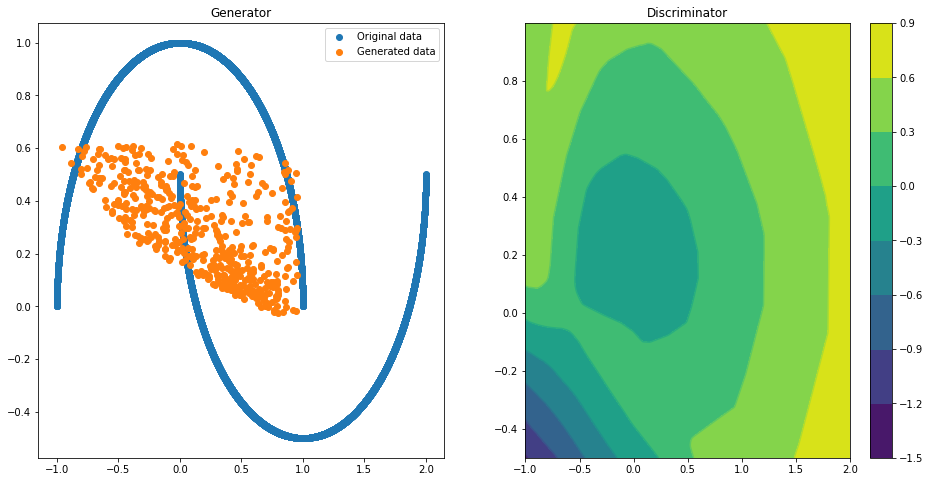

Epoch 050 | ET 1.86 min | Avg Losses >> G/D 0.7155/1.2598 [D-Real: 0.5711 D-Fake: 0.6887]


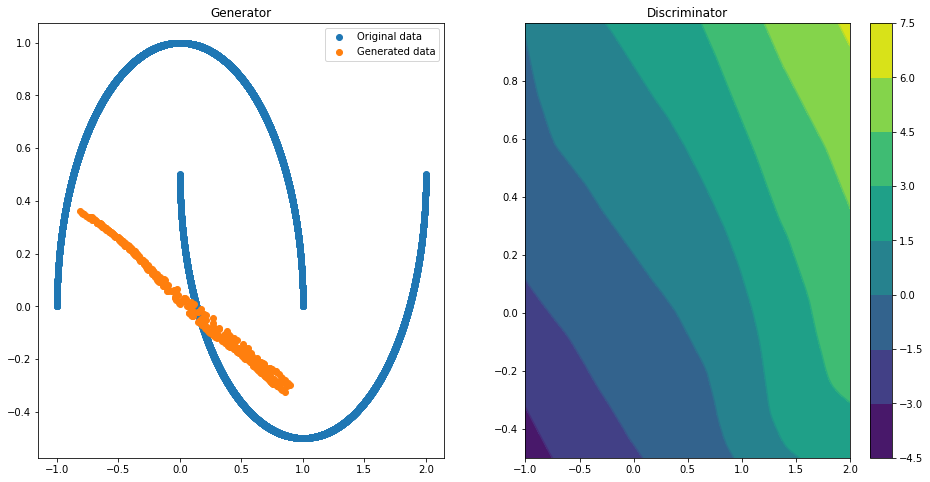

Epoch 100 | ET 3.12 min | Avg Losses >> G/D 0.7847/1.3725 [D-Real: 0.7039 D-Fake: 0.6687]


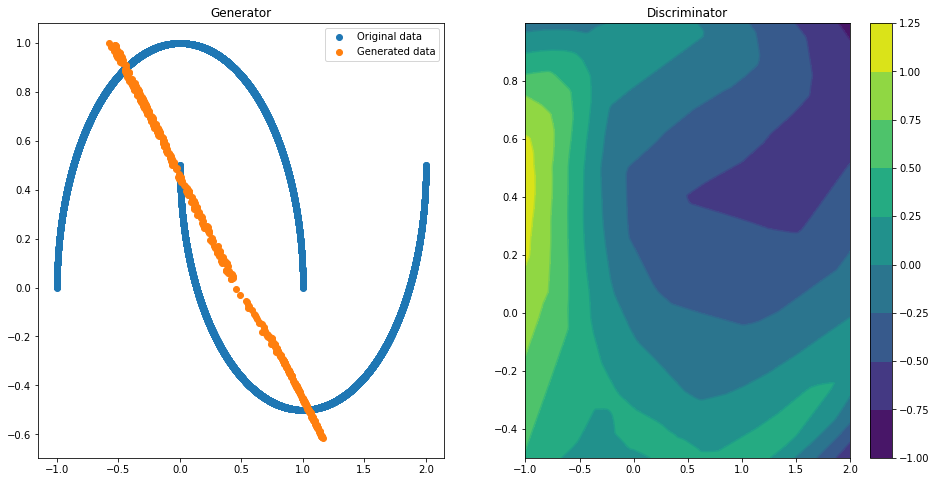

Epoch 150 | ET 4.39 min | Avg Losses >> G/D 0.7180/1.3203 [D-Real: 0.6439 D-Fake: 0.6764]


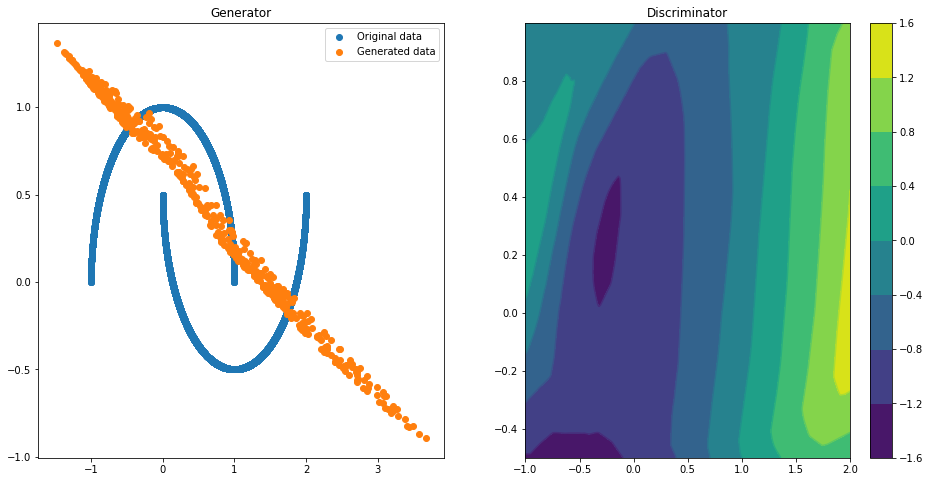

Epoch 200 | ET 5.68 min | Avg Losses >> G/D 0.8490/1.3852 [D-Real: 0.7902 D-Fake: 0.5950]


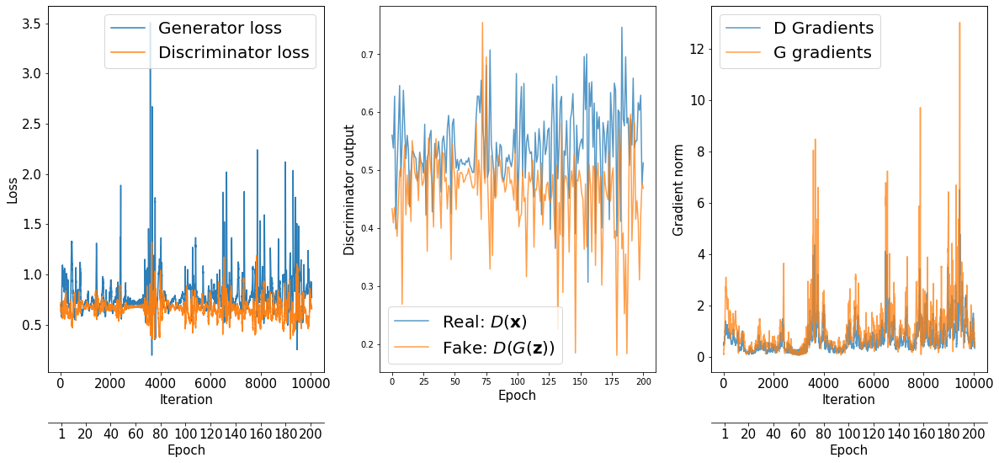

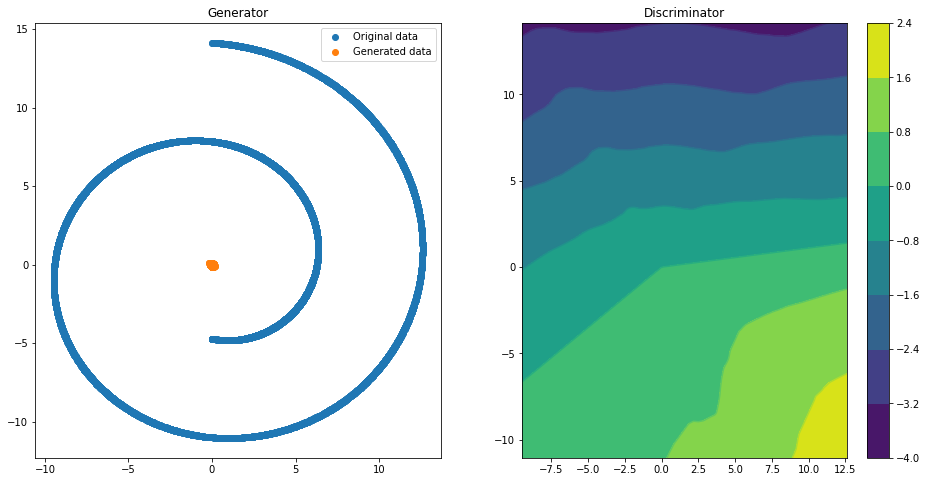

Epoch 000 | ET 0.58 min | Avg Losses >> G/D 0.6719/0.9092 [D-Real: 0.1871 D-Fake: 0.7221]


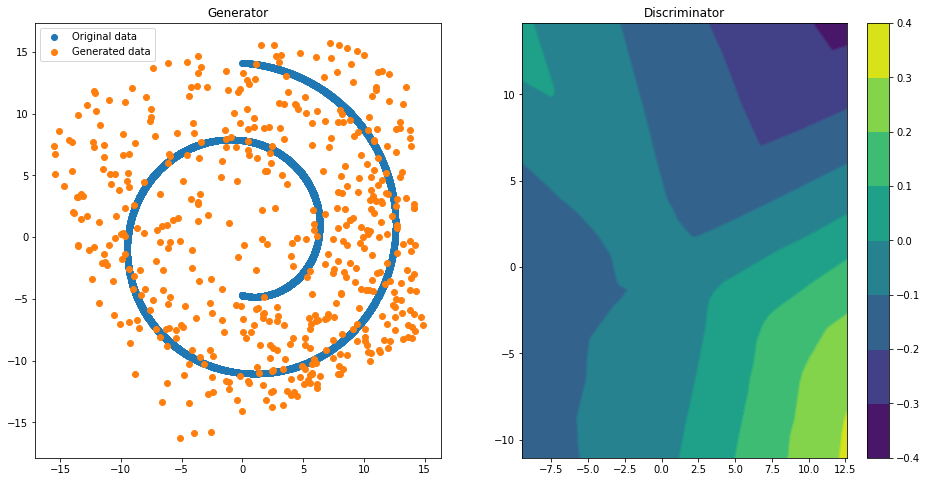

Epoch 050 | ET 1.86 min | Avg Losses >> G/D 0.7372/1.3889 [D-Real: 0.7326 D-Fake: 0.6563]


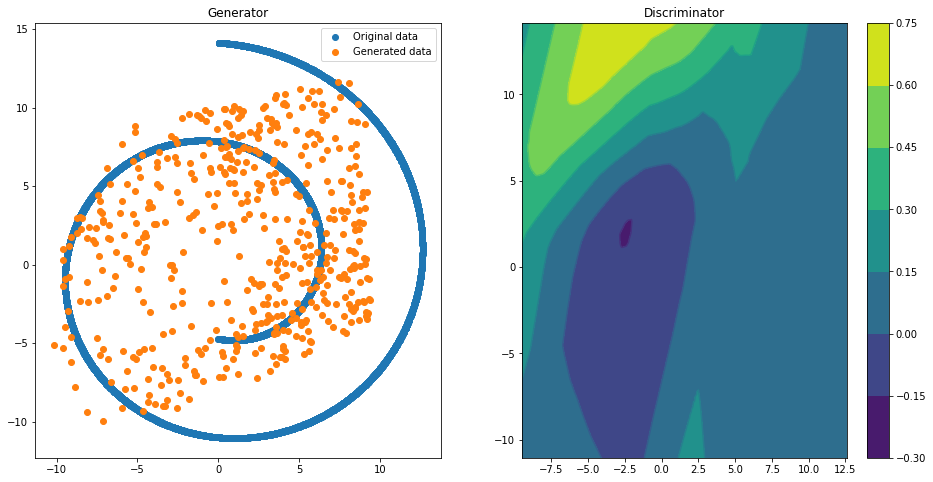

Epoch 100 | ET 3.14 min | Avg Losses >> G/D 0.6918/1.3582 [D-Real: 0.6504 D-Fake: 0.7078]


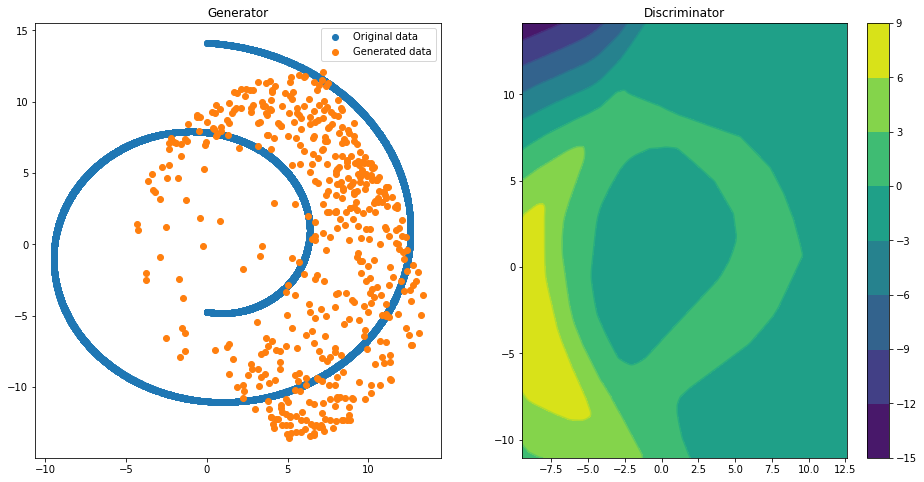

Epoch 150 | ET 4.43 min | Avg Losses >> G/D 0.8699/1.2855 [D-Real: 0.6139 D-Fake: 0.6715]


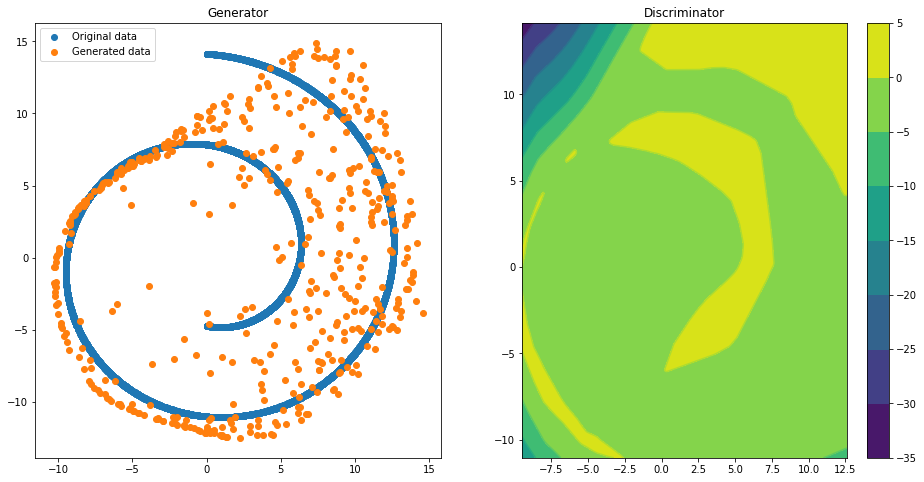

Epoch 200 | ET 5.76 min | Avg Losses >> G/D 0.8872/1.2039 [D-Real: 0.6023 D-Fake: 0.6016]


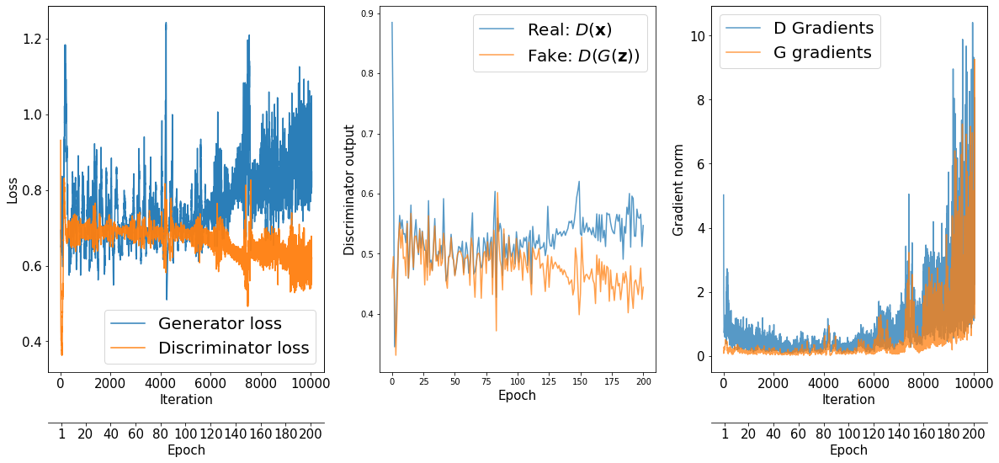

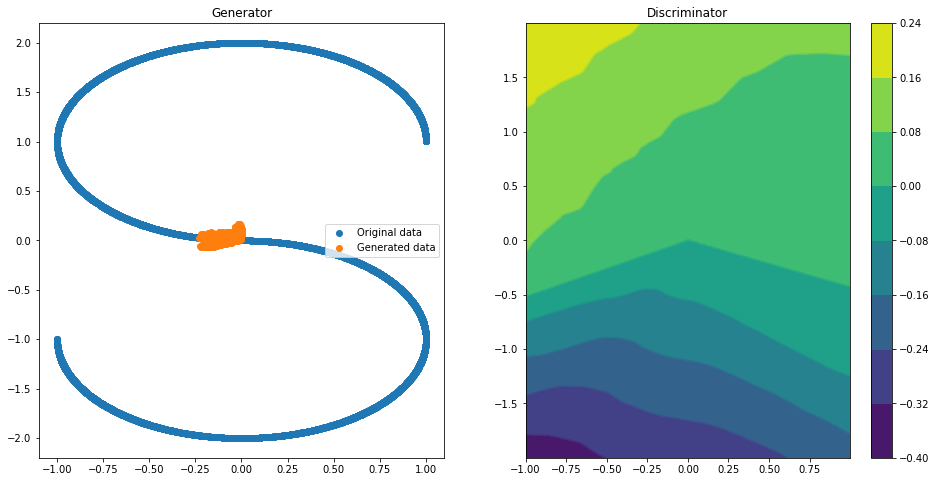

Epoch 000 | ET 0.58 min | Avg Losses >> G/D 0.7839/1.1841 [D-Real: 0.5459 D-Fake: 0.6382]


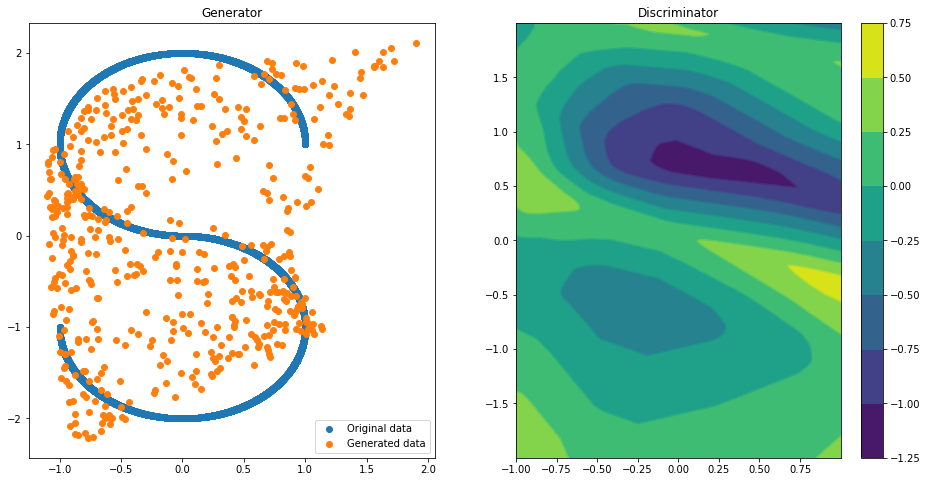

Epoch 050 | ET 1.87 min | Avg Losses >> G/D 0.7710/1.2947 [D-Real: 0.6428 D-Fake: 0.6519]


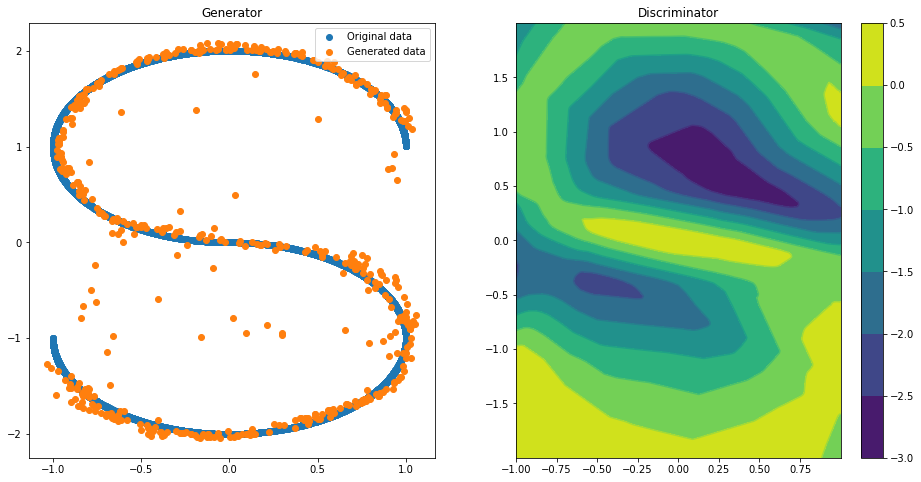

Epoch 100 | ET 3.15 min | Avg Losses >> G/D 0.7404/1.3550 [D-Real: 0.6760 D-Fake: 0.6790]


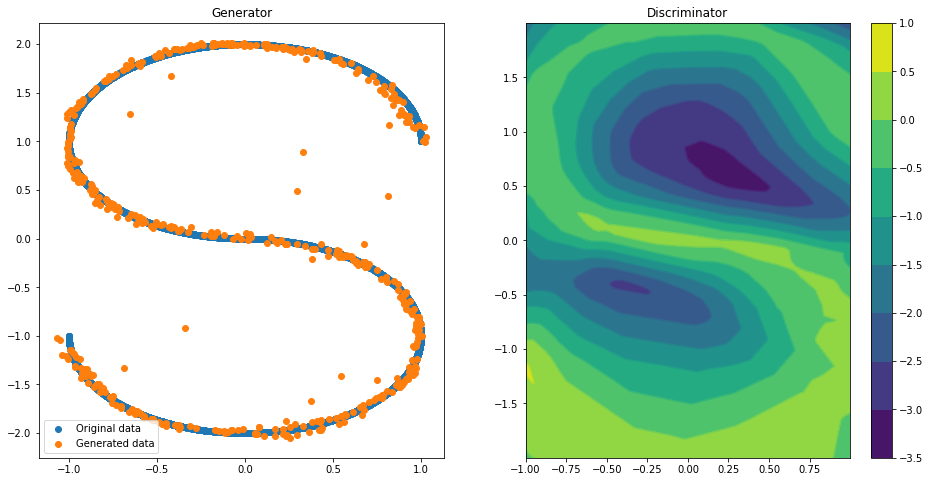

Epoch 150 | ET 4.44 min | Avg Losses >> G/D 0.7140/1.3750 [D-Real: 0.6858 D-Fake: 0.6891]


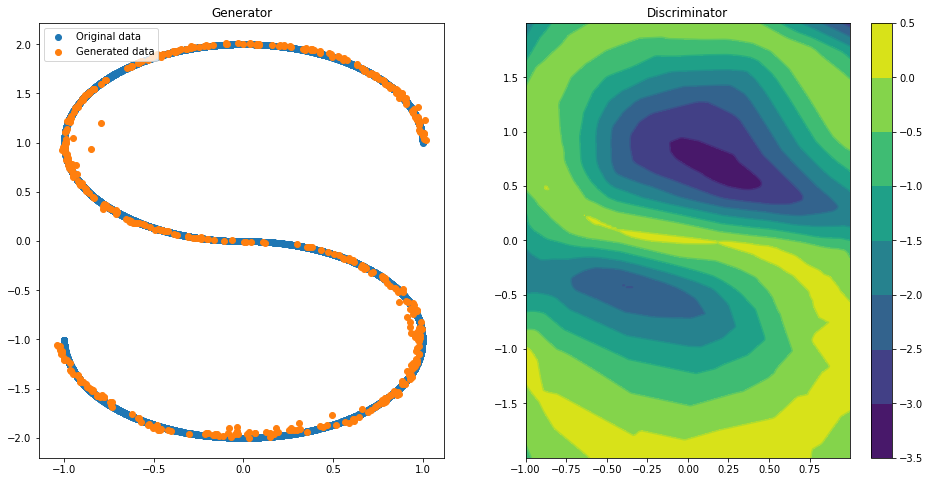

Epoch 200 | ET 5.72 min | Avg Losses >> G/D 0.6942/1.3858 [D-Real: 0.6900 D-Fake: 0.6958]


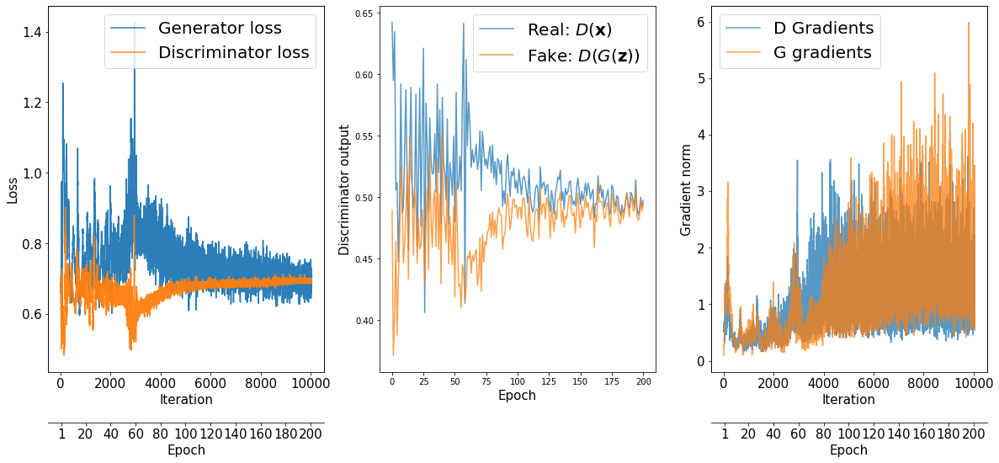

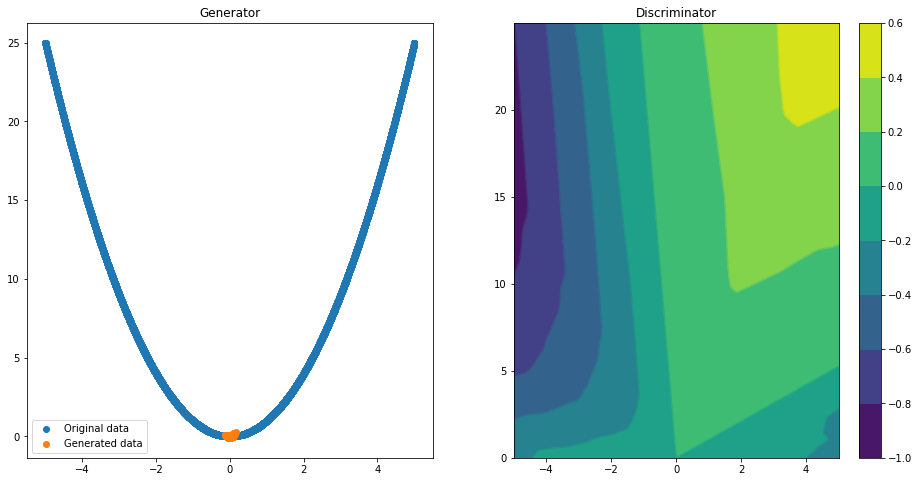

Epoch 000 | ET 0.57 min | Avg Losses >> G/D 0.6268/1.0398 [D-Real: 0.2705 D-Fake: 0.7693]


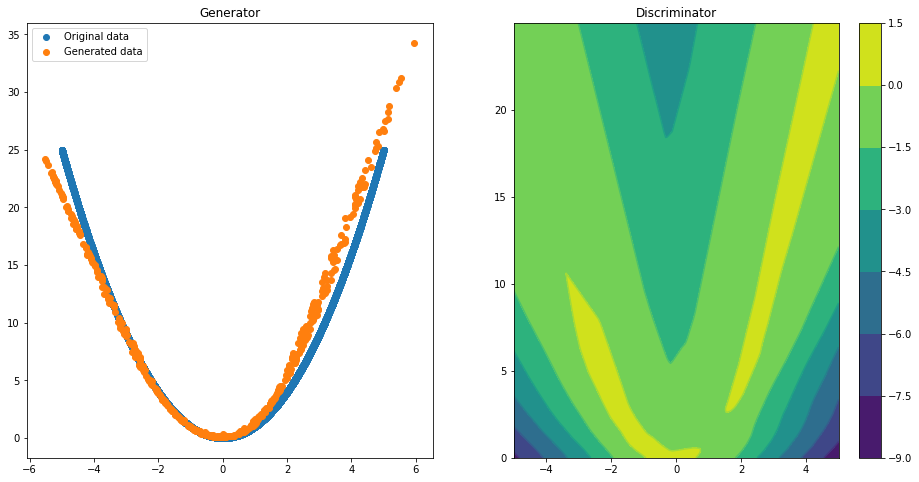

Epoch 050 | ET 1.86 min | Avg Losses >> G/D 0.7021/1.3876 [D-Real: 0.6943 D-Fake: 0.6934]


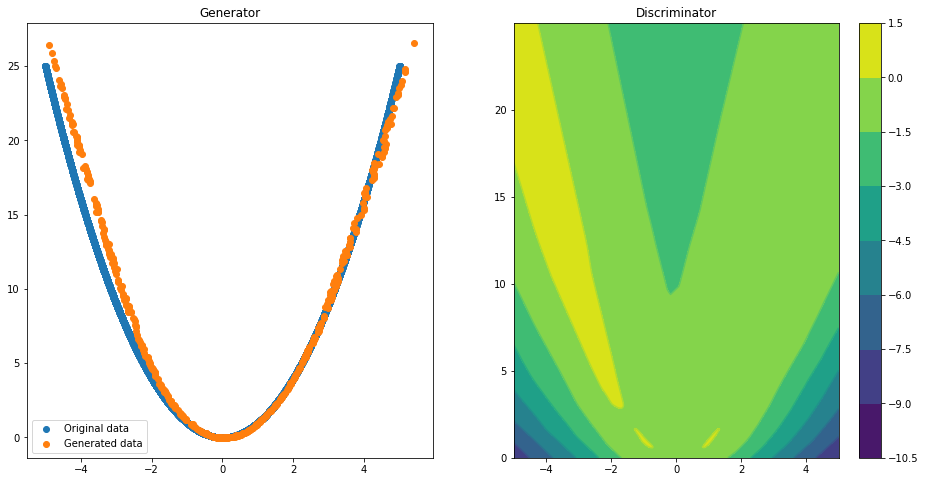

Epoch 100 | ET 3.14 min | Avg Losses >> G/D 0.6930/1.3881 [D-Real: 0.6907 D-Fake: 0.6974]


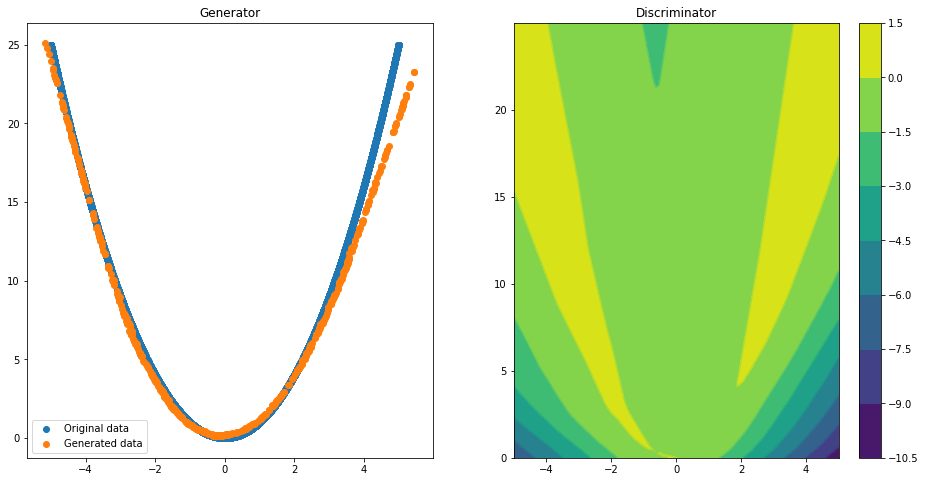

Epoch 150 | ET 4.48 min | Avg Losses >> G/D 0.6967/1.3855 [D-Real: 0.6920 D-Fake: 0.6935]


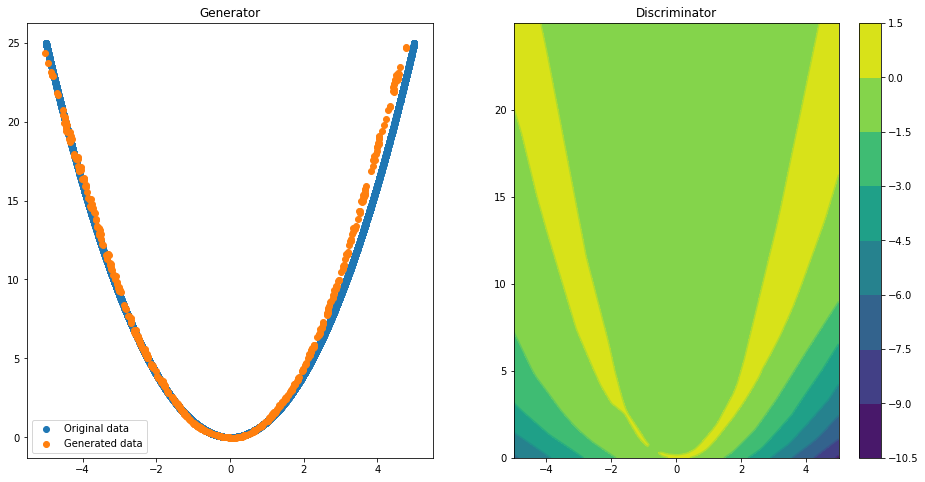

Epoch 200 | ET 5.75 min | Avg Losses >> G/D 0.7057/1.3866 [D-Real: 0.7031 D-Fake: 0.6835]


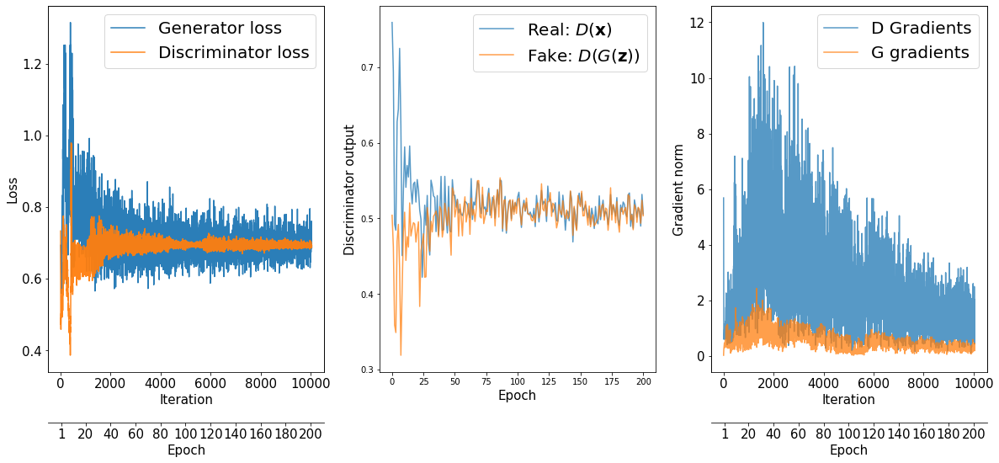

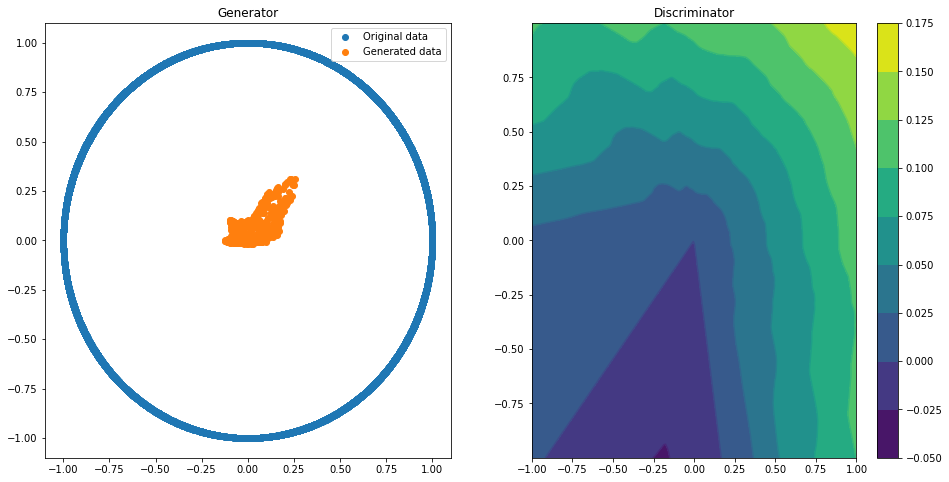

Epoch 000 | ET 0.58 min | Avg Losses >> G/D 0.6467/1.3716 [D-Real: 0.5961 D-Fake: 0.7756]


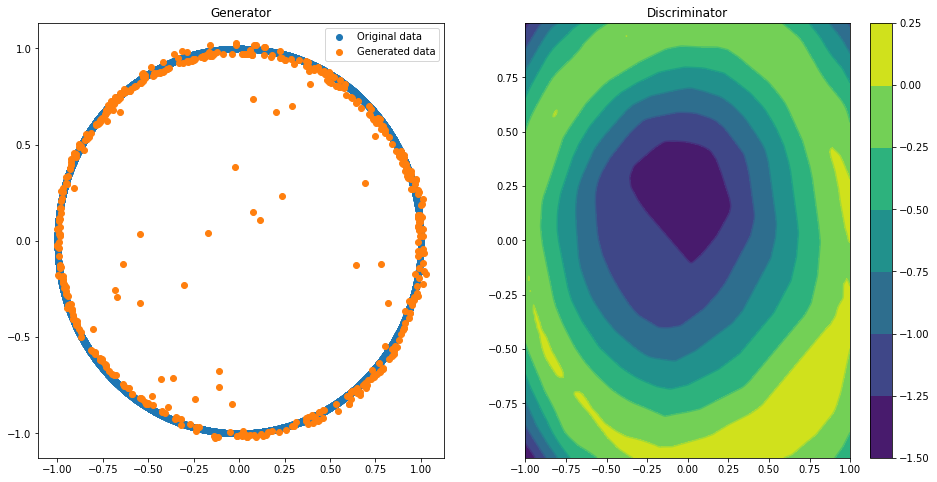

Epoch 050 | ET 1.85 min | Avg Losses >> G/D 0.7013/1.3774 [D-Real: 0.6871 D-Fake: 0.6903]


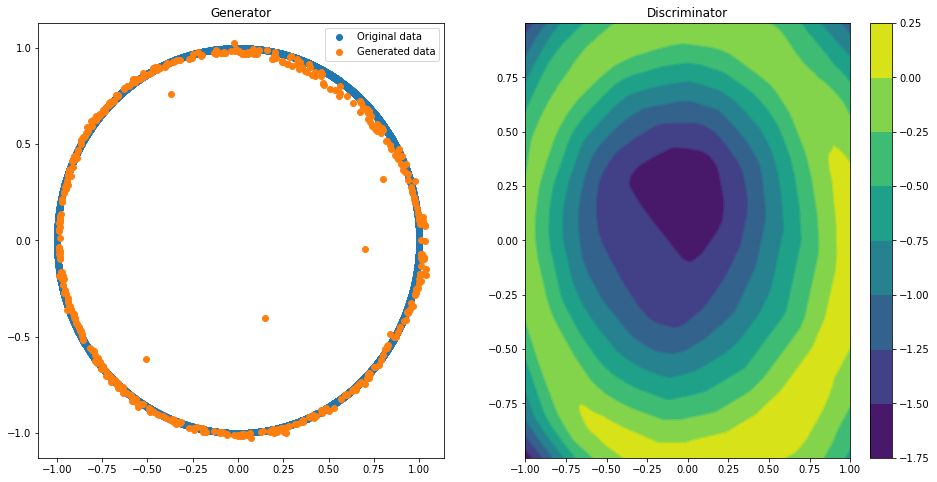

Epoch 100 | ET 3.12 min | Avg Losses >> G/D 0.6963/1.3855 [D-Real: 0.6933 D-Fake: 0.6922]


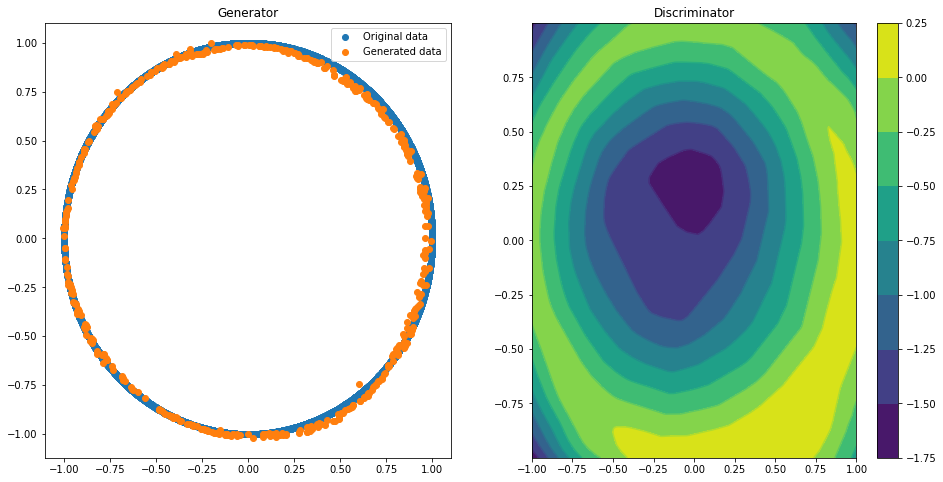

Epoch 150 | ET 4.41 min | Avg Losses >> G/D 0.6976/1.3859 [D-Real: 0.6954 D-Fake: 0.6905]


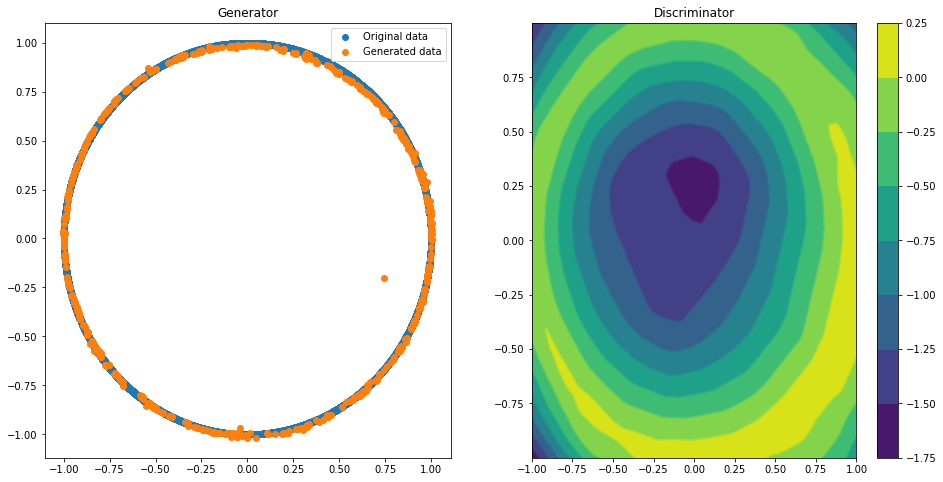

Epoch 200 | ET 5.74 min | Avg Losses >> G/D 0.6965/1.3850 [D-Real: 0.6936 D-Fake: 0.6914]


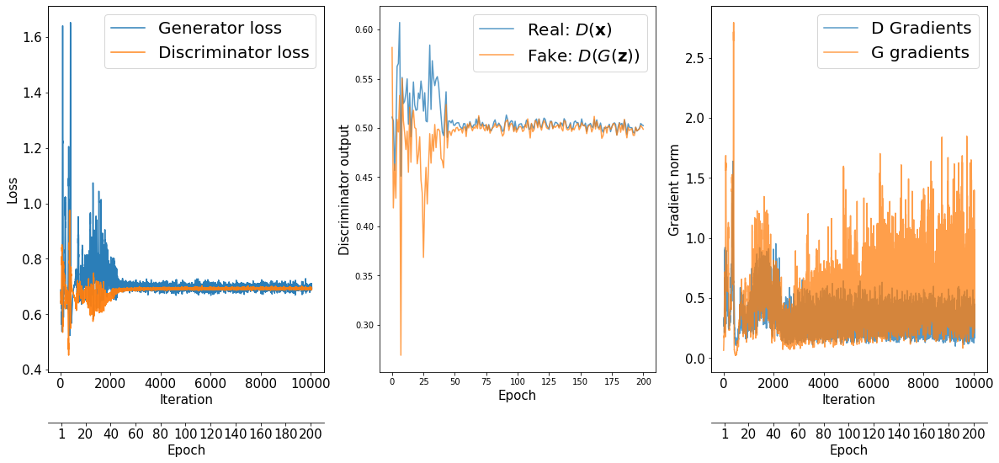

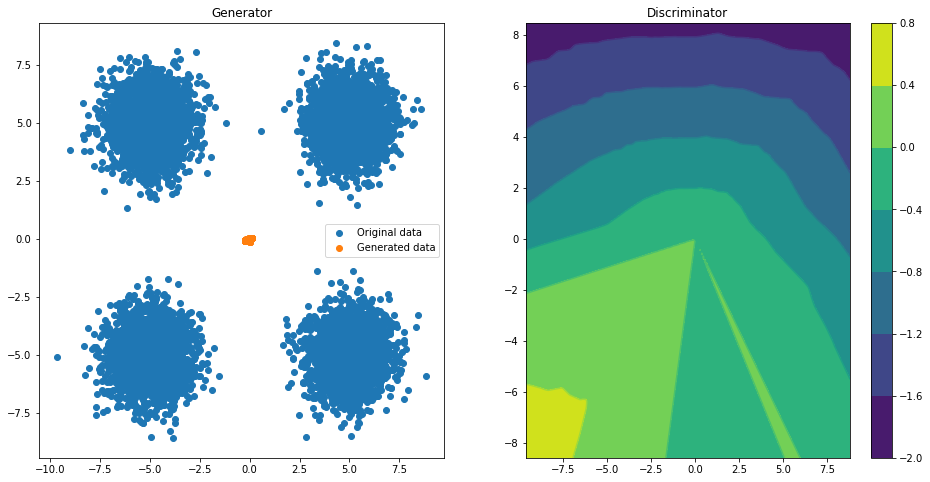

Epoch 000 | ET 0.60 min | Avg Losses >> G/D 0.6692/0.9212 [D-Real: 0.1952 D-Fake: 0.7260]


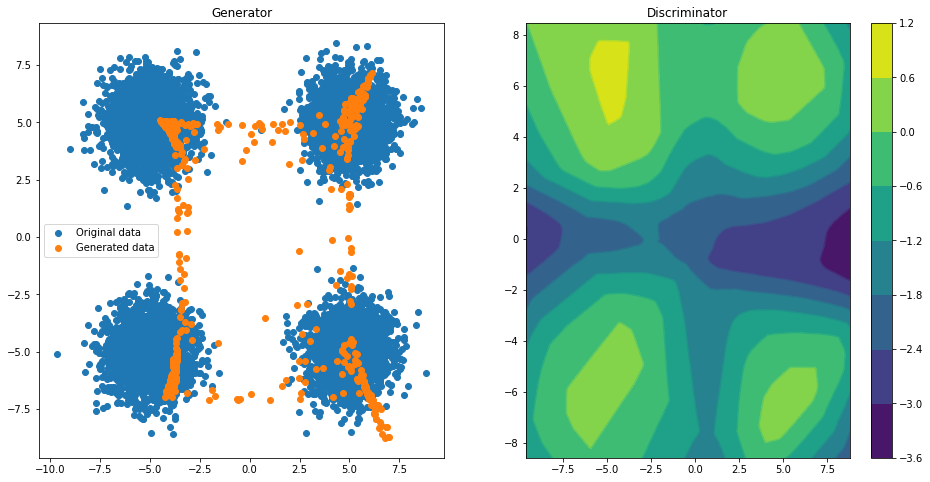

Epoch 050 | ET 1.93 min | Avg Losses >> G/D 0.7944/1.3624 [D-Real: 0.6901 D-Fake: 0.6722]


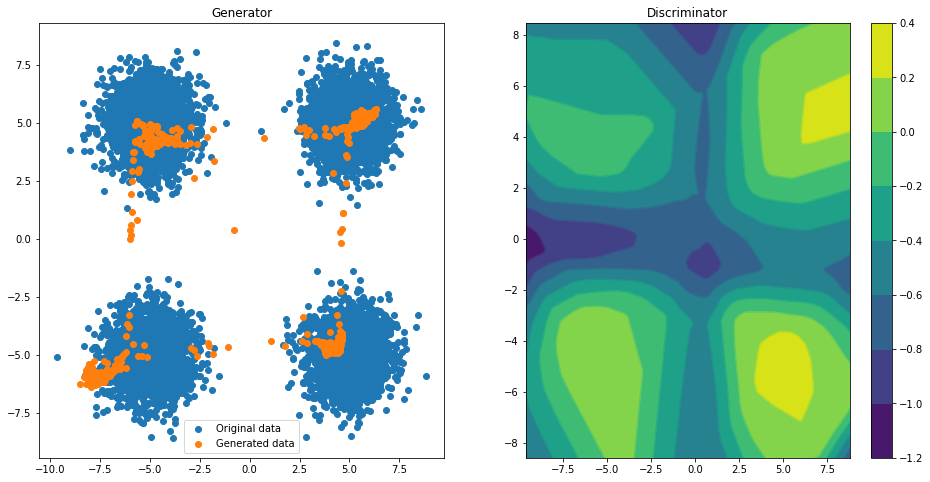

Epoch 100 | ET 3.25 min | Avg Losses >> G/D 0.7154/1.3884 [D-Real: 0.6917 D-Fake: 0.6968]


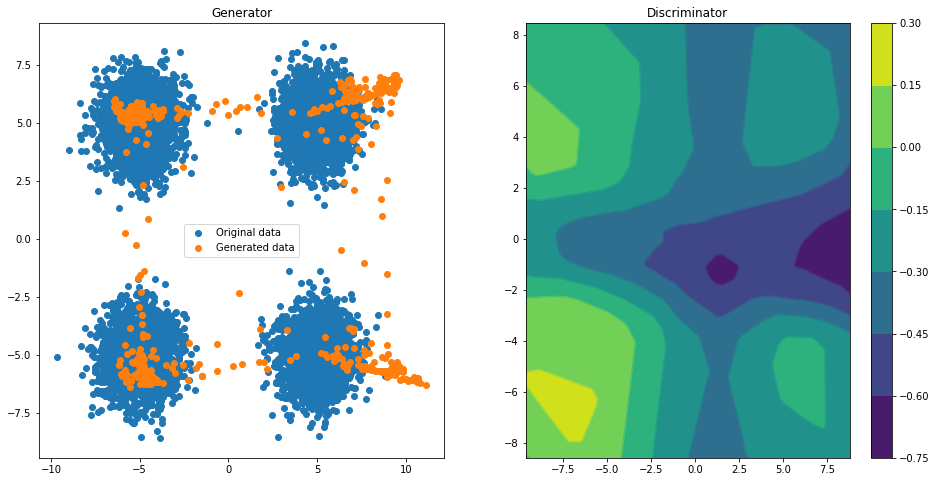

Epoch 150 | ET 4.59 min | Avg Losses >> G/D 0.7153/1.3821 [D-Real: 0.6974 D-Fake: 0.6847]


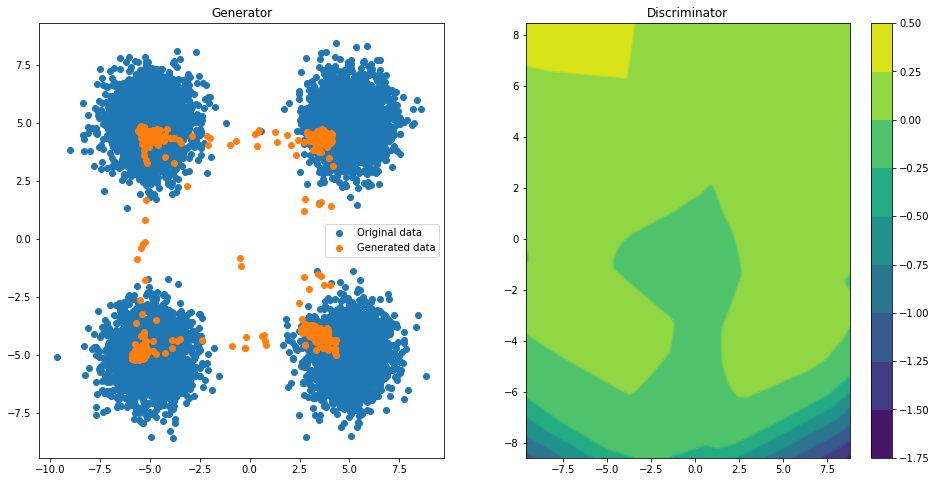

Epoch 200 | ET 5.88 min | Avg Losses >> G/D 0.6937/1.3874 [D-Real: 0.6925 D-Fake: 0.6949]


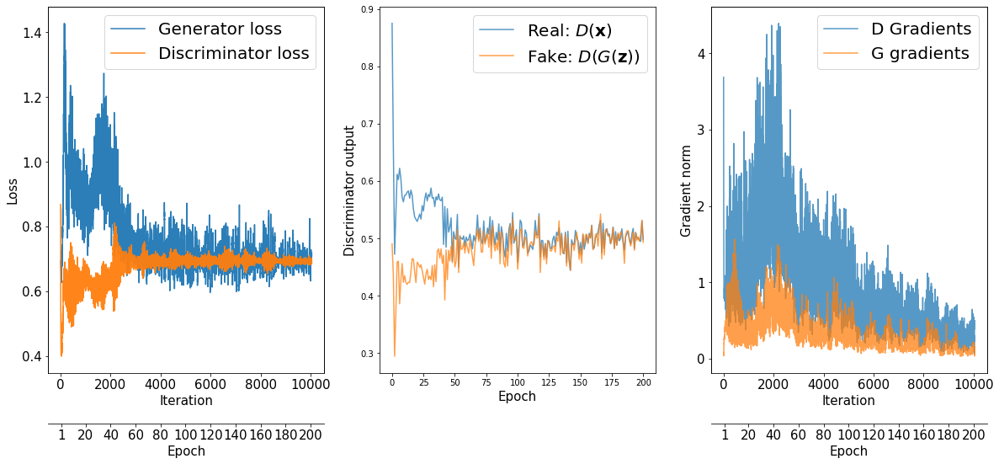

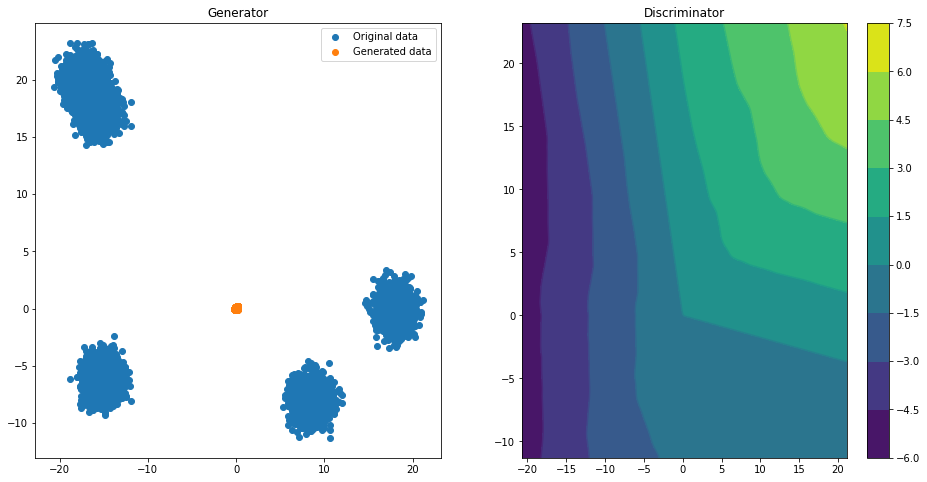

Epoch 000 | ET 0.58 min | Avg Losses >> G/D 0.6832/0.9481 [D-Real: 0.2388 D-Fake: 0.7093]


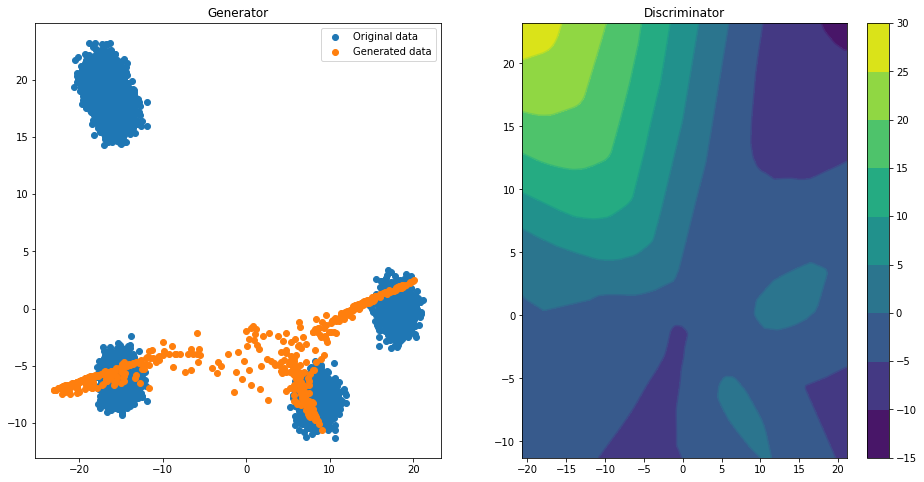

Epoch 050 | ET 1.86 min | Avg Losses >> G/D 1.4935/0.9348 [D-Real: 0.4812 D-Fake: 0.4536]


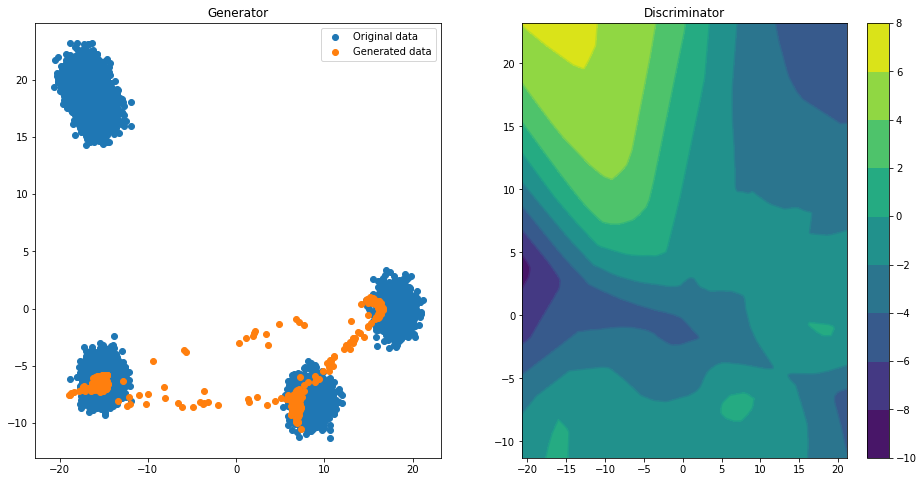

Epoch 100 | ET 3.14 min | Avg Losses >> G/D 1.1214/1.0512 [D-Real: 0.5988 D-Fake: 0.4524]


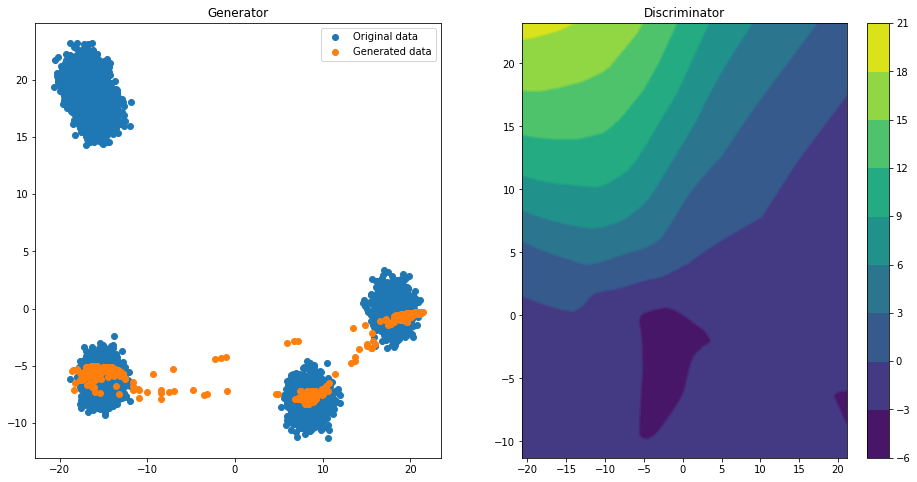

Epoch 150 | ET 4.41 min | Avg Losses >> G/D 1.0164/1.0458 [D-Real: 0.5529 D-Fake: 0.4930]


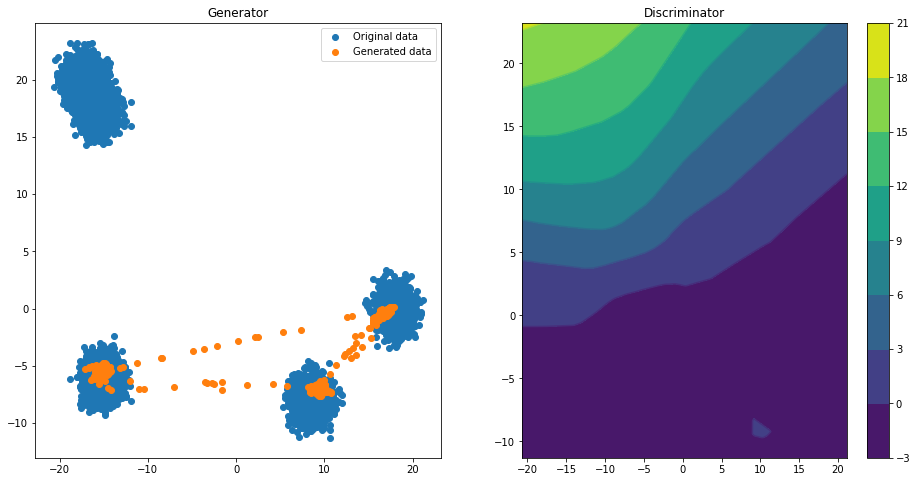

Epoch 200 | ET 5.69 min | Avg Losses >> G/D 1.0006/1.0637 [D-Real: 0.5884 D-Fake: 0.4753]


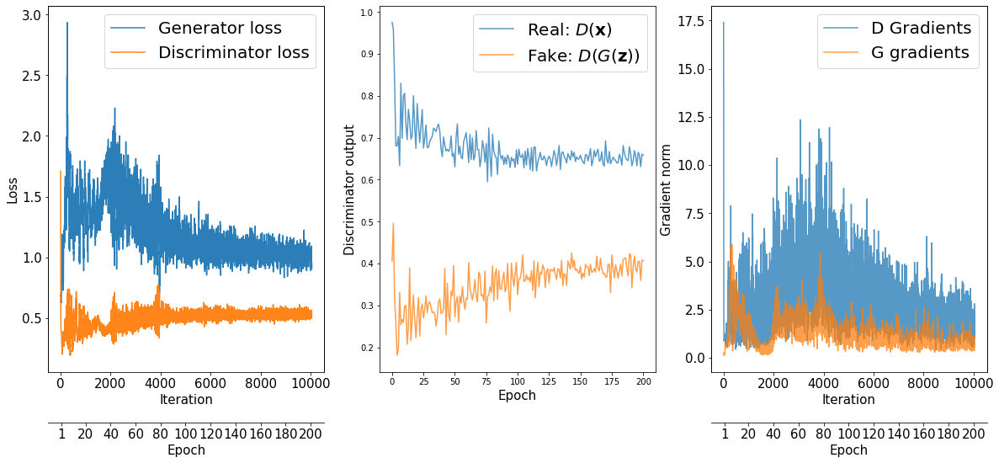

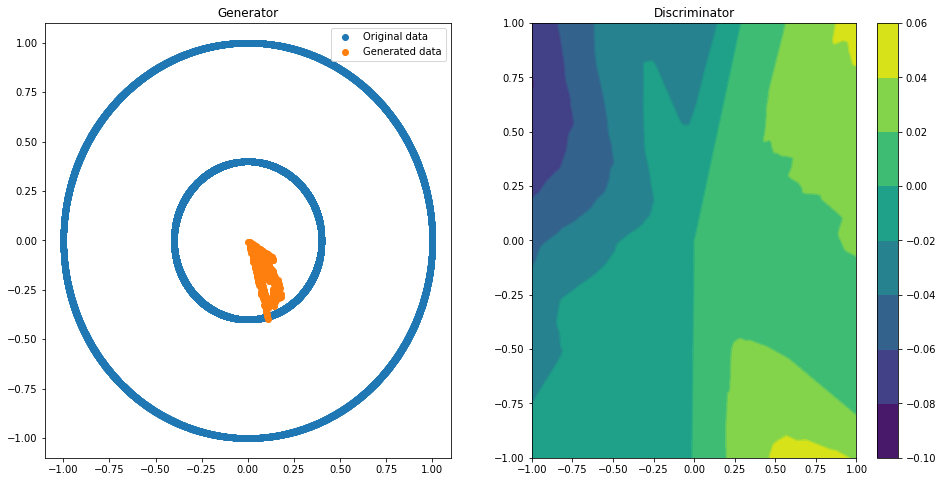

Epoch 000 | ET 0.57 min | Avg Losses >> G/D 0.6176/1.4129 [D-Real: 0.6234 D-Fake: 0.7895]


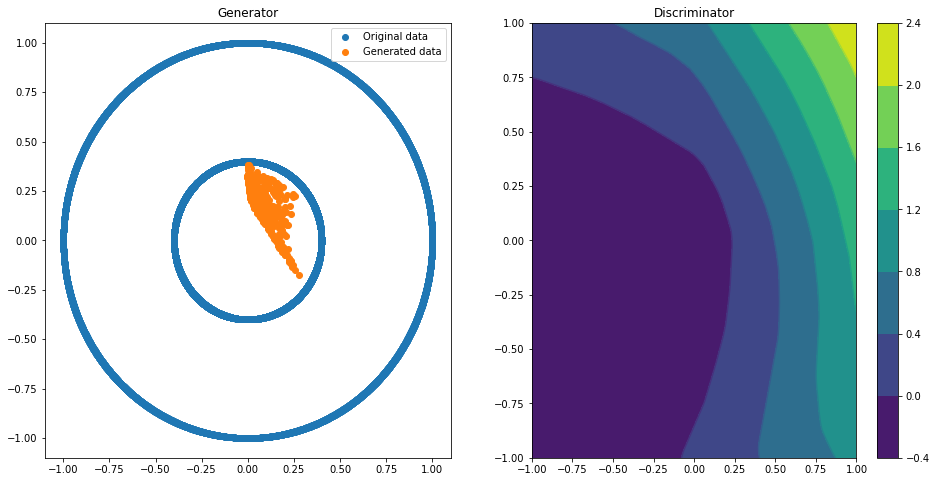

Epoch 050 | ET 1.85 min | Avg Losses >> G/D 0.7070/1.3634 [D-Real: 0.6706 D-Fake: 0.6927]


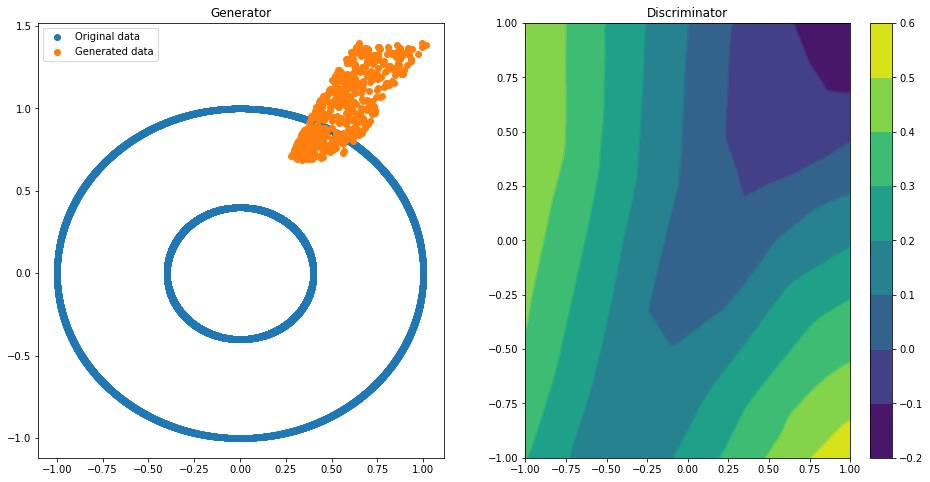

Epoch 100 | ET 3.12 min | Avg Losses >> G/D 0.7964/1.1564 [D-Real: 0.5547 D-Fake: 0.6017]


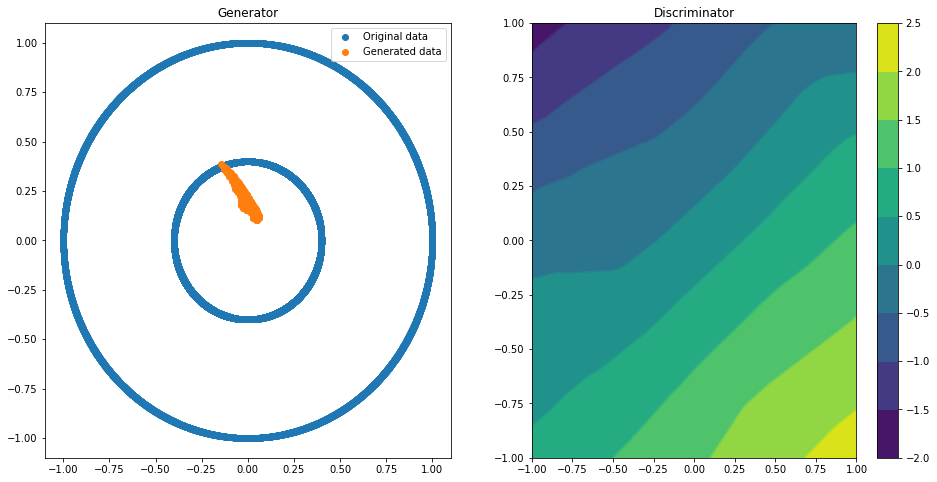

Epoch 150 | ET 4.39 min | Avg Losses >> G/D 0.7759/1.3279 [D-Real: 0.7101 D-Fake: 0.6178]


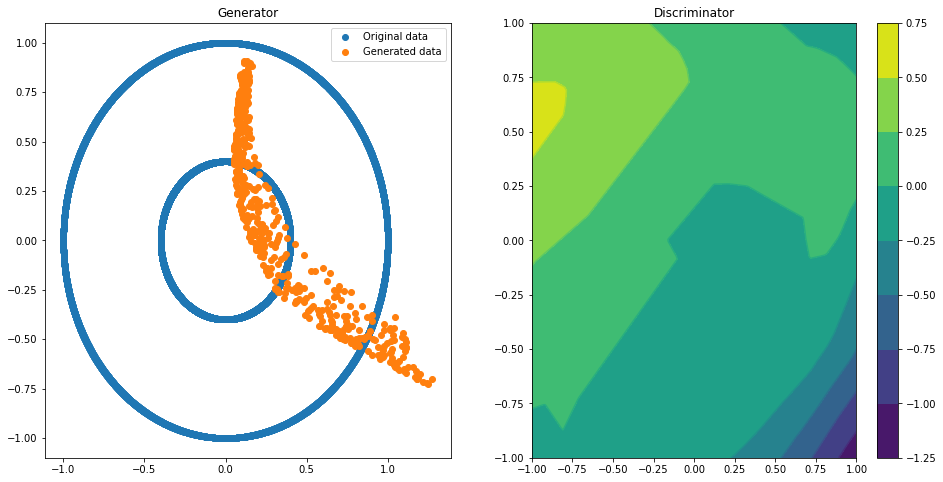

Epoch 200 | ET 5.66 min | Avg Losses >> G/D 0.7095/1.3572 [D-Real: 0.6772 D-Fake: 0.6799]


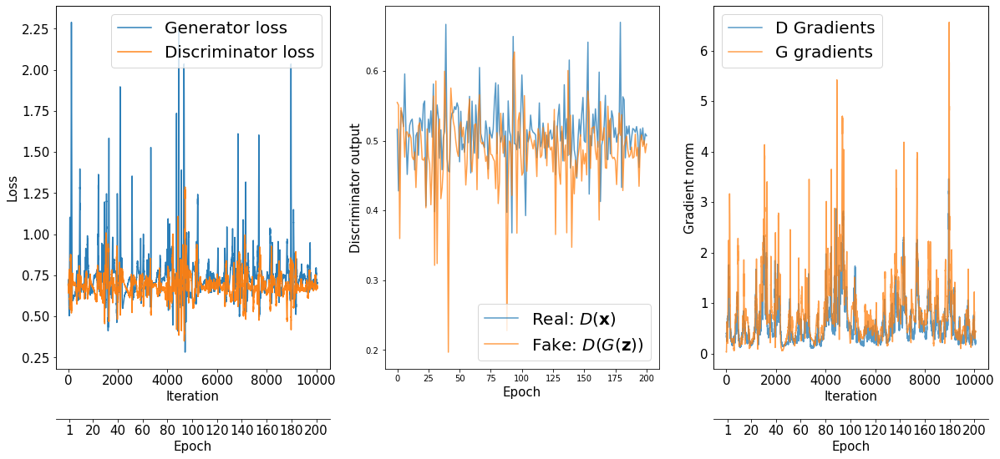

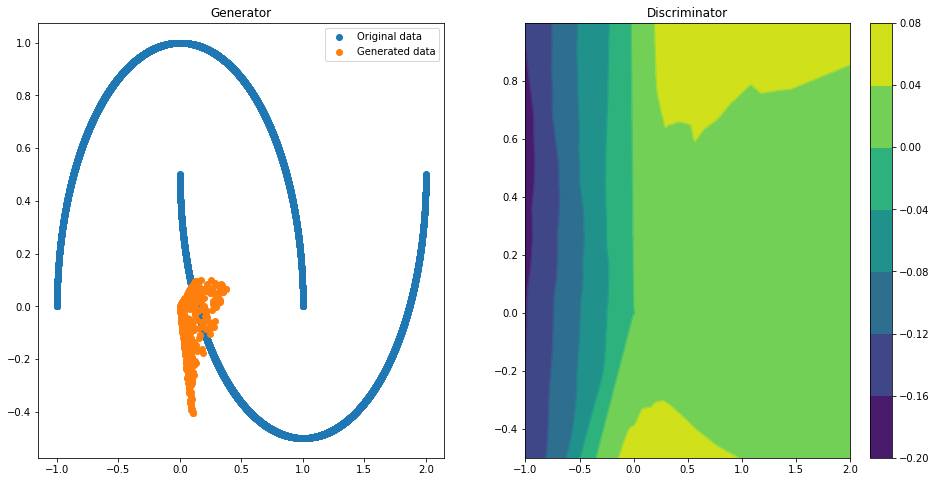

Epoch 000 | ET 0.57 min | Avg Losses >> G/D 0.7250/1.3558 [D-Real: 0.6620 D-Fake: 0.6938]


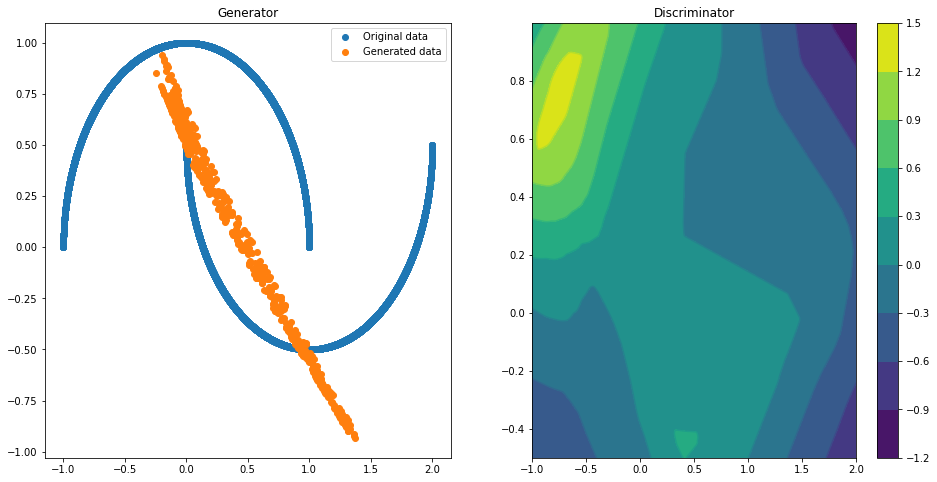

Epoch 050 | ET 1.84 min | Avg Losses >> G/D 0.7704/1.2978 [D-Real: 0.6465 D-Fake: 0.6513]


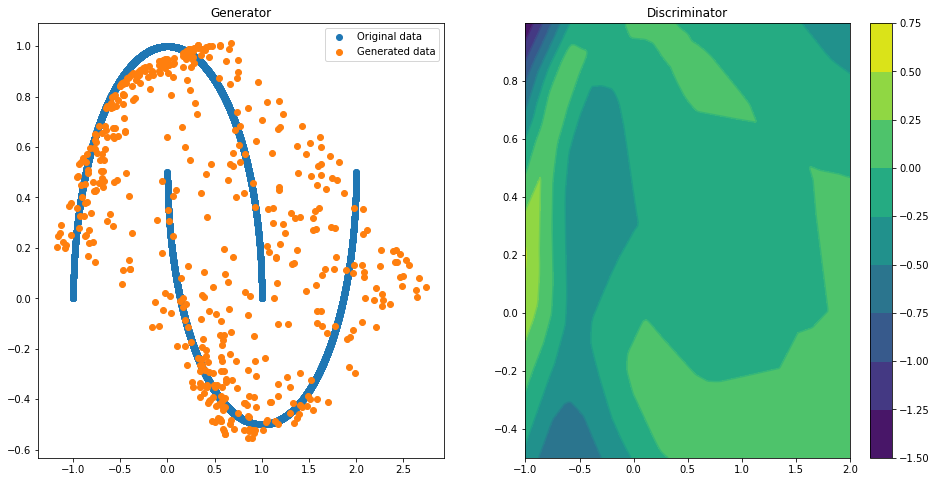

Epoch 100 | ET 3.10 min | Avg Losses >> G/D 0.6953/1.3653 [D-Real: 0.6692 D-Fake: 0.6960]


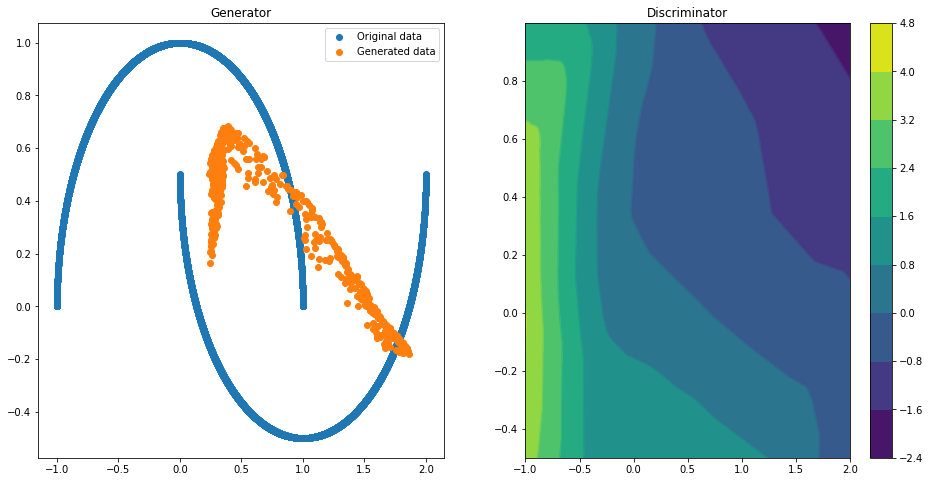

Epoch 150 | ET 4.36 min | Avg Losses >> G/D 0.8023/1.2255 [D-Real: 0.5932 D-Fake: 0.6322]


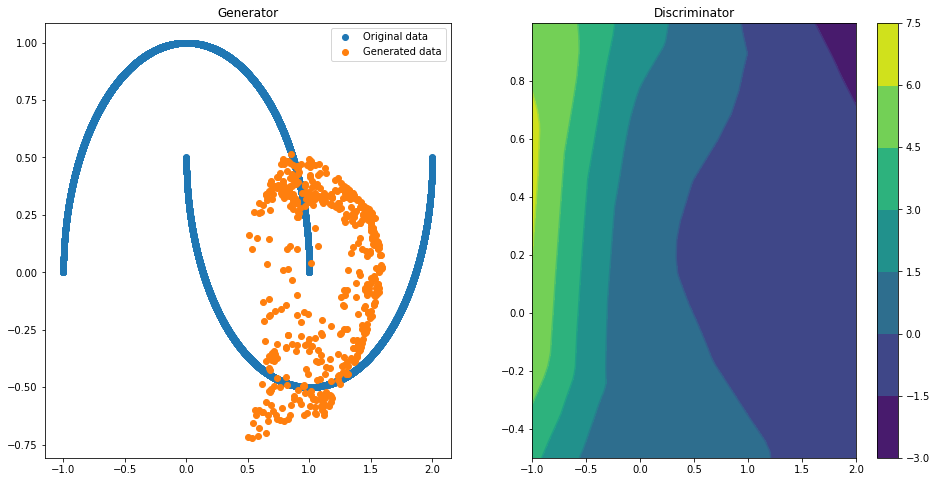

Epoch 200 | ET 5.64 min | Avg Losses >> G/D 0.8112/1.2494 [D-Real: 0.5618 D-Fake: 0.6876]


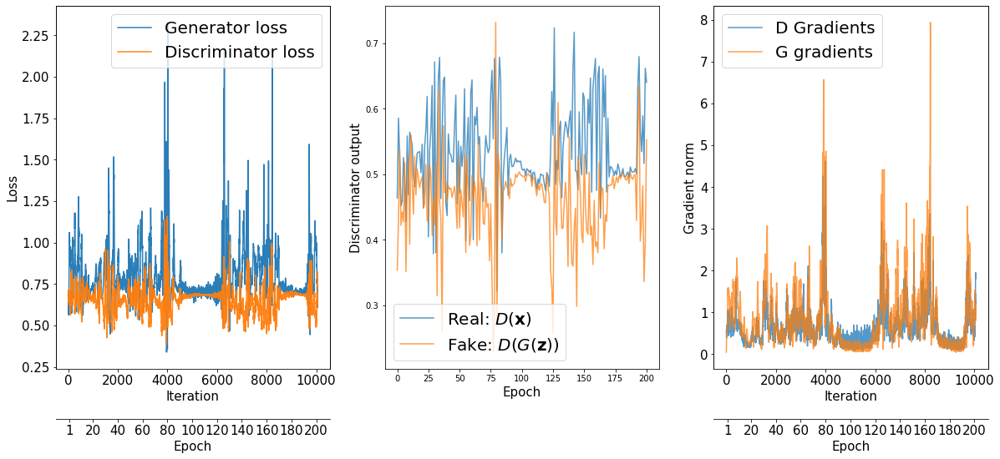

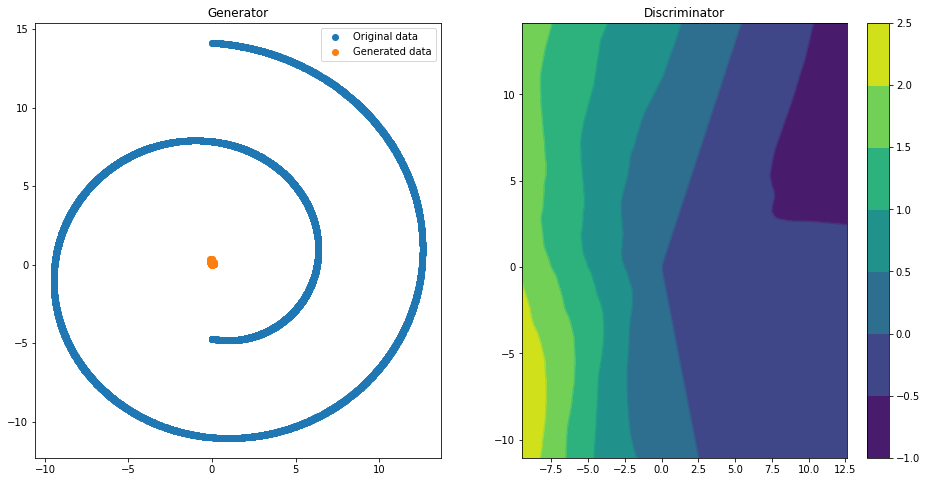

Epoch 000 | ET 0.57 min | Avg Losses >> G/D 0.7652/0.7685 [D-Real: 0.1344 D-Fake: 0.6340]


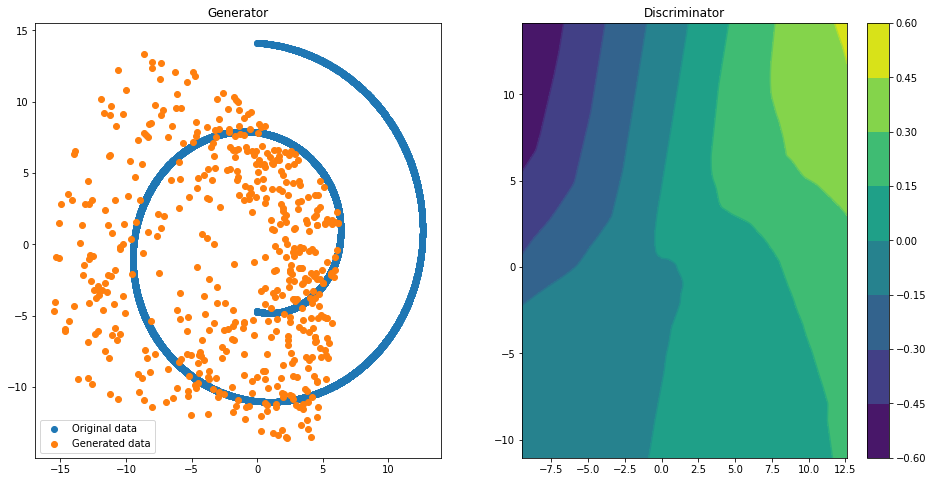

Epoch 050 | ET 1.84 min | Avg Losses >> G/D 0.7031/1.3520 [D-Real: 0.6383 D-Fake: 0.7138]


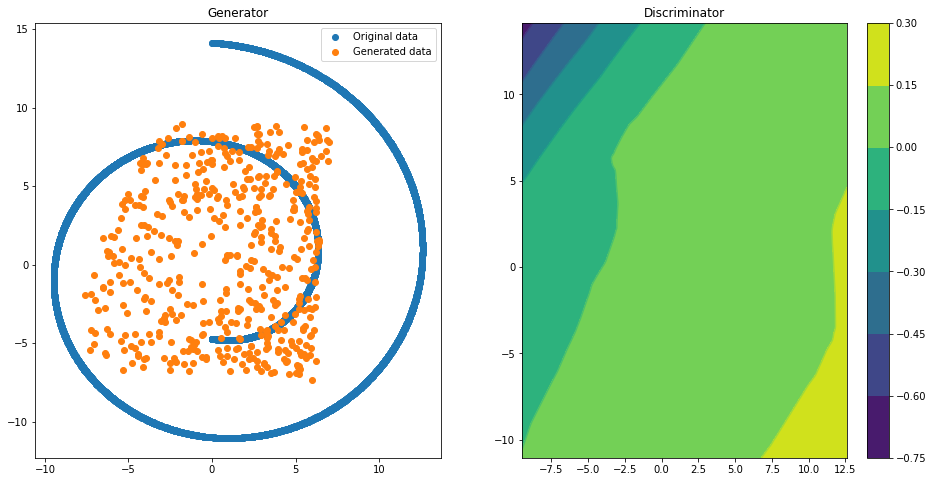

Epoch 100 | ET 3.10 min | Avg Losses >> G/D 0.6736/1.3653 [D-Real: 0.6518 D-Fake: 0.7135]


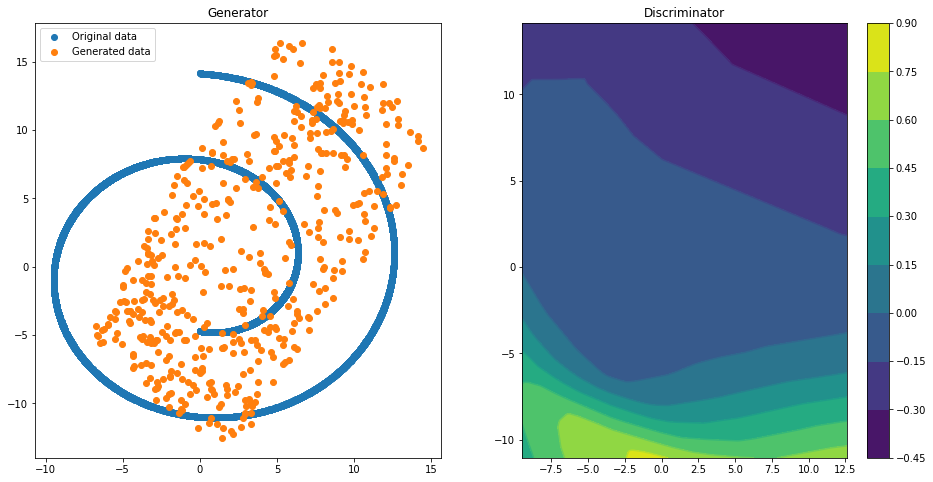

Epoch 150 | ET 4.35 min | Avg Losses >> G/D 0.7191/1.3455 [D-Real: 0.6631 D-Fake: 0.6824]


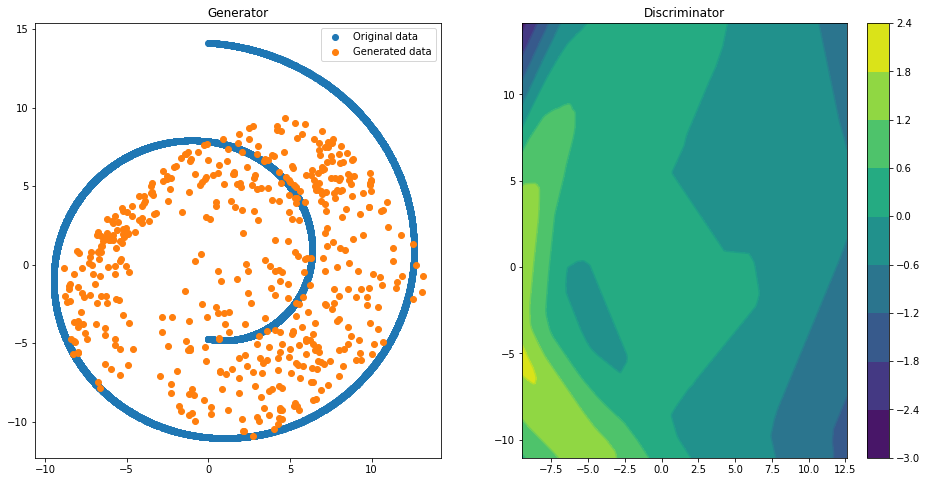

Epoch 200 | ET 5.62 min | Avg Losses >> G/D 0.7452/1.3270 [D-Real: 0.6576 D-Fake: 0.6694]


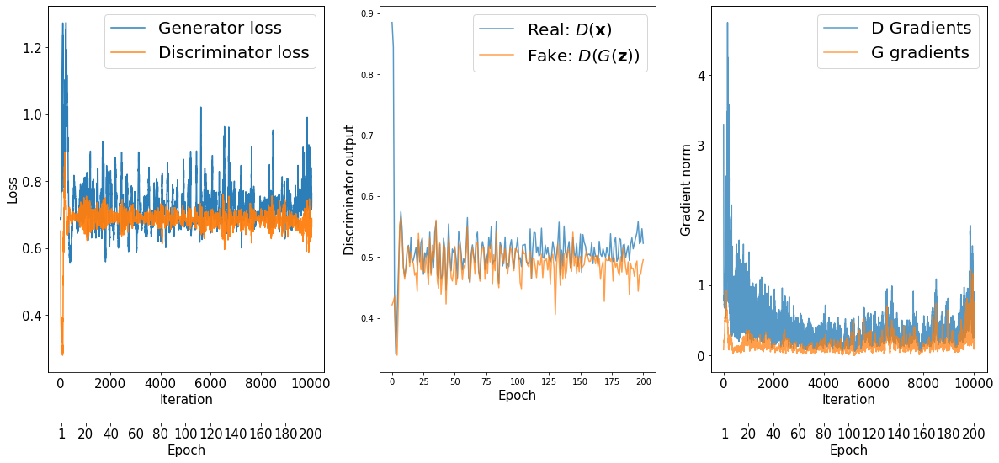

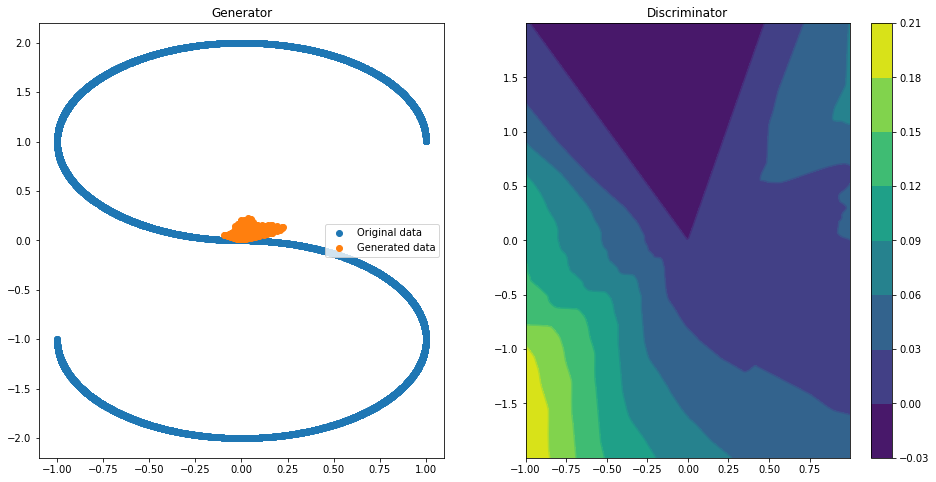

Epoch 000 | ET 0.57 min | Avg Losses >> G/D 0.6651/1.2285 [D-Real: 0.4666 D-Fake: 0.7618]


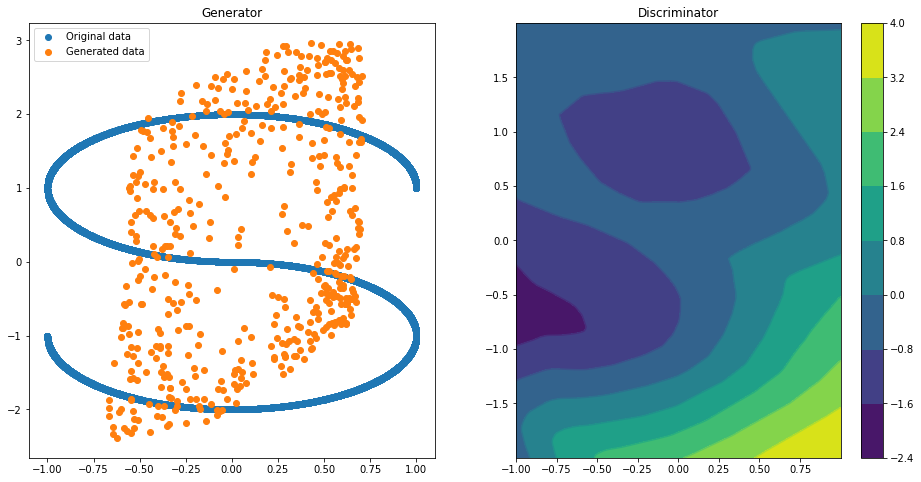

Epoch 050 | ET 1.84 min | Avg Losses >> G/D 0.8828/1.2895 [D-Real: 0.6486 D-Fake: 0.6409]


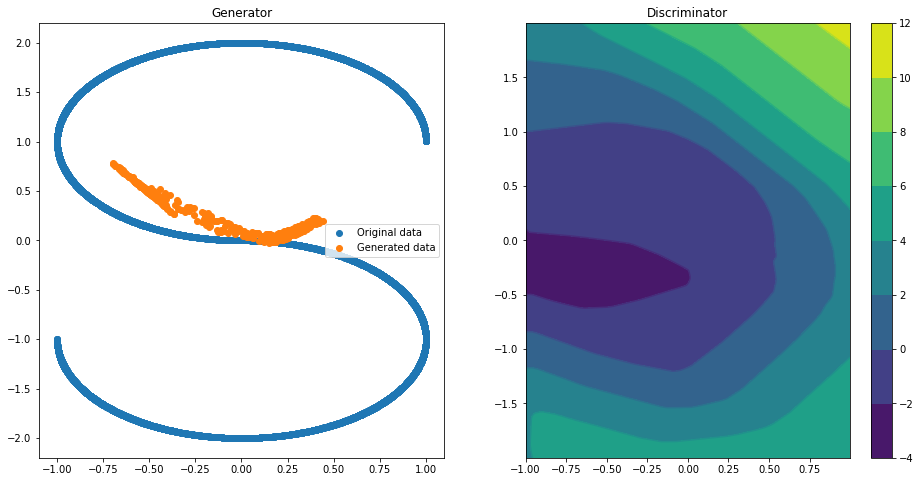

Epoch 100 | ET 3.11 min | Avg Losses >> G/D 1.5847/1.1389 [D-Real: 0.7575 D-Fake: 0.3814]


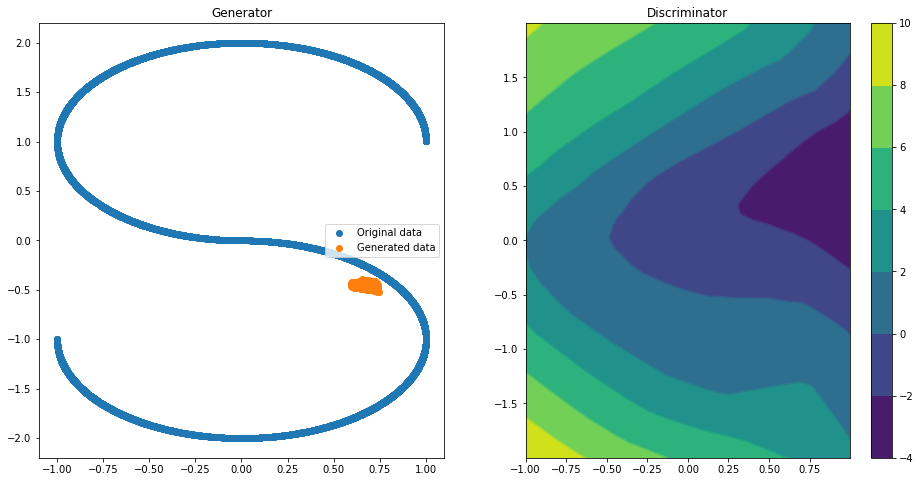

Epoch 150 | ET 4.39 min | Avg Losses >> G/D 1.0892/1.0519 [D-Real: 0.6308 D-Fake: 0.4212]


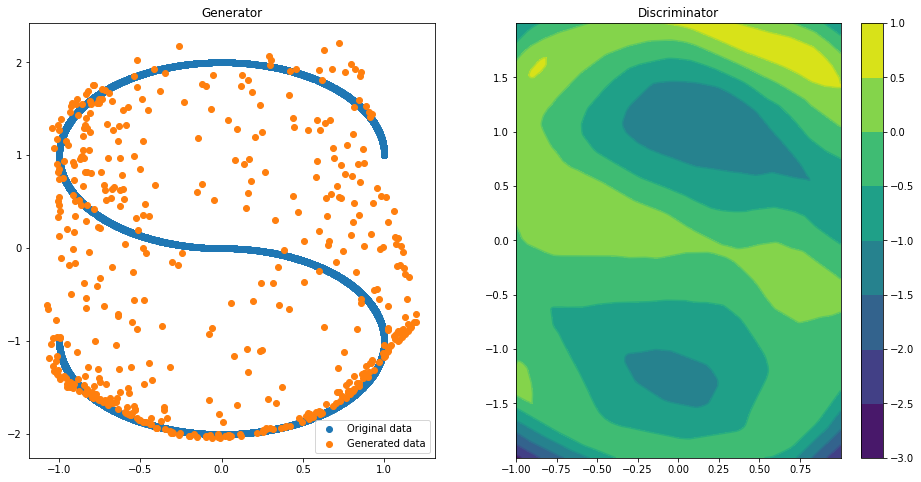

Epoch 200 | ET 5.67 min | Avg Losses >> G/D 0.8060/1.2459 [D-Real: 0.6245 D-Fake: 0.6215]


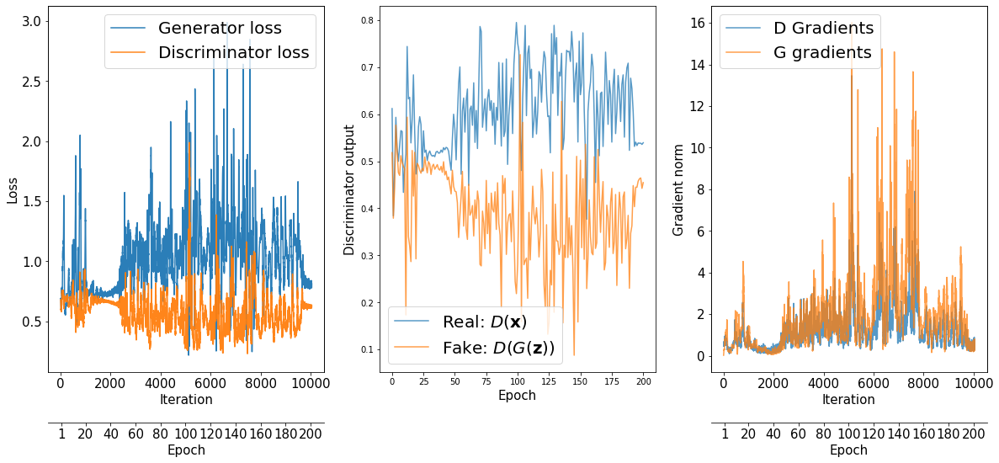

In [ ]:
for _ in range(3):
  for datos in [quadratic, circle, mixture, blobs, circles, moons, swiss_roll, s_curve]:
    numpy_data = datos
    data = tf.data.Dataset.from_tensor_slices(numpy_data).batch(batch_size)

    with tf.device(device_name):
      gen_model = make_generator_network()
      gen_model.build(input_shape=(None,z_size))
      disc_model = make_discriminator_network()
      disc_model.build(input_shape=(None,2))


    loss_fn = tf.keras.losses.BinaryCrossentropy(from_logits=True)
    g_optimizer = tf.keras.optimizers.Adam()
    d_optimizer = tf.keras.optimizers.Adam()
    all_losses = []
    all_d_vals = []
    d_gradients = []
    g_gradients = []
    epoch_samples = []
    start_time = time.time()
    for epoch in range(0, num_epochs+1):
      epoch_losses, epoch_d_vals = [], []
      #Plotting every 50
      if epoch%50 == 0:
          input_z = tf.random.uniform(shape = (500,z_size), minval=-1,maxval=1)
          epoch_samples.append(gen_model(input_z, training=False).numpy())
          X_data, Y_data = numpy_data[:,0], numpy_data[:,1]
          x = np.linspace(np.min(X_data), np.max(X_data), 200)
          y = np.linspace(np.min(Y_data), np.max(Y_data), 200)
          X, Y = np.meshgrid(x, y)
          Z = np.zeros((len(x), len(y)))
          for i in range(len(x)):
            for j in range(len(y)):
              q = tf.convert_to_tensor(np.array([[x[j],y[i]]]).astype("float32"))
              Z[i][j] = disc_model(q).numpy()[0][0]
          f, (ax1, ax2) = plt.subplots(1, 2, figsize = (16,8))
          ax1.scatter(X_data,Y_data, label = "Original data")
          ax1.scatter(epoch_samples[-1][:,0],epoch_samples[-1][:,1], label="Generated data")
          ax1.set_title("Generator")
          ax1.legend()
          ax2.contour(X,Y,Z)
          ax2.set_title("Discriminator")
          cp = ax2.contourf(X , Y , Z)
          plt.colorbar(cp, ax=ax2)
          plt.show()
      for batch in data:
        input_z = tf.random.uniform(shape = (batch_size,z_size), minval=-1,maxval=1)
          #Compute generator's loss
        with tf.GradientTape() as g_tape:
          g_output = gen_model(input_z)
          d_logits_fake = disc_model(g_output,
                                      training=True)
          labels_real = tf.ones_like(d_logits_fake)
          g_loss = loss_fn(y_true=labels_real,
                            y_pred=d_logits_fake)
          #Compute the gradients of g_loss
        g_grads = g_tape.gradient(g_loss,
                                    gen_model.trainable_variables)
        g_gradients.append(tf.linalg.global_norm(g_grads).numpy())
          #Apply the gradients
        g_optimizer.apply_gradients(
              grads_and_vars=zip(g_grads,
                                gen_model.trainable_variables)
          )

          #Compute the discriminator's loss
        with tf.GradientTape() as d_tape:
          d_logits_real = disc_model(batch,
                                      training=True)
          d_labels_real = tf.ones_like(d_logits_real)
          d_loss_real = loss_fn(y_true=d_labels_real,
                                  y_pred=d_logits_real)
          d_logits_fake = disc_model(g_output,
                                      training=True)
          d_labels_fake = tf.zeros_like(d_logits_fake)
          d_loss_fake = loss_fn(y_true=d_labels_fake,
                                  y_pred=d_logits_fake)
          d_loss = d_loss_real + d_loss_fake

          #Compute the gradients of d_loss
        d_grads = d_tape.gradient(d_loss,
                                    disc_model.trainable_variables)
        d_gradients.append(tf.linalg.global_norm(d_grads).numpy())
        d_optimizer.apply_gradients(grads_and_vars=zip(d_grads,
                                                        disc_model.trainable_variables))
          
        epoch_losses.append(
                              (g_loss.numpy(), d_loss.numpy(),
                              d_loss_real.numpy(), d_loss_fake.numpy()))
        d_probs_real = tf.reduce_mean(
                              tf.sigmoid(d_logits_real))
        d_probs_fake = tf.reduce_mean(
                              tf.sigmoid(d_logits_fake))
      epoch_d_vals.append((d_probs_real.numpy(),
                              d_probs_fake.numpy()))
      all_losses.append(epoch_losses)
      all_d_vals.append(epoch_d_vals)
      if epoch%50 == 0:
          print(
                'Epoch {:03d} | ET {:.2f} min | Avg Losses >>'
                ' G/D {:.4f}/{:.4f} [D-Real: {:.4f} D-Fake: {:.4f}]'
                .format(
                epoch, (time.time() - start_time)/60,
                *list(np.mean(all_losses[-1], axis=0))))
    fig = plt.figure(figsize=(20, 8))

    ## Plotting the losses
    ax = fig.add_subplot(1, 3, 1)
    g_losses = [item[0] for item in itertools.chain(*all_losses)]
    d_losses = [item[1]/2.0 for item in itertools.chain(*all_losses)]
    plt.plot(g_losses, label='Generator loss', alpha=0.95)
    plt.plot(d_losses, label='Discriminator loss', alpha=0.95)
    plt.legend(fontsize=20)
    ax.set_xlabel('Iteration', size=15)
    ax.set_ylabel('Loss', size=15)

    epochs = np.arange(1, 101)
    epoch2iter = lambda e: e*len(all_losses[-1])
    epoch_ticks = [1, 20, 40, 60, 80, 100, 120, 140, 160, 180, 200]
    newpos = [epoch2iter(e) for e in epoch_ticks]
    ax2 = ax.twiny()
    ax2.set_xticks(newpos)
    ax2.set_xticklabels(epoch_ticks)
    ax2.xaxis.set_ticks_position('bottom')
    ax2.xaxis.set_label_position('bottom')
    ax2.spines['bottom'].set_position(('outward', 60))
    ax2.set_xlabel('Epoch', size=15)
    ax2.set_xlim(ax.get_xlim())
    ax.tick_params(axis='both', which='major', labelsize=15)
    ax2.tick_params(axis='both', which='major', labelsize=15)

    ## Plotting the outputs of the discriminator
    ax = fig.add_subplot(1, 3, 2)
    d_vals_real = [item[0] for item in itertools.chain(*all_d_vals)]
    d_vals_fake = [item[1] for item in itertools.chain(*all_d_vals)]
    plt.plot(d_vals_real, alpha=0.75, label=r'Real: $D(\mathbf{x})$')
    plt.plot(d_vals_fake, alpha=0.75, label=r'Fake: $D(G(\mathbf{z}))$')
    plt.legend(fontsize=20)
    ax.set_xlabel('Epoch', size=15)
    ax.set_ylabel('Discriminator output', size=15)


    ax = fig.add_subplot(1, 3, 3)
    plt.plot(d_gradients, label = "D Gradients", alpha=.75)
    plt.plot(g_gradients, label = "G gradients", alpha = .75)
    plt.legend(fontsize=20)
    ax.set_xlabel('Iteration', size=15)
    ax.set_ylabel('Gradient norm', size=15)
    ax2 = ax.twiny()
    ax2.set_xticks(newpos)
    ax2.set_xticklabels(epoch_ticks)
    ax2.xaxis.set_ticks_position('bottom')
    ax2.xaxis.set_label_position('bottom')
    ax2.spines['bottom'].set_position(('outward', 60))
    ax2.set_xlabel('Epoch', size=15)
    ax2.set_xlim(ax.get_xlim())
    ax.tick_params(axis='both', which='major', labelsize=15)
    ax2.tick_params(axis='both', which='major', labelsize=15)

    #plt.savefig('images/ch17-gan-learning-curve.pdf')
    plt.show()

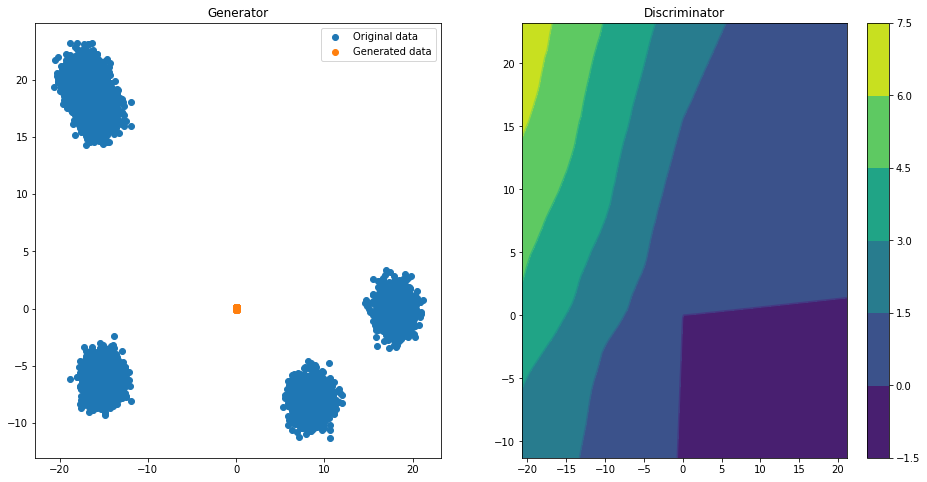

Epoch 000 | ET 0.58 min | Avg Losses >> G/D 0.7410/0.7026 [D-Real: 0.0473 D-Fake: 0.6554]


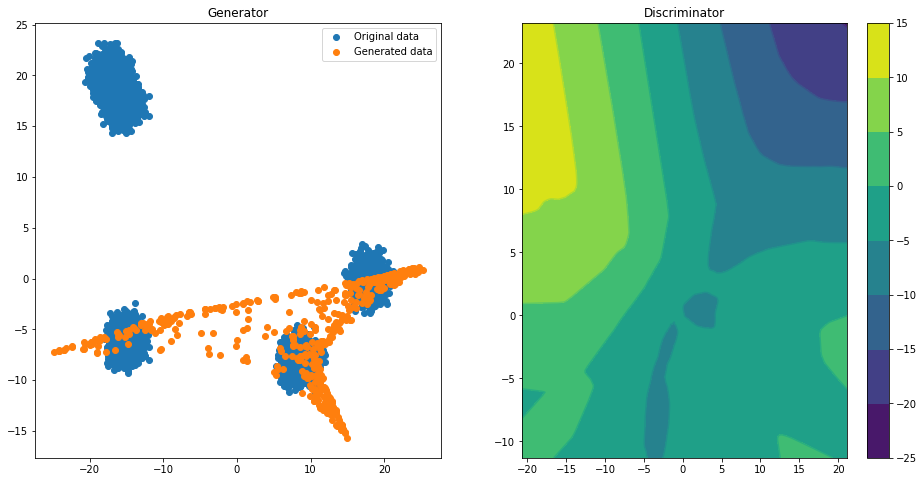

Epoch 050 | ET 1.91 min | Avg Losses >> G/D 1.6283/0.9023 [D-Real: 0.5676 D-Fake: 0.3348]


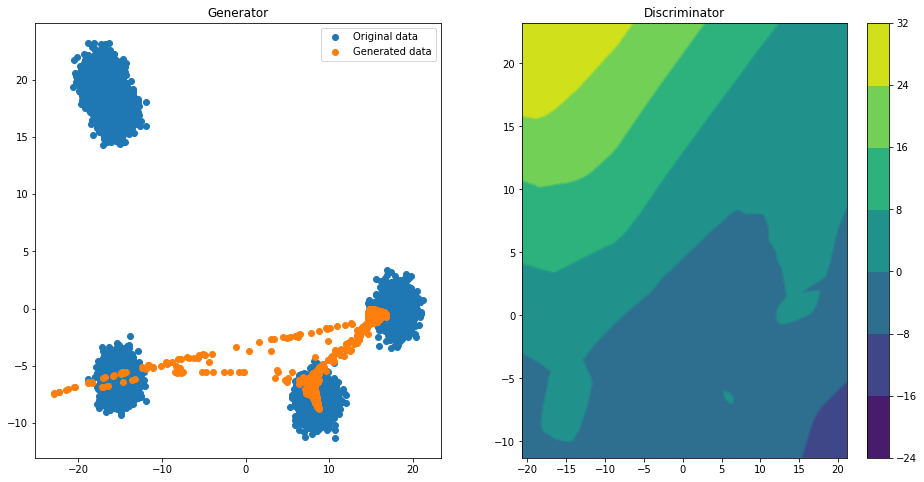

Epoch 100 | ET 3.25 min | Avg Losses >> G/D 1.3928/0.8675 [D-Real: 0.4409 D-Fake: 0.4266]


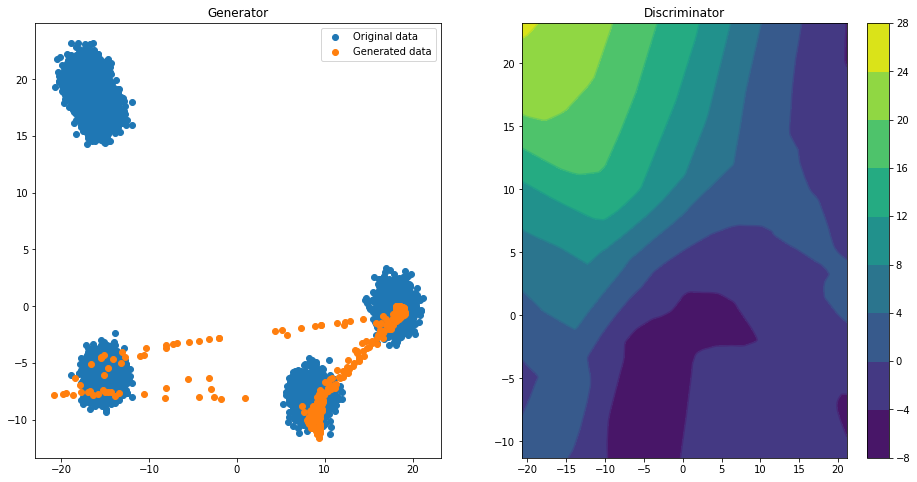

Epoch 150 | ET 4.59 min | Avg Losses >> G/D 1.4730/0.9095 [D-Real: 0.5524 D-Fake: 0.3571]


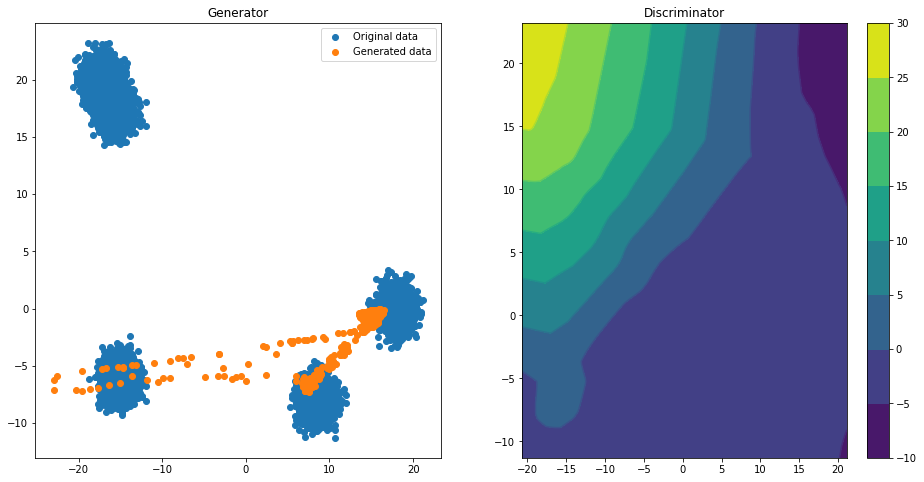

Epoch 200 | ET 5.92 min | Avg Losses >> G/D 1.3517/0.8395 [D-Real: 0.4546 D-Fake: 0.3849]


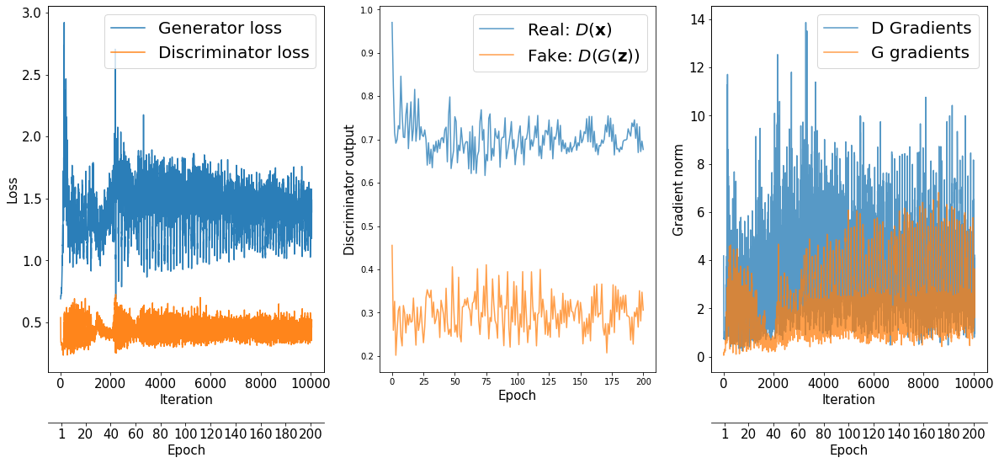

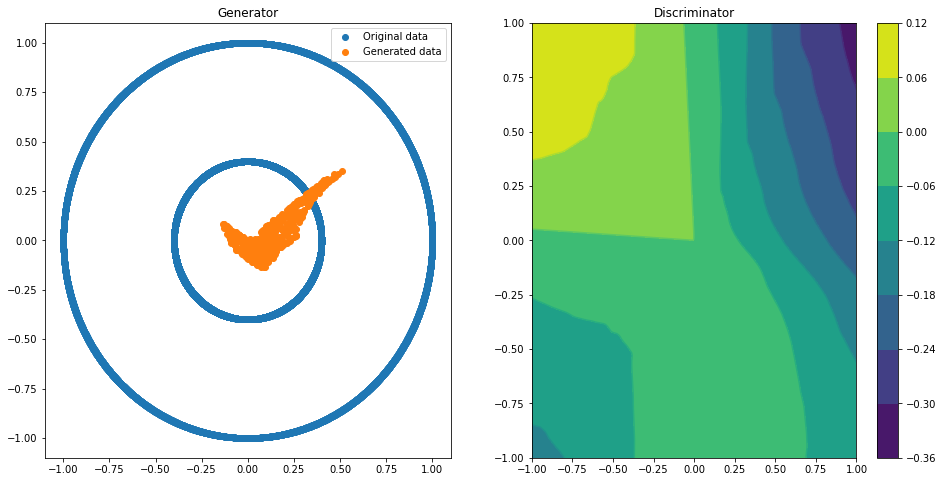

Epoch 000 | ET 0.57 min | Avg Losses >> G/D 0.6771/1.3259 [D-Real: 0.6017 D-Fake: 0.7242]


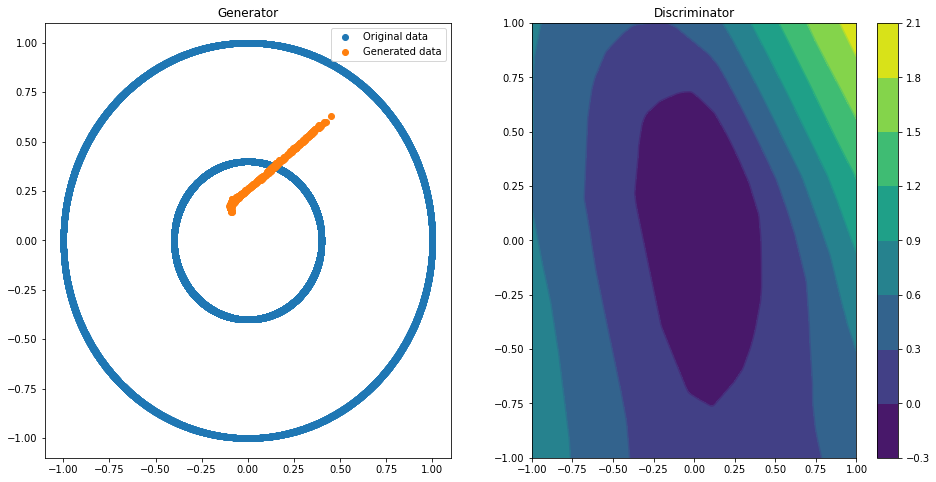

Epoch 050 | ET 1.91 min | Avg Losses >> G/D 0.8275/1.2014 [D-Real: 0.6057 D-Fake: 0.5956]


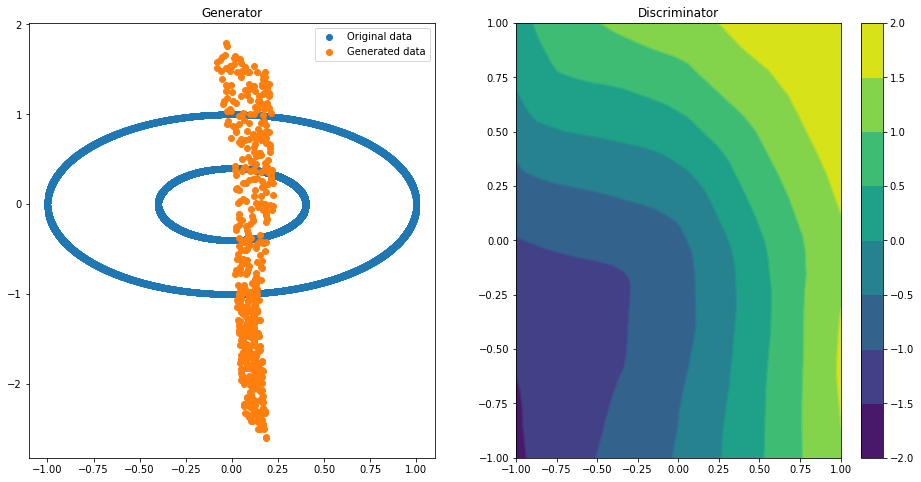

Epoch 100 | ET 3.23 min | Avg Losses >> G/D 0.8260/1.3919 [D-Real: 0.7332 D-Fake: 0.6587]


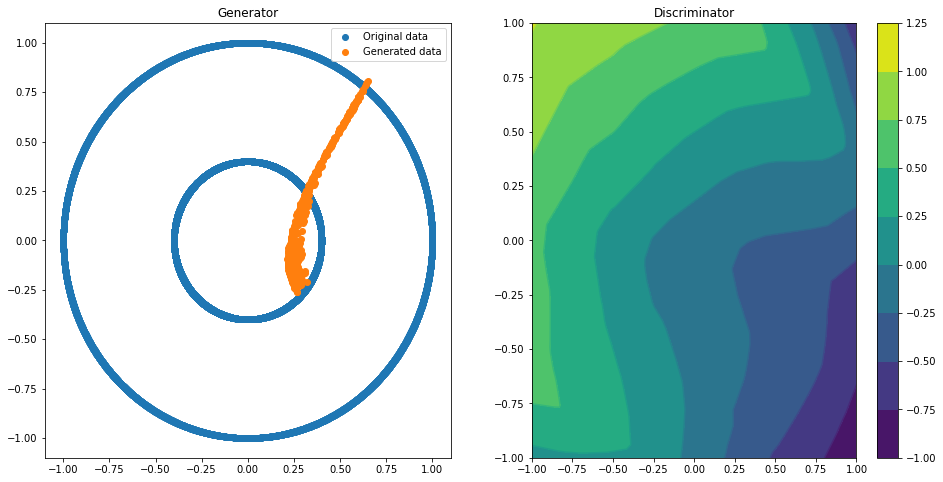

Epoch 150 | ET 4.57 min | Avg Losses >> G/D 0.7728/1.2906 [D-Real: 0.6677 D-Fake: 0.6229]


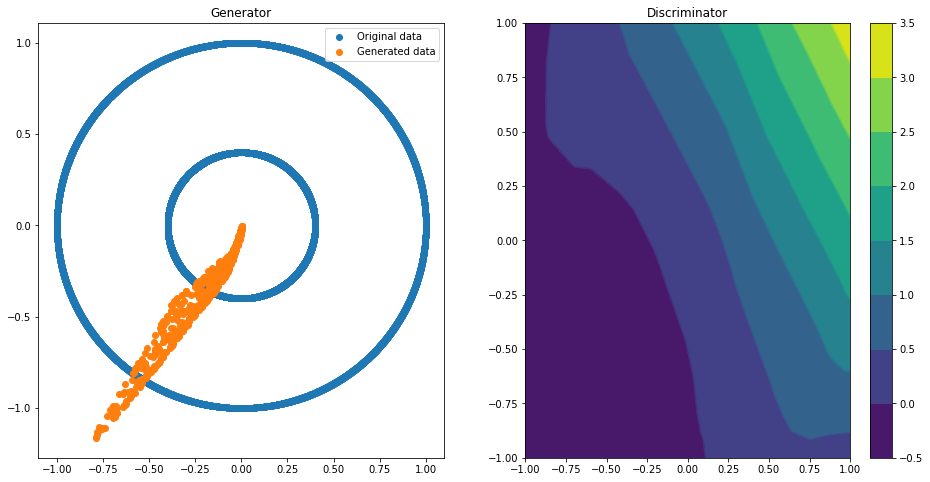

Epoch 200 | ET 5.90 min | Avg Losses >> G/D 0.7564/1.2269 [D-Real: 0.5863 D-Fake: 0.6406]


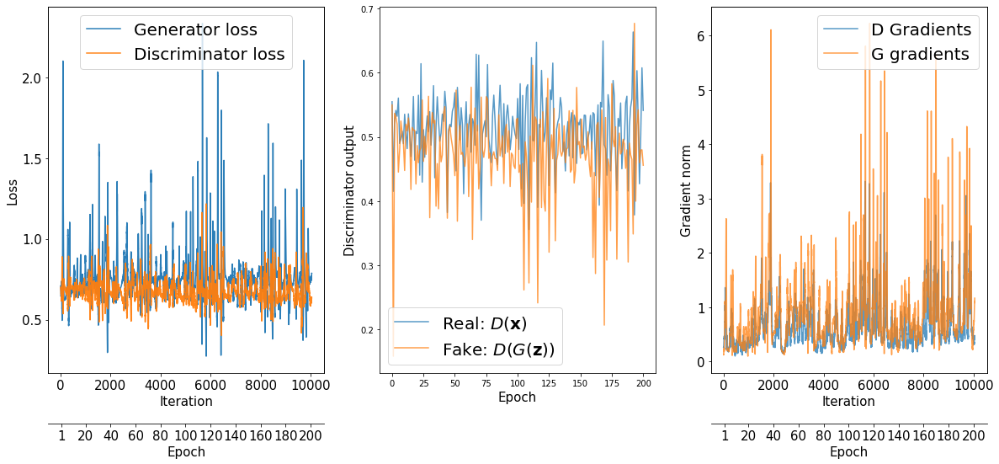

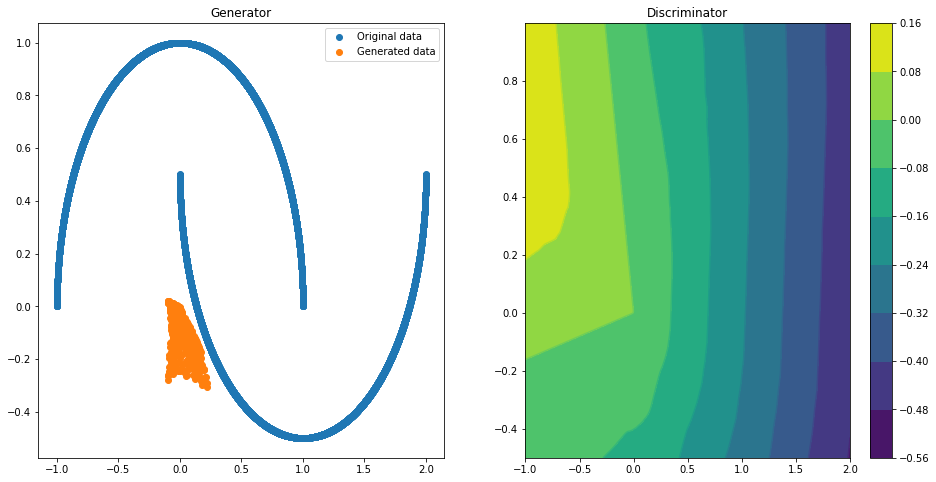

Epoch 000 | ET 0.59 min | Avg Losses >> G/D 0.7242/1.3040 [D-Real: 0.6275 D-Fake: 0.6764]


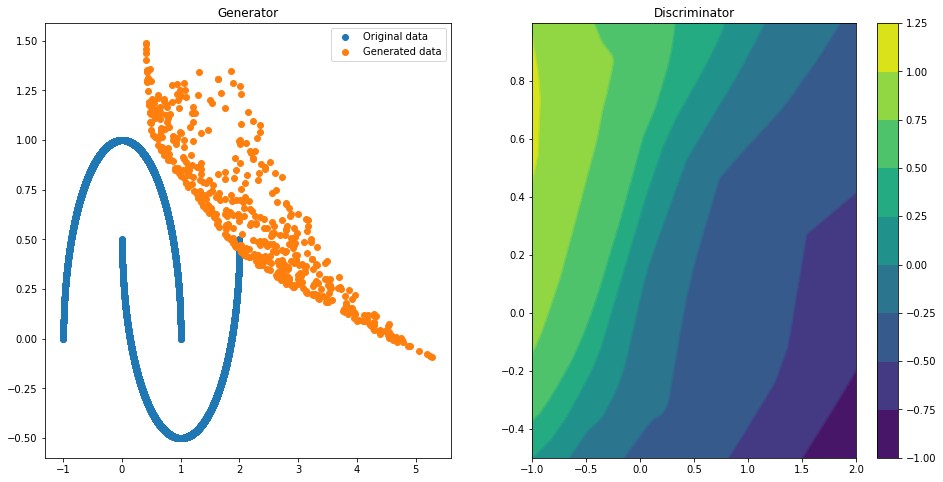

Epoch 050 | ET 1.99 min | Avg Losses >> G/D 0.8225/1.2621 [D-Real: 0.6011 D-Fake: 0.6610]


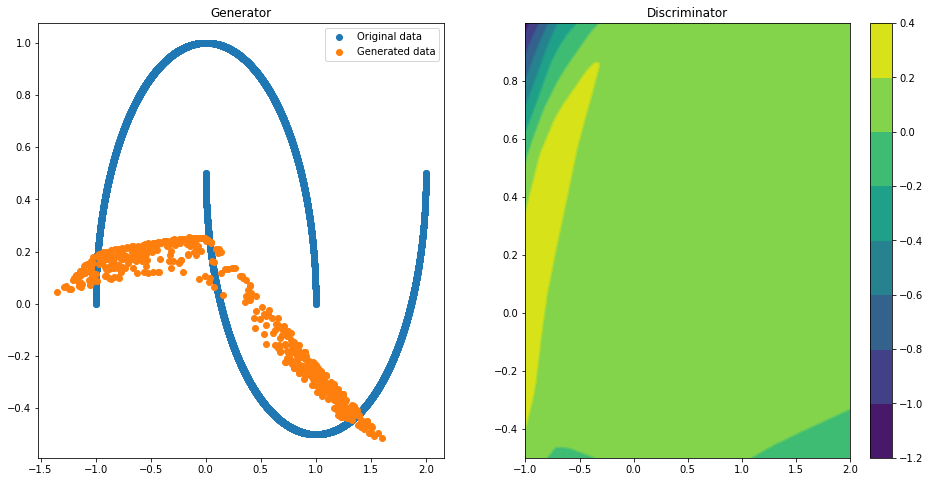

Epoch 100 | ET 3.36 min | Avg Losses >> G/D 0.6439/1.3515 [D-Real: 0.6028 D-Fake: 0.7487]


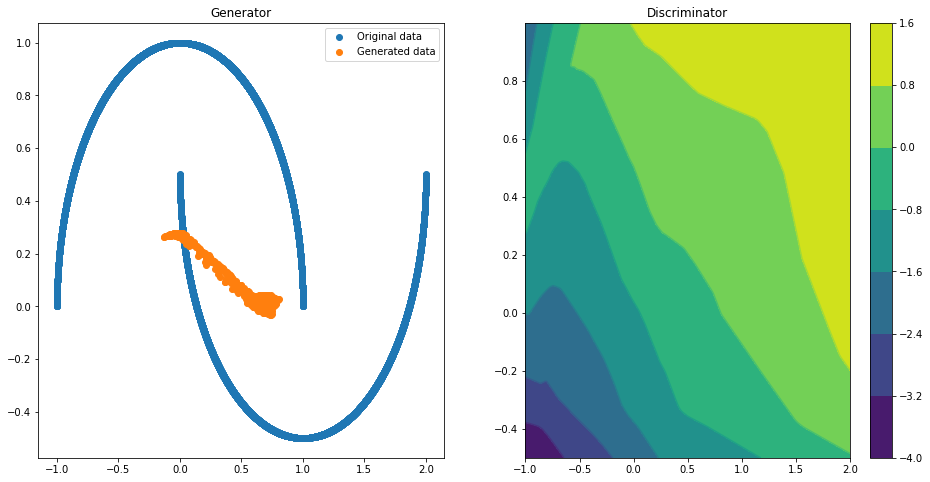

Epoch 150 | ET 4.74 min | Avg Losses >> G/D 0.8067/1.2676 [D-Real: 0.6747 D-Fake: 0.5929]


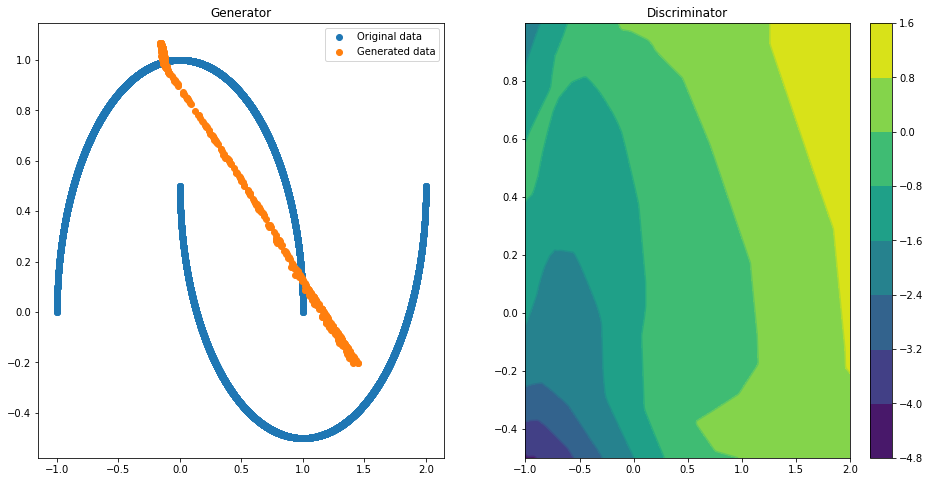

Epoch 200 | ET 6.12 min | Avg Losses >> G/D 0.8304/1.3464 [D-Real: 0.7616 D-Fake: 0.5848]


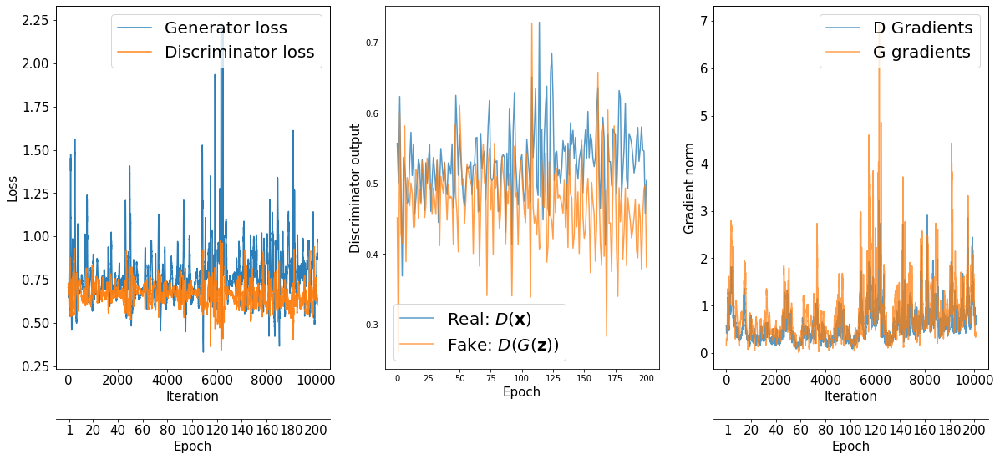

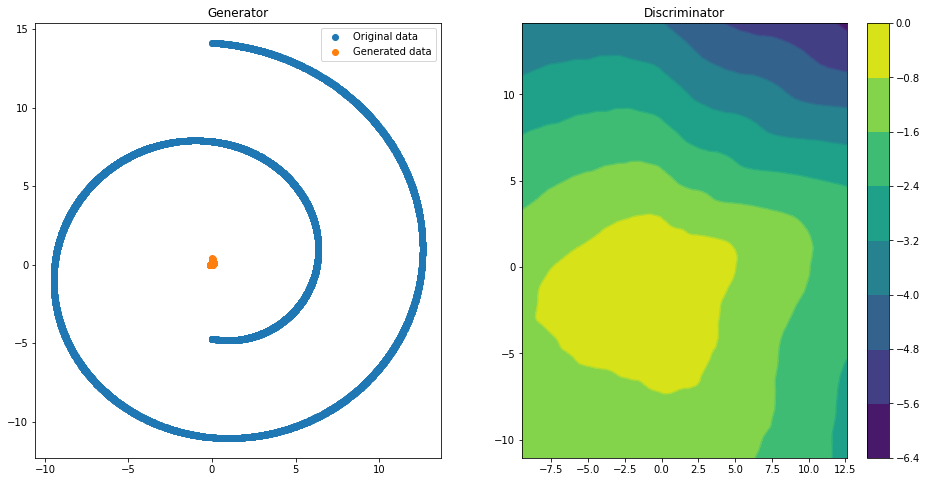

Epoch 000 | ET 0.57 min | Avg Losses >> G/D 0.6212/1.0799 [D-Real: 0.3012 D-Fake: 0.7786]


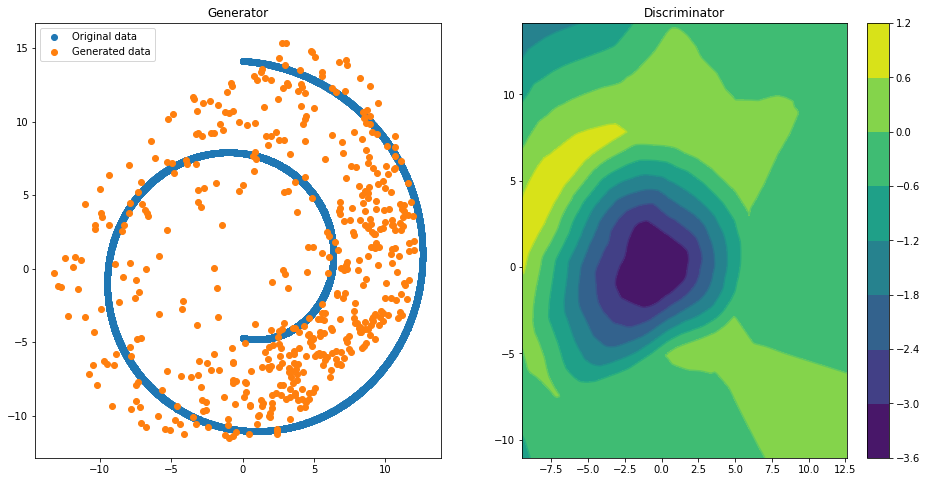

Epoch 050 | ET 1.95 min | Avg Losses >> G/D 0.8063/1.2791 [D-Real: 0.6346 D-Fake: 0.6445]


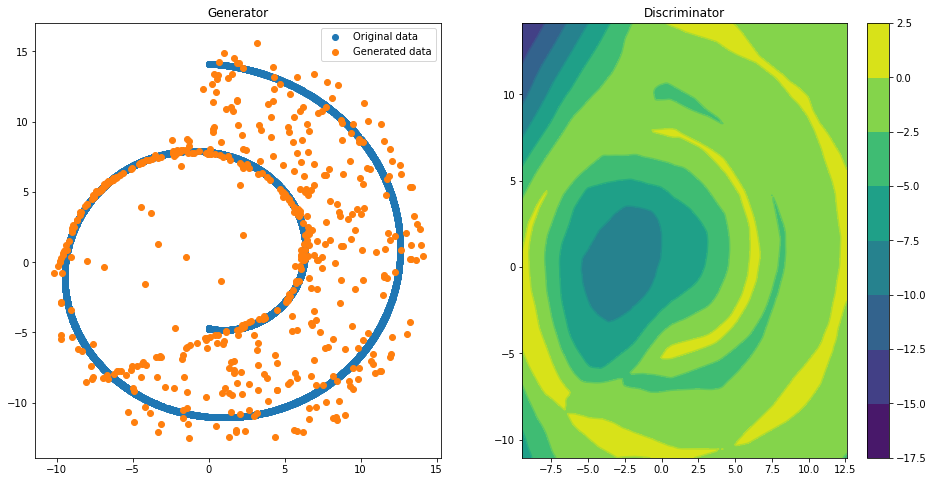

Epoch 100 | ET 3.34 min | Avg Losses >> G/D 1.1230/1.0629 [D-Real: 0.5175 D-Fake: 0.5455]


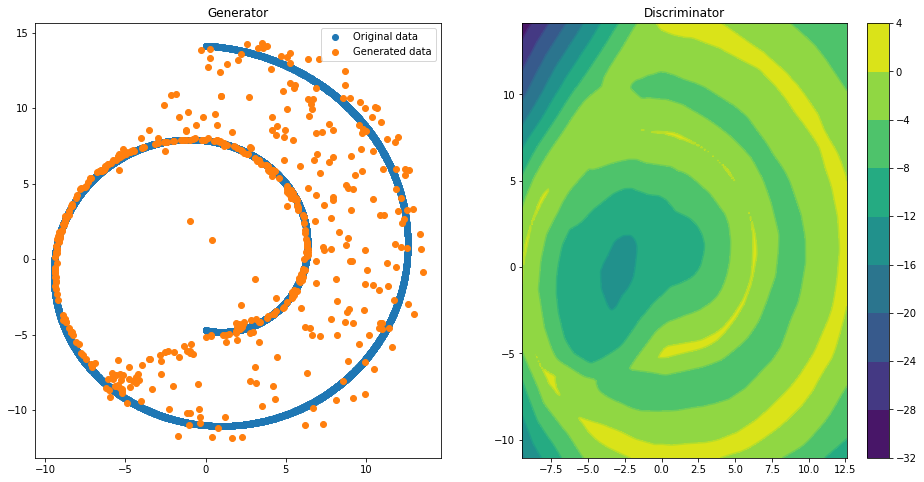

Epoch 150 | ET 4.72 min | Avg Losses >> G/D 1.5103/0.9908 [D-Real: 0.4729 D-Fake: 0.5179]


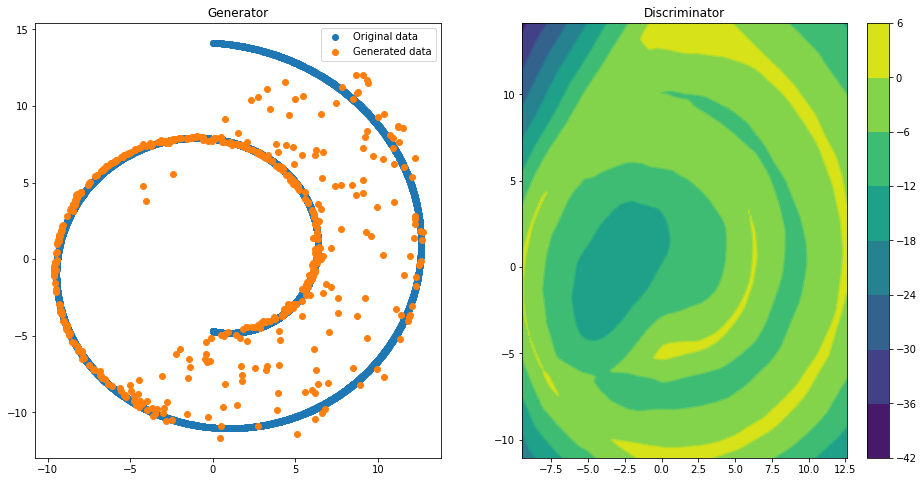

Epoch 200 | ET 6.12 min | Avg Losses >> G/D 1.5816/1.0109 [D-Real: 0.4965 D-Fake: 0.5144]


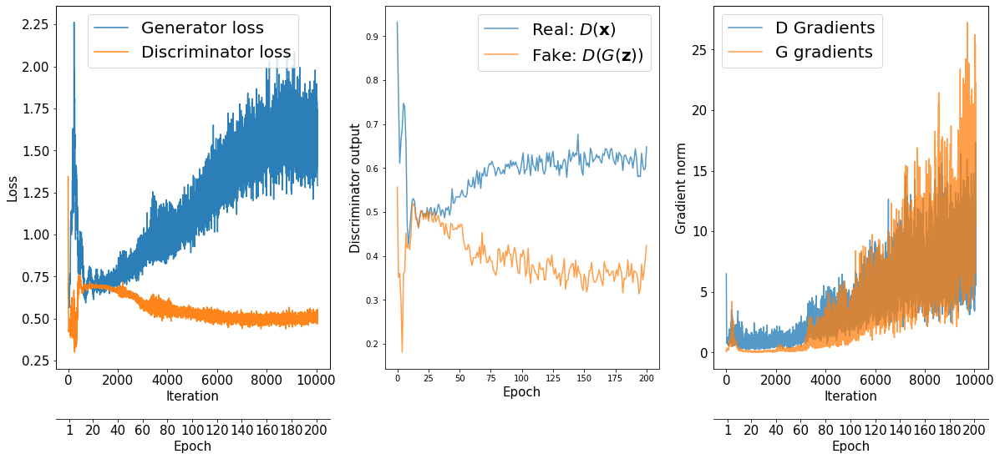

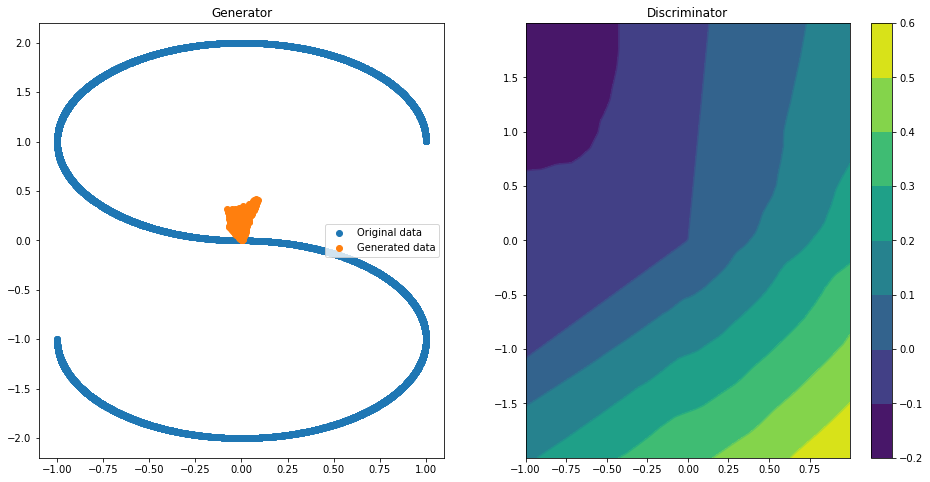

Epoch 000 | ET 0.58 min | Avg Losses >> G/D 0.7229/1.1355 [D-Real: 0.4549 D-Fake: 0.6805]


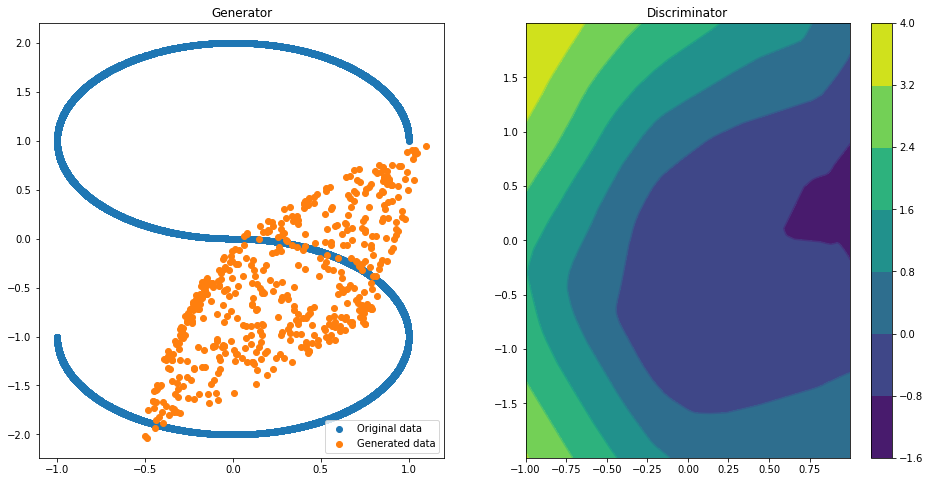

Epoch 050 | ET 1.97 min | Avg Losses >> G/D 0.9572/1.2422 [D-Real: 0.6105 D-Fake: 0.6316]


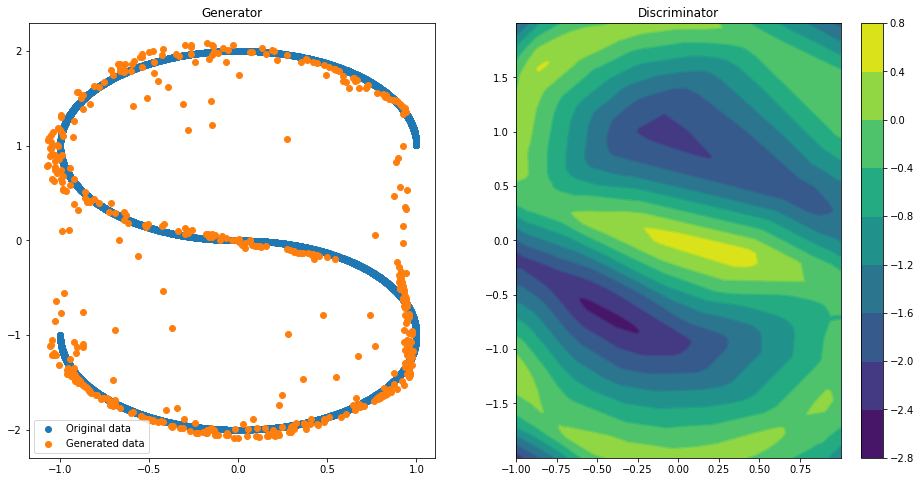

Epoch 100 | ET 3.36 min | Avg Losses >> G/D 0.7468/1.3432 [D-Real: 0.6656 D-Fake: 0.6775]


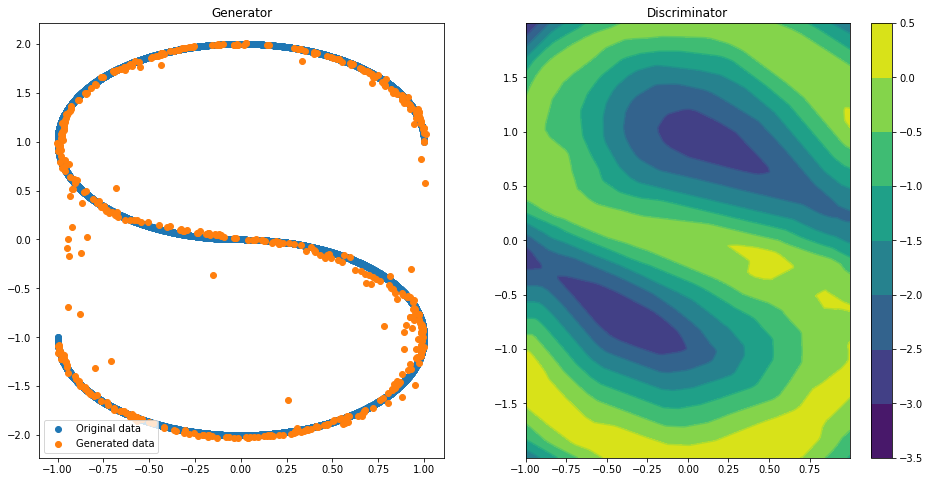

Epoch 150 | ET 4.77 min | Avg Losses >> G/D 0.7157/1.3740 [D-Real: 0.6850 D-Fake: 0.6890]


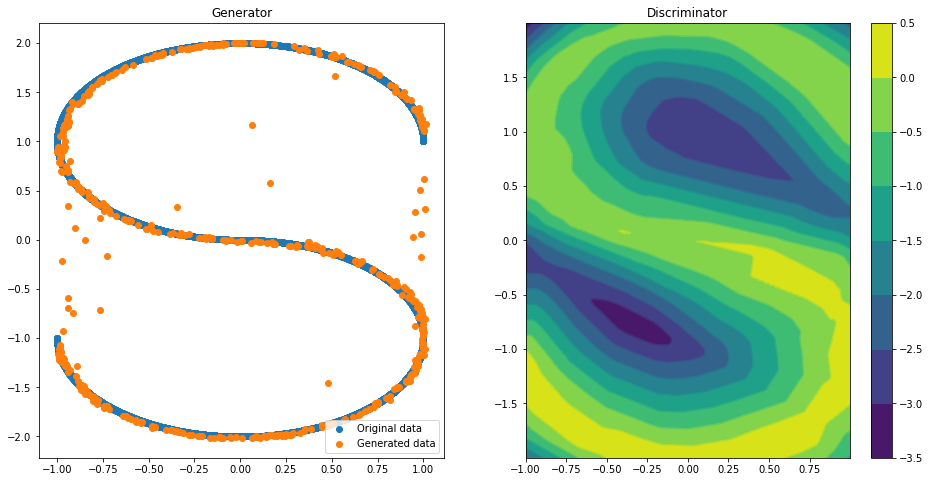

Epoch 200 | ET 6.16 min | Avg Losses >> G/D 0.7089/1.3765 [D-Real: 0.6854 D-Fake: 0.6911]


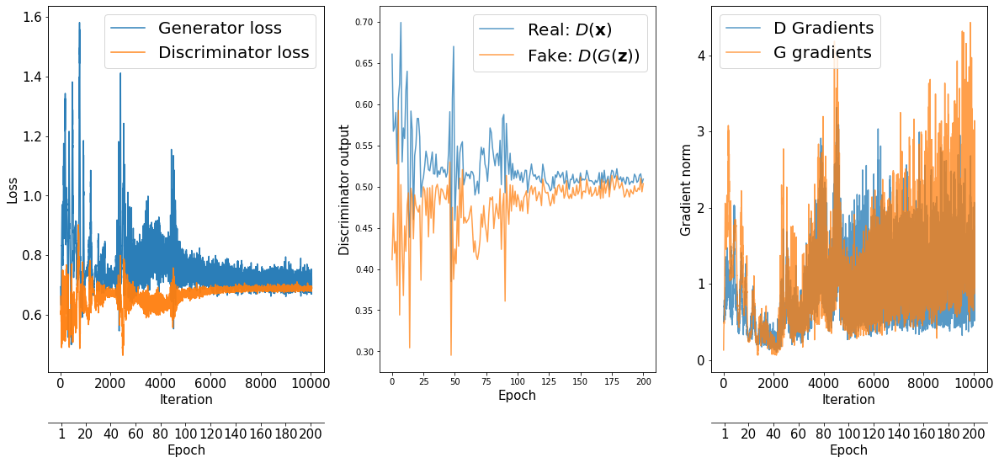

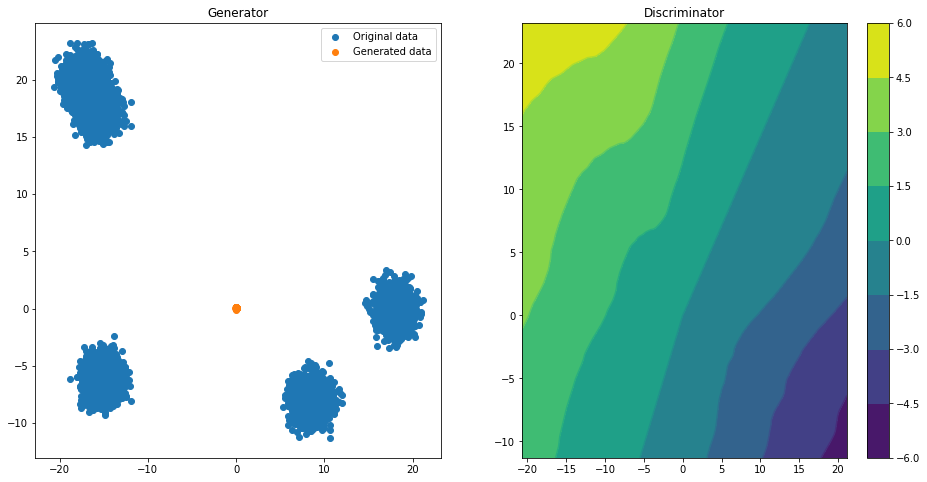

Epoch 000 | ET 0.59 min | Avg Losses >> G/D 0.7618/0.7430 [D-Real: 0.1051 D-Fake: 0.6379]


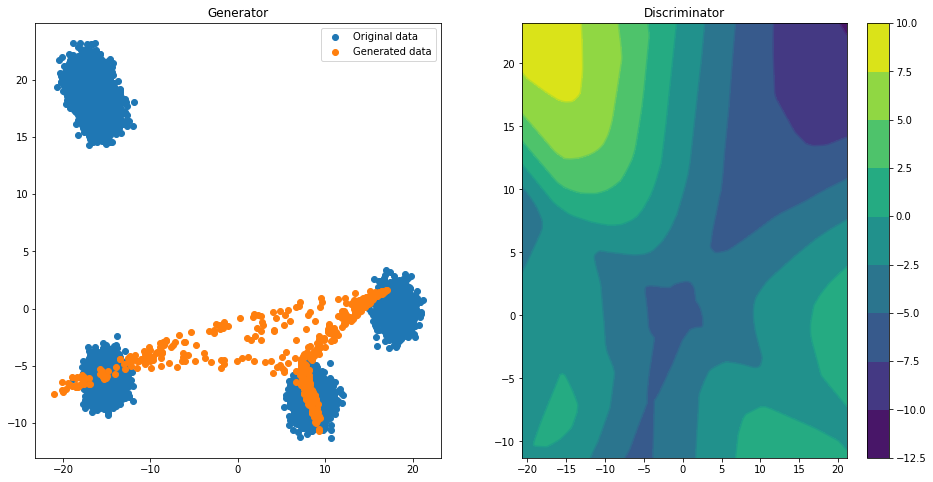

Epoch 050 | ET 1.99 min | Avg Losses >> G/D 1.6977/1.0073 [D-Real: 0.6269 D-Fake: 0.3804]


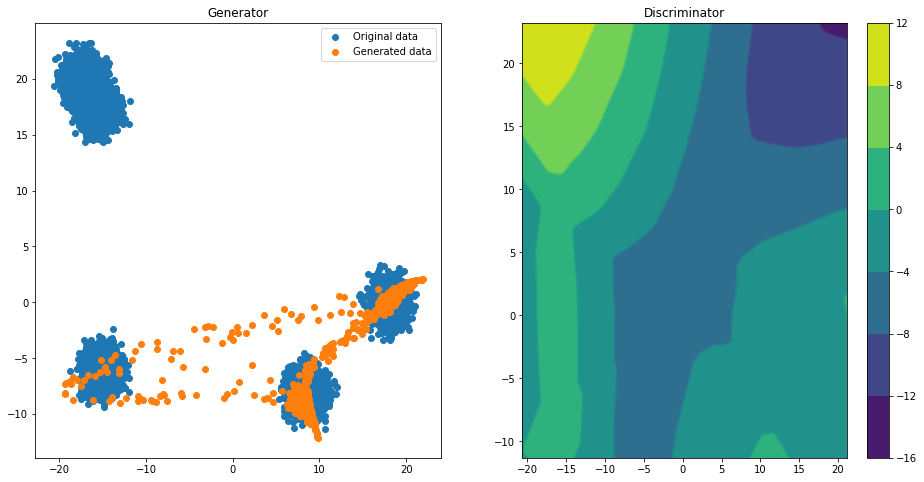

Epoch 100 | ET 3.38 min | Avg Losses >> G/D 1.5084/0.8864 [D-Real: 0.5330 D-Fake: 0.3535]


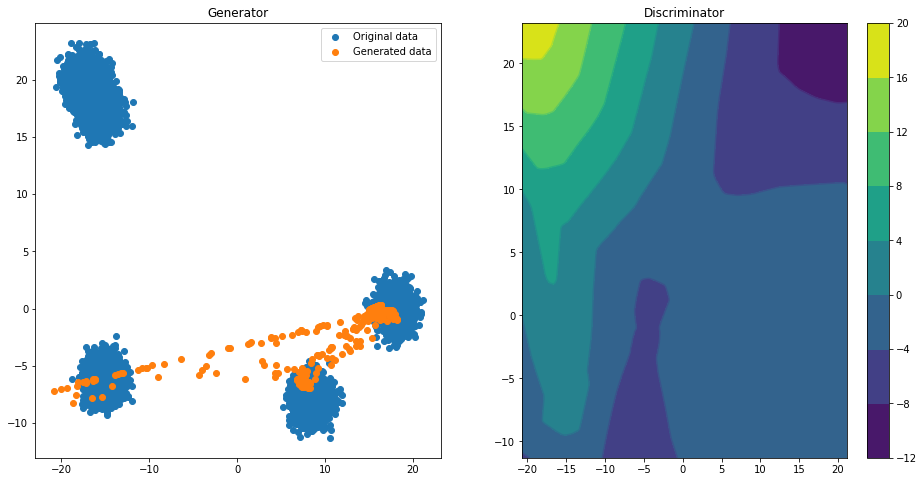

Epoch 150 | ET 4.76 min | Avg Losses >> G/D 1.3464/0.8903 [D-Real: 0.5003 D-Fake: 0.3900]


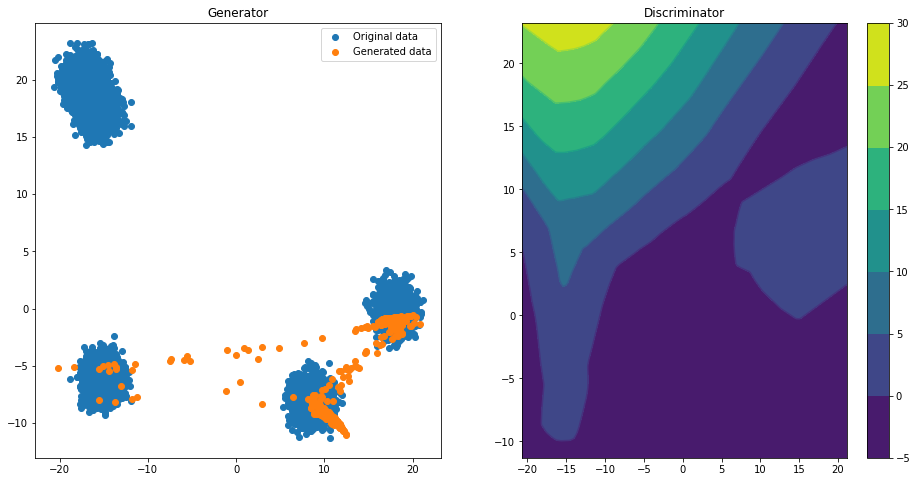

Epoch 200 | ET 6.16 min | Avg Losses >> G/D 1.2258/0.9043 [D-Real: 0.4913 D-Fake: 0.4130]


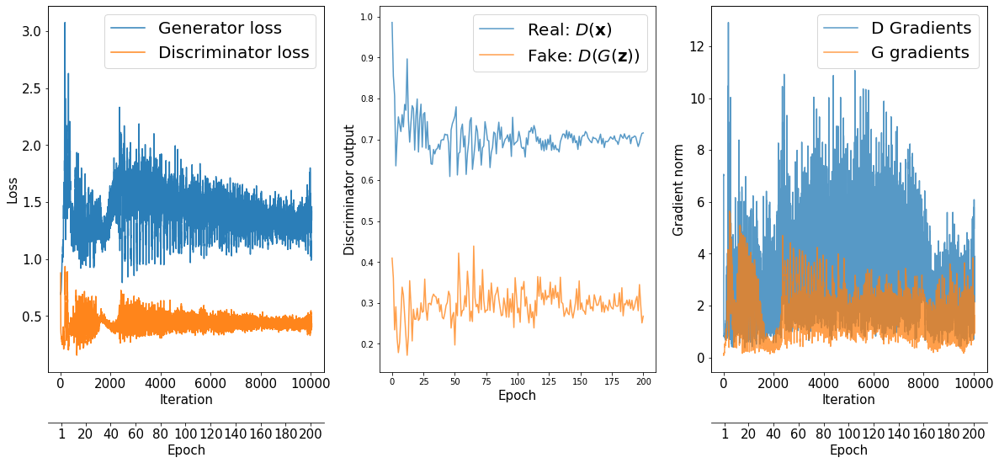

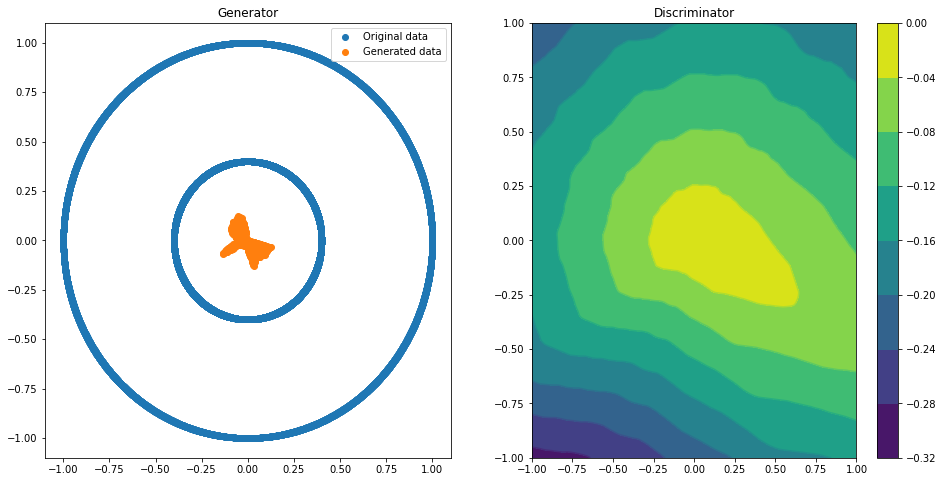

Epoch 000 | ET 0.58 min | Avg Losses >> G/D 0.6998/1.2809 [D-Real: 0.5888 D-Fake: 0.6921]


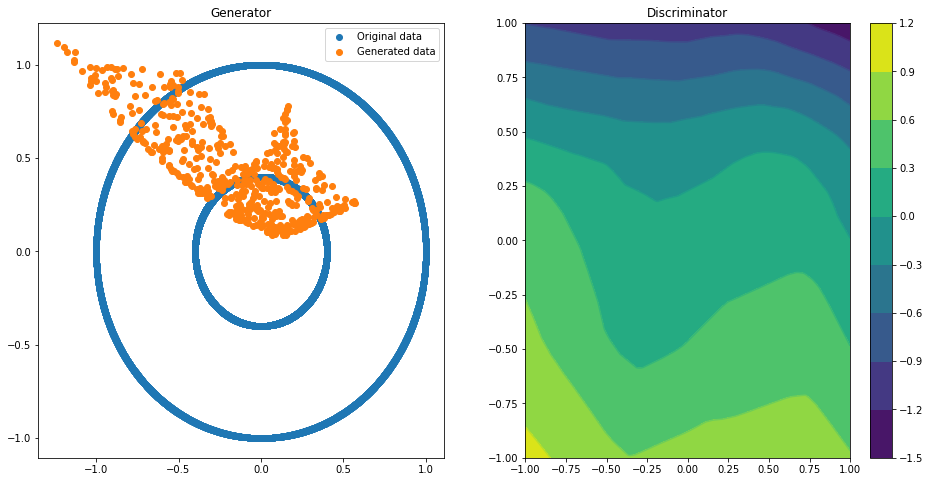

Epoch 050 | ET 1.98 min | Avg Losses >> G/D 0.6863/1.4102 [D-Real: 0.7001 D-Fake: 0.7102]


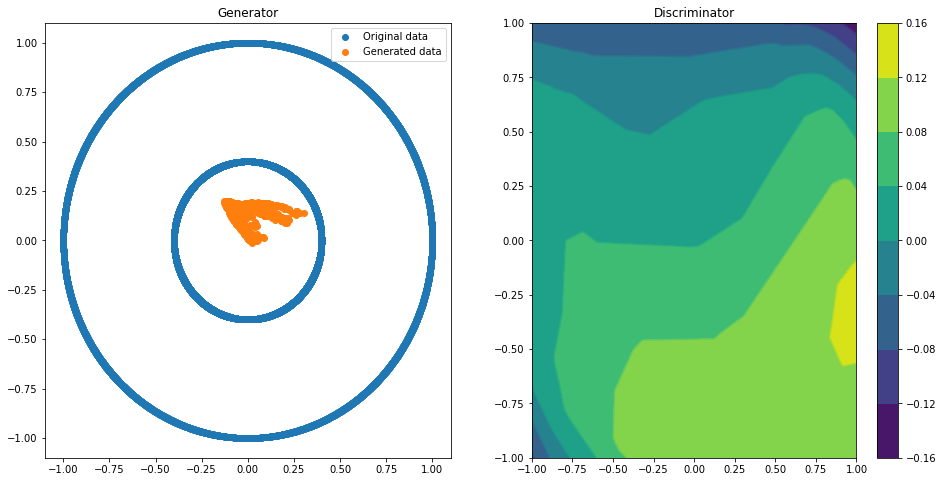

Epoch 100 | ET 3.40 min | Avg Losses >> G/D 0.6873/1.3698 [D-Real: 0.6707 D-Fake: 0.6991]


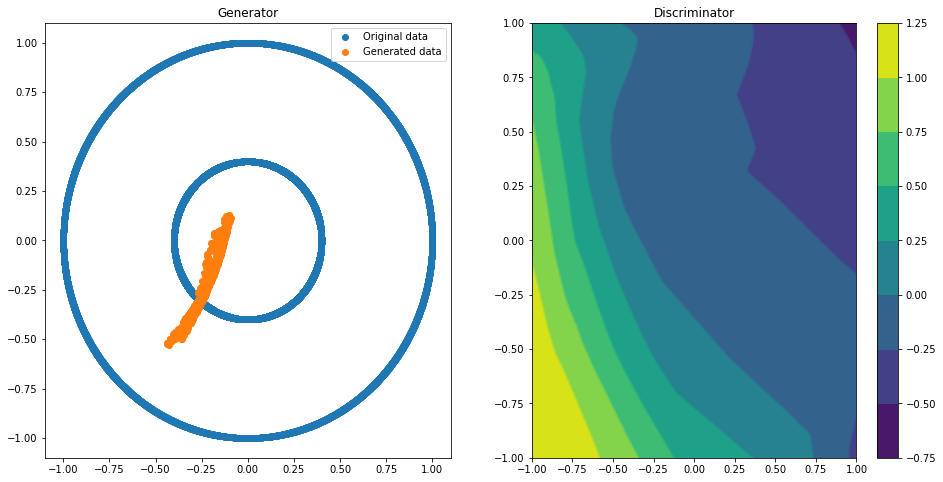

Epoch 150 | ET 4.83 min | Avg Losses >> G/D 0.7070/1.3138 [D-Real: 0.6261 D-Fake: 0.6877]


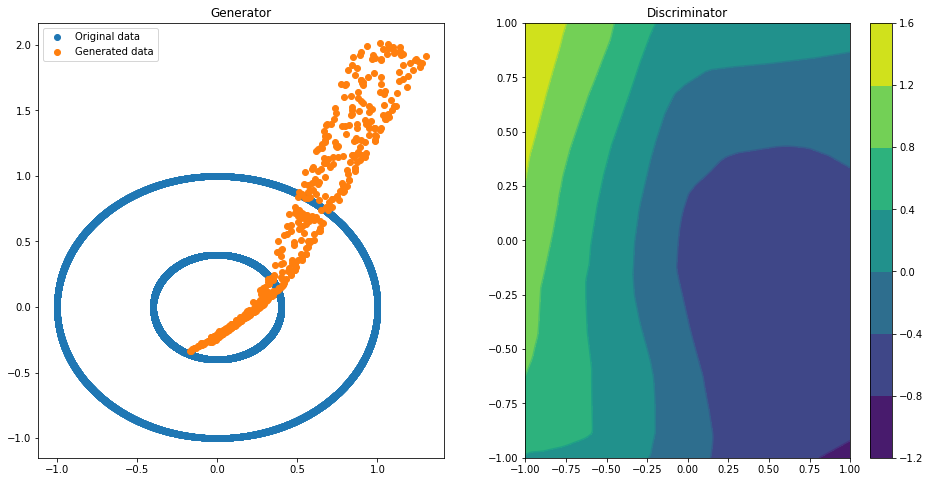

Epoch 200 | ET 6.24 min | Avg Losses >> G/D 0.8731/1.3510 [D-Real: 0.7147 D-Fake: 0.6363]


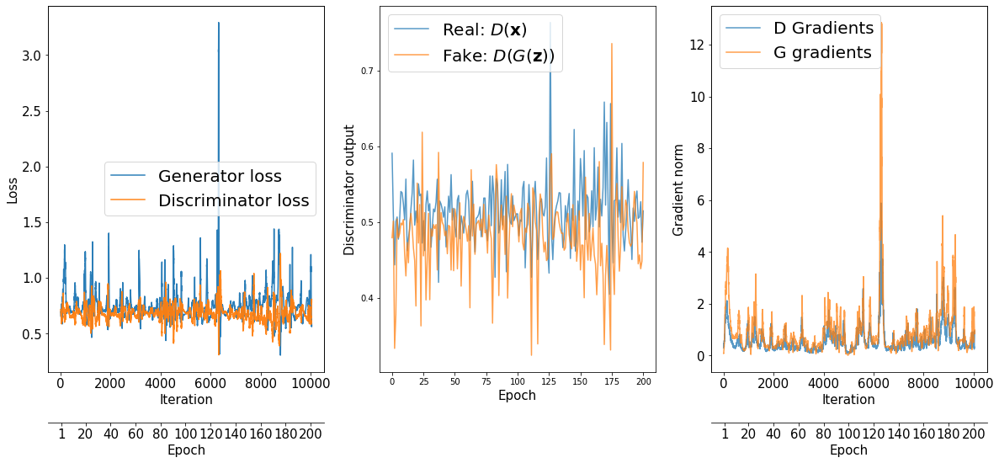

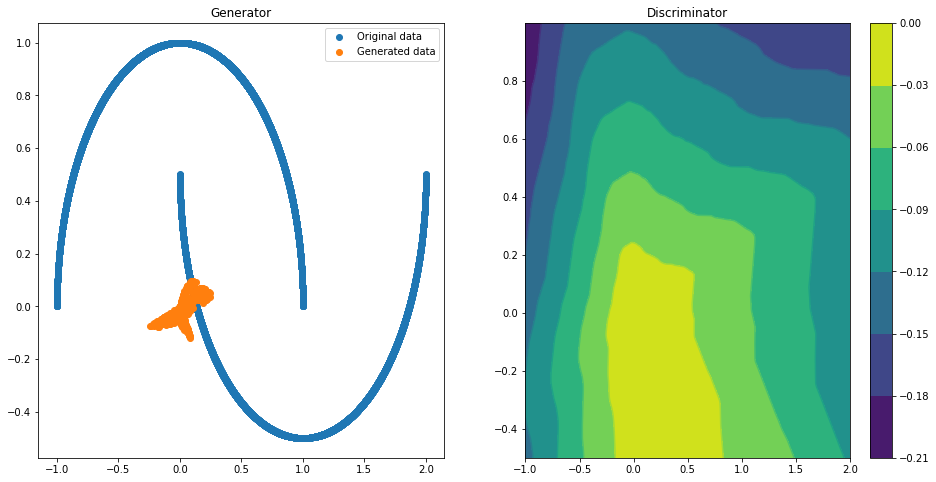

Epoch 000 | ET 0.59 min | Avg Losses >> G/D 0.6847/1.2971 [D-Real: 0.5888 D-Fake: 0.7083]


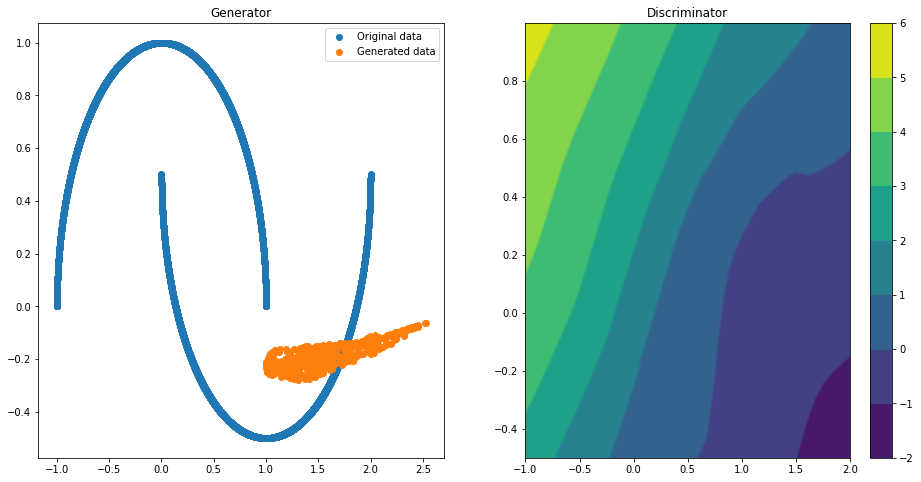

Epoch 050 | ET 2.02 min | Avg Losses >> G/D 0.9399/1.1240 [D-Real: 0.6105 D-Fake: 0.5134]


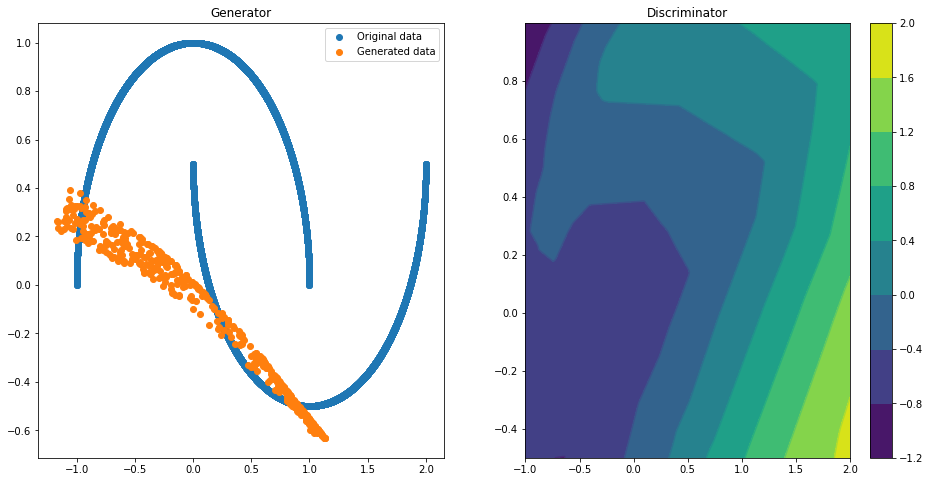

Epoch 100 | ET 3.42 min | Avg Losses >> G/D 0.8422/1.2570 [D-Real: 0.6383 D-Fake: 0.6187]


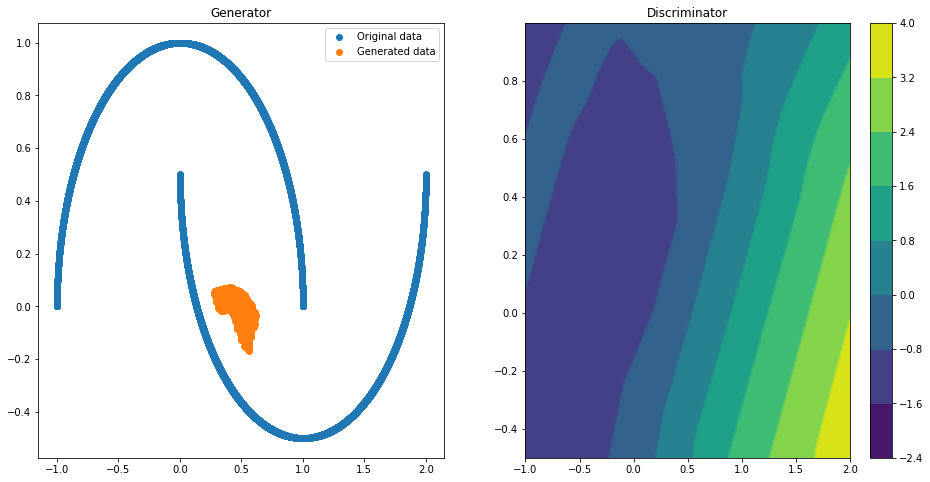

Epoch 150 | ET 4.82 min | Avg Losses >> G/D 0.8891/1.4974 [D-Real: 0.9187 D-Fake: 0.5787]


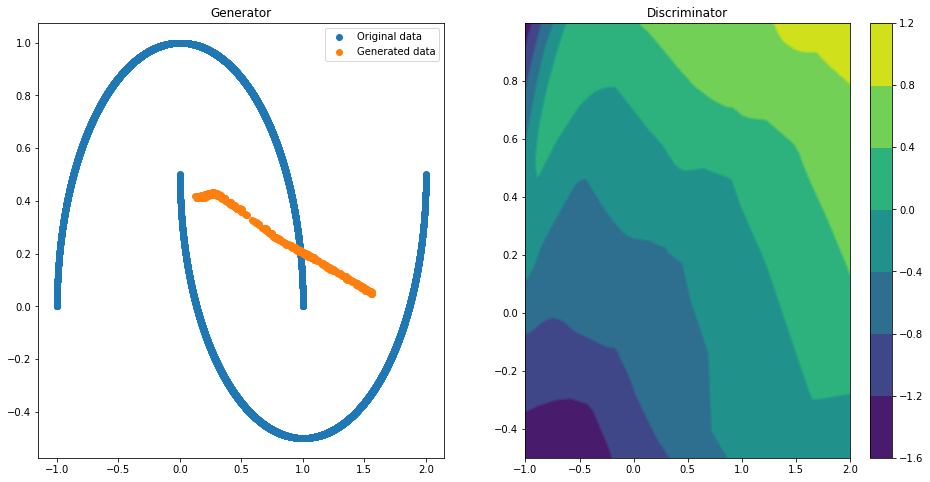

Epoch 200 | ET 6.26 min | Avg Losses >> G/D 0.7837/1.3144 [D-Real: 0.6939 D-Fake: 0.6205]


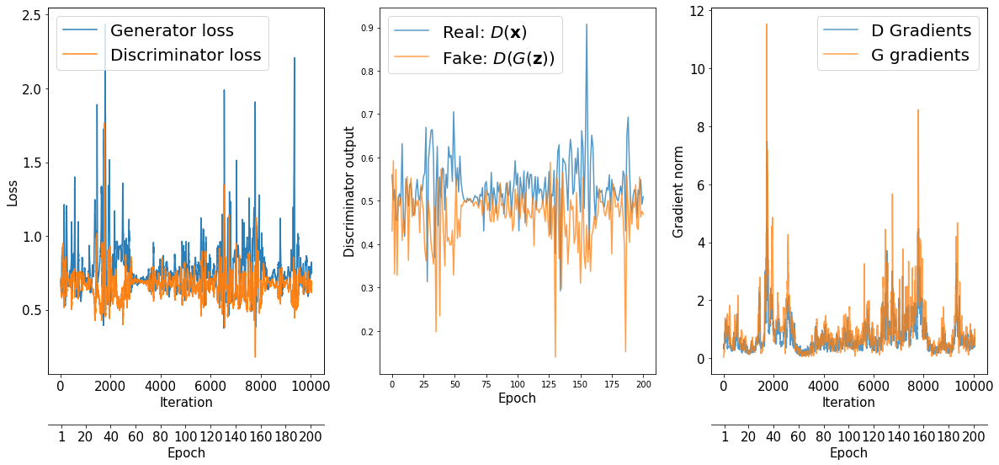

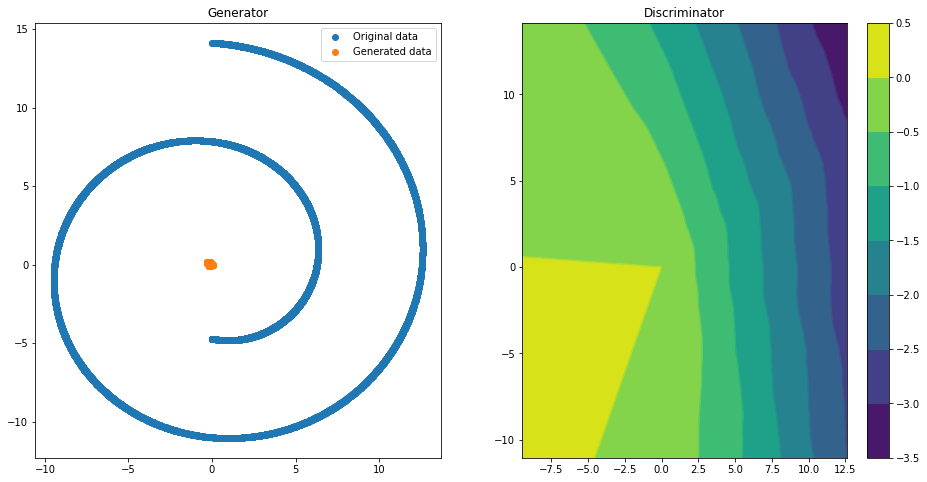

Epoch 000 | ET 0.59 min | Avg Losses >> G/D 0.6572/0.9842 [D-Real: 0.2461 D-Fake: 0.7382]


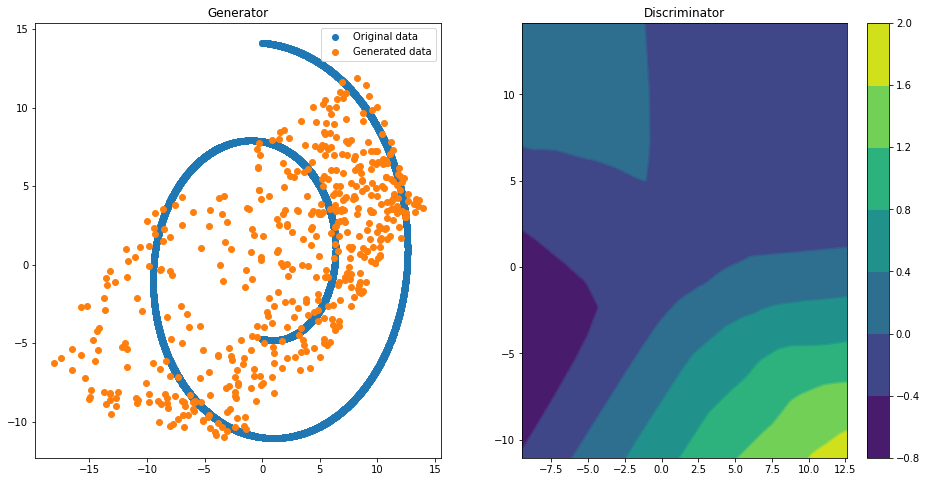

Epoch 050 | ET 1.99 min | Avg Losses >> G/D 0.7476/1.3772 [D-Real: 0.6897 D-Fake: 0.6875]


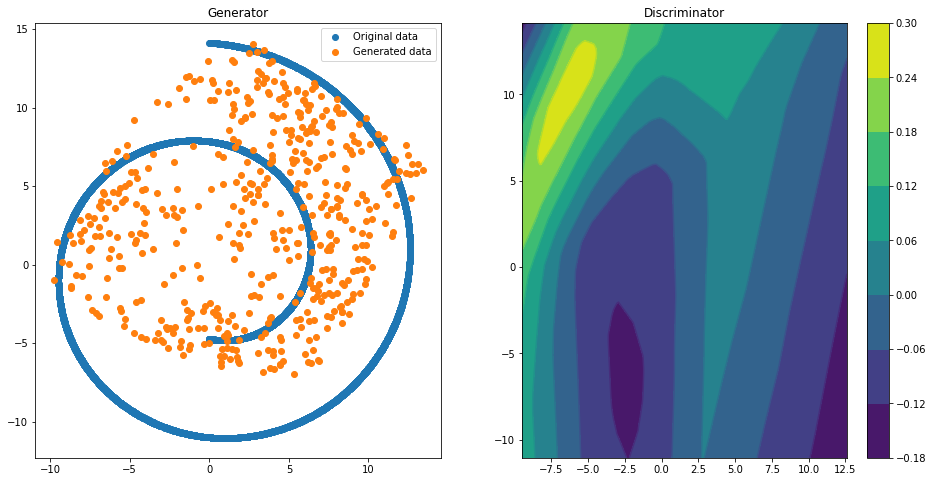

Epoch 100 | ET 3.41 min | Avg Losses >> G/D 0.7116/1.3550 [D-Real: 0.6752 D-Fake: 0.6798]


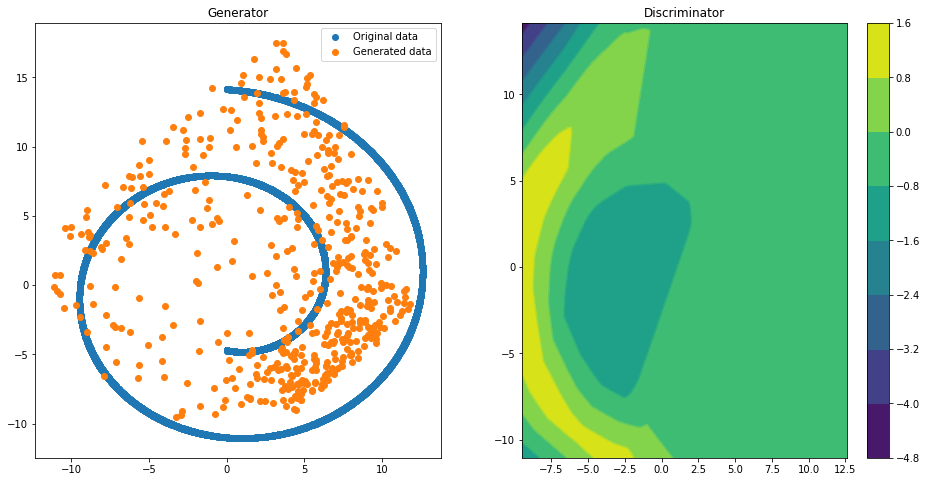

Epoch 150 | ET 4.80 min | Avg Losses >> G/D 0.7855/1.2971 [D-Real: 0.6521 D-Fake: 0.6450]


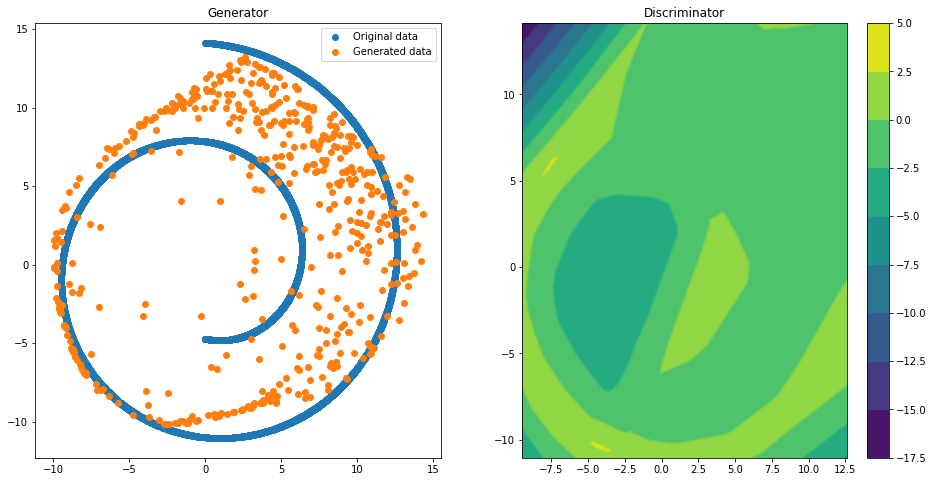

Epoch 200 | ET 6.21 min | Avg Losses >> G/D 0.8613/1.2638 [D-Real: 0.6327 D-Fake: 0.6311]


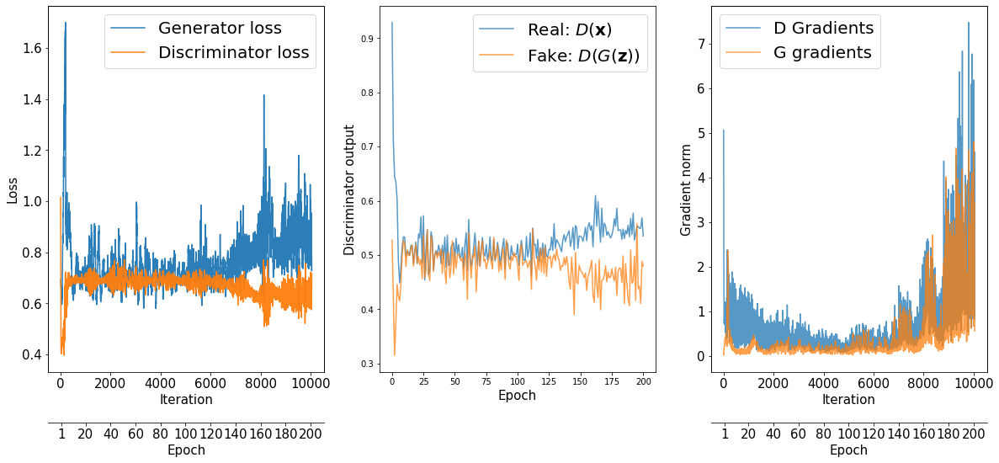

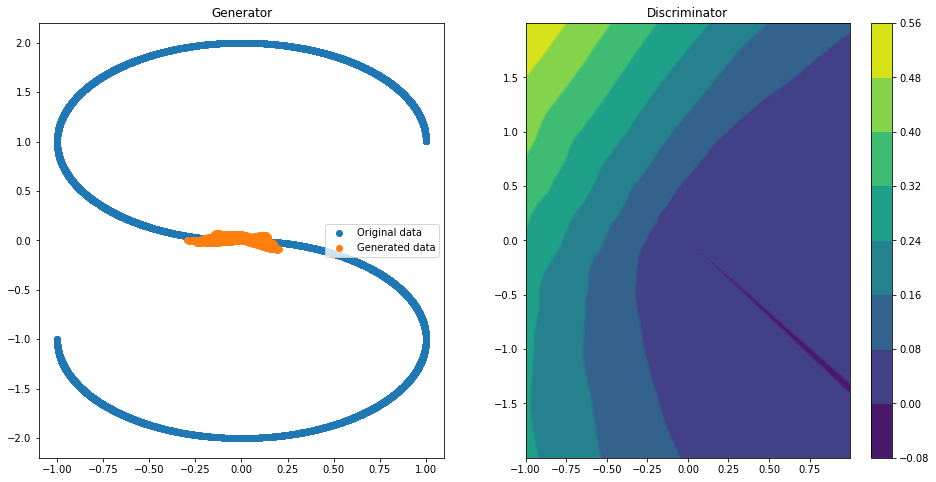

Epoch 000 | ET 0.59 min | Avg Losses >> G/D 0.7117/1.1969 [D-Real: 0.4811 D-Fake: 0.7158]


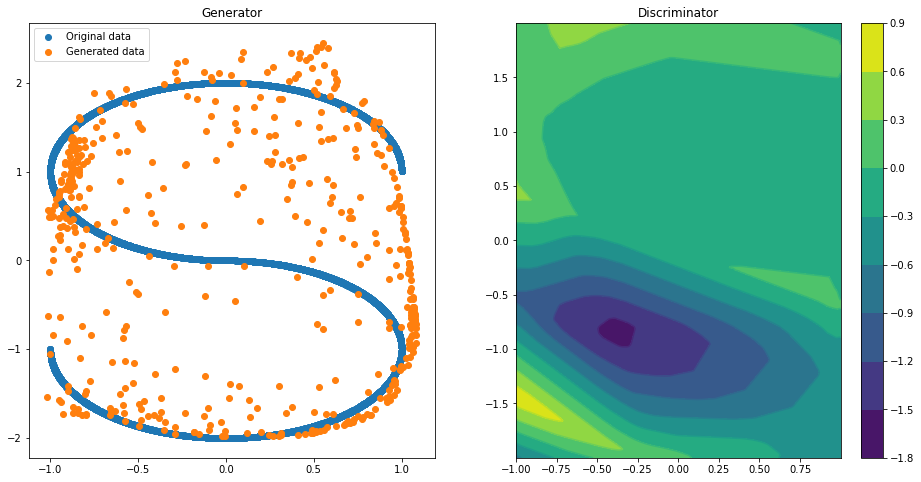

Epoch 050 | ET 2.00 min | Avg Losses >> G/D 0.7407/1.3393 [D-Real: 0.6697 D-Fake: 0.6696]


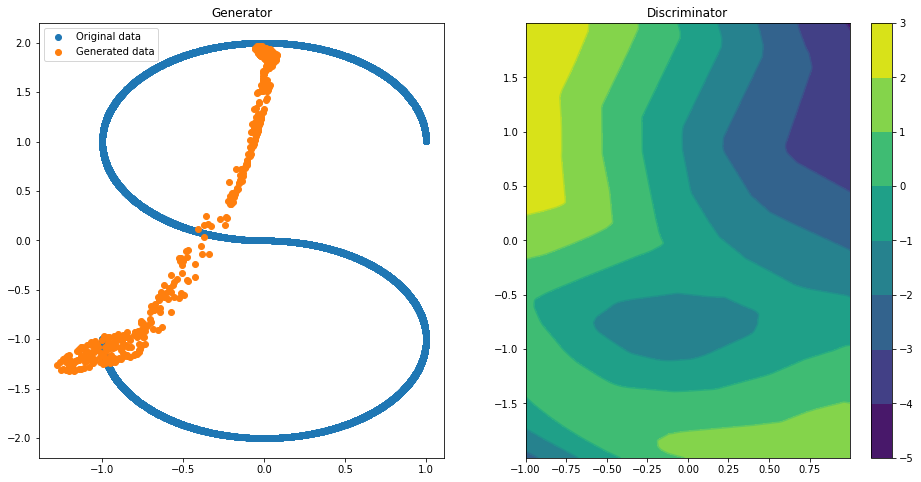

Epoch 100 | ET 3.42 min | Avg Losses >> G/D 1.0465/1.1661 [D-Real: 0.6742 D-Fake: 0.4919]


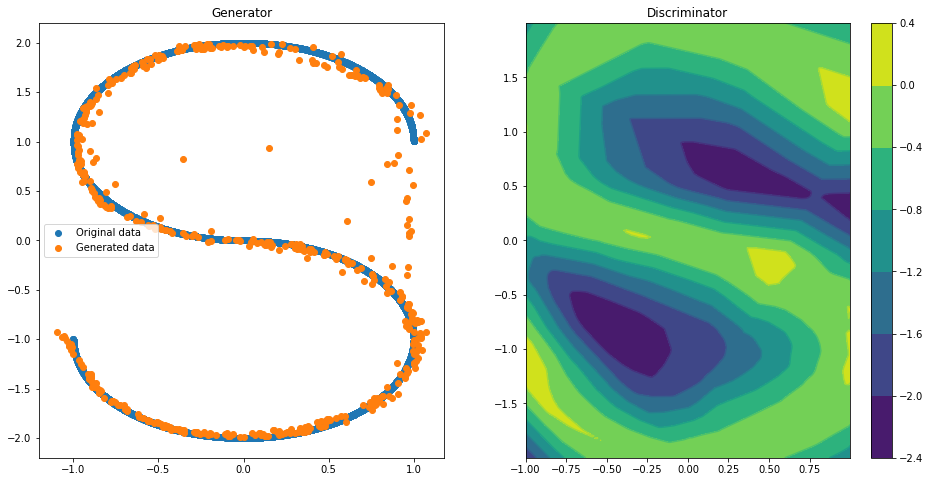

Epoch 150 | ET 4.83 min | Avg Losses >> G/D 0.7176/1.3695 [D-Real: 0.6826 D-Fake: 0.6869]


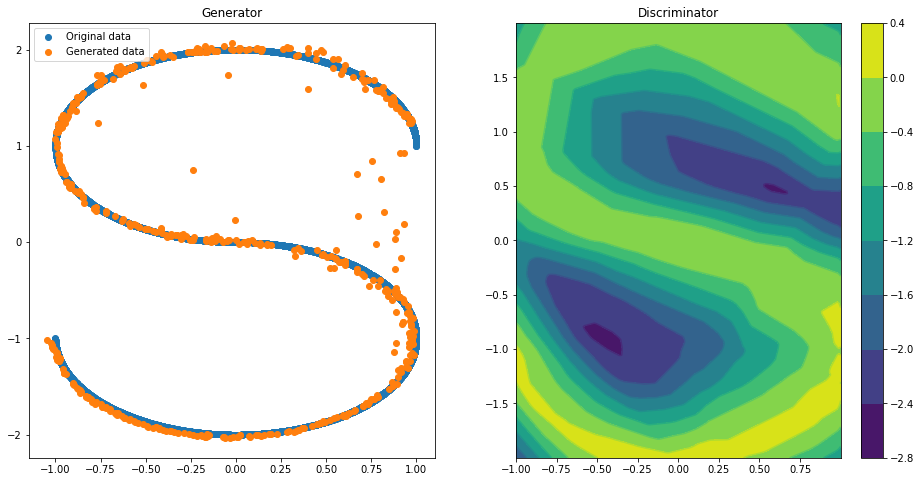

Epoch 200 | ET 6.28 min | Avg Losses >> G/D 0.7051/1.3772 [D-Real: 0.6874 D-Fake: 0.6898]


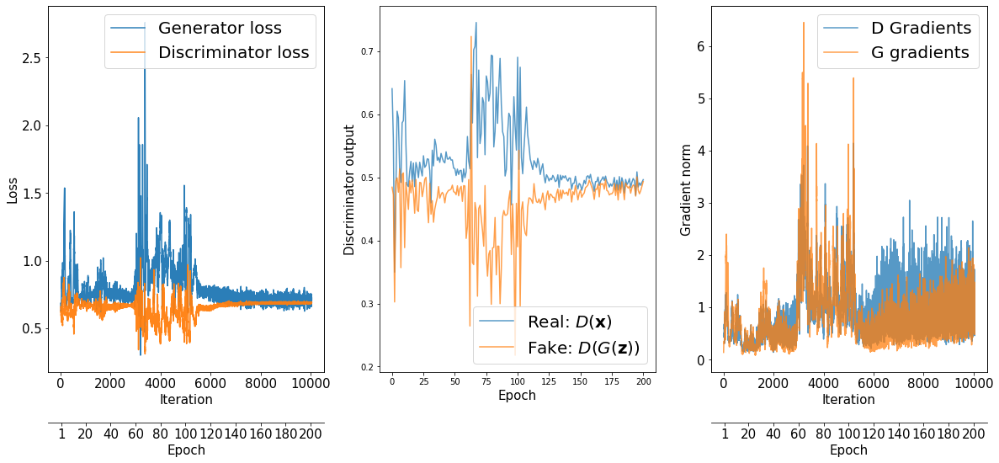

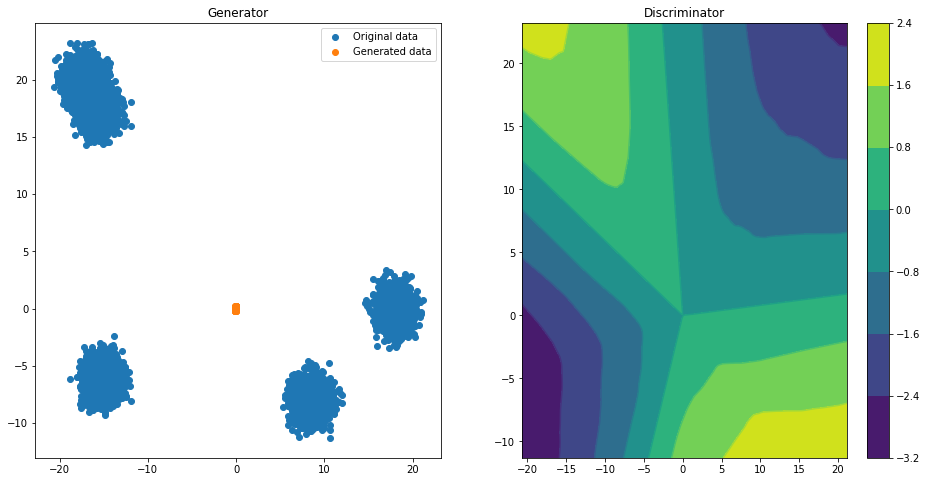

Epoch 000 | ET 0.58 min | Avg Losses >> G/D 0.6965/0.7760 [D-Real: 0.0796 D-Fake: 0.6964]


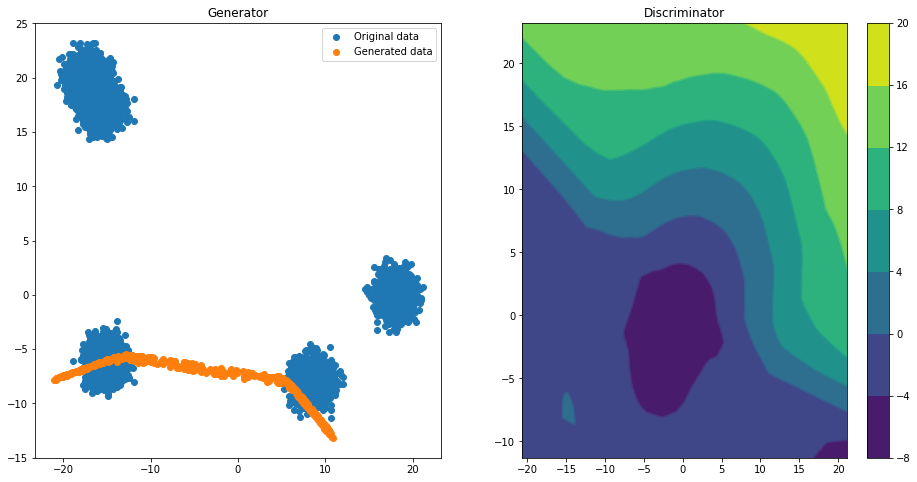

Epoch 050 | ET 1.99 min | Avg Losses >> G/D 2.0653/0.6768 [D-Real: 0.3907 D-Fake: 0.2860]


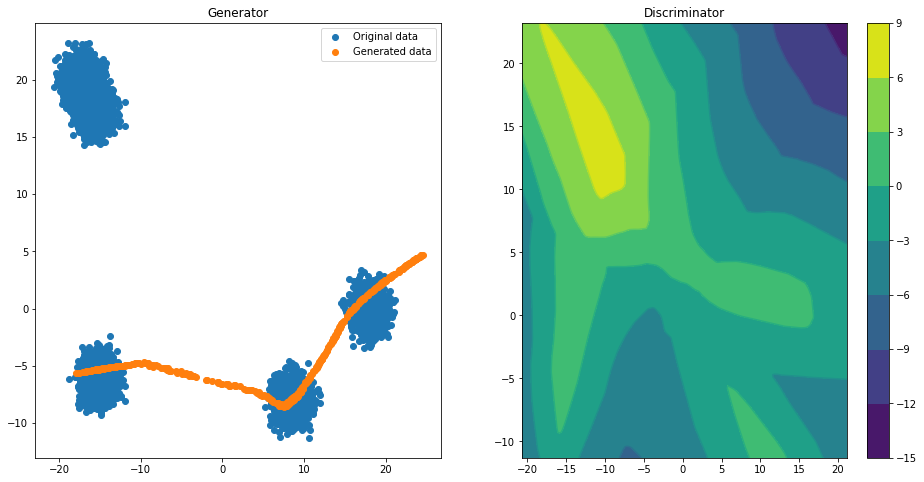

Epoch 100 | ET 3.40 min | Avg Losses >> G/D 1.5488/0.8513 [D-Real: 0.4212 D-Fake: 0.4301]


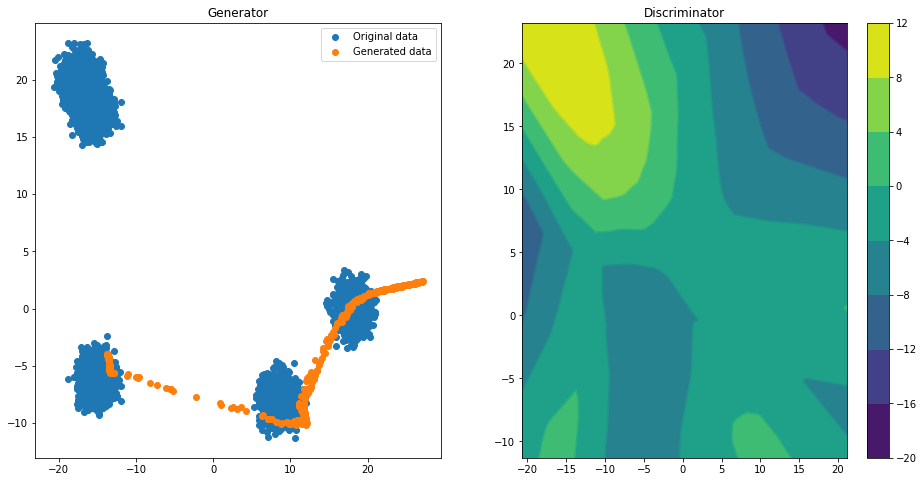

Epoch 150 | ET 4.77 min | Avg Losses >> G/D 1.2480/1.0865 [D-Real: 0.6080 D-Fake: 0.4785]


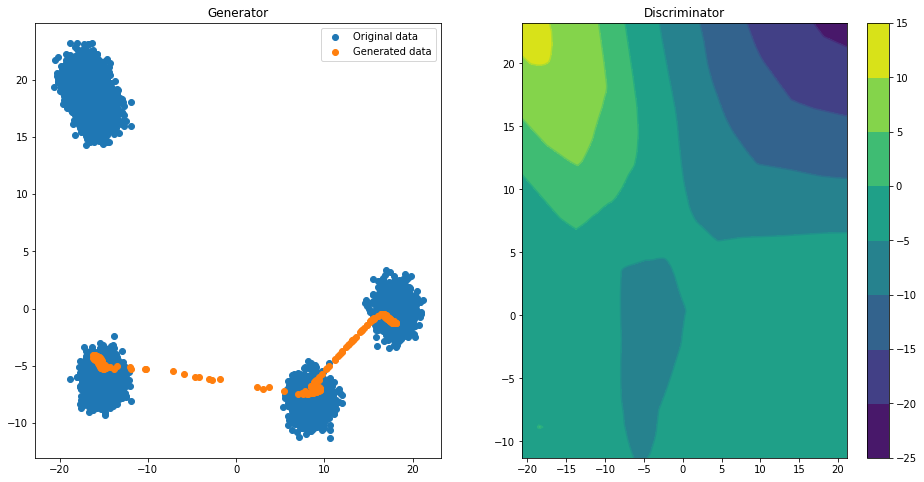

Epoch 200 | ET 6.15 min | Avg Losses >> G/D 1.0590/1.0511 [D-Real: 0.5742 D-Fake: 0.4769]


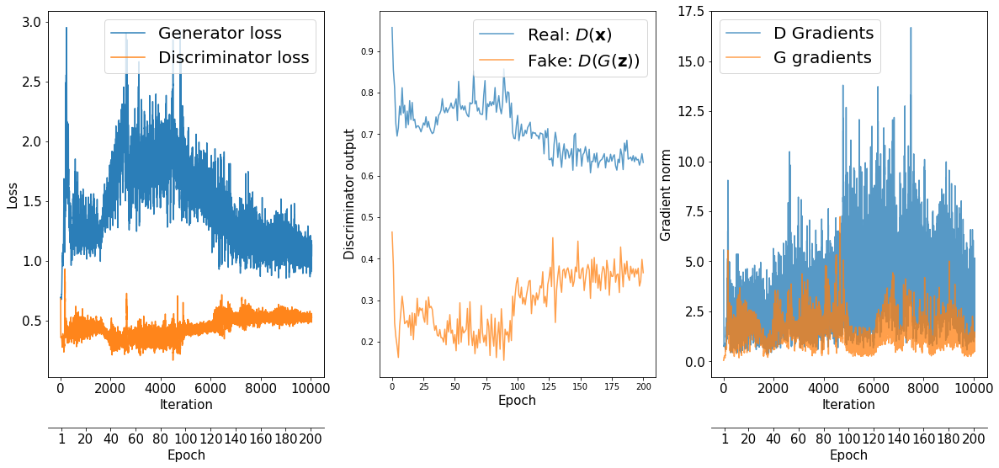

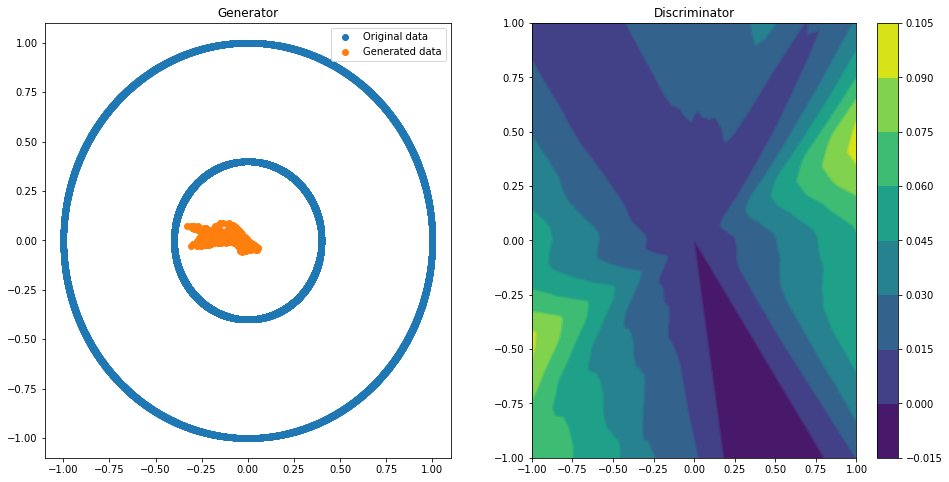

Epoch 000 | ET 0.58 min | Avg Losses >> G/D 0.6760/1.3796 [D-Real: 0.6639 D-Fake: 0.7157]


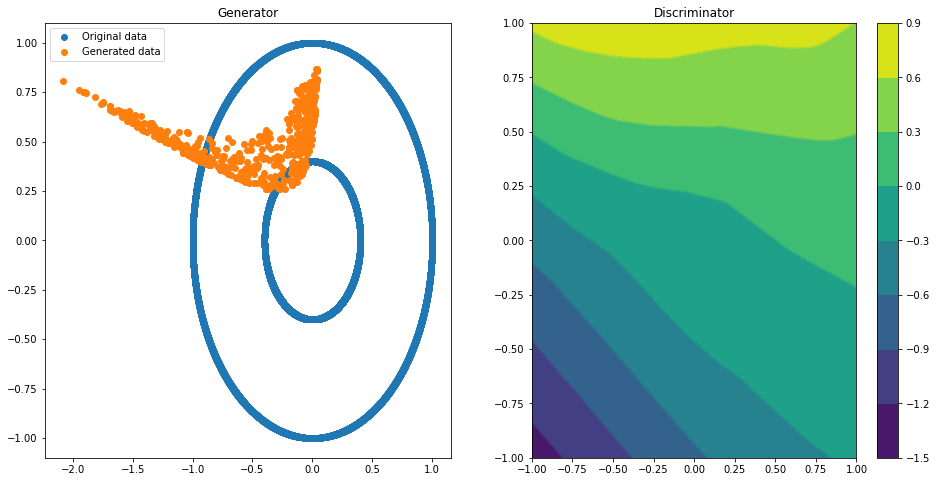

Epoch 050 | ET 1.95 min | Avg Losses >> G/D 0.8088/1.3506 [D-Real: 0.7342 D-Fake: 0.6164]


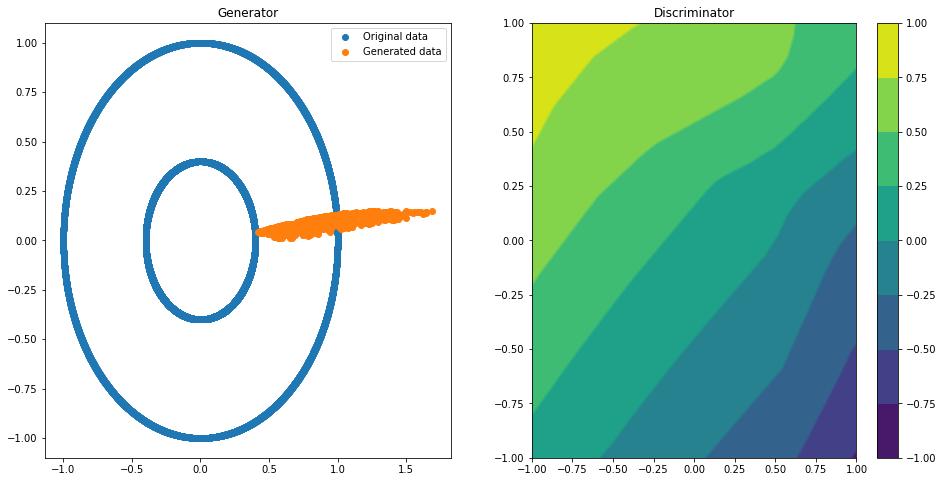

Epoch 100 | ET 3.29 min | Avg Losses >> G/D 0.7312/1.2684 [D-Real: 0.6042 D-Fake: 0.6642]


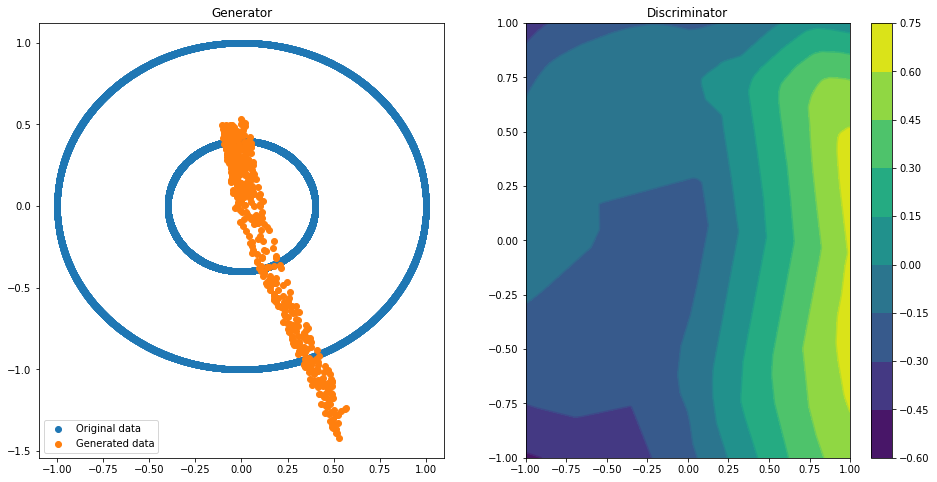

Epoch 150 | ET 4.69 min | Avg Losses >> G/D 0.7180/1.3715 [D-Real: 0.6936 D-Fake: 0.6779]


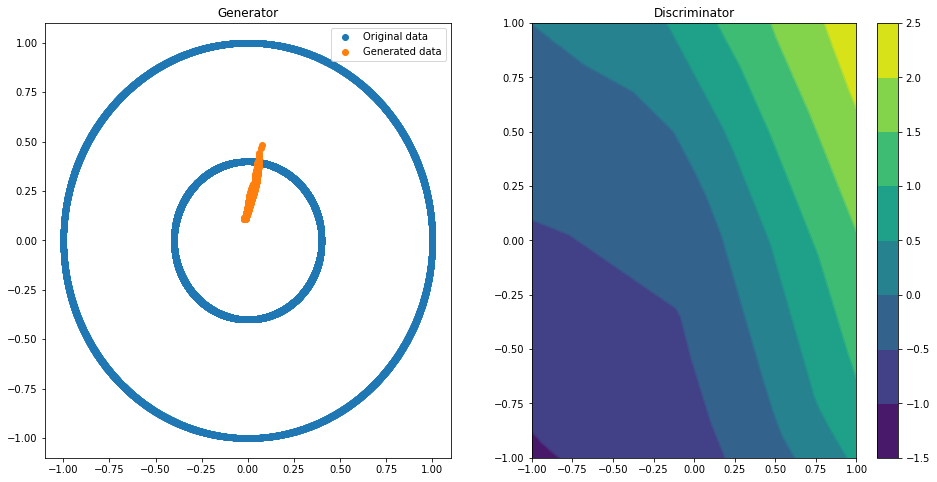

Epoch 200 | ET 6.03 min | Avg Losses >> G/D 0.7549/1.4784 [D-Real: 0.7967 D-Fake: 0.6817]


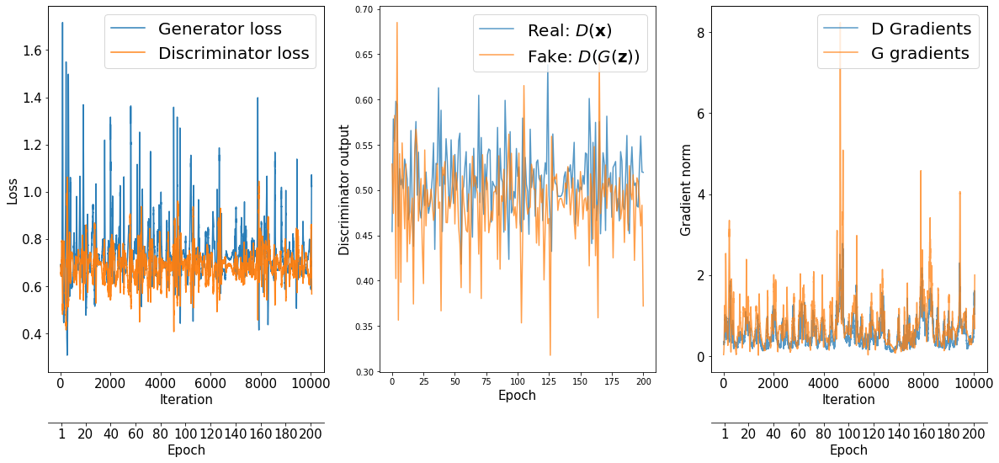

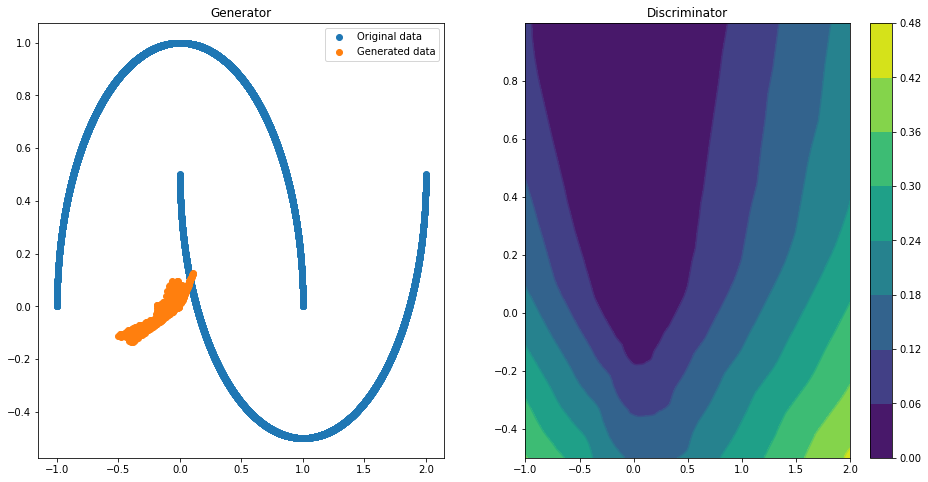

Epoch 000 | ET 0.58 min | Avg Losses >> G/D 0.6380/1.2770 [D-Real: 0.4855 D-Fake: 0.7915]


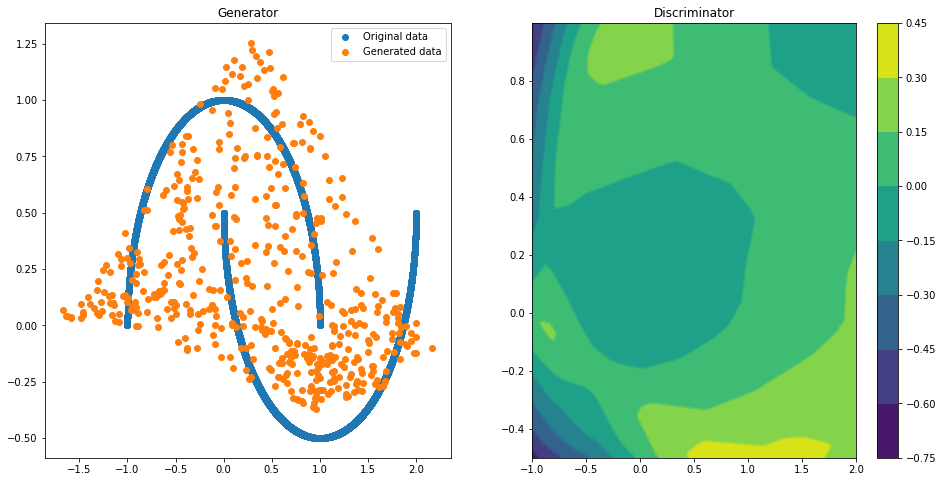

Epoch 050 | ET 1.93 min | Avg Losses >> G/D 0.6957/1.3585 [D-Real: 0.6616 D-Fake: 0.6969]


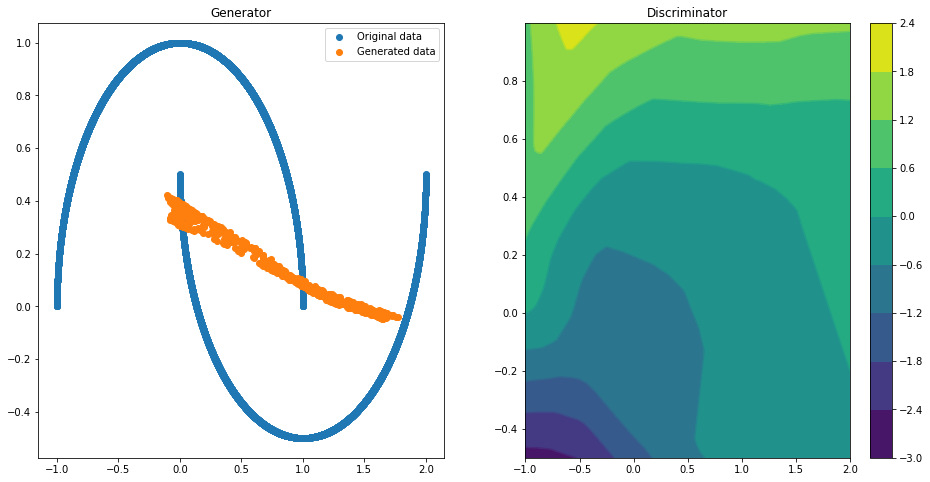

Epoch 100 | ET 3.27 min | Avg Losses >> G/D 0.8274/1.3316 [D-Real: 0.6960 D-Fake: 0.6357]


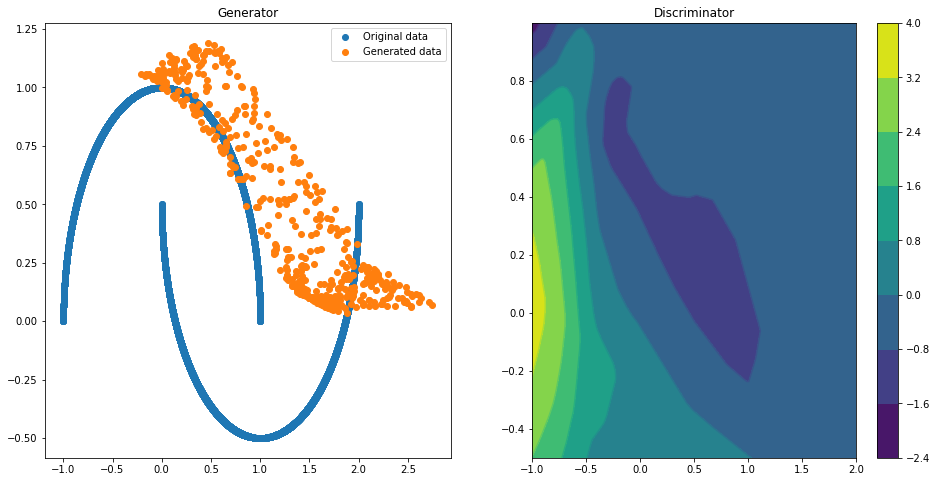

Epoch 150 | ET 4.62 min | Avg Losses >> G/D 1.0536/1.0947 [D-Real: 0.6373 D-Fake: 0.4573]


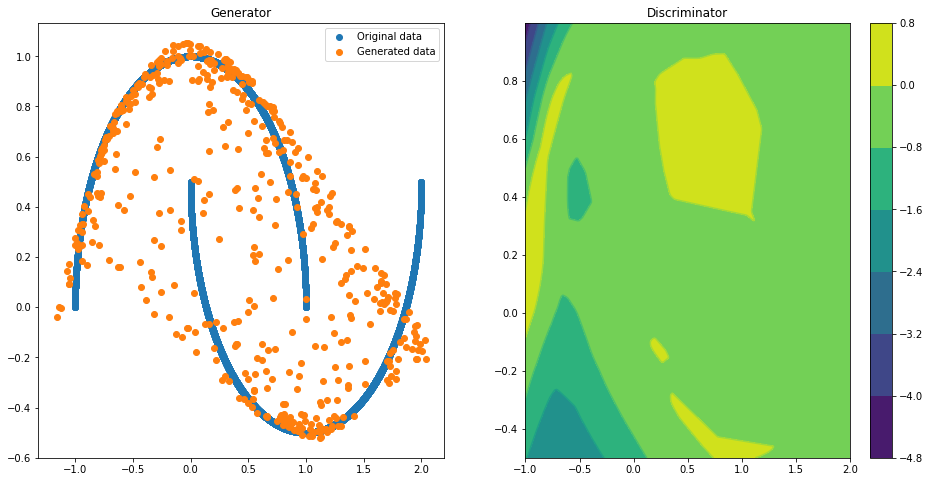

Epoch 200 | ET 5.96 min | Avg Losses >> G/D 0.7089/1.3683 [D-Real: 0.6822 D-Fake: 0.6862]


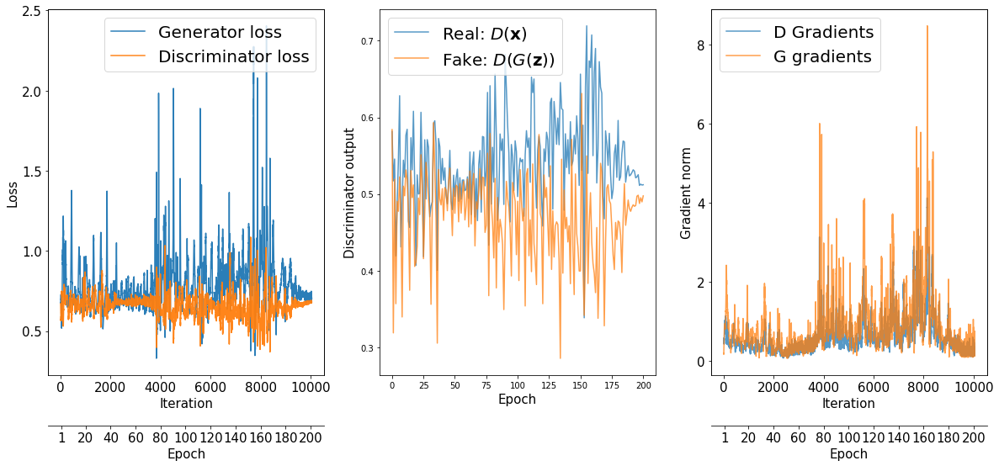

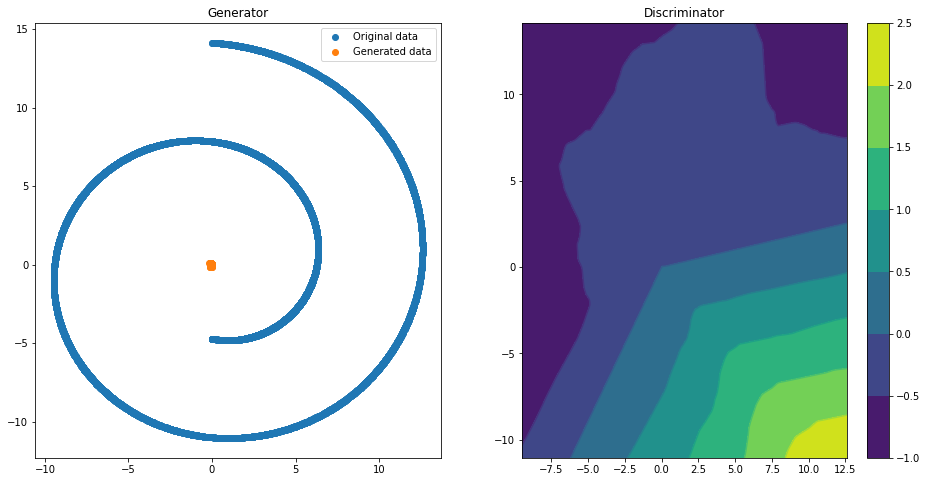

Epoch 000 | ET 0.58 min | Avg Losses >> G/D 0.6839/0.8479 [D-Real: 0.1396 D-Fake: 0.7083]


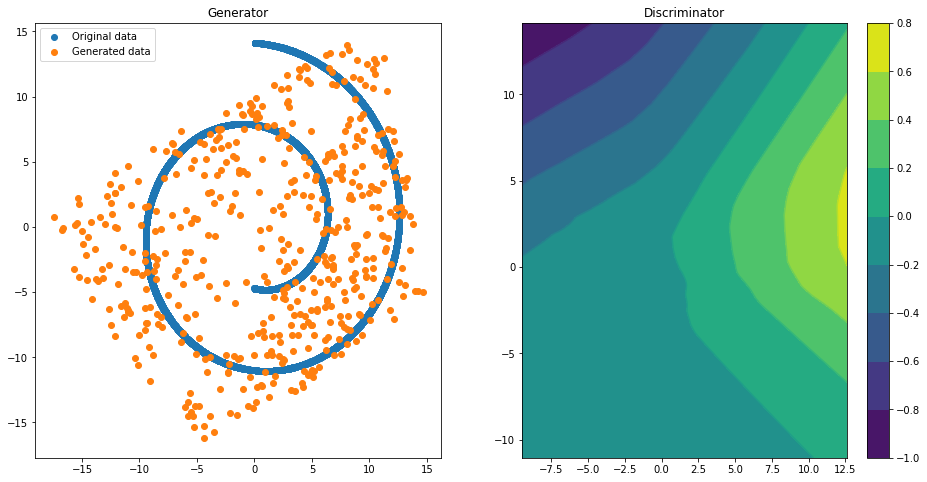

Epoch 050 | ET 1.91 min | Avg Losses >> G/D 0.7235/1.3873 [D-Real: 0.7147 D-Fake: 0.6726]


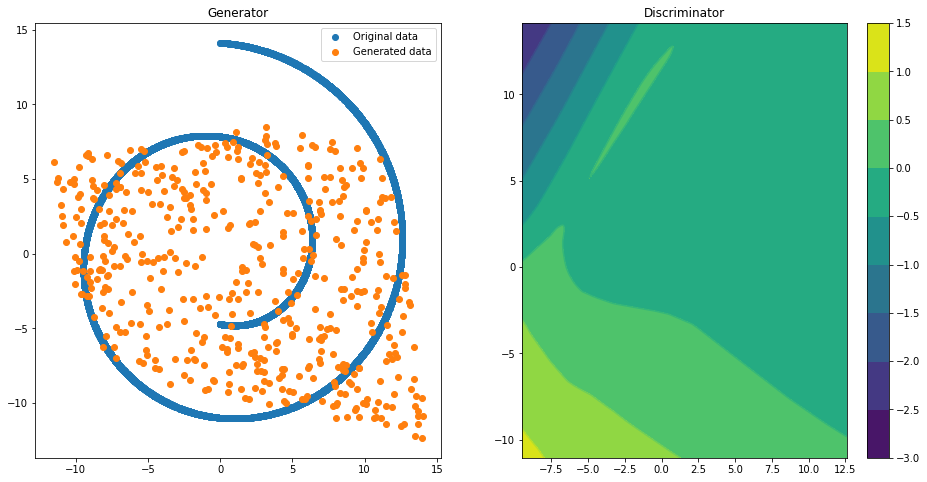

Epoch 100 | ET 3.22 min | Avg Losses >> G/D 0.7146/1.3577 [D-Real: 0.6574 D-Fake: 0.7003]


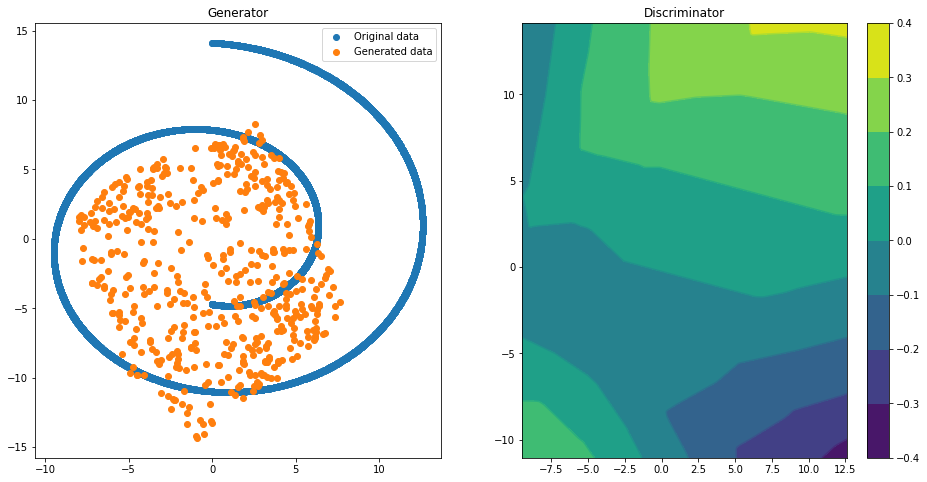

Epoch 150 | ET 4.55 min | Avg Losses >> G/D 0.7188/1.3357 [D-Real: 0.6568 D-Fake: 0.6788]


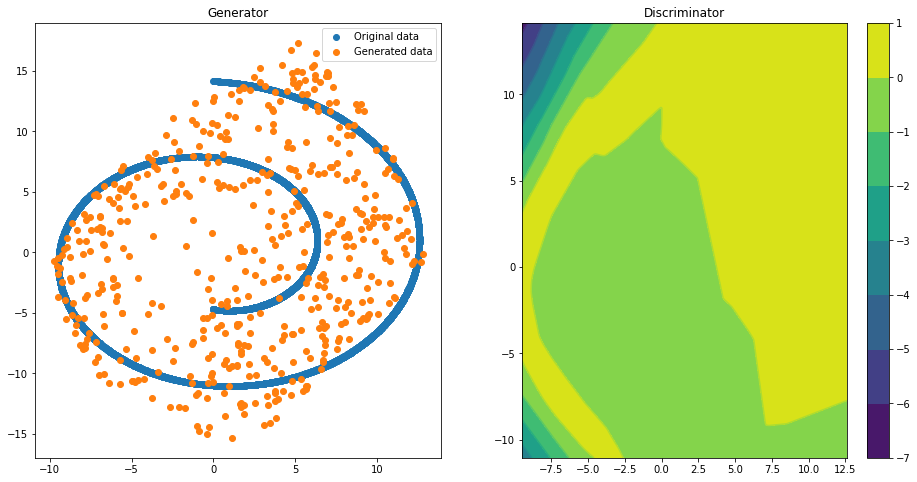

Epoch 200 | ET 5.88 min | Avg Losses >> G/D 0.7478/1.3262 [D-Real: 0.6634 D-Fake: 0.6628]


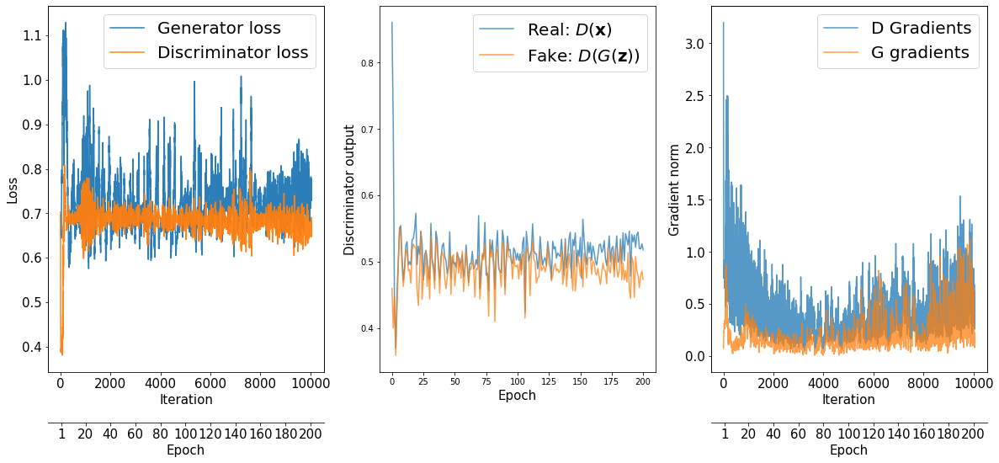

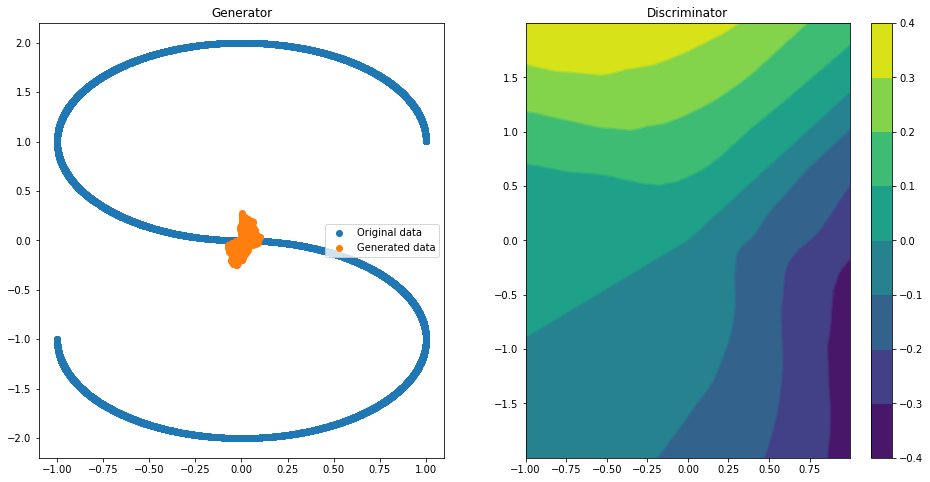

Epoch 000 | ET 0.58 min | Avg Losses >> G/D 0.7387/1.2373 [D-Real: 0.5719 D-Fake: 0.6654]


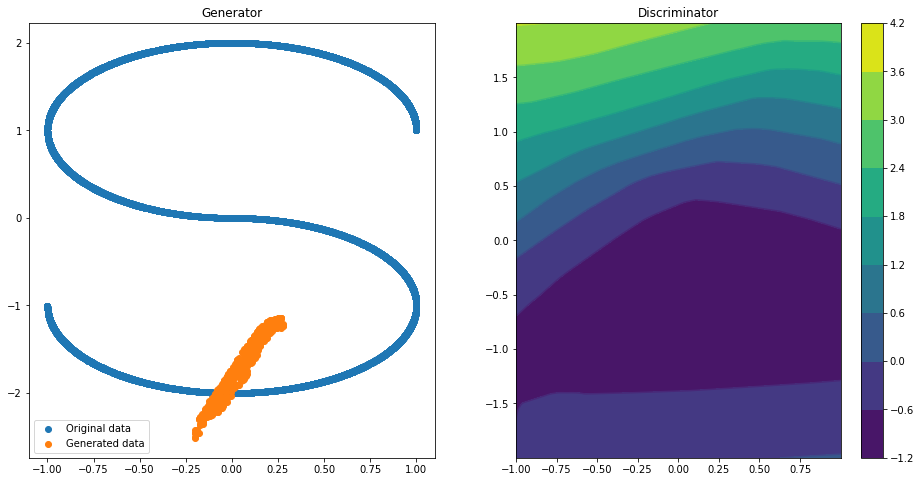

Epoch 050 | ET 1.91 min | Avg Losses >> G/D 1.2696/0.9887 [D-Real: 0.6373 D-Fake: 0.3514]


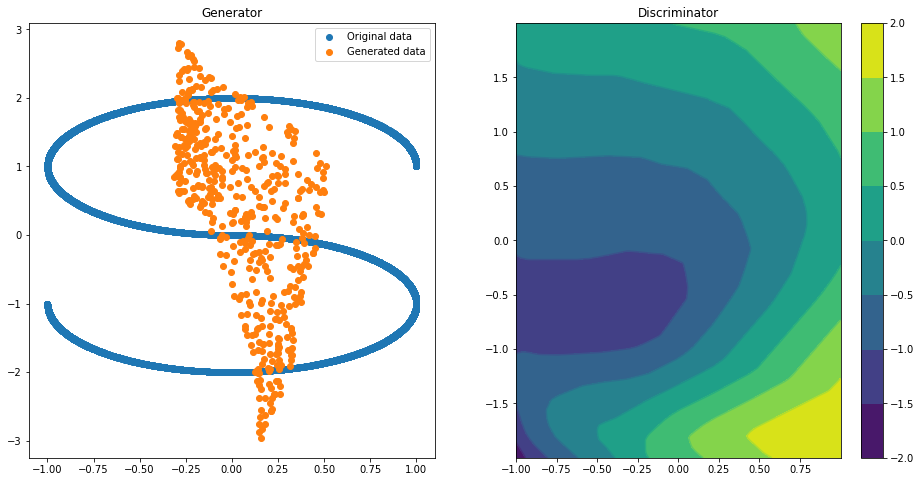

Epoch 100 | ET 3.24 min | Avg Losses >> G/D 0.8404/1.3541 [D-Real: 0.7297 D-Fake: 0.6244]


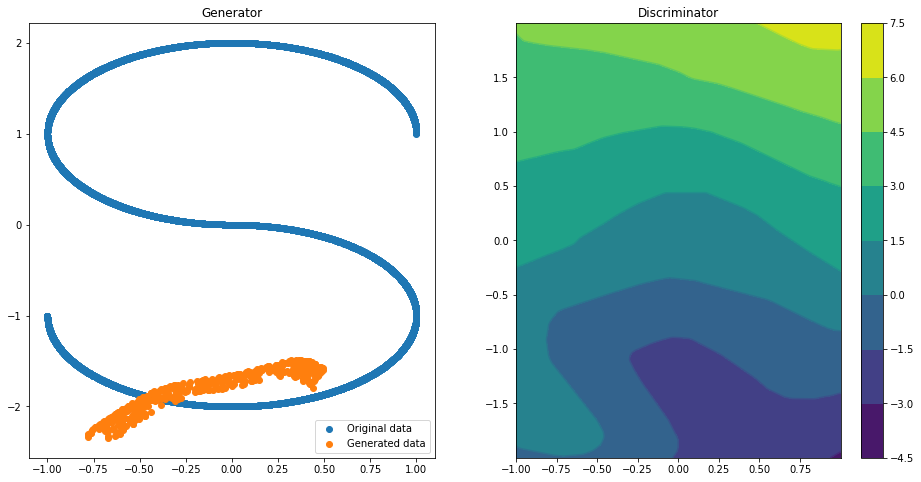

Epoch 150 | ET 4.58 min | Avg Losses >> G/D 1.0510/1.0788 [D-Real: 0.4267 D-Fake: 0.6521]


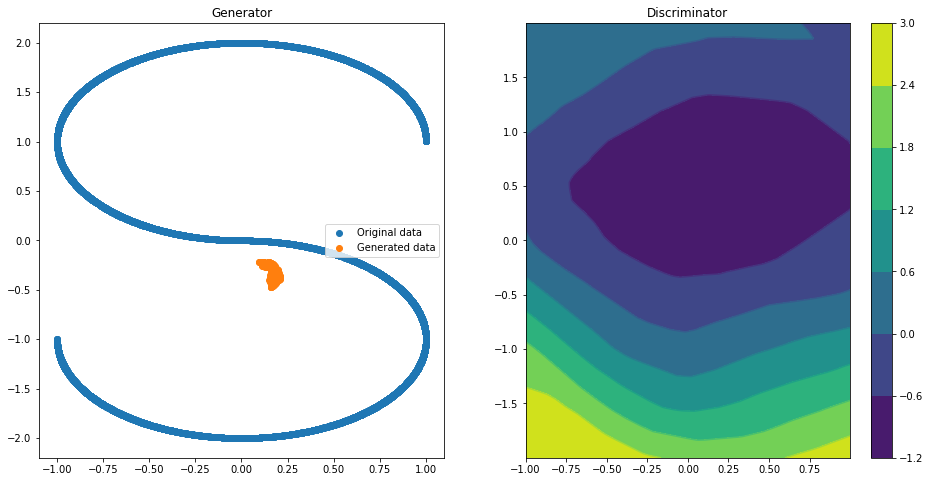

Epoch 200 | ET 5.93 min | Avg Losses >> G/D 1.1580/0.8773 [D-Real: 0.4976 D-Fake: 0.3797]


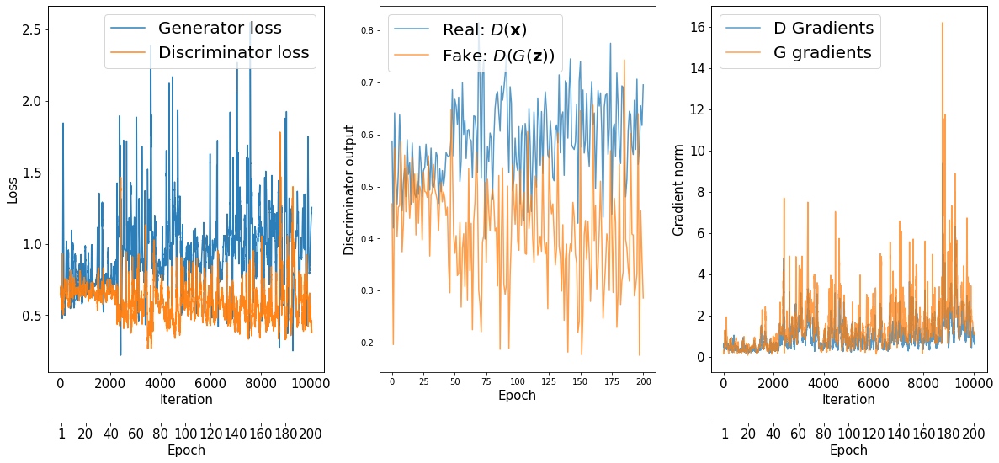

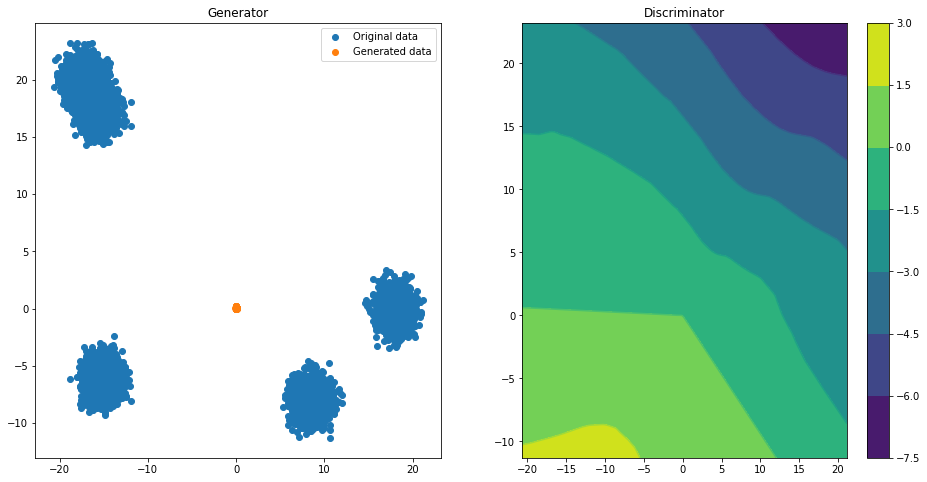

Epoch 000 | ET 0.58 min | Avg Losses >> G/D 0.7246/0.8125 [D-Real: 0.1458 D-Fake: 0.6667]


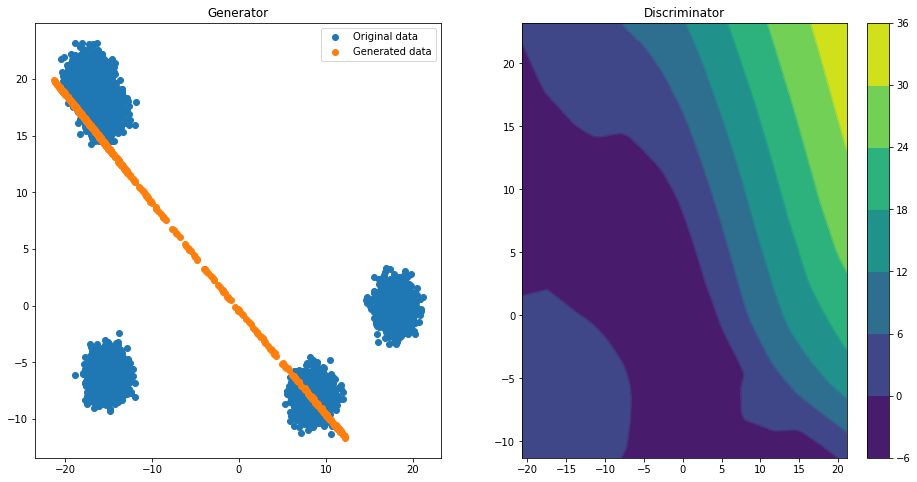

Epoch 050 | ET 1.99 min | Avg Losses >> G/D 1.6386/0.9374 [D-Real: 0.5312 D-Fake: 0.4062]


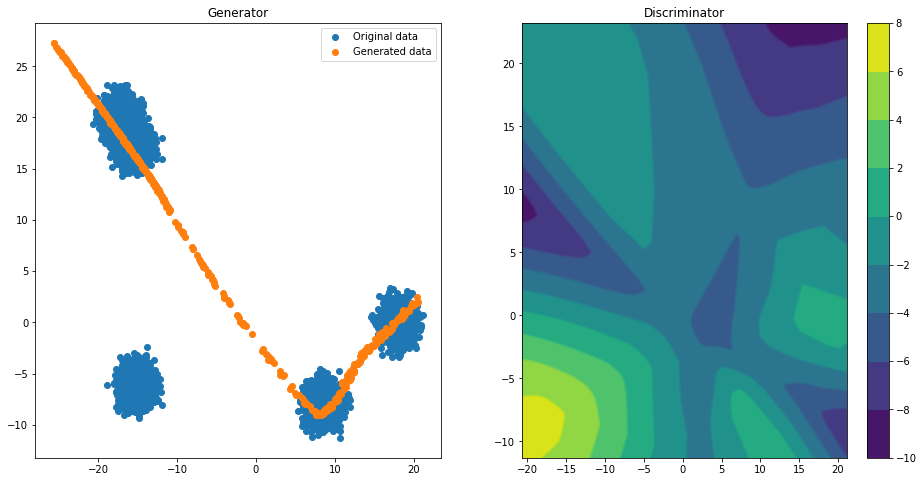

Epoch 100 | ET 3.34 min | Avg Losses >> G/D 1.2594/0.9951 [D-Real: 0.5018 D-Fake: 0.4933]


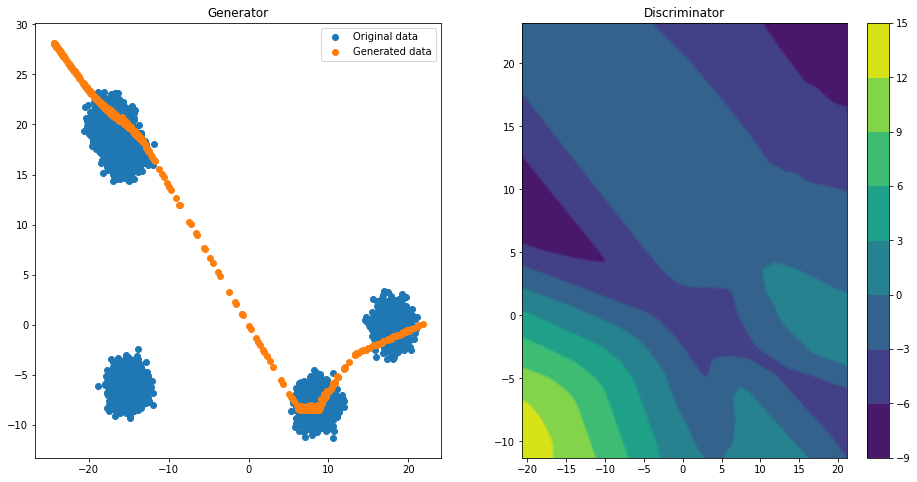

Epoch 150 | ET 4.69 min | Avg Losses >> G/D 1.0904/1.1564 [D-Real: 0.6171 D-Fake: 0.5393]


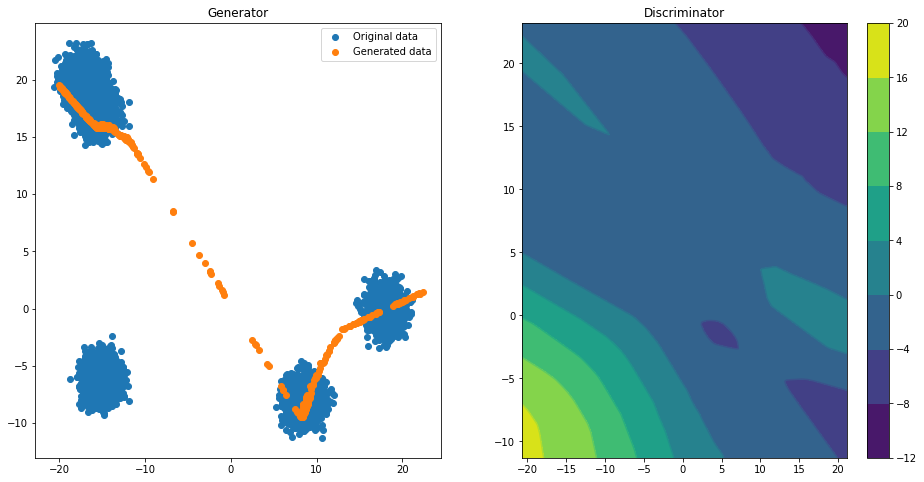

Epoch 200 | ET 6.04 min | Avg Losses >> G/D 1.0000/1.1675 [D-Real: 0.6200 D-Fake: 0.5475]


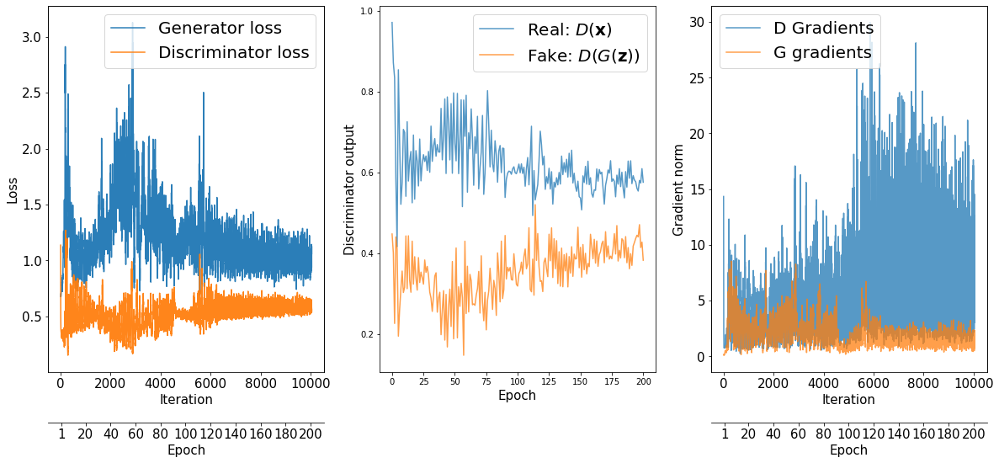

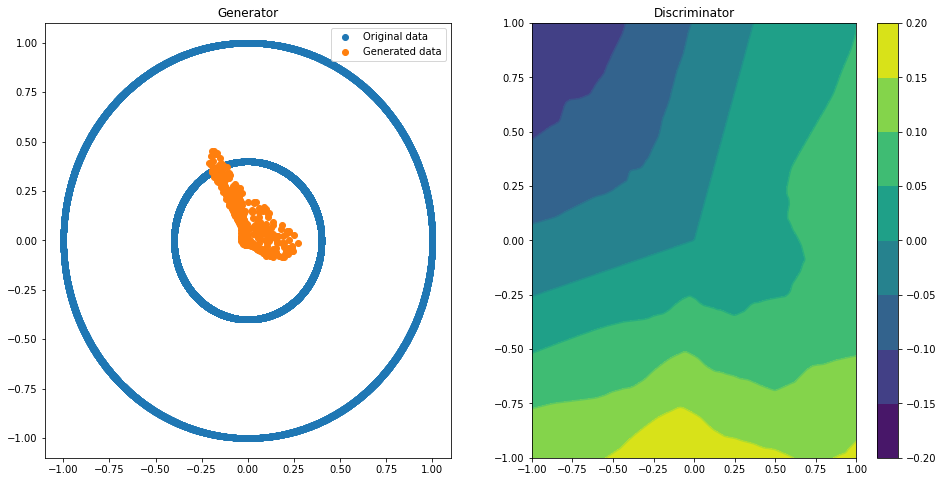

Epoch 000 | ET 0.58 min | Avg Losses >> G/D 0.6666/1.3715 [D-Real: 0.6268 D-Fake: 0.7446]


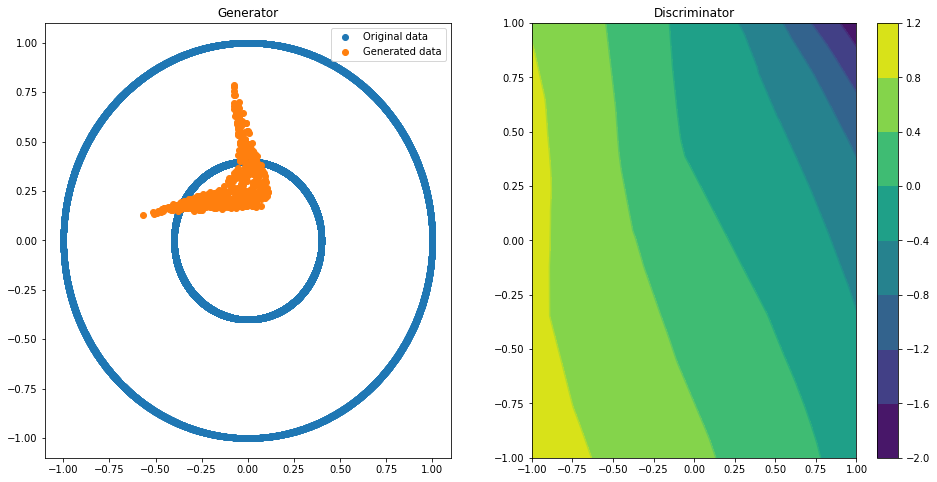

Epoch 050 | ET 1.95 min | Avg Losses >> G/D 0.6255/1.4006 [D-Real: 0.6220 D-Fake: 0.7786]


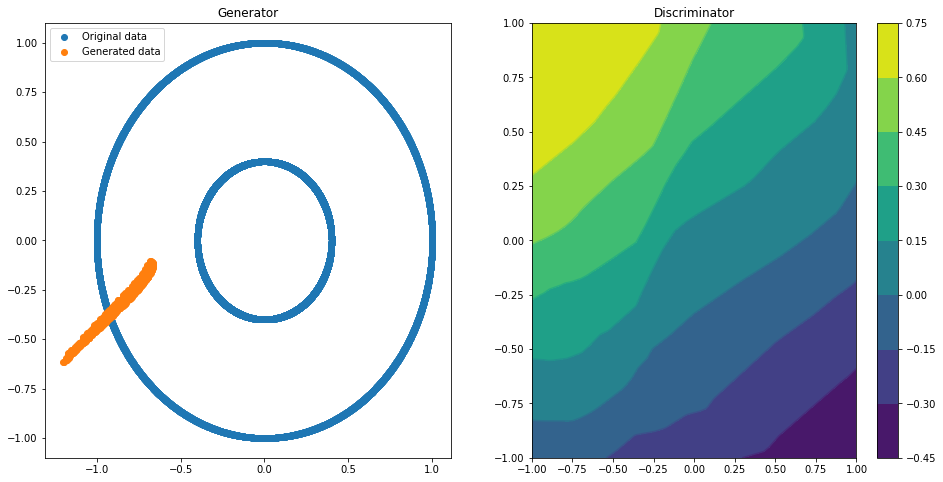

Epoch 100 | ET 3.32 min | Avg Losses >> G/D 0.6745/1.2700 [D-Real: 0.5546 D-Fake: 0.7154]


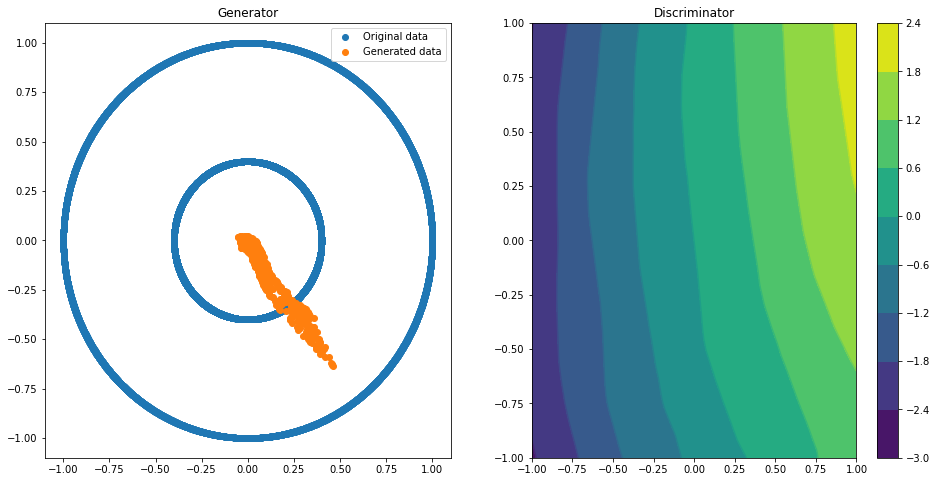

Epoch 150 | ET 4.68 min | Avg Losses >> G/D 0.6858/1.6379 [D-Real: 0.8680 D-Fake: 0.7699]


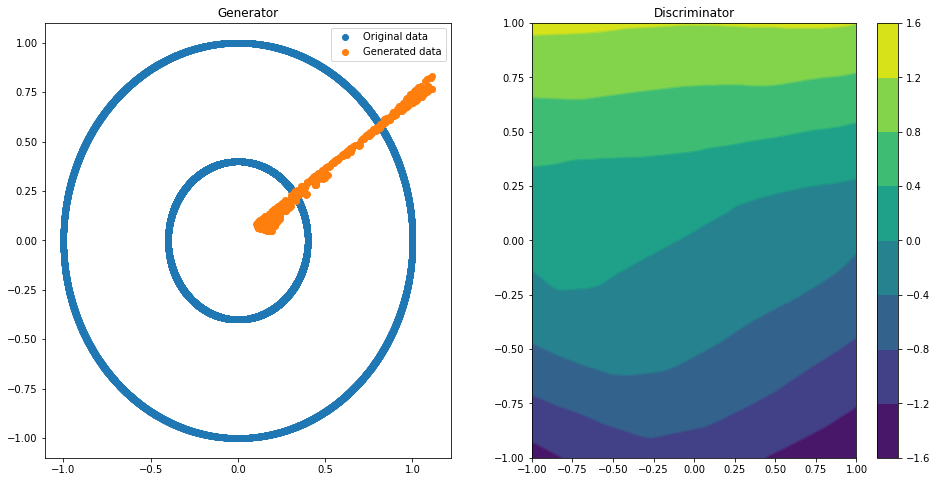

Epoch 200 | ET 6.11 min | Avg Losses >> G/D 0.7486/1.4426 [D-Real: 0.7835 D-Fake: 0.6591]


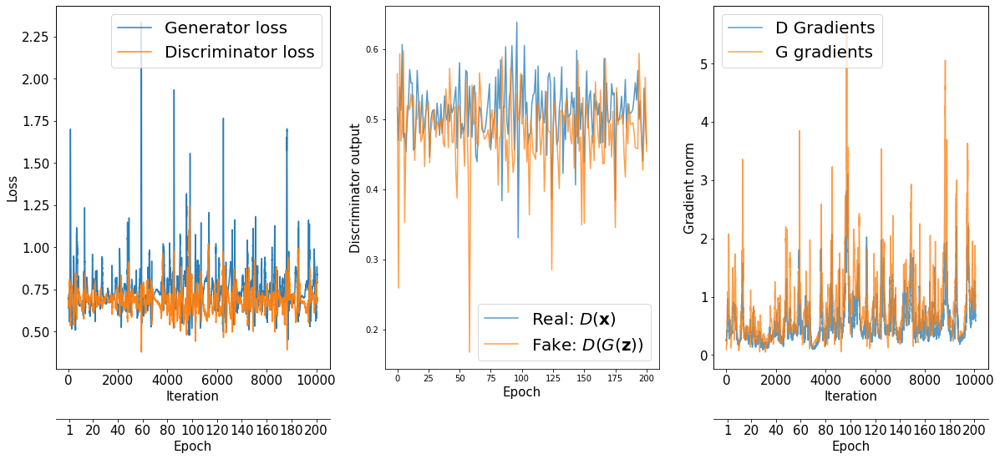

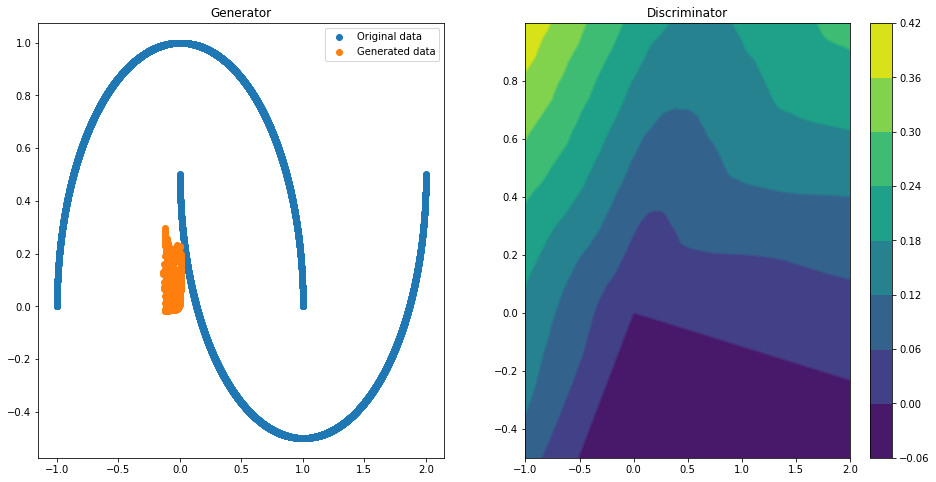

Epoch 000 | ET 0.58 min | Avg Losses >> G/D 0.7399/1.2043 [D-Real: 0.5441 D-Fake: 0.6602]


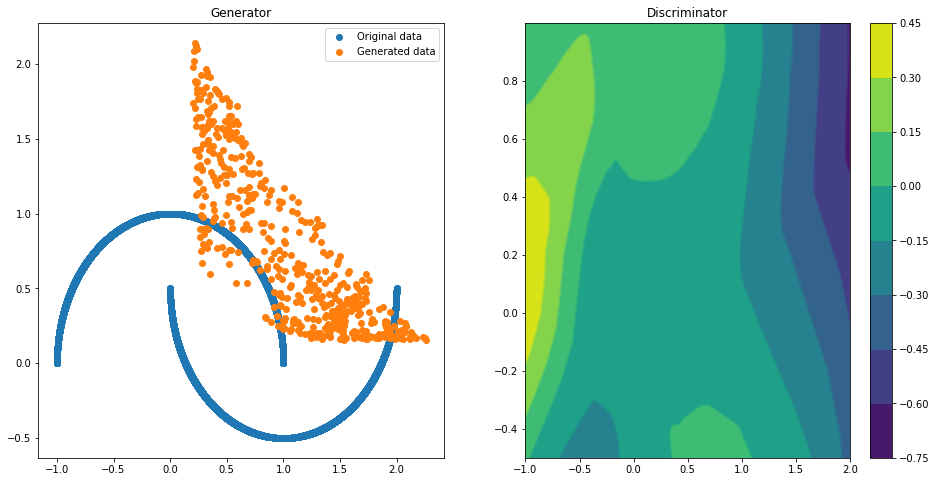

Epoch 050 | ET 1.94 min | Avg Losses >> G/D 0.7721/1.2754 [D-Real: 0.6472 D-Fake: 0.6283]


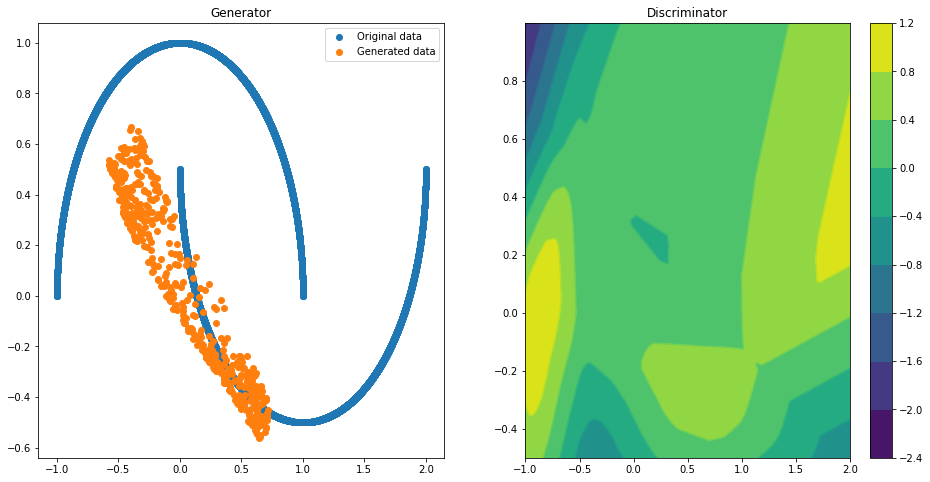

Epoch 100 | ET 3.29 min | Avg Losses >> G/D 0.7742/1.2621 [D-Real: 0.6081 D-Fake: 0.6539]


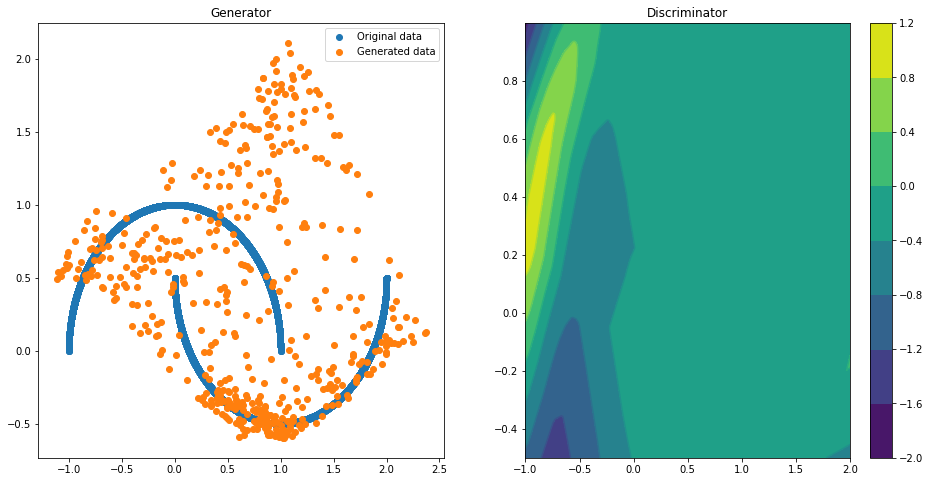

Epoch 150 | ET 4.65 min | Avg Losses >> G/D 0.7532/1.3498 [D-Real: 0.6985 D-Fake: 0.6513]


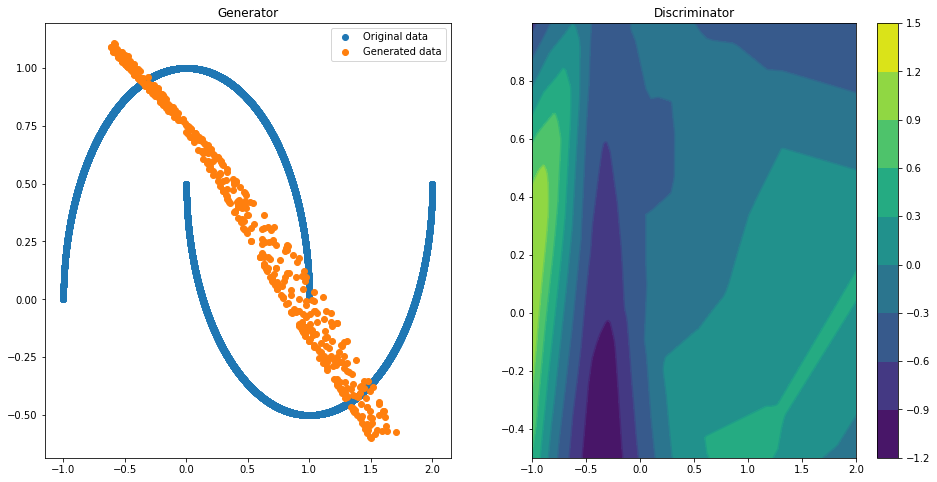

Epoch 200 | ET 6.02 min | Avg Losses >> G/D 0.7661/1.2745 [D-Real: 0.6339 D-Fake: 0.6406]


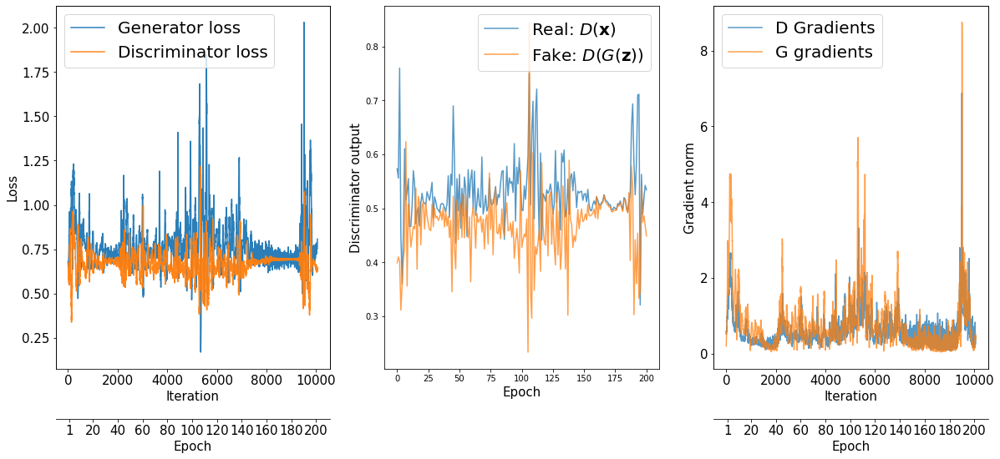

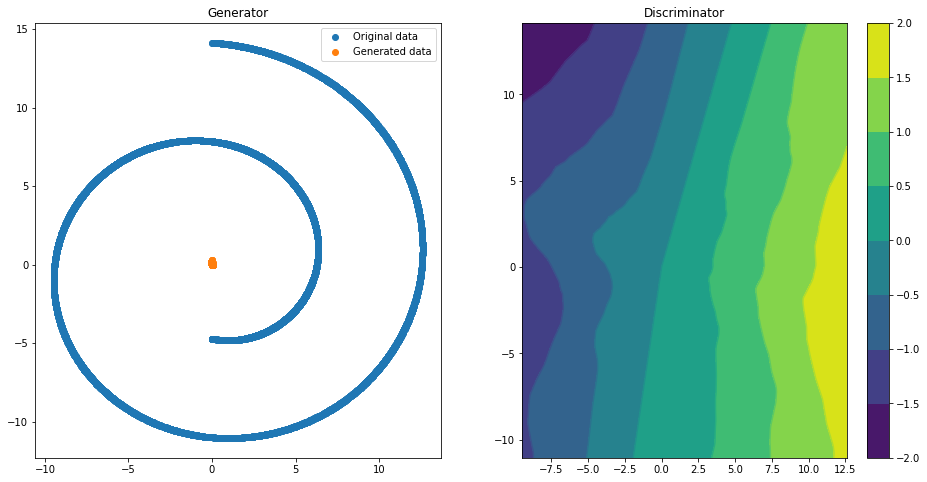

Epoch 000 | ET 0.58 min | Avg Losses >> G/D 0.7434/0.7959 [D-Real: 0.1436 D-Fake: 0.6524]


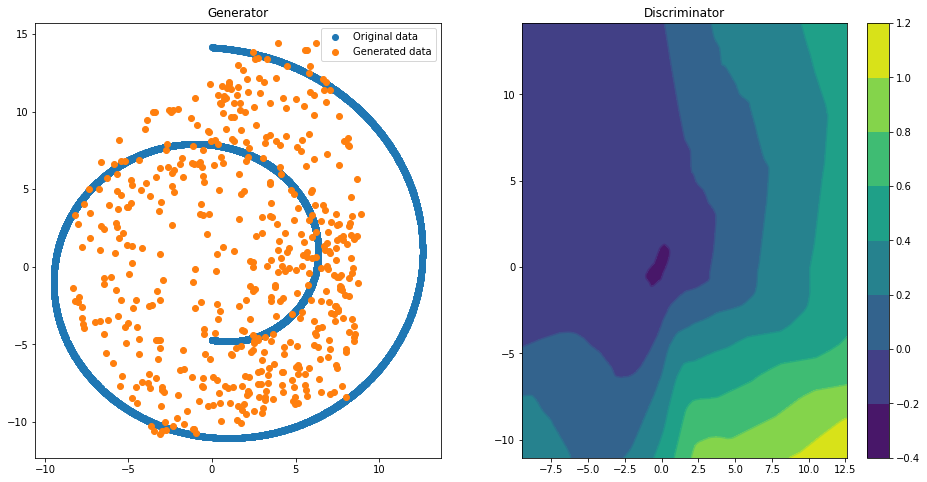

Epoch 050 | ET 1.95 min | Avg Losses >> G/D 0.7358/1.3678 [D-Real: 0.6980 D-Fake: 0.6699]


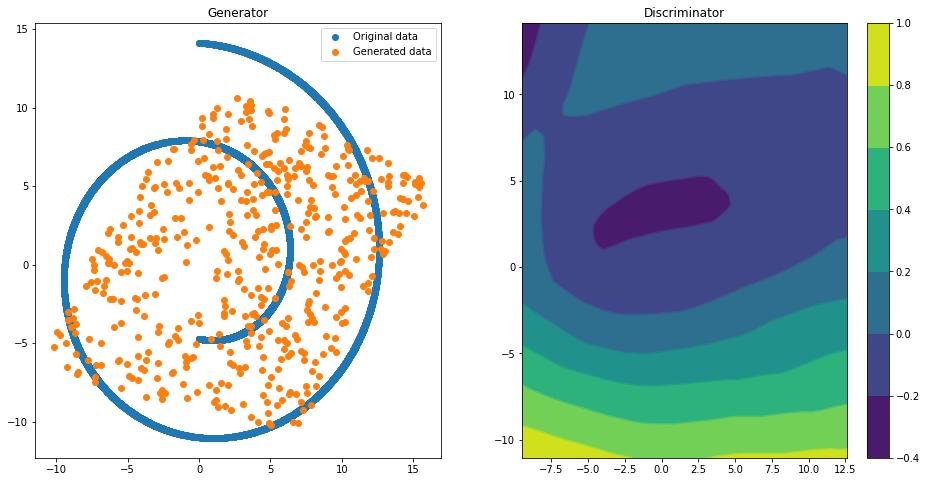

Epoch 100 | ET 3.27 min | Avg Losses >> G/D 0.6852/1.3822 [D-Real: 0.6556 D-Fake: 0.7265]


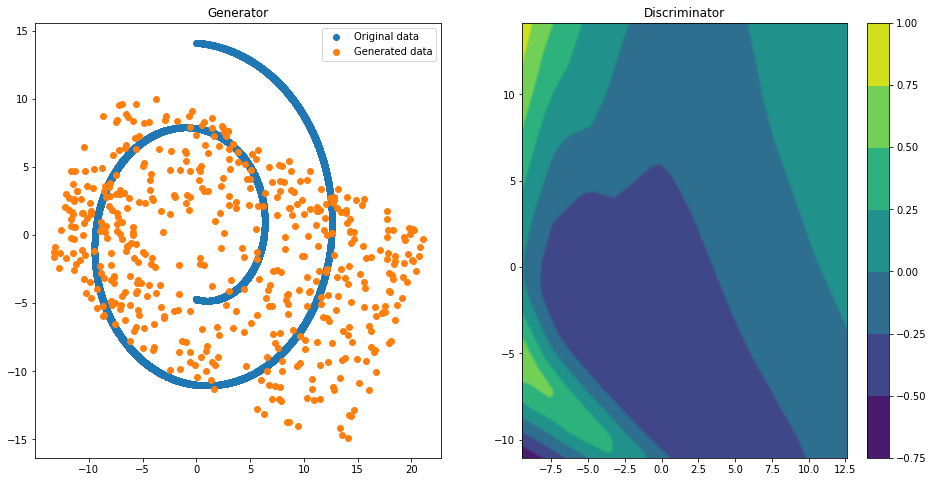

Epoch 150 | ET 4.59 min | Avg Losses >> G/D 0.7787/1.3299 [D-Real: 0.6628 D-Fake: 0.6670]


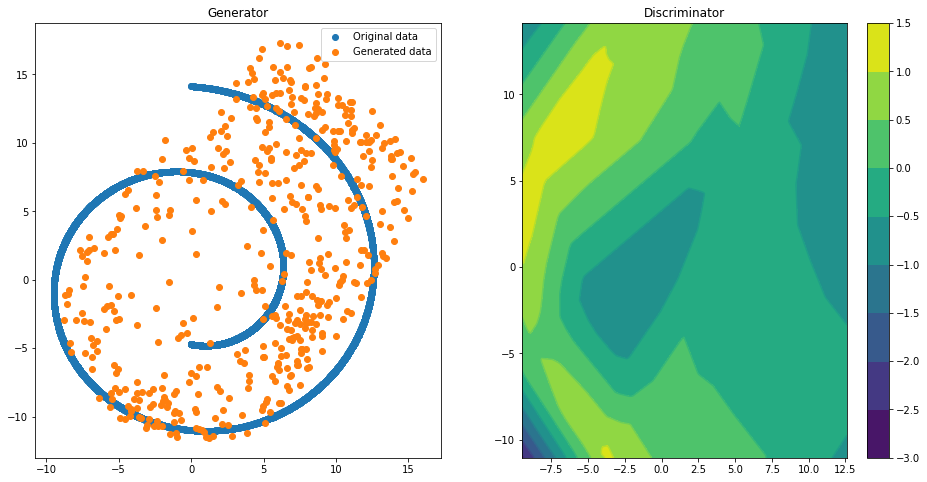

Epoch 200 | ET 5.90 min | Avg Losses >> G/D 0.7325/1.3604 [D-Real: 0.6690 D-Fake: 0.6914]


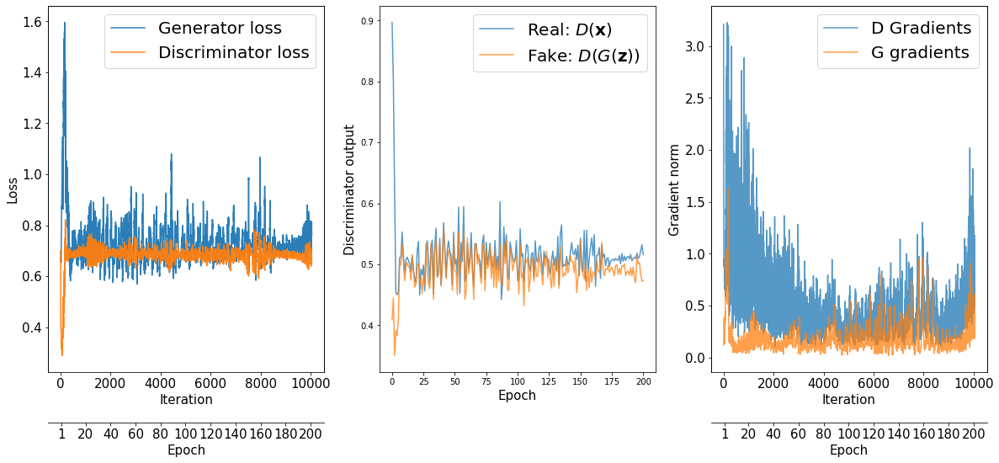

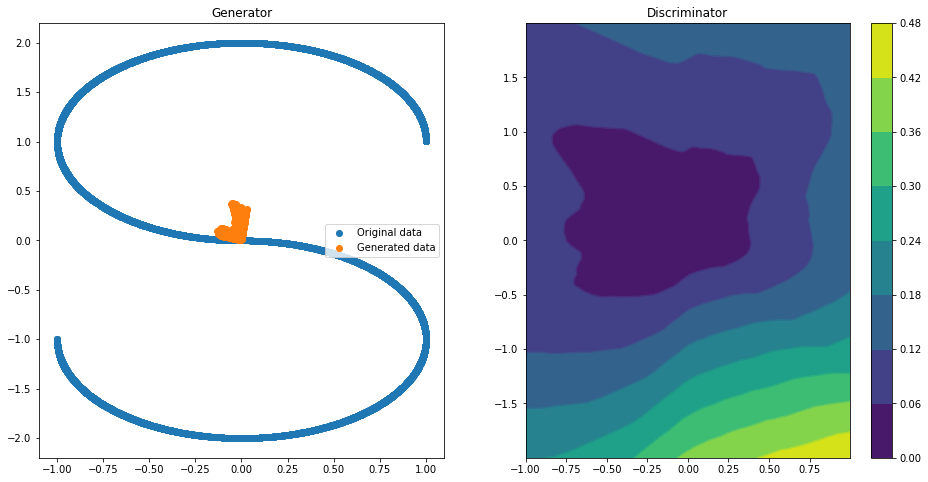

Epoch 000 | ET 0.58 min | Avg Losses >> G/D 0.7103/1.2079 [D-Real: 0.5200 D-Fake: 0.6879]


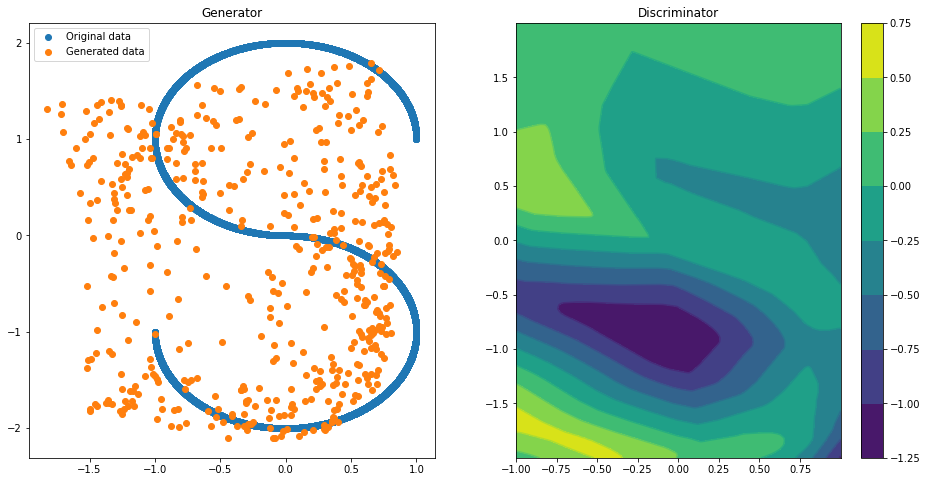

Epoch 050 | ET 1.89 min | Avg Losses >> G/D 0.7827/1.2913 [D-Real: 0.6376 D-Fake: 0.6537]


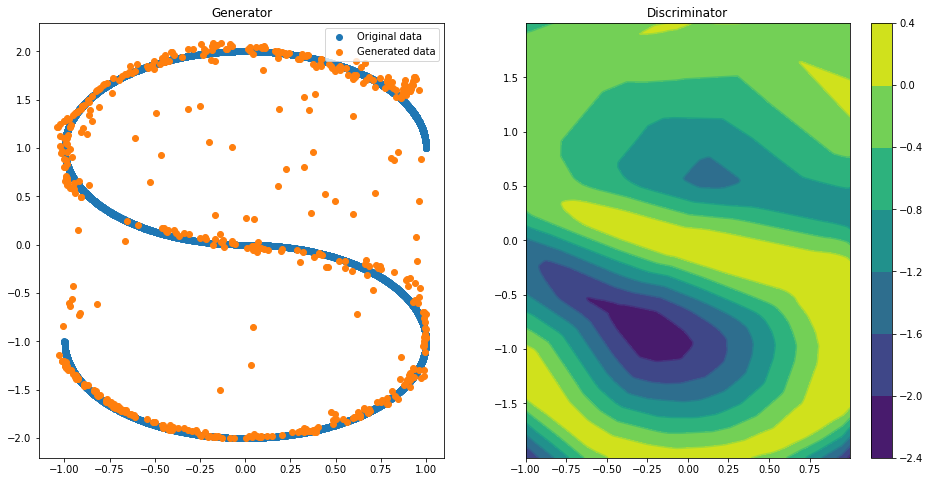

Epoch 100 | ET 3.19 min | Avg Losses >> G/D 0.7283/1.3548 [D-Real: 0.6705 D-Fake: 0.6843]


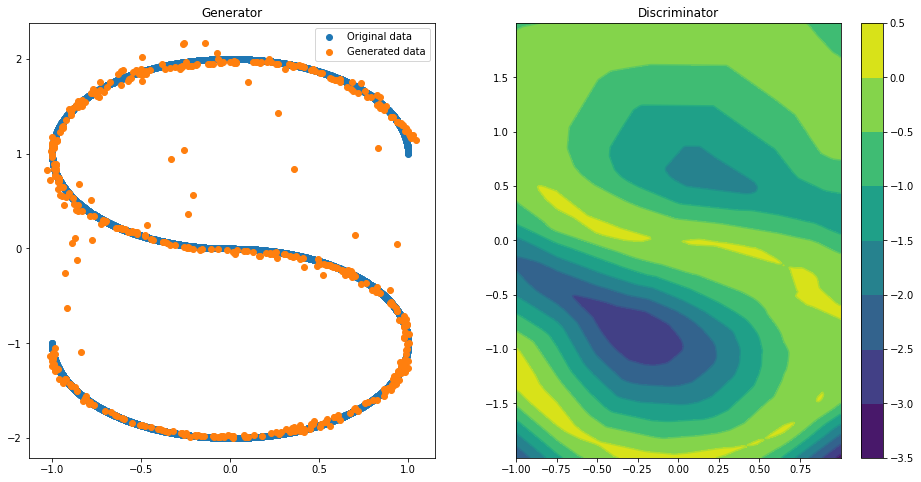

Epoch 150 | ET 4.49 min | Avg Losses >> G/D 0.7109/1.3735 [D-Real: 0.6866 D-Fake: 0.6869]


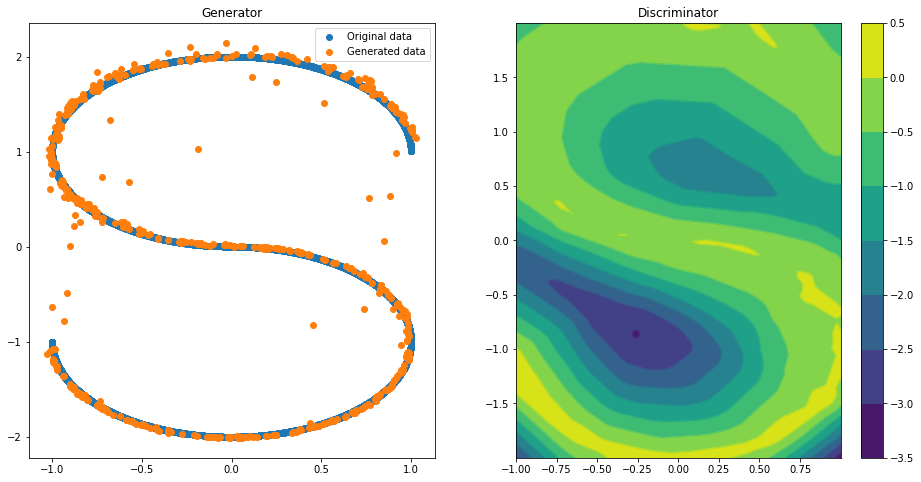

Epoch 200 | ET 5.79 min | Avg Losses >> G/D 0.7060/1.3766 [D-Real: 0.6854 D-Fake: 0.6912]


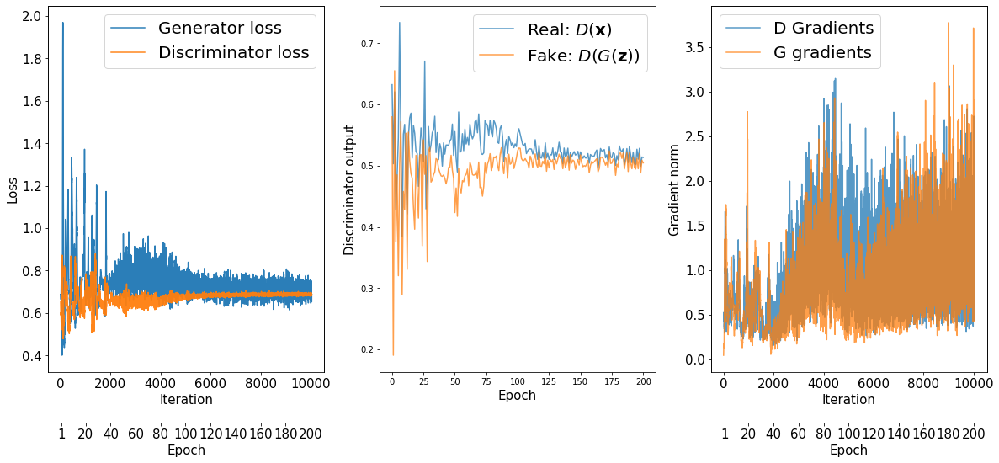

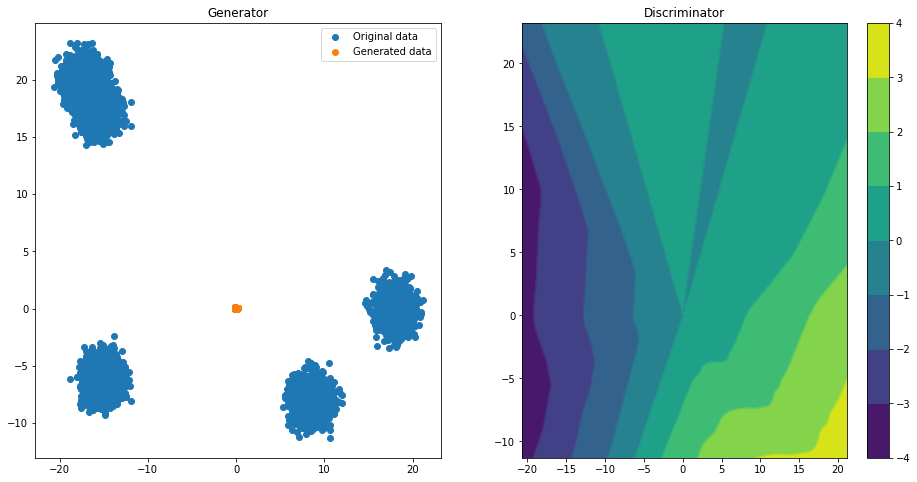

Epoch 000 | ET 0.57 min | Avg Losses >> G/D 0.7224/0.7514 [D-Real: 0.0803 D-Fake: 0.6711]


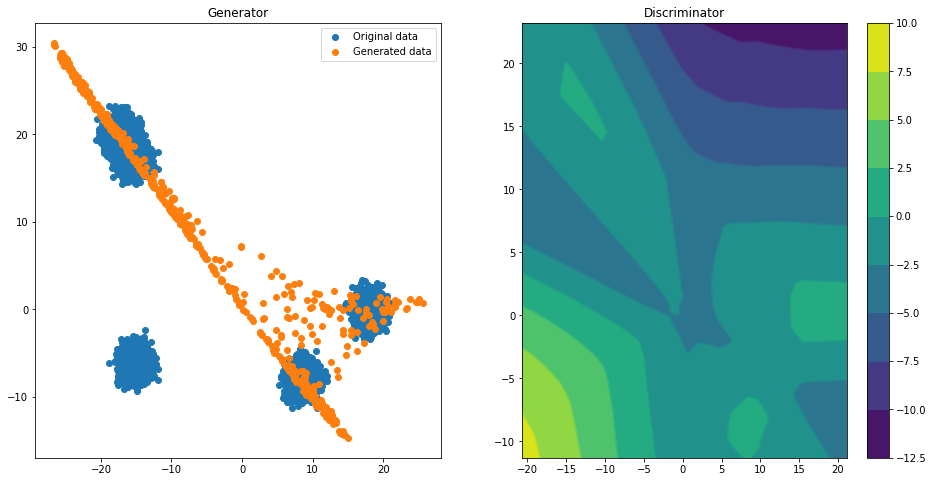

Epoch 050 | ET 1.87 min | Avg Losses >> G/D 1.2012/0.9576 [D-Real: 0.4704 D-Fake: 0.4872]


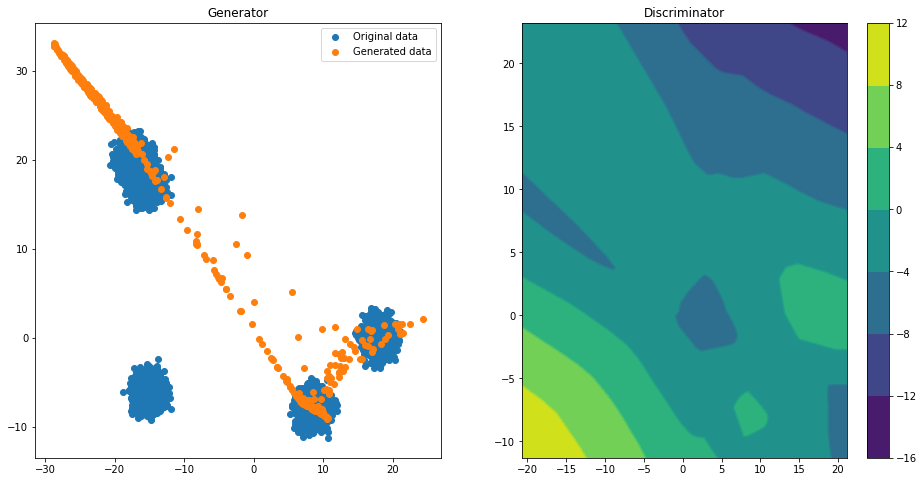

Epoch 100 | ET 3.16 min | Avg Losses >> G/D 1.1491/1.0554 [D-Real: 0.5696 D-Fake: 0.4858]


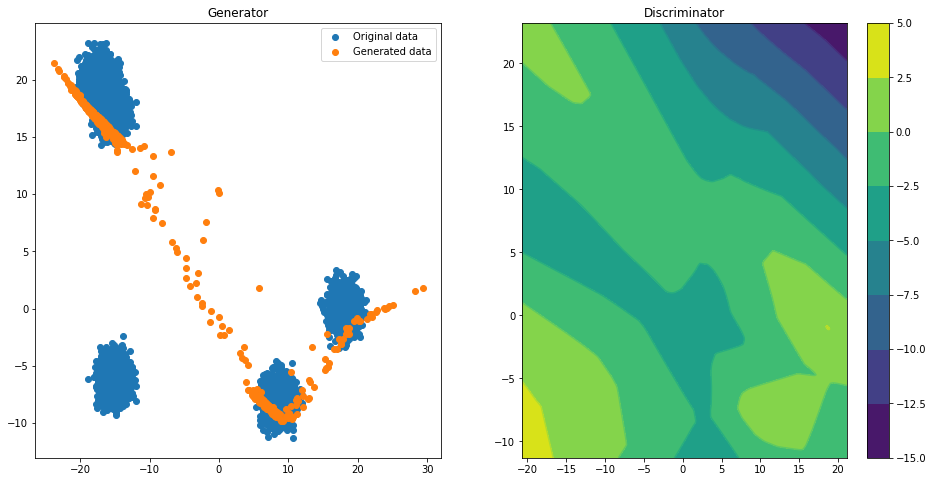

Epoch 150 | ET 4.46 min | Avg Losses >> G/D 1.0666/1.1355 [D-Real: 0.6429 D-Fake: 0.4926]


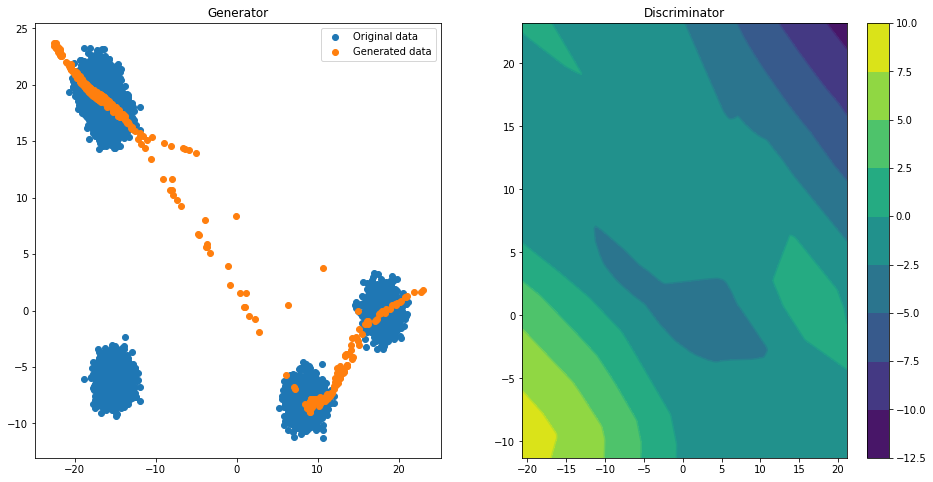

Epoch 200 | ET 5.76 min | Avg Losses >> G/D 1.0175/1.1679 [D-Real: 0.6531 D-Fake: 0.5148]


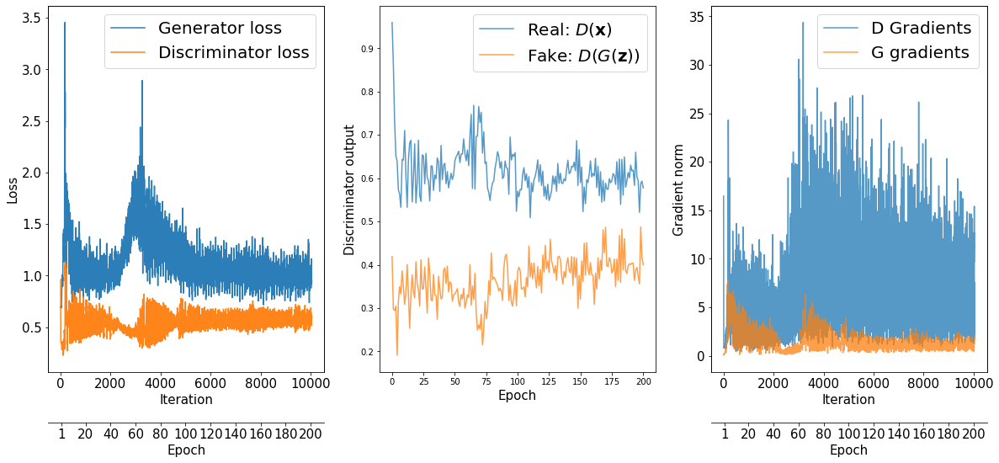

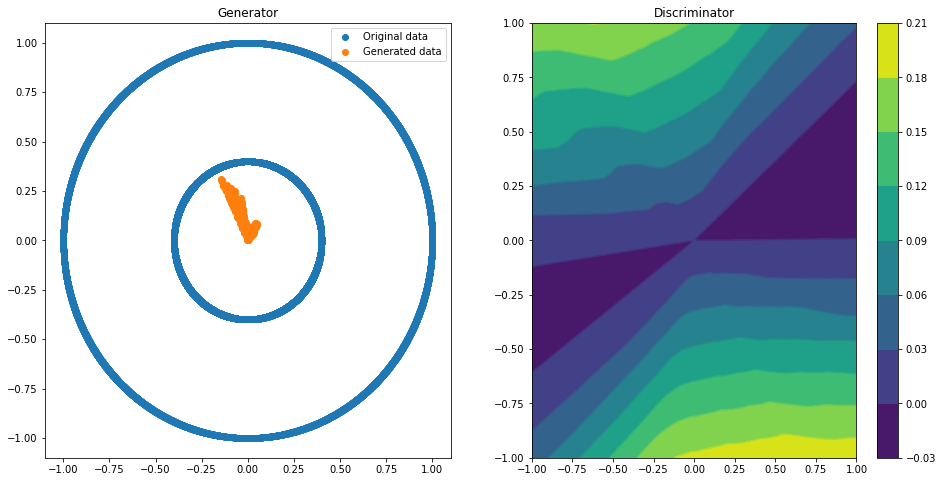

Epoch 000 | ET 0.58 min | Avg Losses >> G/D 0.7788/1.2242 [D-Real: 0.6000 D-Fake: 0.6243]


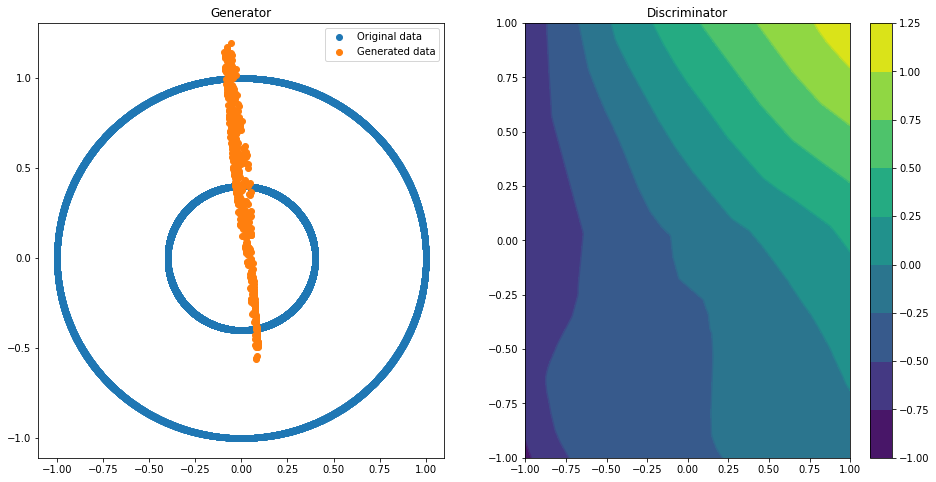

Epoch 050 | ET 1.90 min | Avg Losses >> G/D 0.7568/1.3980 [D-Real: 0.7460 D-Fake: 0.6520]


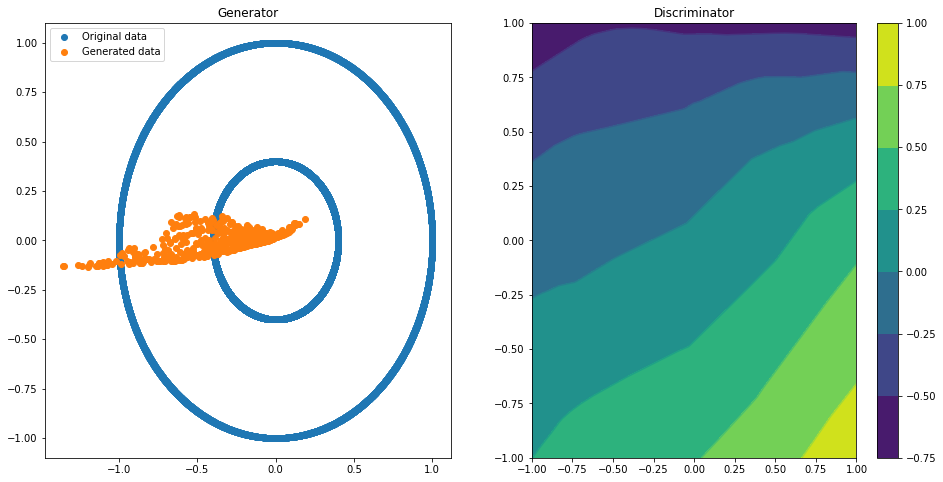

Epoch 100 | ET 3.23 min | Avg Losses >> G/D 0.6995/1.3640 [D-Real: 0.6768 D-Fake: 0.6872]


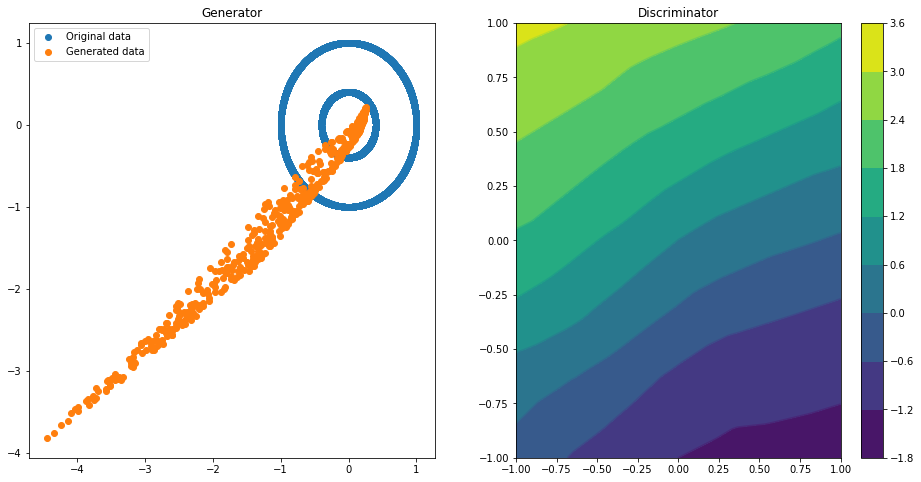

Epoch 150 | ET 4.57 min | Avg Losses >> G/D 0.7610/1.4457 [D-Real: 0.6661 D-Fake: 0.7796]


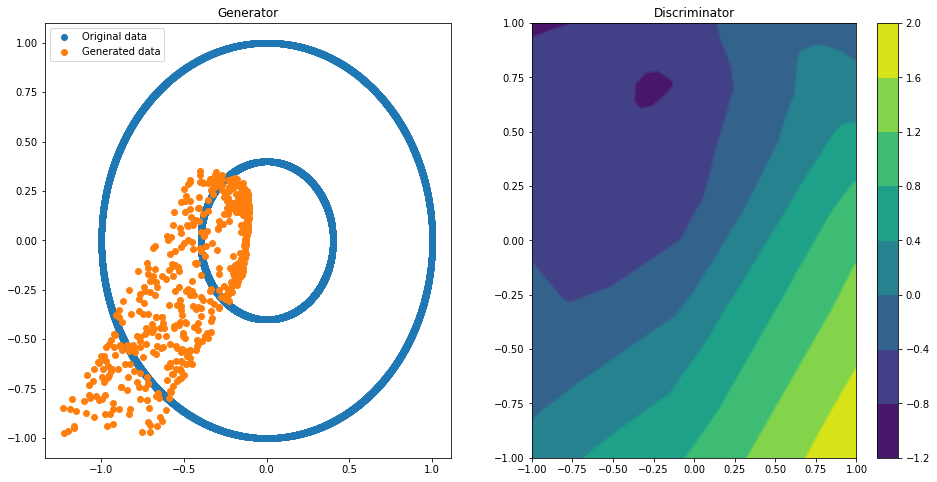

Epoch 200 | ET 5.90 min | Avg Losses >> G/D 0.9010/1.3037 [D-Real: 0.7573 D-Fake: 0.5464]


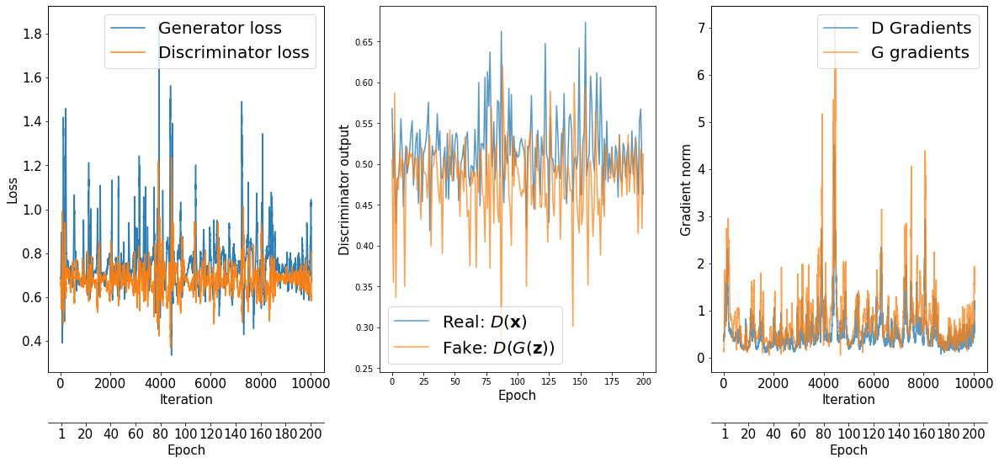

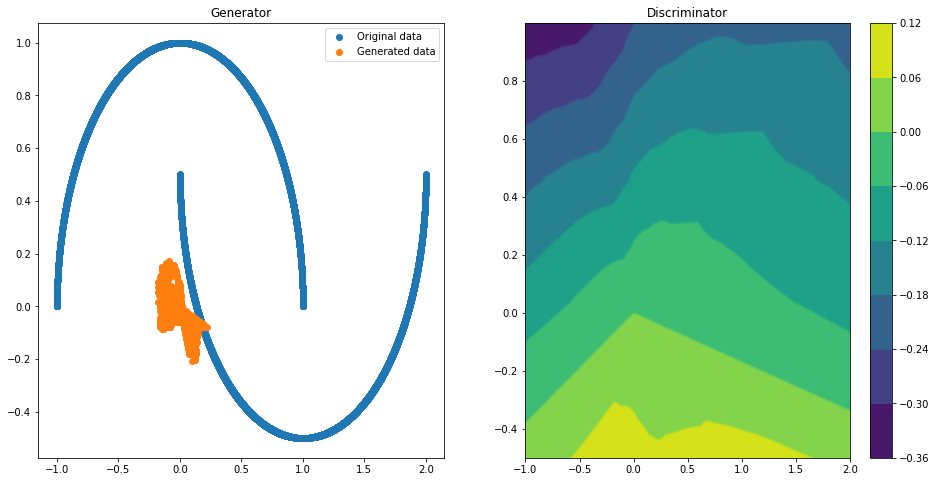

Epoch 000 | ET 0.57 min | Avg Losses >> G/D 0.6756/1.3514 [D-Real: 0.6331 D-Fake: 0.7183]


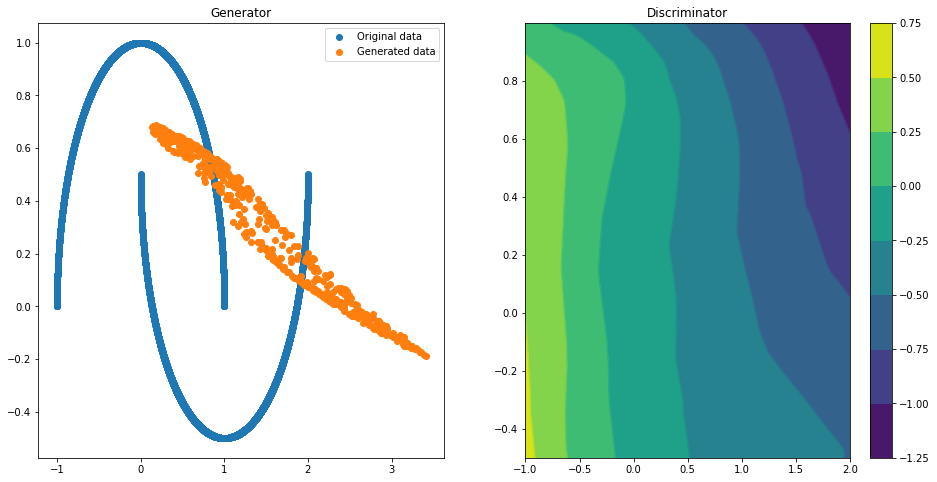

Epoch 050 | ET 1.90 min | Avg Losses >> G/D 0.8843/1.2850 [D-Real: 0.7200 D-Fake: 0.5650]


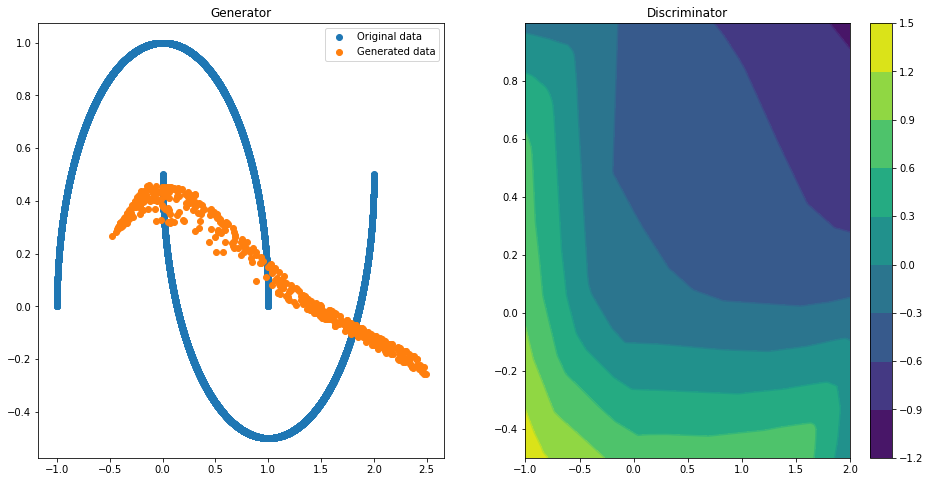

Epoch 100 | ET 3.21 min | Avg Losses >> G/D 0.7254/1.3782 [D-Real: 0.6872 D-Fake: 0.6910]


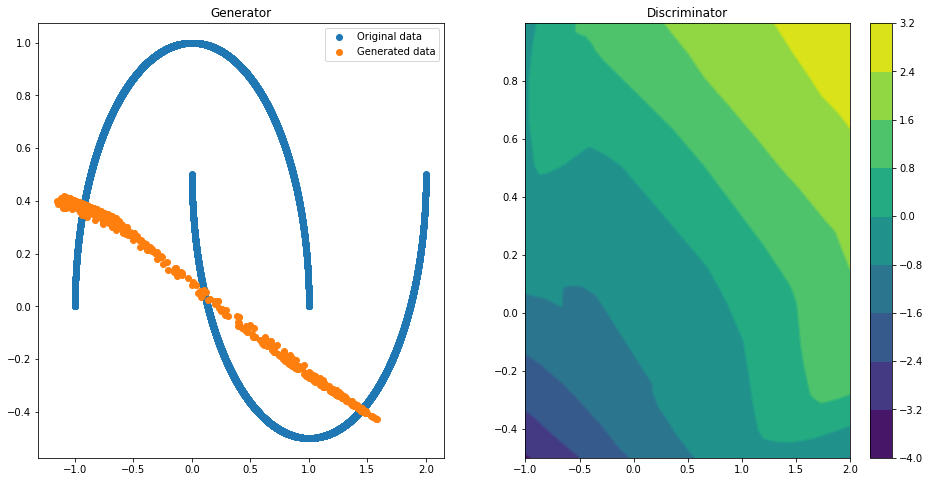

Epoch 150 | ET 4.52 min | Avg Losses >> G/D 0.6825/1.4478 [D-Real: 0.6937 D-Fake: 0.7541]


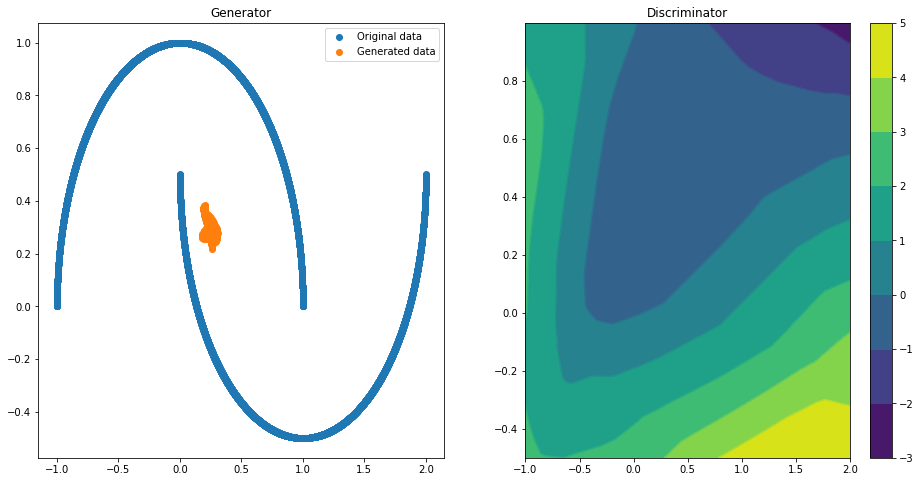

Epoch 200 | ET 5.82 min | Avg Losses >> G/D 1.0341/0.9729 [D-Real: 0.4477 D-Fake: 0.5252]


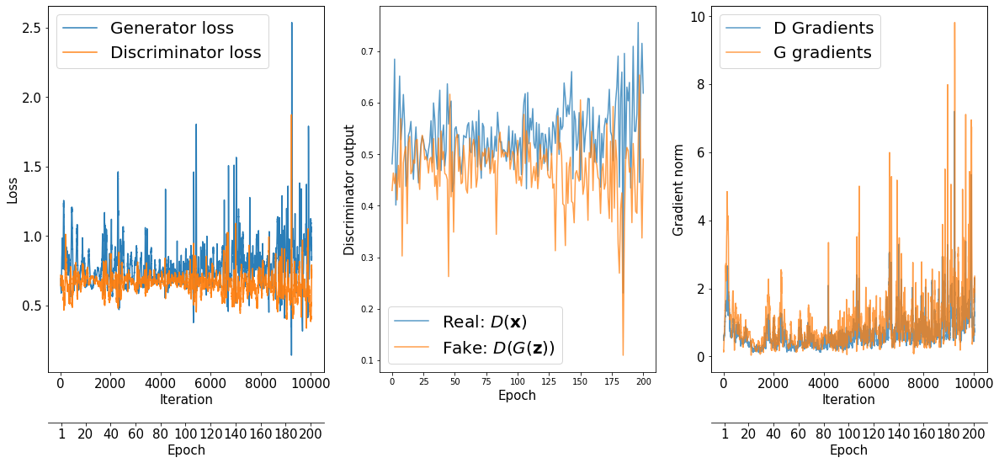

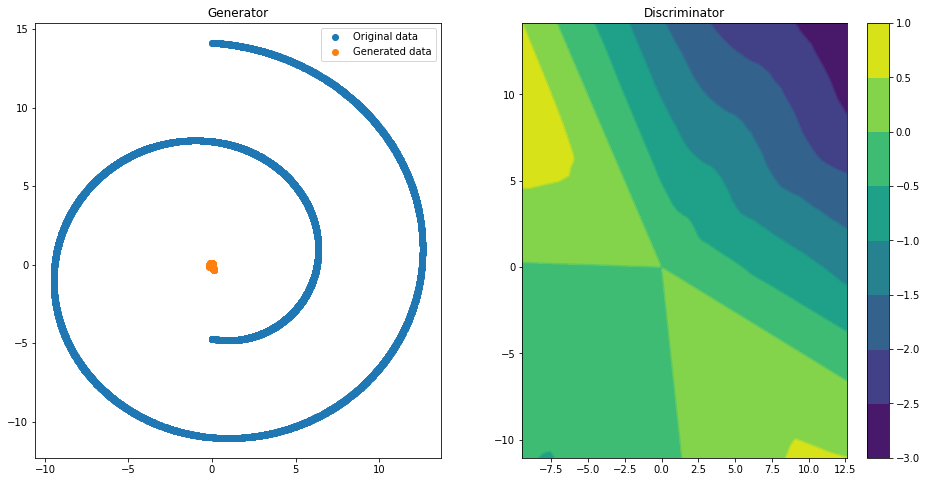

Epoch 000 | ET 0.58 min | Avg Losses >> G/D 0.6318/0.9504 [D-Real: 0.1795 D-Fake: 0.7709]


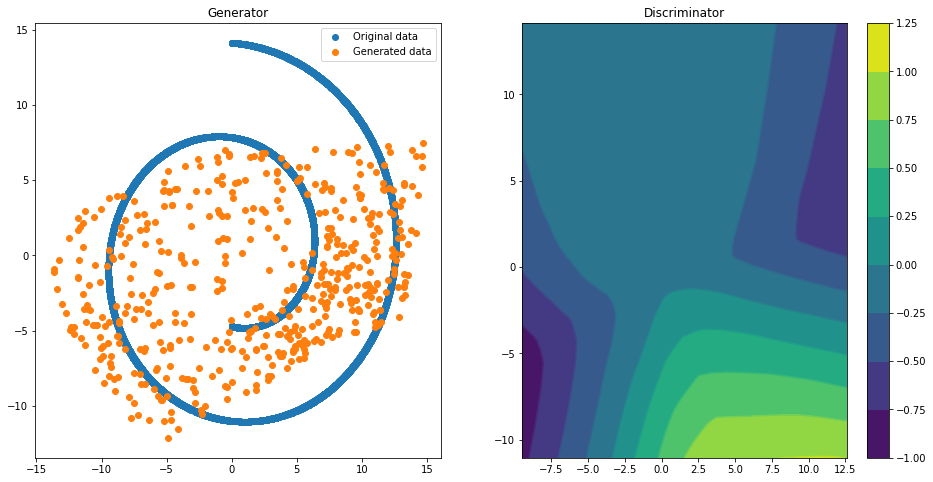

Epoch 050 | ET 1.90 min | Avg Losses >> G/D 0.7221/1.3755 [D-Real: 0.6806 D-Fake: 0.6949]


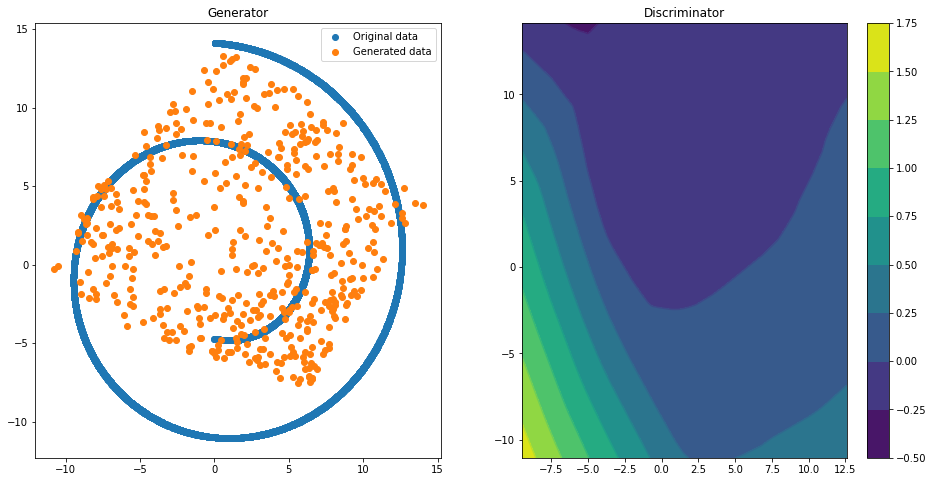

Epoch 100 | ET 3.21 min | Avg Losses >> G/D 0.6796/1.3761 [D-Real: 0.6483 D-Fake: 0.7278]


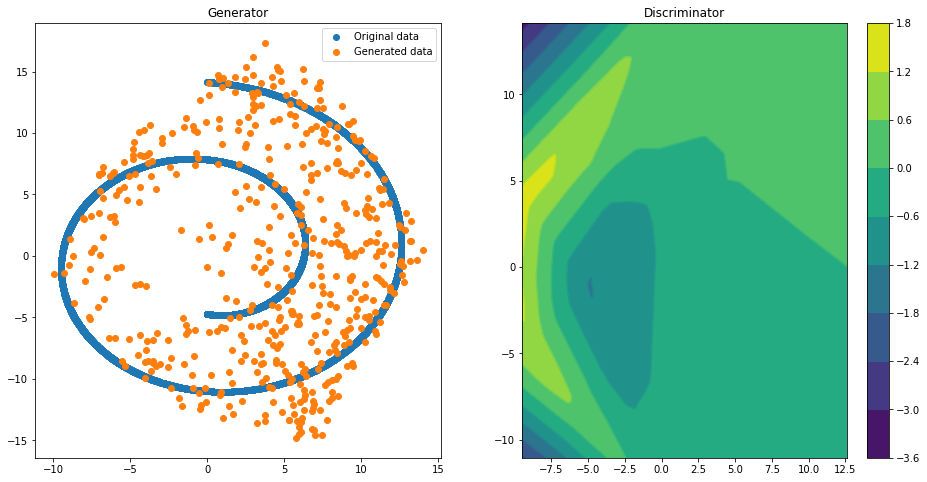

Epoch 150 | ET 4.53 min | Avg Losses >> G/D 0.7798/1.3350 [D-Real: 0.6908 D-Fake: 0.6442]


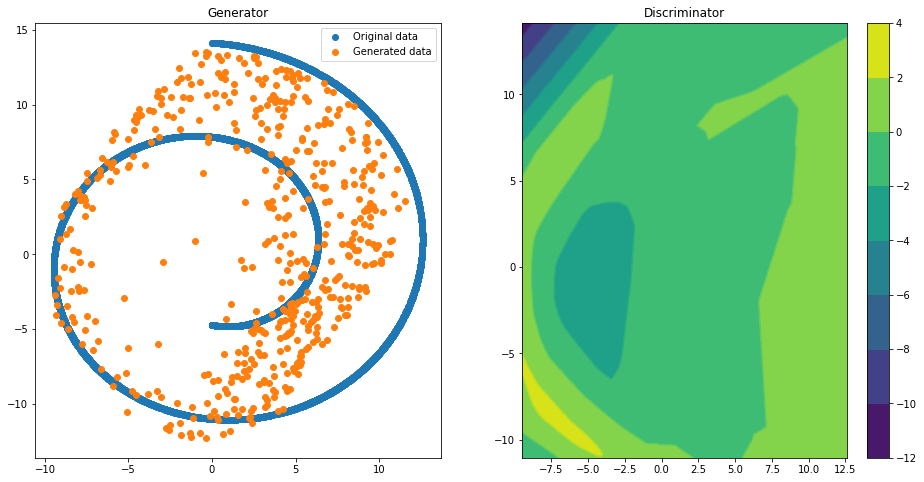

Epoch 200 | ET 5.84 min | Avg Losses >> G/D 0.8027/1.3221 [D-Real: 0.6740 D-Fake: 0.6482]


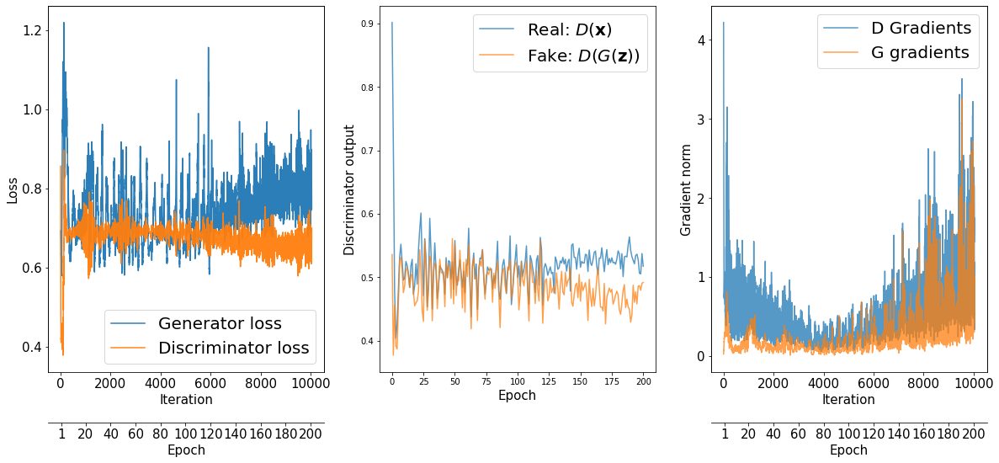

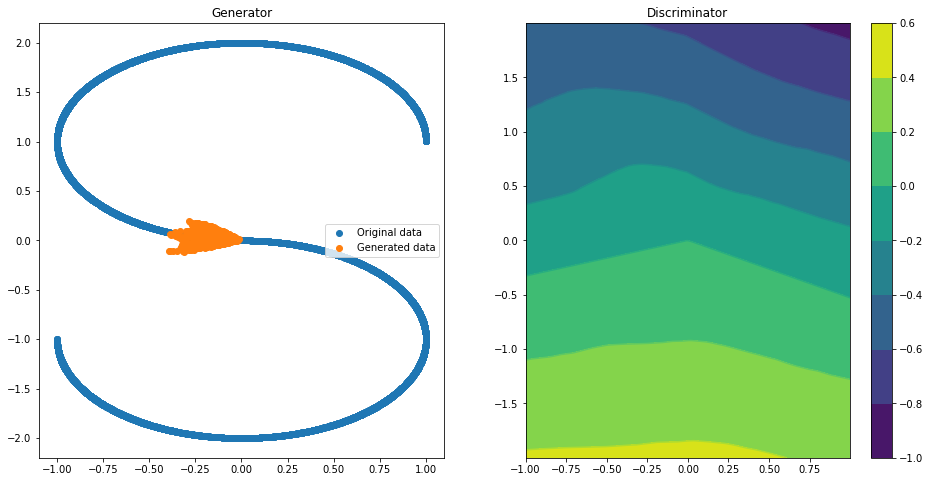

Epoch 000 | ET 0.64 min | Avg Losses >> G/D 0.7276/1.2027 [D-Real: 0.5283 D-Fake: 0.6744]


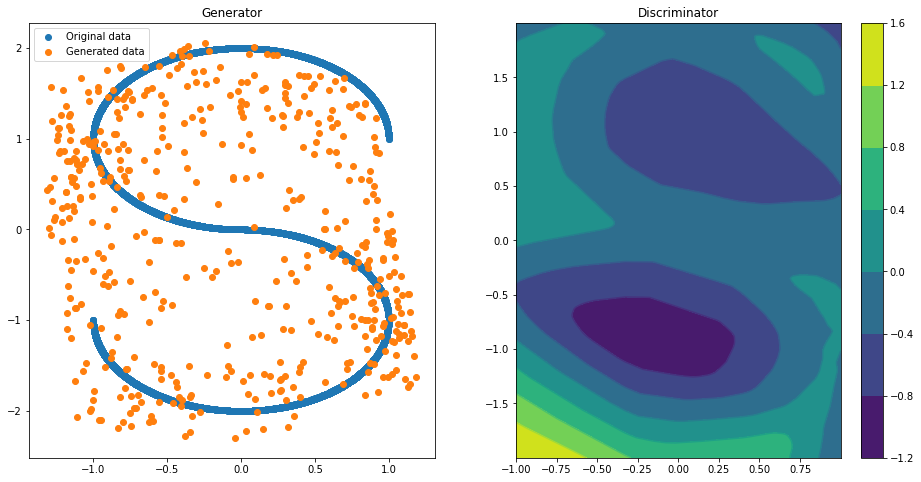

Epoch 050 | ET 1.97 min | Avg Losses >> G/D 0.8269/1.2855 [D-Real: 0.6456 D-Fake: 0.6399]


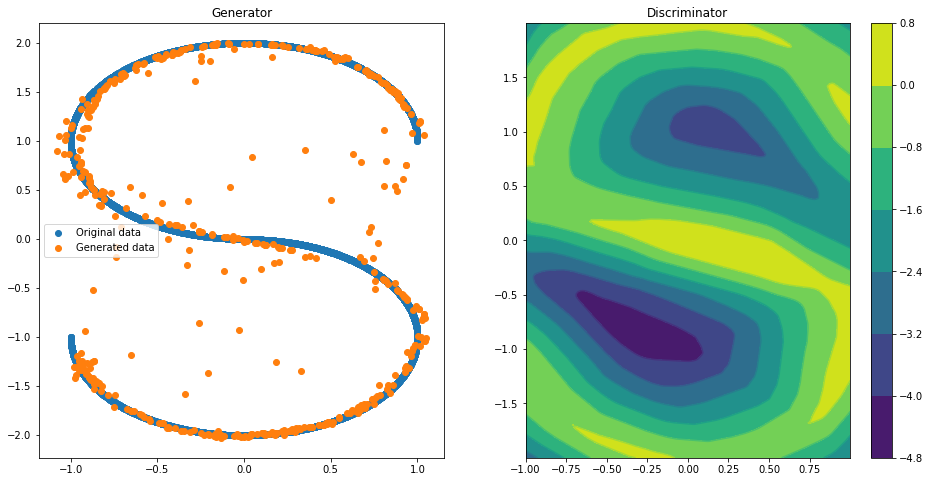

Epoch 100 | ET 3.30 min | Avg Losses >> G/D 0.7877/1.3300 [D-Real: 0.6568 D-Fake: 0.6731]


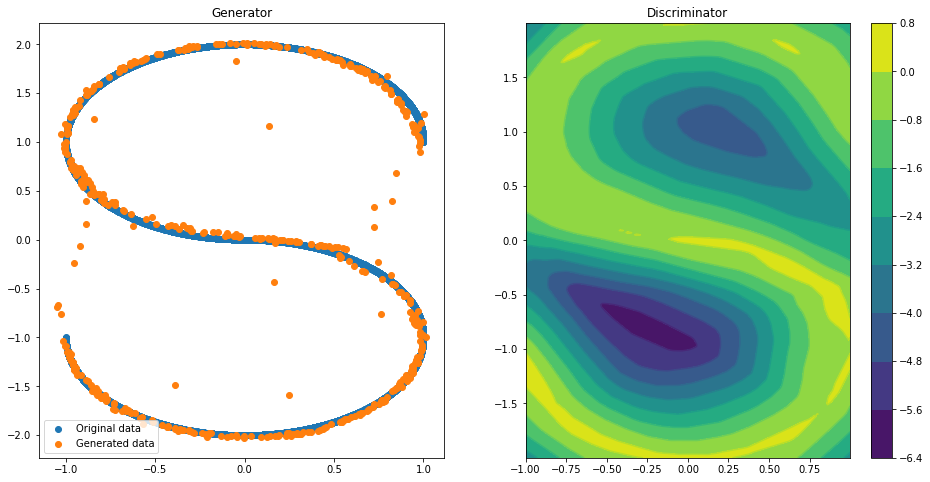

Epoch 150 | ET 4.62 min | Avg Losses >> G/D 0.7517/1.3532 [D-Real: 0.6748 D-Fake: 0.6784]


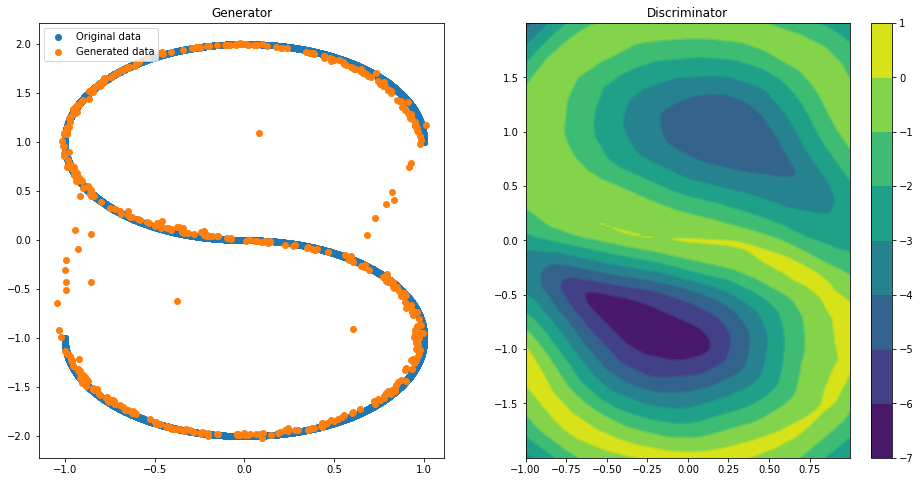

Epoch 200 | ET 5.94 min | Avg Losses >> G/D 0.7442/1.3570 [D-Real: 0.6748 D-Fake: 0.6822]


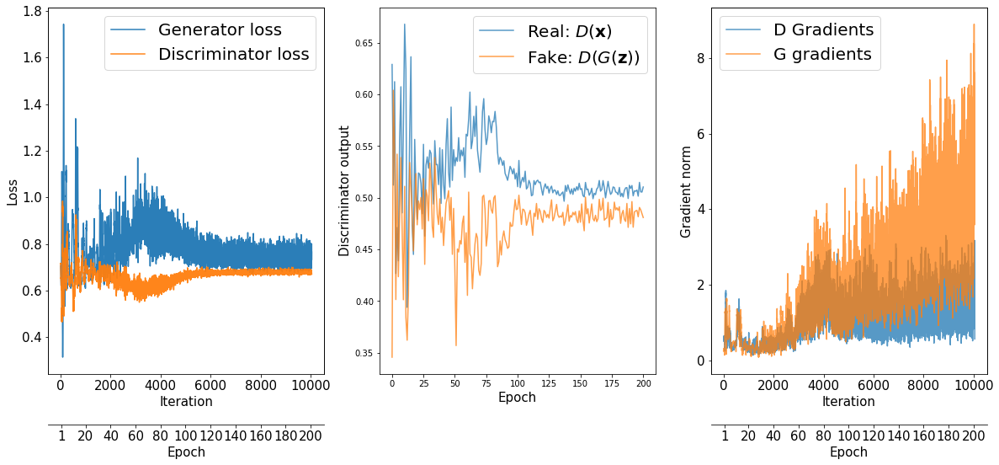

In [ ]:
for _ in range(5):
  for datos in [blobs, circles, moons, swiss_roll, s_curve]:
    numpy_data = datos
    data = tf.data.Dataset.from_tensor_slices(numpy_data).batch(batch_size)

    with tf.device(device_name):
      gen_model = make_generator_network()
      gen_model.build(input_shape=(None,z_size))
      disc_model = make_discriminator_network()
      disc_model.build(input_shape=(None,2))


    loss_fn = tf.keras.losses.BinaryCrossentropy(from_logits=True)
    g_optimizer = tf.keras.optimizers.Adam()
    d_optimizer = tf.keras.optimizers.Adam()
    all_losses = []
    all_d_vals = []
    d_gradients = []
    g_gradients = []
    epoch_samples = []
    start_time = time.time()
    for epoch in range(0, num_epochs+1):
      epoch_losses, epoch_d_vals = [], []
      #Plotting every 50
      if epoch%50 == 0:
          input_z = tf.random.uniform(shape = (500,z_size), minval=-1,maxval=1)
          epoch_samples.append(gen_model(input_z, training=False).numpy())
          X_data, Y_data = numpy_data[:,0], numpy_data[:,1]
          x = np.linspace(np.min(X_data), np.max(X_data), 200)
          y = np.linspace(np.min(Y_data), np.max(Y_data), 200)
          X, Y = np.meshgrid(x, y)
          Z = np.zeros((len(x), len(y)))
          for i in range(len(x)):
            for j in range(len(y)):
              q = tf.convert_to_tensor(np.array([[x[j],y[i]]]).astype("float32"))
              Z[i][j] = disc_model(q).numpy()[0][0]
          f, (ax1, ax2) = plt.subplots(1, 2, figsize = (16,8))
          ax1.scatter(X_data,Y_data, label = "Original data")
          ax1.scatter(epoch_samples[-1][:,0],epoch_samples[-1][:,1], label="Generated data")
          ax1.set_title("Generator")
          ax1.legend()
          ax2.contour(X,Y,Z)
          ax2.set_title("Discriminator")
          cp = ax2.contourf(X , Y , Z)
          plt.colorbar(cp, ax=ax2)
          plt.show()
      for batch in data:
        input_z = tf.random.uniform(shape = (batch_size,z_size), minval=-1,maxval=1)
          #Compute generator's loss
        with tf.GradientTape() as g_tape:
          g_output = gen_model(input_z)
          d_logits_fake = disc_model(g_output,
                                      training=True)
          labels_real = tf.ones_like(d_logits_fake)
          g_loss = loss_fn(y_true=labels_real,
                            y_pred=d_logits_fake)
          #Compute the gradients of g_loss
        g_grads = g_tape.gradient(g_loss,
                                    gen_model.trainable_variables)
        g_gradients.append(tf.linalg.global_norm(g_grads).numpy())
          #Apply the gradients
        g_optimizer.apply_gradients(
              grads_and_vars=zip(g_grads,
                                gen_model.trainable_variables)
          )

          #Compute the discriminator's loss
        with tf.GradientTape() as d_tape:
          d_logits_real = disc_model(batch,
                                      training=True)
          d_labels_real = tf.ones_like(d_logits_real)
          d_loss_real = loss_fn(y_true=d_labels_real,
                                  y_pred=d_logits_real)
          d_logits_fake = disc_model(g_output,
                                      training=True)
          d_labels_fake = tf.zeros_like(d_logits_fake)
          d_loss_fake = loss_fn(y_true=d_labels_fake,
                                  y_pred=d_logits_fake)
          d_loss = d_loss_real + d_loss_fake

          #Compute the gradients of d_loss
        d_grads = d_tape.gradient(d_loss,
                                    disc_model.trainable_variables)
        d_gradients.append(tf.linalg.global_norm(d_grads).numpy())
        d_optimizer.apply_gradients(grads_and_vars=zip(d_grads,
                                                        disc_model.trainable_variables))
          
        epoch_losses.append(
                              (g_loss.numpy(), d_loss.numpy(),
                              d_loss_real.numpy(), d_loss_fake.numpy()))
        d_probs_real = tf.reduce_mean(
                              tf.sigmoid(d_logits_real))
        d_probs_fake = tf.reduce_mean(
                              tf.sigmoid(d_logits_fake))
      epoch_d_vals.append((d_probs_real.numpy(),
                              d_probs_fake.numpy()))
      all_losses.append(epoch_losses)
      all_d_vals.append(epoch_d_vals)
      if epoch%50 == 0:
          print(
                'Epoch {:03d} | ET {:.2f} min | Avg Losses >>'
                ' G/D {:.4f}/{:.4f} [D-Real: {:.4f} D-Fake: {:.4f}]'
                .format(
                epoch, (time.time() - start_time)/60,
                *list(np.mean(all_losses[-1], axis=0))))
    fig = plt.figure(figsize=(20, 8))

    ## Plotting the losses
    ax = fig.add_subplot(1, 3, 1)
    g_losses = [item[0] for item in itertools.chain(*all_losses)]
    d_losses = [item[1]/2.0 for item in itertools.chain(*all_losses)]
    plt.plot(g_losses, label='Generator loss', alpha=0.95)
    plt.plot(d_losses, label='Discriminator loss', alpha=0.95)
    plt.legend(fontsize=20)
    ax.set_xlabel('Iteration', size=15)
    ax.set_ylabel('Loss', size=15)

    epochs = np.arange(1, 101)
    epoch2iter = lambda e: e*len(all_losses[-1])
    epoch_ticks = [1, 20, 40, 60, 80, 100, 120, 140, 160, 180, 200]
    newpos = [epoch2iter(e) for e in epoch_ticks]
    ax2 = ax.twiny()
    ax2.set_xticks(newpos)
    ax2.set_xticklabels(epoch_ticks)
    ax2.xaxis.set_ticks_position('bottom')
    ax2.xaxis.set_label_position('bottom')
    ax2.spines['bottom'].set_position(('outward', 60))
    ax2.set_xlabel('Epoch', size=15)
    ax2.set_xlim(ax.get_xlim())
    ax.tick_params(axis='both', which='major', labelsize=15)
    ax2.tick_params(axis='both', which='major', labelsize=15)

    ## Plotting the outputs of the discriminator
    ax = fig.add_subplot(1, 3, 2)
    d_vals_real = [item[0] for item in itertools.chain(*all_d_vals)]
    d_vals_fake = [item[1] for item in itertools.chain(*all_d_vals)]
    plt.plot(d_vals_real, alpha=0.75, label=r'Real: $D(\mathbf{x})$')
    plt.plot(d_vals_fake, alpha=0.75, label=r'Fake: $D(G(\mathbf{z}))$')
    plt.legend(fontsize=20)
    ax.set_xlabel('Epoch', size=15)
    ax.set_ylabel('Discriminator output', size=15)


    ax = fig.add_subplot(1, 3, 3)
    plt.plot(d_gradients, label = "D Gradients", alpha=.75)
    plt.plot(g_gradients, label = "G gradients", alpha = .75)
    plt.legend(fontsize=20)
    ax.set_xlabel('Iteration', size=15)
    ax.set_ylabel('Gradient norm', size=15)
    ax2 = ax.twiny()
    ax2.set_xticks(newpos)
    ax2.set_xticklabels(epoch_ticks)
    ax2.xaxis.set_ticks_position('bottom')
    ax2.xaxis.set_label_position('bottom')
    ax2.spines['bottom'].set_position(('outward', 60))
    ax2.set_xlabel('Epoch', size=15)
    ax2.set_xlim(ax.get_xlim())
    ax.tick_params(axis='both', which='major', labelsize=15)
    ax2.tick_params(axis='both', which='major', labelsize=15)

    #plt.savefig('images/ch17-gan-learning-curve.pdf')
    plt.show()